# Pré-requisitos

In [1]:
!pip install colorama

In [2]:
!pip install plotly

  Using cached plotly-4.14.3-py2.py3-none-any.whl (13.2 MB)
  Using cached retrying-1.3.3.tar.gz (10 kB)
  Created wheel for retrying: filename=retrying-1.3.3-py3-none-any.whl size=11429 sha256=1275124ddee038d810deaf906b55322e108d796dfeab62cb571f9a4cb026848b
  Stored in directory: c:\users\jorge\appdata\local\pip\cache\wheels\ac\cb\8a\b27bf6323e2f4c462dcbf77d70b7c5e7868a7fbe12871770cf
Successfully built retrying


In [3]:
!pip install --upgrade statsmodels

In [5]:
!pip install sklearn

  Created wheel for sklearn: filename=sklearn-0.0-py2.py3-none-any.whl size=1316 sha256=8a28cbd997df623d0ae91b6aa2fd4374e18a973bf84268fef9206d29e052e487
  Stored in directory: c:\users\jorge\appdata\local\pip\cache\wheels\23\9d\42\5ec745cbbb17517000a53cecc49d6a865450d1f5cb16dc8a9c
Successfully built sklearn


In [7]:
!pip install matplotlib

In [1127]:
!pip install xlwings

  Created wheel for xlwings: filename=xlwings-0.23.1-py3-none-any.whl size=772009 sha256=796f5aeec12feb66e23c4e636edb8aefa7858f7ce177add9855cd5e7f66995f2
  Stored in directory: c:\users\jorge\appdata\local\pip\cache\wheels\4f\6a\a3\01fa2e4f2ab6bdc61f7197cecd6eb5b4fcaf427c41a7900c43
Successfully built xlwings


In [1133]:
!pip install openpyxl

# Importar bibliotecas

In [1128]:
import pandas as pd
import numpy as np
import colorama as cl # biblioteca para exibir texto em cores
import plotly.express as px # biblioteca para gráficos dinâmicos
import os
import xlwings as xw # exportar para xlsx

#Métricas de avaliação
import math
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

#SARIMA
import matplotlib.pyplot as plt # For plotting
from sklearn.metrics import mean_absolute_error, mean_squared_error
import statsmodels.api as sm
from pylab import rcParams
import warnings
import itertools
import matplotlib

#Estilo para gráficos
plt.style.use('fivethirtyeight')
matplotlib.rcParams['axes.labelsize'] = 14
matplotlib.rcParams['xtick.labelsize'] = 12
matplotlib.rcParams['ytick.labelsize'] = 12
#matplotlib.rcParams['text.color'] = 'G'

#LSTM
seed=10 #semente inicial
import random
np.random.seed(seed) 
random.seed(seed)
import tensorflow
tensorflow.random.set_seed(seed)
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout


# Análise exploratória


Conectar ao Google Drive

In [22]:
#from google.colab import drive
#drive.mount('/content/drive')

Abrir o diretório de trabalho

In [23]:
#workdir_path = '/content/drive/My Drive/TCC' 
#os.chdir(workdir_path)

Ler arquivo contendo série histórica de rotas do Báltico.

In [25]:
baltic = pd.read_excel('database.xls')
baltic = baltic.sort_values(by = 'Date', ascending = True)

Número de elementos.

In [26]:
baltic.size

174630

Número de linhas e colunas.

In [27]:
baltic.shape

(58210, 3)

Detalhes do dataframe.

In [28]:
baltic.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 58210 entries, 38696 to 58209
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    58210 non-null  datetime64[ns]
 1   USD     58210 non-null  float64       
 2   Route   58210 non-null  object        
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 1.8+ MB


Procurar por valores nulos no dataframe.

In [29]:
if baltic.isnull().values.any() == True:
    print(cl.Fore.RED + 'Valores nulos encotrados: ')
    display(HTML(baltic[baltic.isnull().any(axis=1)].to_html()))
else:
    print(cl.Fore.GREEN + 'Valores nulos não encontrados.')

Valores nulos não encontrados.


In [30]:
baltic.head()

,Date,USD,Route
38696,2013-01-02,8975.0,S8
28308,2013-01-02,7044.0,S2
24847,2013-01-02,9555.0,S1B
36619,2013-01-02,12294.0,S5
49111,2013-01-02,8903.0,HS3


In [31]:
baltic.tail()

,Date,USD,Route
32464,2021-04-23,18400.0,S3
14439,2021-04-23,11550.0,C5
30387,2021-04-23,26014.0,S2
1790,2021-04-23,37450.0,C8_14
58209,2021-04-23,22175.0,HS7


In [32]:
fig = px.line(baltic, x='Date', y='USD', color='Route')
fig.show()

# Modelos

## HS1

### SARIMA

In [33]:
data = baltic.loc[baltic['Route'] == 'HS1'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS1'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).HS1.mean()
data.head()

Date
2013-01-31    3763.590909
2013-02-28    3222.050000
2013-03-31    3554.700000
2013-04-30    4024.333333
2013-05-31    4670.857143
Freq: M, Name: HS1, dtype: float64

#### Divisão da base

In [34]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [35]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [36]:
y = data.copy()
y.tail()

Date
2020-12-31    13484.055556
2021-01-31    12392.300000
2021-02-28    15364.850000
2021-03-31    19926.000000
2021-04-30    15581.933333
Freq: M, Name: HS1, dtype: float64

#### Exibição da série

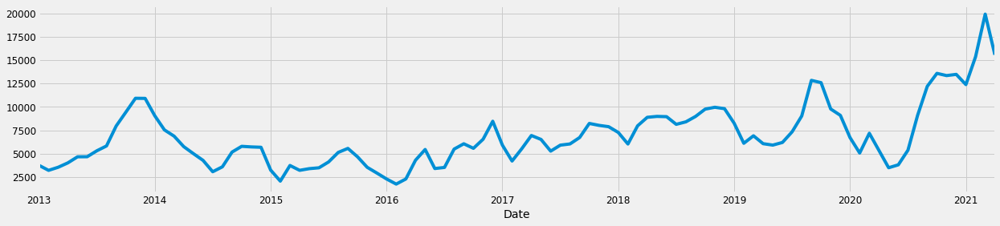

In [37]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

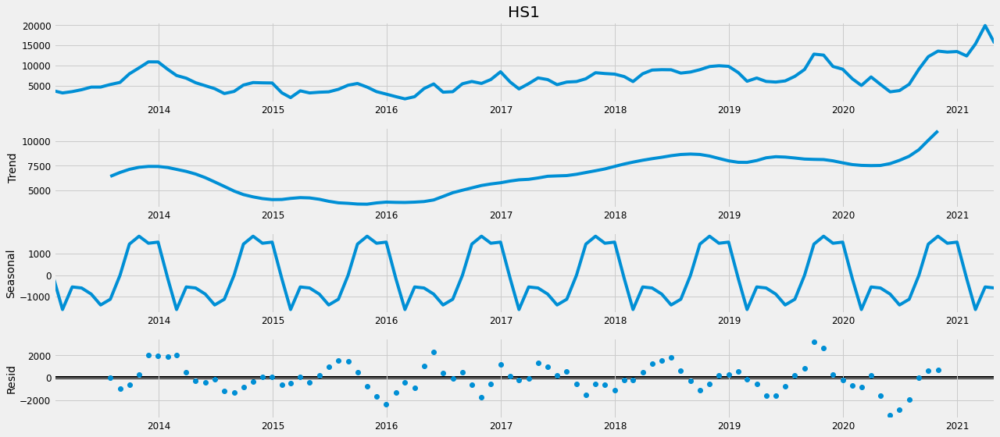

In [38]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [39]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [40]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2052.938506414608
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1770.7800543834126
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1653.6627663218544
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1425.942723193922
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1675.4258564643285
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1624.3145747036413
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1445.929208136912
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1427.3654616411022
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1957.0640981404551
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1707.2427223952134
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1543.057211126798
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1324.275978326219
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1582.293090568251
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1510.1852433443016
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1379.2306949598785
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1326.1740728576415
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1711.89754560558
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1493.119602377995
A

#### Ajuste considerando o menor valor de AIC

In [41]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3631      0.214     -1.695      0.090      -0.783       0.057
ma.L1          0.8608      0.102      8.460      0.000       0.661       1.060
ar.S.L12       0.0331      0.316      0.105      0.916      -0.586       0.652
ma.S.L12      -0.5911      0.268     -2.205      0.027      -1.117      -0.066
sigma2      1.504e+06   1.92e+05      7.852      0.000    1.13e+06    1.88e+06


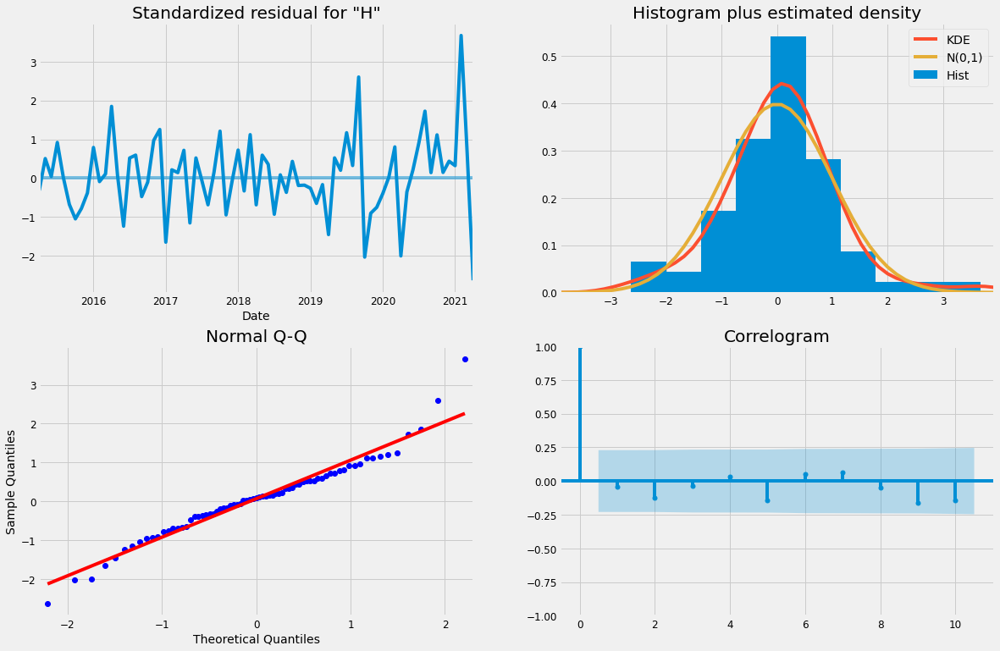

In [42]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

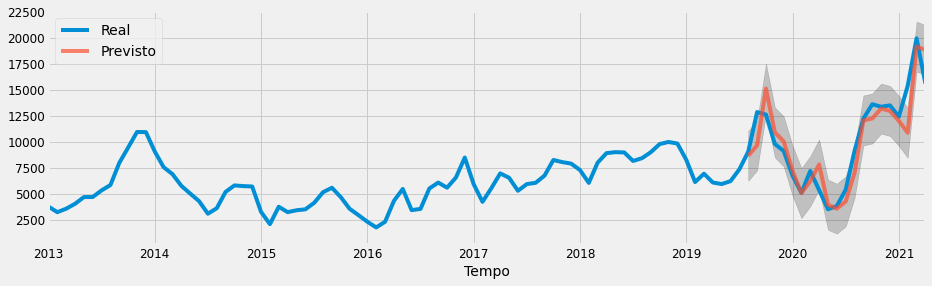

In [43]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [44]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_hs1_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_hs1_rmse)
sarima_hs1_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_hs1_mse)
sarima_hs1_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_hs1_mape, '%')
sarima_hs1_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  1769.3676039461059
MSE:  3130661.717893984
MAPE:  13.121451679575557 %
R2:  0.8304723350176787


### LSTM

#### Divisão da base

training_set

In [45]:
temp = baltic.loc[baltic['Route'] == 'HS1'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS1'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,HS1
44955,2013-01-02,4357.0
44956,2013-01-03,4136.0
44957,2013-01-04,4014.0
44958,2013-01-07,3907.0
44959,2013-01-08,3834.0


In [46]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[4357.],
       [4136.],
       [4014.],
       [3907.],
       [3834.]])

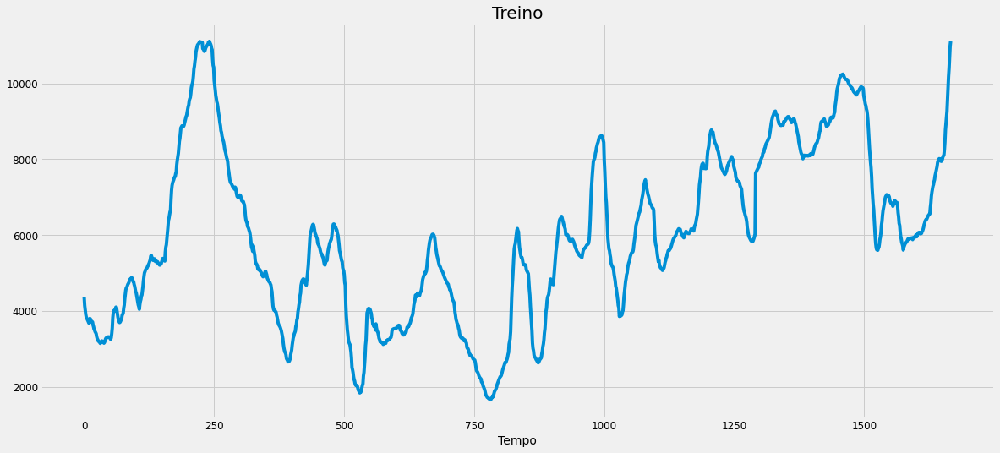

In [47]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [48]:
temp = baltic.loc[baltic['Route'] == 'HS1'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS1'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,HS1
46622,2019-09-02,11186.0
46623,2019-09-03,11389.0
46624,2019-09-04,11686.0
46625,2019-09-05,12150.0
46626,2019-09-06,12236.0


In [49]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[11186.],
       [11389.],
       [11686.],
       [12150.],
       [12236.]])

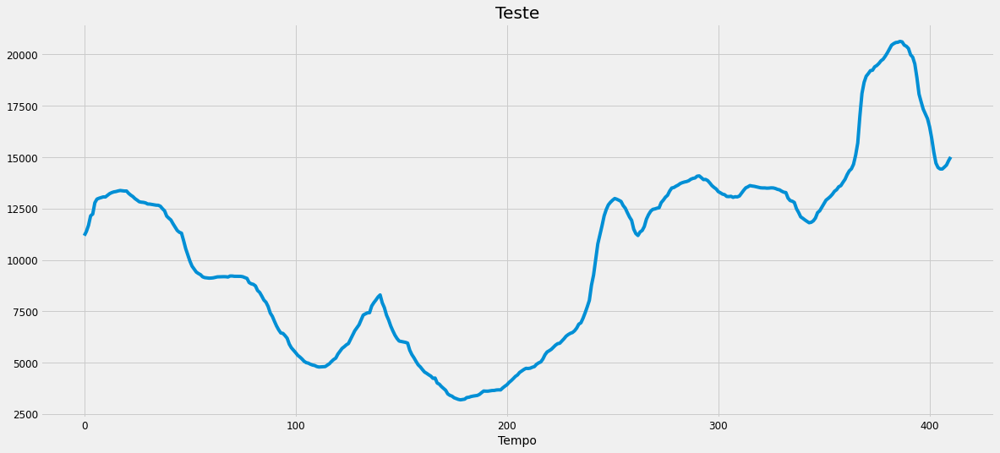

In [50]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [51]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [52]:
training_set_scaled[0:5]

array([[0.2860165 ],
       [0.26264015],
       [0.24973556],
       [0.2384176 ],
       [0.230696  ]])

##### Criar a estrutura de dados

In [53]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [54]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [55]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.286017,0.262640,0.249736,0.238418,0.230696,0.227629,0.224032,0.220965,0.218003,0.214301
1,0.262640,0.249736,0.238418,0.230696,0.227629,0.224032,0.220965,0.218003,0.214301,0.216416
2,0.249736,0.238418,0.230696,0.227629,0.224032,0.220965,0.218003,0.214301,0.216416,0.226994
3,0.238418,0.230696,0.227629,0.224032,0.220965,0.218003,0.214301,0.216416,0.226994,0.225619
4,0.230696,0.227629,0.224032,0.220965,0.218003,0.214301,0.216416,0.226994,0.225619,0.221705


In [56]:
pd.DataFrame(y_train).head()

,0
0,0.216416
1,0.226994
2,0.225619
3,0.221705
4,0.218638


##### *Reshaping*

In [57]:
X_train.shape

(1657, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [58]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [59]:
X_train.shape

(1657, 10, 1)


###### Construção da Rede completa

In [60]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 10, 100)           40800     
_________________________________________________________________
dropout_1 (Dropout)          (None, 10, 100)           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 10, 80)            57920     
_________________________________________________________________
dropout_2 (Dropout)          (None, 10, 80)            0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 50)                26200     
_________________________________________________________________
dropout_3 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                

###### Treinamento

In [62]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1491 samples, validate on 166 samples
Epoch 1/1000
1491/1491 [==============================] - 1s 656us/step - loss: 0.0035 - val_loss: 0.0039
Epoch 2/1000
1491/1491 [==============================] - 1s 664us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 3/1000
1491/1491 [==============================] - 1s 670us/step - loss: 0.0032 - val_loss: 0.0023
Epoch 4/1000
1491/1491 [==============================] - 1s 668us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 5/1000
1491/1491 [==============================] - 1s 660us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 6/1000
1491/1491 [==============================] - 1s 659us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 7/1000
1491/1491 [==============================] - 1s 662us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 8/1000
1491/1491 [==============================] - 1s 669us/step - loss: 0.0023 - val_loss: 9.2525e-04
Epoch 9/1000
1491/1491 [==============================] - 1s 673us/step - loss: 0.0029 - val_loss: 0.

1491/1491 [==============================] - 1s 701us/step - loss: 7.5402e-04 - val_loss: 2.5729e-04
Epoch 75/1000
1491/1491 [==============================] - 1s 683us/step - loss: 8.0827e-04 - val_loss: 2.1942e-04
Epoch 76/1000
1491/1491 [==============================] - 1s 661us/step - loss: 7.5231e-04 - val_loss: 3.5131e-04
Epoch 77/1000
1491/1491 [==============================] - 1s 665us/step - loss: 6.8290e-04 - val_loss: 3.3282e-04
Epoch 78/1000
1491/1491 [==============================] - 1s 656us/step - loss: 7.6861e-04 - val_loss: 5.5370e-04
Epoch 79/1000
1491/1491 [==============================] - 1s 656us/step - loss: 8.6833e-04 - val_loss: 2.0822e-04
Epoch 80/1000
1491/1491 [==============================] - 1s 660us/step - loss: 7.7203e-04 - val_loss: 3.3631e-04
Epoch 81/1000
1491/1491 [==============================] - 1s 678us/step - loss: 7.5527e-04 - val_loss: 1.9471e-04
Epoch 82/1000
1491/1491 [==============================] - 1s 672us/step - loss: 8.0317e-04 - 

Epoch 145/1000
1491/1491 [==============================] - 1s 658us/step - loss: 6.6526e-04 - val_loss: 1.0646e-04
Epoch 146/1000
1491/1491 [==============================] - 1s 655us/step - loss: 5.5274e-04 - val_loss: 1.4714e-04
Epoch 147/1000
1491/1491 [==============================] - 1s 671us/step - loss: 5.5938e-04 - val_loss: 1.0445e-04
Epoch 148/1000
1491/1491 [==============================] - 1s 676us/step - loss: 5.8119e-04 - val_loss: 1.4272e-04
Epoch 149/1000
1491/1491 [==============================] - 1s 665us/step - loss: 5.4913e-04 - val_loss: 1.0494e-04
Epoch 150/1000
1491/1491 [==============================] - 1s 680us/step - loss: 5.2864e-04 - val_loss: 4.7735e-04
Epoch 151/1000
1491/1491 [==============================] - 1s 696us/step - loss: 6.2120e-04 - val_loss: 4.3857e-04
Epoch 152/1000
1491/1491 [==============================] - 1s 693us/step - loss: 6.1480e-04 - val_loss: 1.3954e-04
Epoch 153/1000
1491/1491 [==============================] - 1s 712us/ste

1491/1491 [==============================] - 1s 762us/step - loss: 5.8089e-04 - val_loss: 1.6331e-04
Epoch 216/1000
1491/1491 [==============================] - 1s 800us/step - loss: 5.8594e-04 - val_loss: 1.0485e-04
Epoch 217/1000
1491/1491 [==============================] - 1s 760us/step - loss: 4.9740e-04 - val_loss: 8.9081e-05
Epoch 218/1000
1491/1491 [==============================] - 1s 799us/step - loss: 5.4430e-04 - val_loss: 1.4615e-04
Epoch 219/1000
1491/1491 [==============================] - 1s 803us/step - loss: 5.5097e-04 - val_loss: 1.4713e-04
Epoch 220/1000
1491/1491 [==============================] - 1s 816us/step - loss: 5.5241e-04 - val_loss: 9.0004e-05
Epoch 221/1000
1491/1491 [==============================] - 1s 834us/step - loss: 4.9123e-04 - val_loss: 1.7915e-04
Epoch 222/1000
1491/1491 [==============================] - 1s 804us/step - loss: 5.5022e-04 - val_loss: 1.6294e-04
Epoch 223/1000
1491/1491 [==============================] - 1s 796us/step - loss: 6.257

Epoch 286/1000
1491/1491 [==============================] - 1s 757us/step - loss: 4.2519e-04 - val_loss: 1.0487e-04
Epoch 287/1000
1491/1491 [==============================] - 1s 756us/step - loss: 4.8073e-04 - val_loss: 7.2864e-05
Epoch 288/1000
1491/1491 [==============================] - 1s 757us/step - loss: 4.0011e-04 - val_loss: 7.1306e-05
Epoch 289/1000
1491/1491 [==============================] - 1s 753us/step - loss: 4.7720e-04 - val_loss: 7.2720e-05
Epoch 290/1000
1491/1491 [==============================] - 1s 757us/step - loss: 4.6548e-04 - val_loss: 7.5806e-05
Epoch 291/1000
1491/1491 [==============================] - 1s 758us/step - loss: 4.2033e-04 - val_loss: 7.3317e-05
Epoch 292/1000
1491/1491 [==============================] - 1s 758us/step - loss: 4.3267e-04 - val_loss: 7.6641e-05
Epoch 293/1000
1491/1491 [==============================] - 1s 750us/step - loss: 3.9525e-04 - val_loss: 7.3103e-05
Epoch 294/1000
1491/1491 [==============================] - 1s 764us/ste

1491/1491 [==============================] - 1s 758us/step - loss: 3.9710e-04 - val_loss: 7.0073e-05
Epoch 357/1000
1491/1491 [==============================] - 1s 753us/step - loss: 3.8919e-04 - val_loss: 6.9460e-05
Epoch 358/1000
1491/1491 [==============================] - 1s 756us/step - loss: 4.1498e-04 - val_loss: 6.4322e-05
Epoch 359/1000
1491/1491 [==============================] - 1s 755us/step - loss: 4.0447e-04 - val_loss: 6.3078e-05
Epoch 360/1000
1491/1491 [==============================] - 1s 758us/step - loss: 3.9515e-04 - val_loss: 7.5322e-05
Epoch 361/1000
1491/1491 [==============================] - 1s 762us/step - loss: 4.3435e-04 - val_loss: 8.5348e-05
Epoch 362/1000
1491/1491 [==============================] - 1s 756us/step - loss: 4.3932e-04 - val_loss: 8.6883e-05
Epoch 363/1000
1491/1491 [==============================] - 1s 759us/step - loss: 4.2829e-04 - val_loss: 1.2963e-04
Epoch 364/1000
1491/1491 [==============================] - 1s 757us/step - loss: 4.128

Epoch 427/1000
1491/1491 [==============================] - 1s 750us/step - loss: 4.3266e-04 - val_loss: 6.0221e-05
Epoch 428/1000
1491/1491 [==============================] - 1s 795us/step - loss: 3.8097e-04 - val_loss: 6.0171e-05
Epoch 429/1000
1491/1491 [==============================] - 1s 763us/step - loss: 4.5781e-04 - val_loss: 7.2511e-05
Epoch 430/1000
1491/1491 [==============================] - 1s 772us/step - loss: 4.2488e-04 - val_loss: 6.6199e-05
Epoch 431/1000
1491/1491 [==============================] - 1s 789us/step - loss: 3.8524e-04 - val_loss: 6.6025e-05
Epoch 432/1000
1491/1491 [==============================] - 1s 816us/step - loss: 3.9677e-04 - val_loss: 6.4337e-05
Epoch 433/1000
1491/1491 [==============================] - 1s 786us/step - loss: 4.3784e-04 - val_loss: 6.2736e-05
Epoch 434/1000
1491/1491 [==============================] - 1s 769us/step - loss: 3.9734e-04 - val_loss: 5.9681e-05
Epoch 435/1000
1491/1491 [==============================] - 1s 799us/ste

1491/1491 [==============================] - 1s 762us/step - loss: 3.9981e-04 - val_loss: 6.2135e-05
Epoch 498/1000
1491/1491 [==============================] - 1s 759us/step - loss: 4.1945e-04 - val_loss: 6.1780e-05
Epoch 499/1000
1491/1491 [==============================] - 1s 756us/step - loss: 3.8502e-04 - val_loss: 6.2802e-05
Epoch 500/1000
1491/1491 [==============================] - 1s 762us/step - loss: 4.1110e-04 - val_loss: 6.1944e-05
Epoch 501/1000
1491/1491 [==============================] - 1s 764us/step - loss: 4.1655e-04 - val_loss: 6.1443e-05
Epoch 502/1000
1491/1491 [==============================] - 1s 762us/step - loss: 4.0781e-04 - val_loss: 6.1681e-05
Epoch 503/1000
1491/1491 [==============================] - 1s 787us/step - loss: 4.0765e-04 - val_loss: 6.2078e-05
Epoch 504/1000
1491/1491 [==============================] - 1s 795us/step - loss: 3.9574e-04 - val_loss: 6.2218e-05
Epoch 505/1000
1491/1491 [==============================] - 1s 806us/step - loss: 4.369

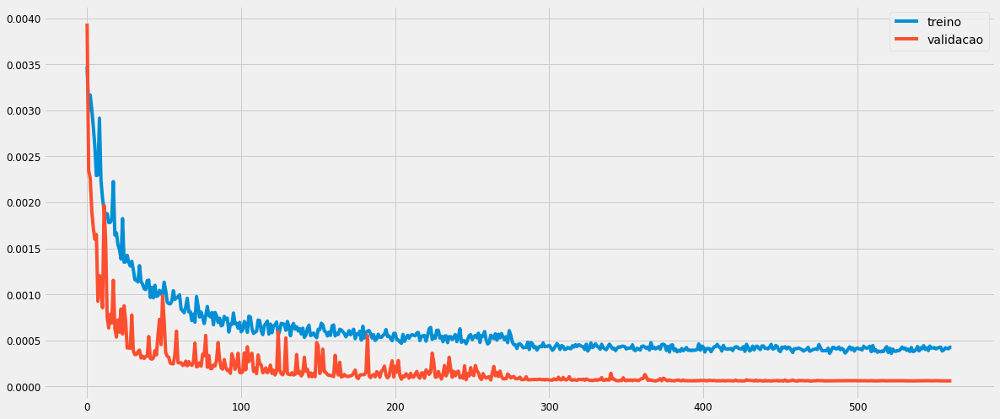

In [63]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [64]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [65]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[1.001267 ],
       [1.0118185],
       [1.0303452],
       [1.0549932],
       [1.0941747]], dtype=float32)

In [66]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[11118.978],
       [11218.732],
       [11393.884],
       [11626.905],
       [11997.328]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

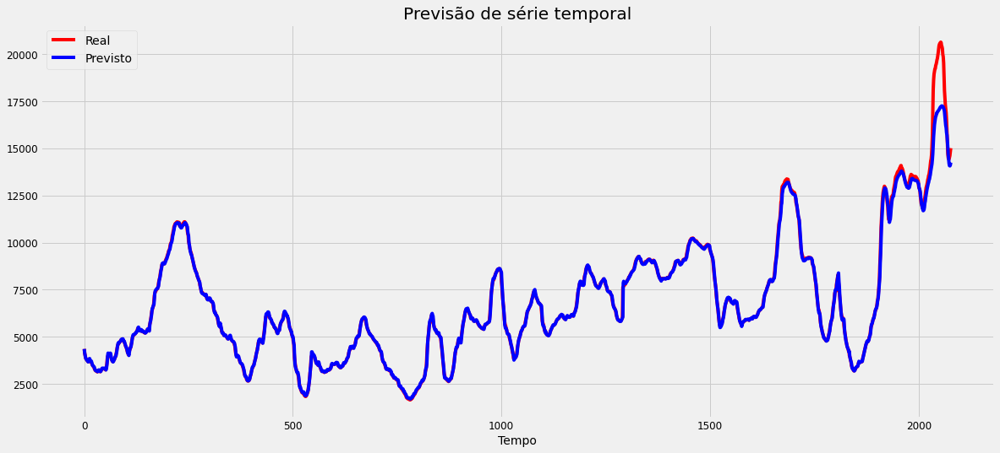

In [67]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

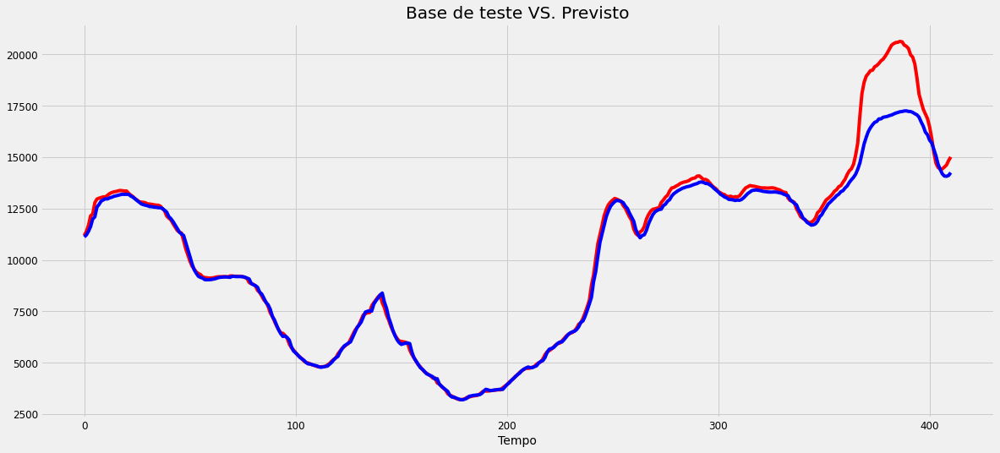

In [68]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [69]:
lstm_hs1_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_hs1_rmse)
lstm_hs1_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_hs1_mse)
lstm_hs1_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_hs1_mape, '%')
lstm_hs1_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  806.1313270575229
MSE:  649847.7164635229
MAPE:  2.328849981538831 %
R2:  0.9681730373254825


## HS2

### SARIMA

In [70]:
data = baltic.loc[baltic['Route'] == 'HS2'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS2'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).HS2.mean()
data.head()

Date
2013-01-31    3696.454545
2013-02-28    3149.600000
2013-03-31    3461.650000
2013-04-30    3936.047619
2013-05-31    4591.714286
Freq: M, Name: HS2, dtype: float64

#### Divisão da base

In [71]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [72]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [73]:
y = data.copy()
y.tail()

Date
2020-12-31    13435.222222
2021-01-31    12363.950000
2021-02-28    15352.900000
2021-03-31    19941.826087
2021-04-30    15609.000000
Freq: M, Name: HS2, dtype: float64

#### Exibição da série

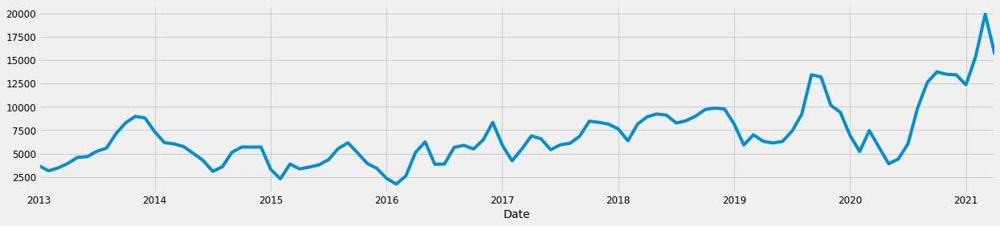

In [74]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

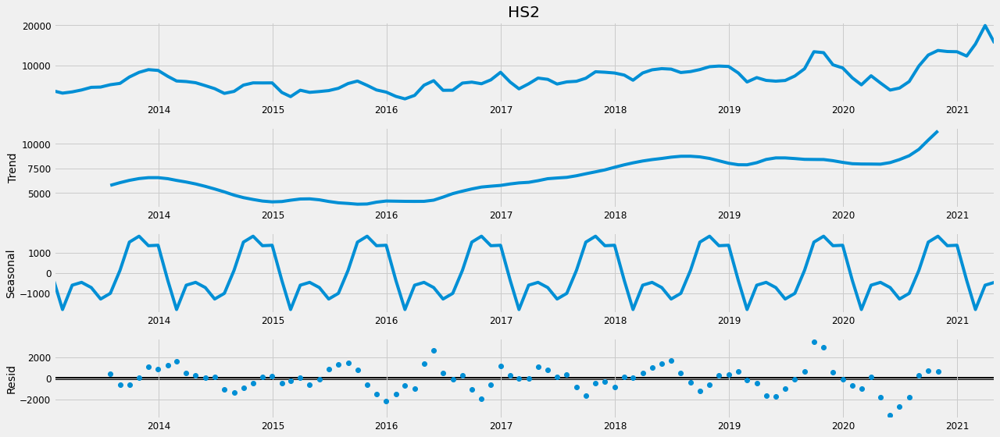

In [75]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [76]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [77]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2053.2372705095495
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1736.8652484576126
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1639.8089077796412
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1419.2040742071547
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1657.4424074115996
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1616.1447323882235
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1438.7397123163319
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1421.414728096949
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1957.8463609490734
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1618.7285147465805
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1535.0451926635258
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1323.9726592692464
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1571.6601186552311
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1507.856621086976
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1361.0125691661074
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1325.9701949709997
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1711.349007273748
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1495.306517734

#### Ajuste considerando o menor valor de AIC

In [78]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3530      0.226     -1.561      0.118      -0.796       0.090
ma.L1          0.8244      0.124      6.632      0.000       0.581       1.068
ar.S.L12      -0.0236      0.397     -0.059      0.953      -0.802       0.755
ma.S.L12      -0.5212      0.316     -1.652      0.099      -1.140       0.097
sigma2      1.779e+06   2.59e+05      6.864      0.000    1.27e+06    2.29e+06


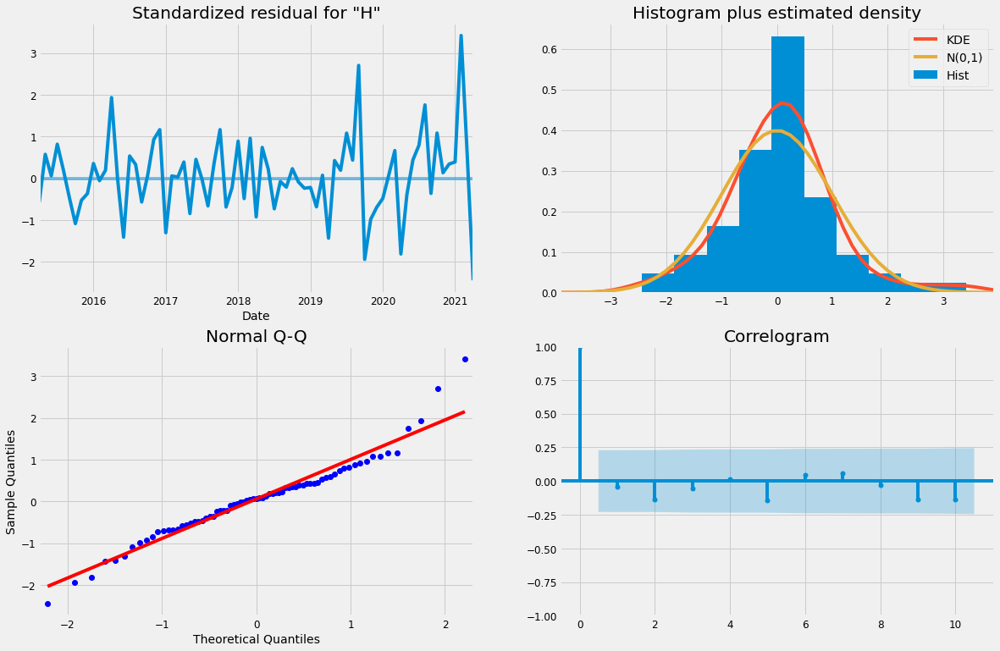

In [79]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

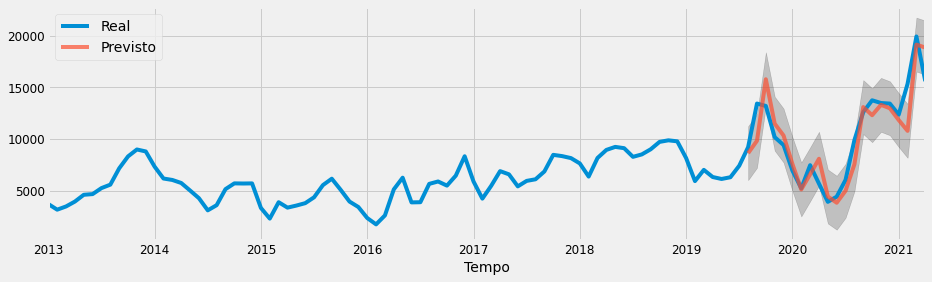

In [80]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [81]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_hs2_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_hs2_rmse)
sarima_hs2_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_hs2_mse)
sarima_hs2_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_hs2_mape, '%')
sarima_hs2_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  1848.0446053866276
MSE:  3415268.863498616
MAPE:  13.654029511619367 %
R2:  0.8049548288120318


### LSTM

#### Divisão da base

training_set

In [82]:
temp = baltic.loc[baltic['Route'] == 'HS2'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS2'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,HS2
47033,2013-01-02,4271.0
47034,2013-01-03,4057.0
47035,2013-01-04,3928.0
47036,2013-01-07,3811.0
47037,2013-01-08,3741.0


In [83]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[4271.],
       [4057.],
       [3928.],
       [3811.],
       [3741.]])

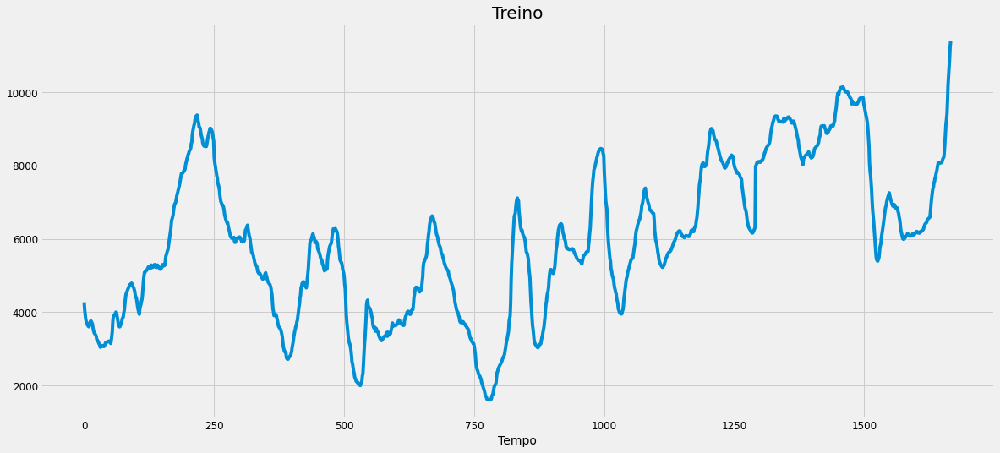

In [84]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [85]:
temp = data = baltic.loc[baltic['Route'] == 'HS2'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS2'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,HS2
48700,2019-09-02,11464.0
48701,2019-09-03,11682.0
48702,2019-09-04,11886.0
48703,2019-09-05,12600.0
48704,2019-09-06,12757.0


In [86]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[11464.],
       [11682.],
       [11886.],
       [12600.],
       [12757.]])

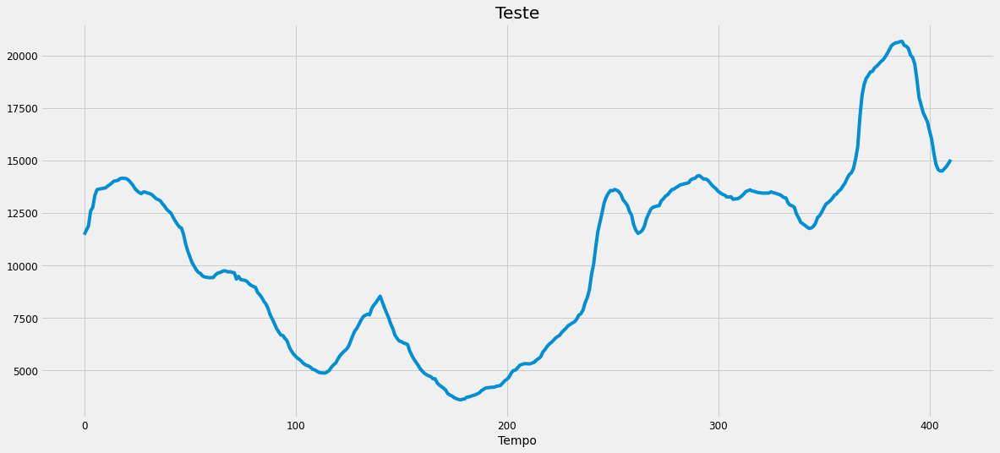

In [87]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

###### Treinamento

In [88]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1491 samples, validate on 166 samples
Epoch 1/1000
1491/1491 [==============================] - 1s 647us/step - loss: 3.9060e-04 - val_loss: 5.9999e-05
Epoch 2/1000
1491/1491 [==============================] - 1s 659us/step - loss: 4.0452e-04 - val_loss: 6.0131e-05
Epoch 3/1000
1491/1491 [==============================] - 1s 658us/step - loss: 4.1378e-04 - val_loss: 6.0247e-05
Epoch 4/1000
1491/1491 [==============================] - 1s 767us/step - loss: 4.0220e-04 - val_loss: 6.1193e-05
Epoch 5/1000
1491/1491 [==============================] - 1s 799us/step - loss: 4.3951e-04 - val_loss: 6.1381e-05
Epoch 6/1000
1491/1491 [==============================] - 1s 810us/step - loss: 3.8171e-04 - val_loss: 6.0129e-05
Epoch 7/1000
1491/1491 [==============================] - 1s 830us/step - loss: 3.9208e-04 - val_loss: 6.0198e-05
Epoch 8/1000
1491/1491 [==============================] - 1s 751us/step - loss: 4.0518e-04 - val_loss: 6.0459e-05
Epoch 9/1000
1491/1491 [=================

Epoch 72/1000
1491/1491 [==============================] - 1s 754us/step - loss: 3.7927e-04 - val_loss: 6.1520e-05
Epoch 73/1000
1491/1491 [==============================] - 1s 754us/step - loss: 4.0198e-04 - val_loss: 6.1123e-05
Epoch 74/1000
1491/1491 [==============================] - 1s 771us/step - loss: 4.4522e-04 - val_loss: 6.0588e-05
Epoch 75/1000
1491/1491 [==============================] - 1s 794us/step - loss: 3.9371e-04 - val_loss: 5.9801e-05
Epoch 76/1000
1491/1491 [==============================] - 1s 805us/step - loss: 3.9863e-04 - val_loss: 6.0379e-05
Epoch 77/1000
1491/1491 [==============================] - 1s 820us/step - loss: 4.1203e-04 - val_loss: 6.0123e-05
Epoch 78/1000
1491/1491 [==============================] - 1s 769us/step - loss: 4.3358e-04 - val_loss: 5.9608e-05
Epoch 79/1000
1491/1491 [==============================] - 1s 784us/step - loss: 3.8158e-04 - val_loss: 5.9780e-05
Epoch 80/1000
1491/1491 [==============================] - 1s 768us/step - loss:

Epoch 143/1000
1491/1491 [==============================] - 1s 749us/step - loss: 4.0809e-04 - val_loss: 6.0364e-05
Epoch 144/1000
1491/1491 [==============================] - 1s 764us/step - loss: 4.0026e-04 - val_loss: 6.0322e-05
Epoch 145/1000
1491/1491 [==============================] - 1s 802us/step - loss: 4.1309e-04 - val_loss: 6.0375e-05
Epoch 146/1000
1491/1491 [==============================] - 1s 839us/step - loss: 4.1937e-04 - val_loss: 6.0368e-05
Epoch 147/1000
1491/1491 [==============================] - 1s 798us/step - loss: 4.2236e-04 - val_loss: 6.0301e-05
Epoch 148/1000
1491/1491 [==============================] - 1s 767us/step - loss: 4.0913e-04 - val_loss: 6.0272e-05
Epoch 149/1000
1491/1491 [==============================] - 1s 746us/step - loss: 4.1660e-04 - val_loss: 6.0231e-05
Epoch 150/1000
1491/1491 [==============================] - 1s 763us/step - loss: 4.1726e-04 - val_loss: 6.0249e-05
Epoch 151/1000
1491/1491 [==============================] - 1s 785us/ste

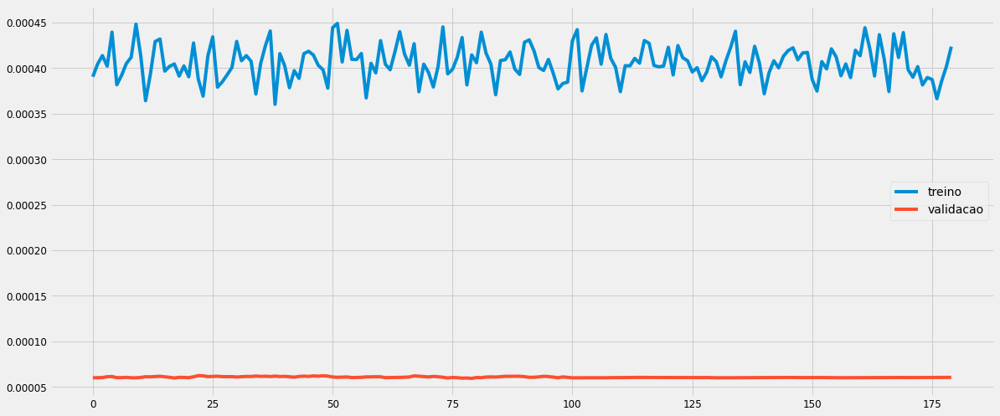

In [89]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [90]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [91]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[1.0284283],
       [1.0394945],
       [1.0594172],
       [1.0758815],
       [1.1333573]], dtype=float32)

In [92]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[11375.762],
       [11480.382],
       [11668.73 ],
       [11824.384],
       [12367.76 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

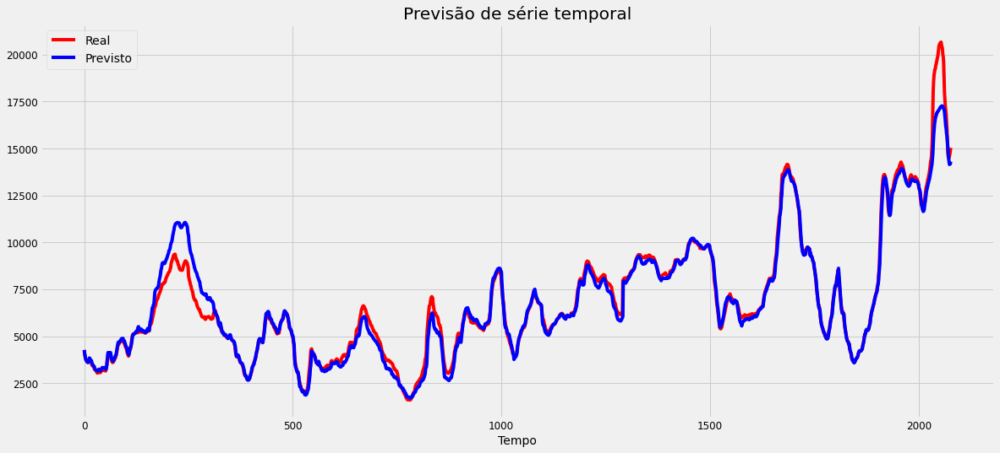

In [93]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

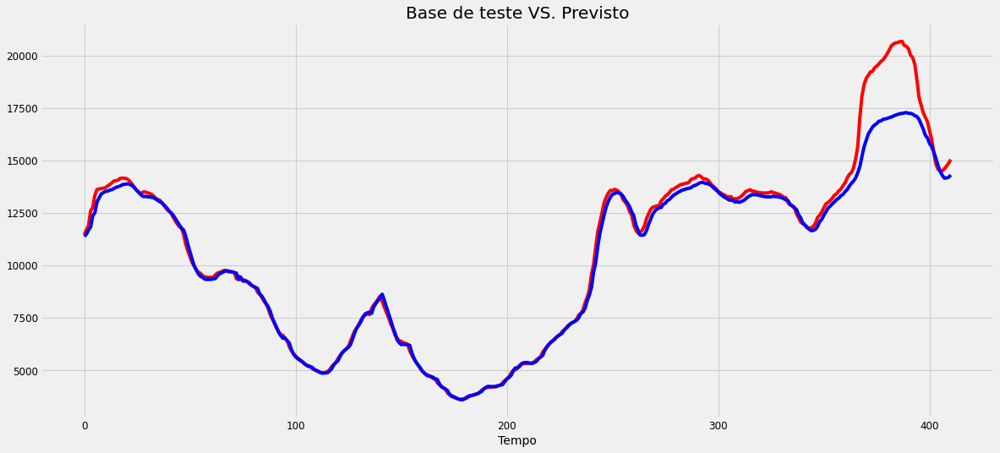

In [94]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [95]:
lstm_hs2_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_hs2_rmse)
lstm_hs2_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_hs2_mse)
lstm_hs2_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_hs2_mape, '%')
lstm_hs2_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  810.9058388641338
MSE:  657568.2795039444
MAPE:  2.3828349223778797 %
R2:  0.9661735529870804


## HS3

### SARIMA

In [96]:
data = baltic.loc[baltic['Route'] == 'HS3'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS3'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).HS3.mean()
data.head()

Date
2013-01-31    11062.909091
2013-02-28    11414.750000
2013-03-31    11839.700000
2013-04-30    13835.761905
2013-05-31    14895.333333
Freq: M, Name: HS3, dtype: float64

#### Divisão da base

In [97]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [98]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [99]:
y = data.copy()
y.tail()

Date
2020-12-31    14425.611111
2021-01-31    13917.900000
2021-02-28    19317.100000
2021-03-31    30207.565217
2021-04-30    17528.000000
Freq: M, Name: HS3, dtype: float64

#### Exibição da série

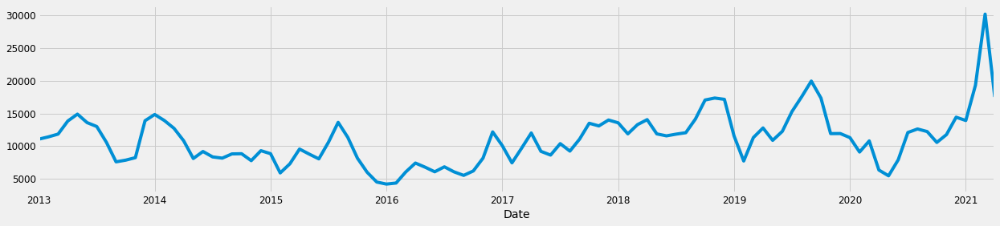

In [100]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

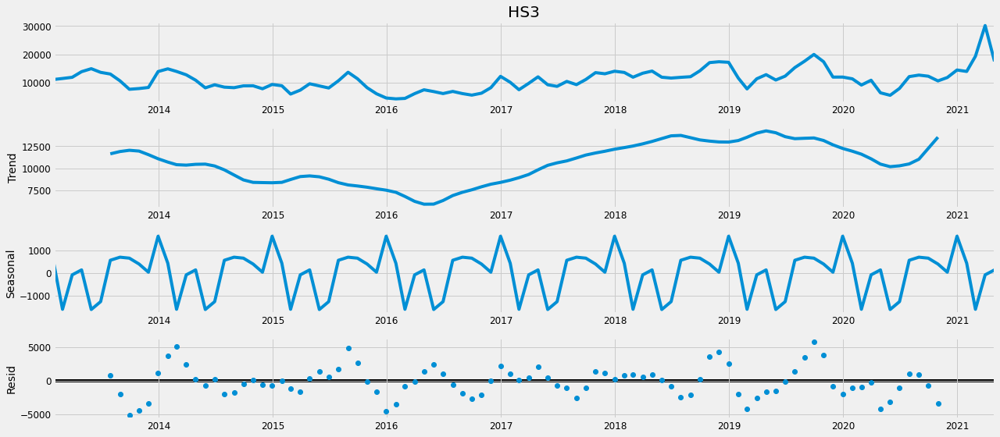

In [101]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [102]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [103]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2137.551456410888
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1839.6565476911092
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1719.6321083949524
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1481.7374996830779
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1740.3647313108456
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1710.9113735005187
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1506.7632991754454
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1483.5984685014641
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:2042.0528755637115
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1778.8340256921051
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1626.3952645057577
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1395.7665115506436
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1812.3919965443874
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1614.378308591579
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1437.0226604486395
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1397.713359717787
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1829.6932425652244
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1609.042299461

#### Ajuste considerando o menor valor de AIC

In [104]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1342      0.253     -0.530      0.596      -0.631       0.362
ma.L1          0.6484      0.230      2.824      0.005       0.198       1.098
ar.S.L12      -0.0205      0.818     -0.025      0.980      -1.623       1.582
ma.S.L12      -0.3304      0.811     -0.407      0.684      -1.919       1.259
sigma2      7.807e+06   1.26e+06      6.197      0.000    5.34e+06    1.03e+07


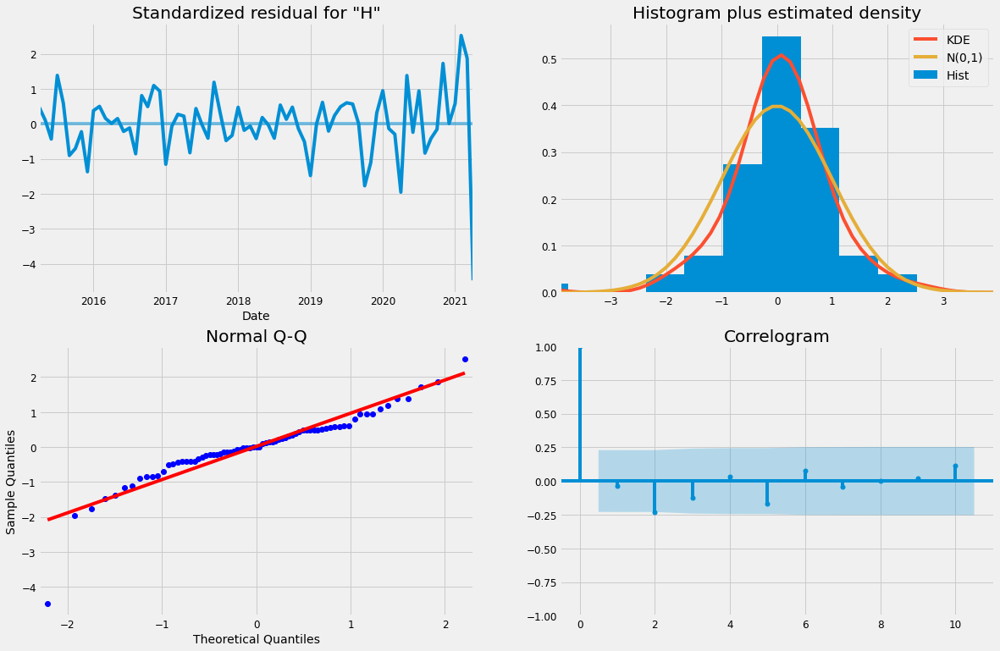

In [105]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

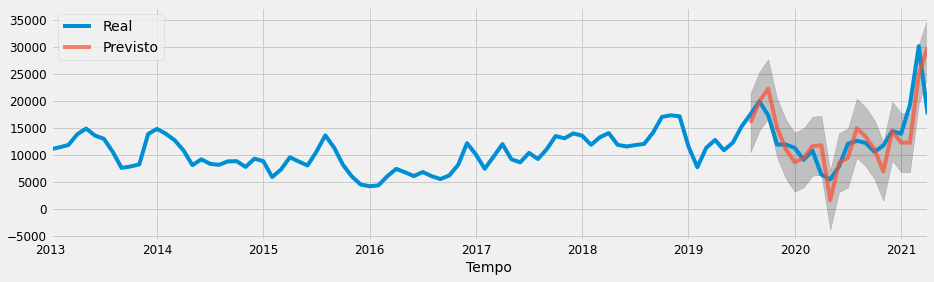

In [106]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [107]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_hs3_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_hs3_rmse)
sarima_hs3_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_hs3_mse)
sarima_hs3_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_hs3_mape, '%')
sarima_hs3_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  4161.745342619687
MSE:  17320124.29681666
MAPE:  23.98848576263087 %
R2:  0.39721855371286385


Previsto

In [108]:
y_forecasted = pred.predicted_mean
y_forecasted.head(12)

Date
2019-08-31    15957.425166
2019-09-30    19946.119724
2019-10-31    22297.964463
2019-11-30    15014.268801
2019-12-31    11041.442468
2020-01-31     8642.399905
2020-02-29     9461.818657
2020-03-31    11615.107729
2020-04-30    11785.248081
2020-05-31     1586.012379
2020-06-30     8563.973704
2020-07-31     9444.435736
Freq: M, Name: predicted_mean, dtype: float64

Realizado

In [109]:
y_truth.head(12)

Date
2019-08-31    17547.333333
2019-09-30    19954.619048
2019-10-31    17355.391304
2019-11-30    11910.904762
2019-12-31    11921.882353
2020-01-31    11298.000000
2020-02-29     9090.350000
2020-03-31    10791.681818
2020-04-30     6333.100000
2020-05-31     5450.157895
2020-06-30     7896.181818
2020-07-31    12082.043478
Freq: M, Name: HS3, dtype: float64

### LSTM

#### Divisão da base

training_set

In [110]:
temp = baltic.loc[baltic['Route'] == 'HS3'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS3'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,HS3
49111,2013-01-02,8903.0
49112,2013-01-03,9111.0
49113,2013-01-04,9189.0
49114,2013-01-07,9311.0
49115,2013-01-08,9478.0


In [111]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[8903.],
       [9111.],
       [9189.],
       [9311.],
       [9478.]])

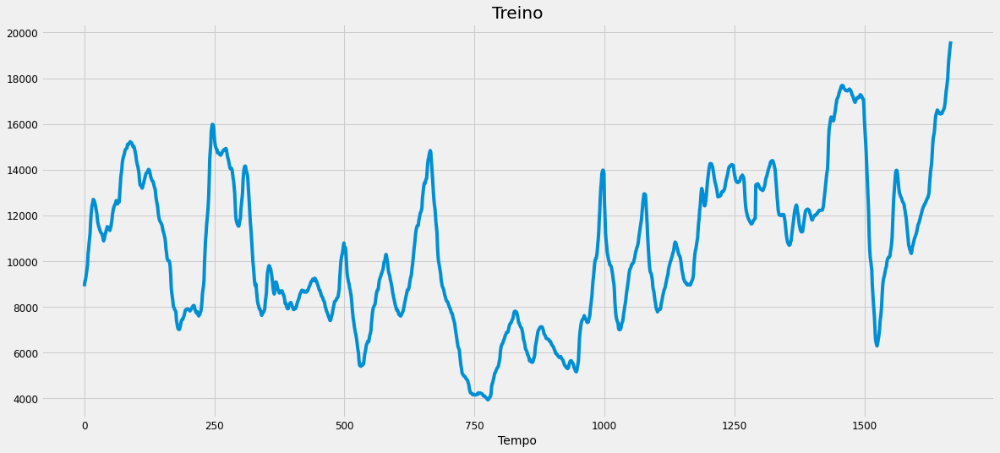

In [112]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [113]:
temp = baltic.loc[baltic['Route'] == 'HS3'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS3'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,HS3
50778,2019-09-02,19744.0
50779,2019-09-03,19817.0
50780,2019-09-04,19889.0
50781,2019-09-05,19939.0
50782,2019-09-06,19942.0


In [114]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[19744.],
       [19817.],
       [19889.],
       [19939.],
       [19942.]])

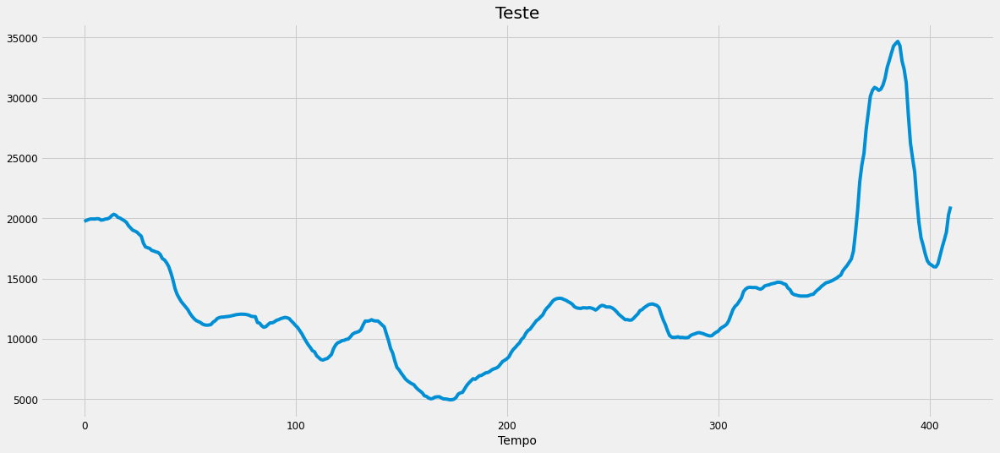

In [115]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [116]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [117]:
training_set_scaled[0:5]

array([[0.31674324],
       [0.33001531],
       [0.33499234],
       [0.34277693],
       [0.35343287]])

##### Criar a estrutura de dados

In [118]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [119]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.316743,0.330015,0.334992,0.342777,0.353433,0.364025,0.375383,0.406713,0.418645,0.436383
1,0.330015,0.334992,0.342777,0.353433,0.364025,0.375383,0.406713,0.418645,0.436383,0.449847
2,0.334992,0.342777,0.353433,0.364025,0.375383,0.406713,0.418645,0.436383,0.449847,0.464714
3,0.342777,0.353433,0.364025,0.375383,0.406713,0.418645,0.436383,0.449847,0.464714,0.496618
4,0.353433,0.364025,0.375383,0.406713,0.418645,0.436383,0.449847,0.464714,0.496618,0.517547


In [120]:
pd.DataFrame(y_train).head()

,0
0,0.449847
1,0.464714
2,0.496618
3,0.517547
4,0.533499


##### *Reshaping*

In [121]:
X_train.shape

(1657, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [122]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [123]:
X_train.shape

(1657, 10, 1)

##### Construção da RNN

###### Bibliotecas necessárias

In [124]:
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout

###### Construção da Rede completa

In [125]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_4 (LSTM)                (None, 10, 100)           40800     
_________________________________________________________________
dropout_4 (Dropout)          (None, 10, 100)           0         
_________________________________________________________________
lstm_5 (LSTM)                (None, 10, 80)            57920     
_________________________________________________________________
dropout_5 (Dropout)          (None, 10, 80)            0         
_________________________________________________________________
lstm_6 (LSTM)                (None, 50)                26200     
_________________________________________________________________
dropout_6 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                

###### Treinamento

In [126]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1491 samples, validate on 166 samples
Epoch 1/1000
1491/1491 [==============================] - 2s 1ms/step - loss: 0.0260 - val_loss: 0.0103
Epoch 2/1000
1491/1491 [==============================] - 1s 738us/step - loss: 0.0051 - val_loss: 0.0086
Epoch 3/1000
1491/1491 [==============================] - 1s 758us/step - loss: 0.0048 - val_loss: 0.0090
Epoch 4/1000
1491/1491 [==============================] - 1s 749us/step - loss: 0.0050 - val_loss: 0.0080
Epoch 5/1000
1491/1491 [==============================] - 1s 761us/step - loss: 0.0044 - val_loss: 0.0092
Epoch 6/1000
1491/1491 [==============================] - 1s 790us/step - loss: 0.0045 - val_loss: 0.0076
Epoch 7/1000
1491/1491 [==============================] - 1s 800us/step - loss: 0.0038 - val_loss: 0.0068
Epoch 8/1000
1491/1491 [==============================] - 1s 772us/step - loss: 0.0039 - val_loss: 0.0061
Epoch 9/1000
1491/1491 [==============================] - 1s 753us/step - loss: 0.0033 - val_loss: 0.0058
E

1491/1491 [==============================] - 1s 854us/step - loss: 6.3750e-04 - val_loss: 2.9001e-04
Epoch 75/1000
1491/1491 [==============================] - 1s 780us/step - loss: 6.0677e-04 - val_loss: 3.3280e-04
Epoch 76/1000
1491/1491 [==============================] - 1s 794us/step - loss: 5.7213e-04 - val_loss: 4.0223e-04
Epoch 77/1000
1491/1491 [==============================] - 1s 789us/step - loss: 6.6311e-04 - val_loss: 2.9648e-04
Epoch 78/1000
1491/1491 [==============================] - 1s 776us/step - loss: 6.0997e-04 - val_loss: 3.8969e-04
Epoch 79/1000
1491/1491 [==============================] - 1s 783us/step - loss: 6.0175e-04 - val_loss: 3.7723e-04
Epoch 80/1000
1491/1491 [==============================] - 1s 767us/step - loss: 5.6860e-04 - val_loss: 4.3496e-04
Epoch 81/1000
1491/1491 [==============================] - 1s 768us/step - loss: 5.9556e-04 - val_loss: 6.1191e-04
Epoch 82/1000
1491/1491 [==============================] - 1s 766us/step - loss: 6.6411e-04 - 

Epoch 145/1000
1491/1491 [==============================] - 1s 759us/step - loss: 4.7069e-04 - val_loss: 1.5482e-04
Epoch 146/1000
1491/1491 [==============================] - 1s 761us/step - loss: 5.0733e-04 - val_loss: 1.2288e-04
Epoch 147/1000
1491/1491 [==============================] - 1s 770us/step - loss: 4.2704e-04 - val_loss: 3.8737e-04
Epoch 148/1000
1491/1491 [==============================] - 1s 792us/step - loss: 4.5897e-04 - val_loss: 1.7193e-04
Epoch 149/1000
1491/1491 [==============================] - 1s 803us/step - loss: 5.1512e-04 - val_loss: 1.6939e-04
Epoch 150/1000
1491/1491 [==============================] - 1s 784us/step - loss: 4.6962e-04 - val_loss: 1.1476e-04
Epoch 151/1000
1491/1491 [==============================] - 1s 795us/step - loss: 4.9450e-04 - val_loss: 3.0126e-04
Epoch 152/1000
1491/1491 [==============================] - 1s 785us/step - loss: 4.4466e-04 - val_loss: 5.0876e-04
Epoch 153/1000
1491/1491 [==============================] - 1s 793us/ste

1491/1491 [==============================] - 1s 768us/step - loss: 4.1182e-04 - val_loss: 1.3358e-04
Epoch 216/1000
1491/1491 [==============================] - 1s 770us/step - loss: 3.7833e-04 - val_loss: 1.7783e-04
Epoch 217/1000
1491/1491 [==============================] - 1s 767us/step - loss: 4.9633e-04 - val_loss: 4.5304e-04
Epoch 218/1000
1491/1491 [==============================] - 1s 770us/step - loss: 3.7451e-04 - val_loss: 1.0535e-04
Epoch 219/1000
1491/1491 [==============================] - 1s 772us/step - loss: 5.0551e-04 - val_loss: 1.8847e-04
Epoch 220/1000
1491/1491 [==============================] - 1s 766us/step - loss: 4.4658e-04 - val_loss: 1.0851e-04
Epoch 221/1000
1491/1491 [==============================] - 1s 792us/step - loss: 3.9380e-04 - val_loss: 9.2808e-05
Epoch 222/1000
1491/1491 [==============================] - 1s 810us/step - loss: 4.3305e-04 - val_loss: 9.4942e-05
Epoch 223/1000
1491/1491 [==============================] - 1s 815us/step - loss: 3.917

Epoch 286/1000
1491/1491 [==============================] - 1s 820us/step - loss: 3.0750e-04 - val_loss: 7.8572e-05
Epoch 287/1000
1491/1491 [==============================] - 1s 883us/step - loss: 3.0778e-04 - val_loss: 7.1770e-05
Epoch 288/1000
1491/1491 [==============================] - 1s 883us/step - loss: 2.8490e-04 - val_loss: 7.5187e-05
Epoch 289/1000
1491/1491 [==============================] - 1s 854us/step - loss: 3.0873e-04 - val_loss: 6.7627e-05
Epoch 290/1000
1491/1491 [==============================] - 1s 807us/step - loss: 3.2142e-04 - val_loss: 9.1783e-05
Epoch 291/1000
1491/1491 [==============================] - 1s 821us/step - loss: 3.4103e-04 - val_loss: 7.0998e-05
Epoch 292/1000
1491/1491 [==============================] - 1s 825us/step - loss: 3.2045e-04 - val_loss: 8.2350e-05
Epoch 293/1000
1491/1491 [==============================] - 1s 779us/step - loss: 3.2842e-04 - val_loss: 7.6369e-05
Epoch 294/1000
1491/1491 [==============================] - 1s 801us/ste

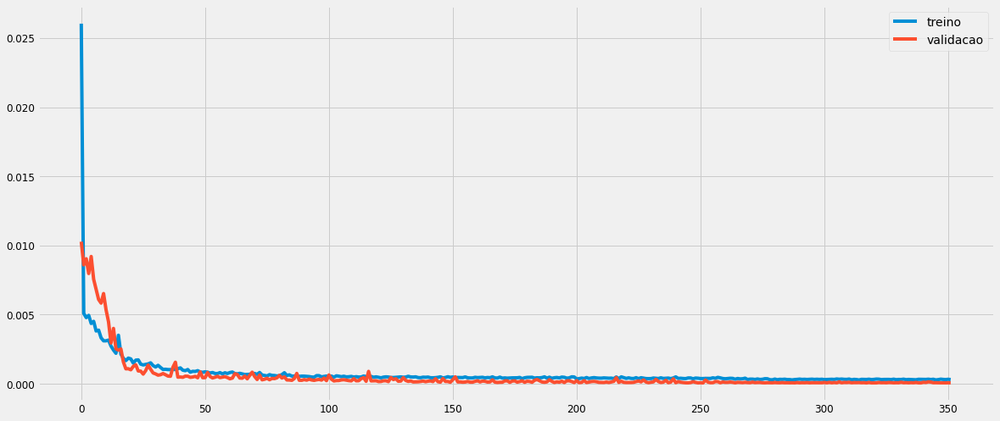

In [127]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [128]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [129]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[1.0072966],
       [1.0160546],
       [1.018101 ],
       [1.0224667],
       [1.0247601]], dtype=float32)

In [130]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[19725.352],
       [19862.607],
       [19894.678],
       [19963.096],
       [19999.04 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

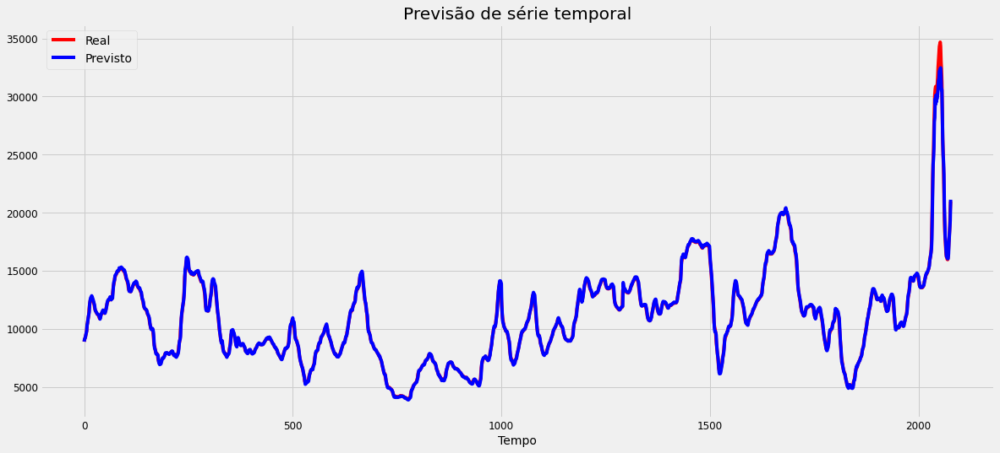

In [131]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

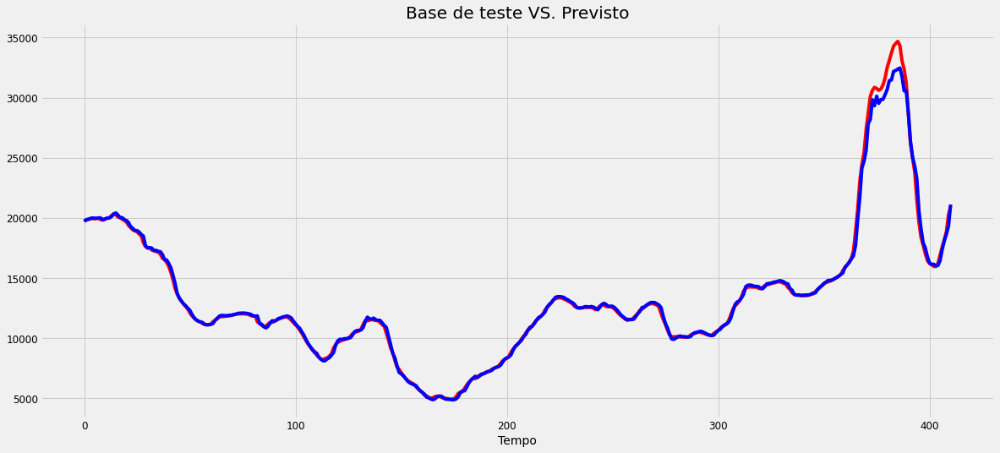

In [132]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [133]:
lstm_hs3_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_hs3_rmse)
lstm_hs3_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_hs3_mse)
lstm_hs3_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_hs3_mape, '%')
lstm_hs3_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  406.83311076781627
MSE:  165513.18001701825
MAPE:  1.1279212688204872 %
R2:  0.9950609851987031


## HS4

### SARIMA

In [134]:
data = baltic.loc[baltic['Route'] == 'HS4'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS4'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).HS4.mean()
data.head()

Date
2013-01-31    10254.136364
2013-02-28    10551.550000
2013-03-31    13308.250000
2013-04-30    14561.333333
2013-05-31    14685.761905
Freq: M, Name: HS4, dtype: float64

#### Divisão da base

In [135]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [136]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [137]:
y = data.copy()
y.tail()

Date
2020-12-31    15491.277778
2021-01-31    15637.100000
2021-02-28    18713.400000
2021-03-31    22207.347826
2021-04-30    13499.733333
Freq: M, Name: HS4, dtype: float64

#### Exibição da série

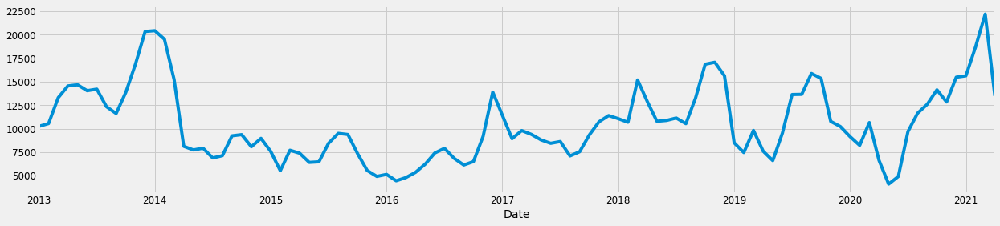

In [138]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

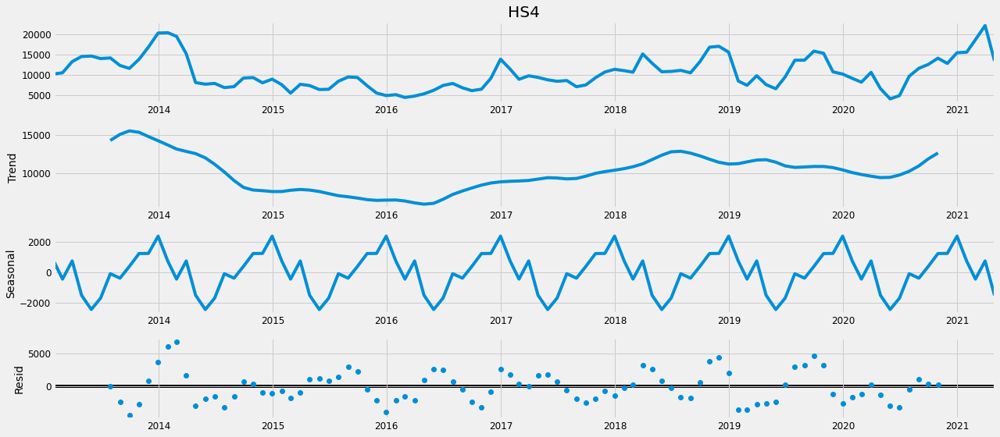

In [139]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [140]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [141]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2129.7990808501236
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1822.119949562604
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1726.915981405959
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1454.9222423025187
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1746.8030748266726
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1693.0395242604216
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1496.3581940401746
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1456.648066047256
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:2033.1086290497299
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1771.6427637984737
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1618.174599043818
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1356.7698377861987
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1654.7711947840992
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1570.7762786428955
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1432.532956877158
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1358.7179502947974
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1800.4124483422418
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1582.37943405512

#### Ajuste considerando o menor valor de AIC

In [142]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0324      0.219      0.148      0.882      -0.397       0.461
ma.L1          0.5578      0.207      2.698      0.007       0.153       0.963
ar.S.L12      -0.1793      0.183     -0.981      0.327      -0.538       0.179
ma.S.L12      -0.4658      0.194     -2.404      0.016      -0.846      -0.086
sigma2       3.66e+06   6.71e+05      5.457      0.000    2.35e+06    4.97e+06


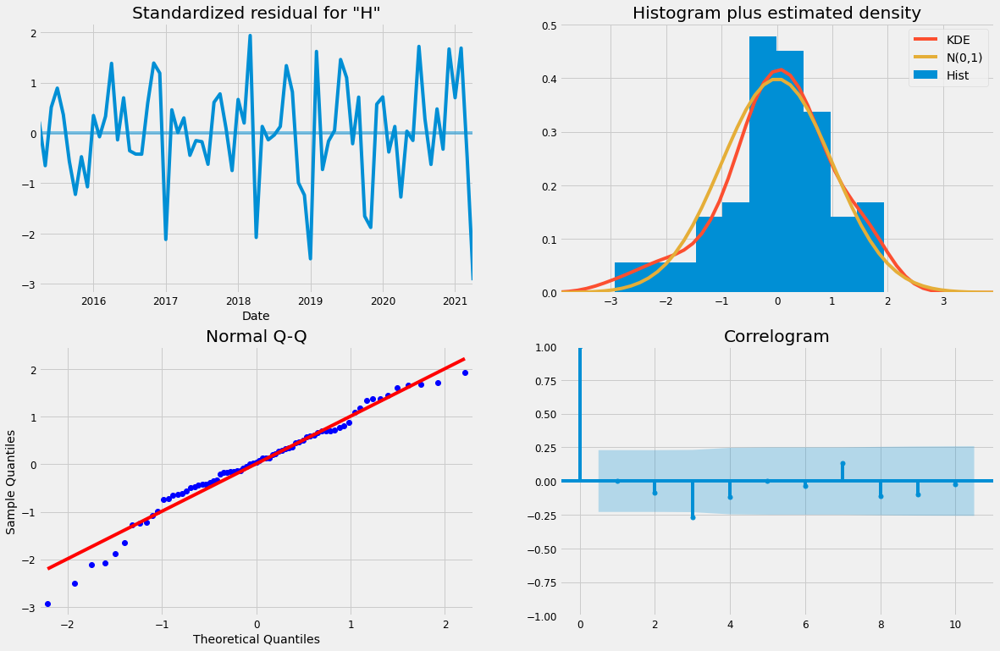

In [143]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

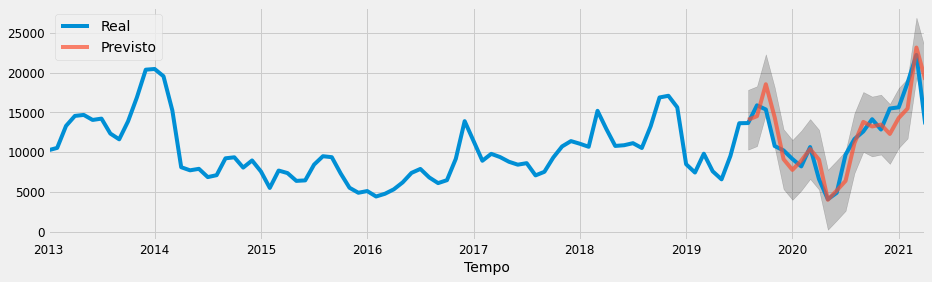

In [144]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [145]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_hs4_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_hs4_rmse)
sarima_hs4_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_hs4_mse)
sarima_hs4_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_hs4_mape, '%')
sarima_hs4_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  2214.496824683955
MSE:  4903996.186535318
MAPE:  14.168960360392838 %
R2:  0.7333681403525907


### LSTM

#### Divisão da base

training_set

In [146]:
temp = baltic.loc[baltic['Route'] == 'HS4'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS4'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,HS4
51189,2013-01-02,8469.0
51190,2013-01-03,8944.0
51191,2013-01-04,9138.0
51192,2013-01-07,9263.0
51193,2013-01-08,9338.0


In [147]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[8469.],
       [8944.],
       [9138.],
       [9263.],
       [9338.]])

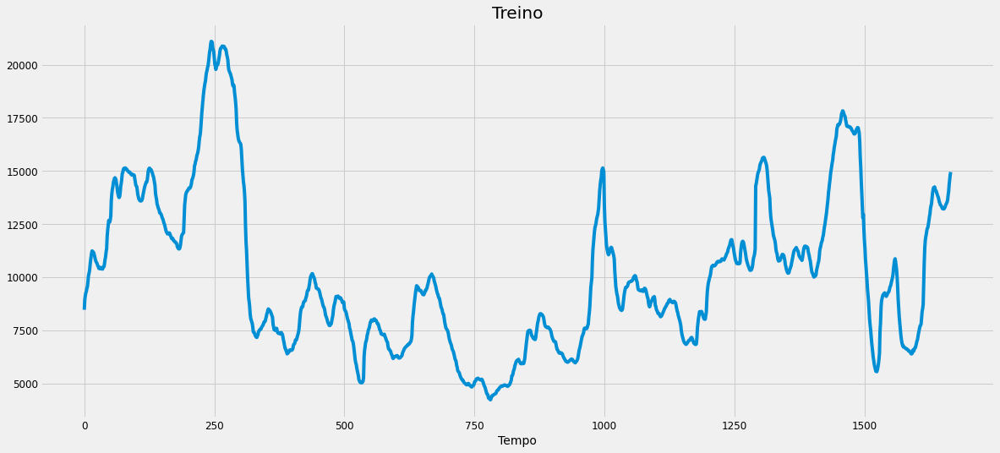

In [148]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [149]:
temp = baltic.loc[baltic['Route'] == 'HS4'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS4'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,HS4
52856,2019-09-02,15106.0
52857,2019-09-03,15213.0
52858,2019-09-04,15394.0
52859,2019-09-05,15556.0
52860,2019-09-06,15613.0


In [150]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[15106.],
       [15213.],
       [15394.],
       [15556.],
       [15613.]])

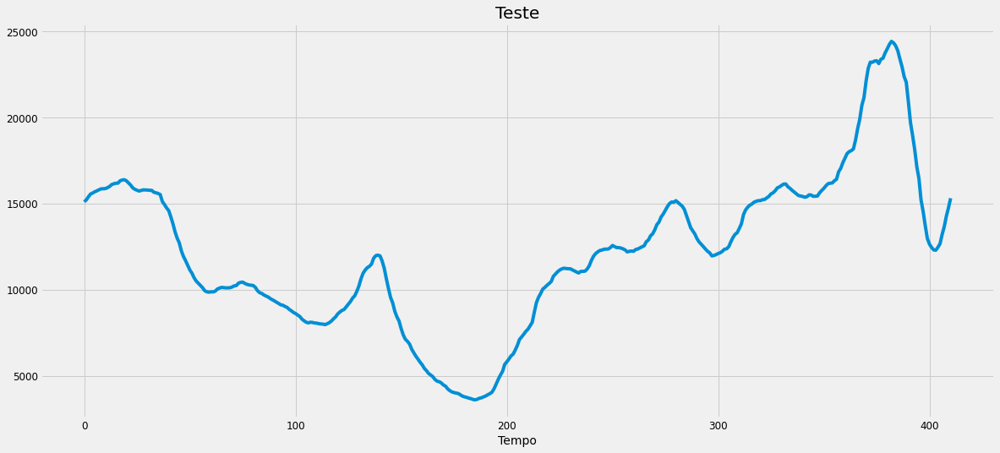

In [151]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [152]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [153]:
training_set_scaled[0:5]

array([[0.25131883],
       [0.27947365],
       [0.29097268],
       [0.29838184],
       [0.30282734]])

##### Criar a estrutura de dados

In [154]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [155]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.251319,0.279474,0.290973,0.298382,0.302827,0.310889,0.315334,0.328730,0.345386,0.352795
1,0.279474,0.290973,0.298382,0.302827,0.310889,0.315334,0.328730,0.345386,0.352795,0.359137
2,0.290973,0.298382,0.302827,0.310889,0.315334,0.328730,0.345386,0.352795,0.359137,0.374311
3,0.298382,0.302827,0.310889,0.315334,0.328730,0.345386,0.352795,0.359137,0.374311,0.386877
4,0.302827,0.310889,0.315334,0.328730,0.345386,0.352795,0.359137,0.374311,0.386877,0.398732


In [156]:
pd.DataFrame(y_train).head()

,0
0,0.359137
1,0.374311
2,0.386877
3,0.398732
4,0.408334


##### *Reshaping*

In [157]:
X_train.shape

(1657, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [158]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [159]:
X_train.shape

(1657, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [160]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_7 (LSTM)                (None, 10, 100)           40800     
_________________________________________________________________
dropout_7 (Dropout)          (None, 10, 100)           0         
_________________________________________________________________
lstm_8 (LSTM)                (None, 10, 80)            57920     
_________________________________________________________________
dropout_8 (Dropout)          (None, 10, 80)            0         
_________________________________________________________________
lstm_9 (LSTM)                (None, 50)                26200     
_________________________________________________________________
dropout_9 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                

###### Treinamento

In [161]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1491 samples, validate on 166 samples
Epoch 1/1000
1491/1491 [==============================] - 2s 1ms/step - loss: 0.0278 - val_loss: 0.0069
Epoch 2/1000
1491/1491 [==============================] - 1s 662us/step - loss: 0.0044 - val_loss: 0.0064
Epoch 3/1000
1491/1491 [==============================] - 1s 672us/step - loss: 0.0043 - val_loss: 0.0063
Epoch 4/1000
1491/1491 [==============================] - 1s 664us/step - loss: 0.0040 - val_loss: 0.0064
Epoch 5/1000
1491/1491 [==============================] - 1s 675us/step - loss: 0.0040 - val_loss: 0.0072
Epoch 6/1000
1491/1491 [==============================] - 1s 697us/step - loss: 0.0038 - val_loss: 0.0068
Epoch 7/1000
1491/1491 [==============================] - 1s 659us/step - loss: 0.0035 - val_loss: 0.0070
Epoch 8/1000
1491/1491 [==============================] - 1s 659us/step - loss: 0.0036 - val_loss: 0.0051
Epoch 9/1000
1491/1491 [==============================] - 1s 674us/step - loss: 0.0039 - val_loss: 0.0057
E

1491/1491 [==============================] - 1s 789us/step - loss: 7.4447e-04 - val_loss: 3.6733e-04
Epoch 75/1000
1491/1491 [==============================] - 1s 799us/step - loss: 6.7007e-04 - val_loss: 3.0651e-04
Epoch 76/1000
1491/1491 [==============================] - 1s 777us/step - loss: 6.2908e-04 - val_loss: 2.8242e-04
Epoch 77/1000
1491/1491 [==============================] - 1s 809us/step - loss: 6.8958e-04 - val_loss: 2.7993e-04
Epoch 78/1000
1491/1491 [==============================] - 1s 785us/step - loss: 7.9306e-04 - val_loss: 2.8590e-04
Epoch 79/1000
1491/1491 [==============================] - 1s 825us/step - loss: 7.4948e-04 - val_loss: 3.4162e-04
Epoch 80/1000
1491/1491 [==============================] - 1s 856us/step - loss: 6.7654e-04 - val_loss: 3.2930e-04
Epoch 81/1000
1491/1491 [==============================] - 1s 920us/step - loss: 6.5296e-04 - val_loss: 3.7393e-04
Epoch 82/1000
1491/1491 [==============================] - 1s 876us/step - loss: 6.7104e-04 - 

Epoch 145/1000
1491/1491 [==============================] - 1s 783us/step - loss: 5.2527e-04 - val_loss: 1.4145e-04
Epoch 146/1000
1491/1491 [==============================] - 1s 776us/step - loss: 5.5704e-04 - val_loss: 2.2951e-04
Epoch 147/1000
1491/1491 [==============================] - 1s 859us/step - loss: 4.9123e-04 - val_loss: 2.9993e-04
Epoch 148/1000
1491/1491 [==============================] - 1s 847us/step - loss: 5.3377e-04 - val_loss: 1.5989e-04
Epoch 149/1000
1491/1491 [==============================] - 1s 849us/step - loss: 5.3198e-04 - val_loss: 1.3538e-04
Epoch 150/1000
1491/1491 [==============================] - 1s 811us/step - loss: 5.0930e-04 - val_loss: 1.6643e-04
Epoch 151/1000
1491/1491 [==============================] - 1s 795us/step - loss: 5.7452e-04 - val_loss: 1.3047e-04
Epoch 152/1000
1491/1491 [==============================] - 1s 786us/step - loss: 5.1492e-04 - val_loss: 1.8462e-04
Epoch 153/1000
1491/1491 [==============================] - 1s 784us/ste

1491/1491 [==============================] - 1s 795us/step - loss: 4.7961e-04 - val_loss: 8.5684e-05
Epoch 216/1000
1491/1491 [==============================] - 1s 814us/step - loss: 5.5169e-04 - val_loss: 1.3409e-04
Epoch 217/1000
1491/1491 [==============================] - 1s 836us/step - loss: 4.8764e-04 - val_loss: 1.2220e-04
Epoch 218/1000
1491/1491 [==============================] - 1s 771us/step - loss: 5.5019e-04 - val_loss: 1.4328e-04
Epoch 219/1000
1491/1491 [==============================] - 1s 780us/step - loss: 4.6224e-04 - val_loss: 1.0346e-04
Epoch 220/1000
1491/1491 [==============================] - 1s 786us/step - loss: 5.0049e-04 - val_loss: 1.1284e-04
Epoch 221/1000
1491/1491 [==============================] - 1s 756us/step - loss: 4.8622e-04 - val_loss: 1.1682e-04
Epoch 222/1000
1491/1491 [==============================] - 1s 766us/step - loss: 4.6742e-04 - val_loss: 1.0565e-04
Epoch 223/1000
1491/1491 [==============================] - 1s 753us/step - loss: 4.338

1491/1491 [==============================] - 1s 809us/step - loss: 3.6213e-04 - val_loss: 7.4032e-05
Epoch 286/1000
1491/1491 [==============================] - 1s 788us/step - loss: 3.5948e-04 - val_loss: 7.2542e-05
Epoch 287/1000
1491/1491 [==============================] - 1s 801us/step - loss: 4.1007e-04 - val_loss: 7.7018e-05
Epoch 288/1000
1491/1491 [==============================] - 1s 756us/step - loss: 3.8918e-04 - val_loss: 7.2450e-05
Epoch 289/1000
1491/1491 [==============================] - 1s 758us/step - loss: 3.9797e-04 - val_loss: 7.1494e-05
Epoch 290/1000
1491/1491 [==============================] - 1s 778us/step - loss: 3.9010e-04 - val_loss: 7.8333e-05
Epoch 291/1000
1491/1491 [==============================] - 1s 767us/step - loss: 3.8317e-04 - val_loss: 7.3193e-05
Epoch 292/1000
1491/1491 [==============================] - 1s 771us/step - loss: 4.0047e-04 - val_loss: 7.4125e-05
Epoch 293/1000
1491/1491 [==============================] - 1s 783us/step - loss: 3.735

Epoch 356/1000
1491/1491 [==============================] - 1s 779us/step - loss: 3.7396e-04 - val_loss: 7.1501e-05
Epoch 357/1000
1491/1491 [==============================] - 1s 760us/step - loss: 3.7139e-04 - val_loss: 7.8784e-05
Epoch 358/1000
1491/1491 [==============================] - 1s 753us/step - loss: 3.7069e-04 - val_loss: 8.1727e-05
Epoch 359/1000
1491/1491 [==============================] - 1s 754us/step - loss: 3.8217e-04 - val_loss: 7.3235e-05
Epoch 360/1000
1491/1491 [==============================] - 1s 750us/step - loss: 3.7715e-04 - val_loss: 9.8192e-05
Epoch 361/1000
1491/1491 [==============================] - 1s 755us/step - loss: 3.8418e-04 - val_loss: 6.9432e-05
Epoch 362/1000
1491/1491 [==============================] - 1s 754us/step - loss: 3.7968e-04 - val_loss: 7.2412e-05
Epoch 363/1000
1491/1491 [==============================] - 1s 757us/step - loss: 4.2586e-04 - val_loss: 6.9682e-05
Epoch 364/1000
1491/1491 [==============================] - 1s 763us/ste

1491/1491 [==============================] - 1s 761us/step - loss: 3.5856e-04 - val_loss: 6.9841e-05
Epoch 427/1000
1491/1491 [==============================] - 1s 760us/step - loss: 3.8998e-04 - val_loss: 6.8847e-05
Epoch 428/1000
1491/1491 [==============================] - 1s 761us/step - loss: 3.8850e-04 - val_loss: 6.8870e-05
Epoch 429/1000
1491/1491 [==============================] - 1s 759us/step - loss: 3.6324e-04 - val_loss: 6.9698e-05
Epoch 430/1000
1491/1491 [==============================] - 1s 753us/step - loss: 3.7407e-04 - val_loss: 7.0545e-05
Epoch 431/1000
1491/1491 [==============================] - 1s 757us/step - loss: 3.3038e-04 - val_loss: 6.9180e-05
Epoch 432/1000
1491/1491 [==============================] - 1s 757us/step - loss: 3.6052e-04 - val_loss: 6.9564e-05
Epoch 433/1000
1491/1491 [==============================] - 1s 754us/step - loss: 3.7986e-04 - val_loss: 6.9022e-05
Epoch 434/1000
1491/1491 [==============================] - 1s 759us/step - loss: 3.745

Epoch 497/1000
1491/1491 [==============================] - 1s 778us/step - loss: 3.8049e-04 - val_loss: 6.8857e-05
Epoch 498/1000
1491/1491 [==============================] - 1s 750us/step - loss: 3.5602e-04 - val_loss: 6.8972e-05
Epoch 499/1000
1491/1491 [==============================] - 1s 783us/step - loss: 3.4195e-04 - val_loss: 6.8965e-05
Epoch 500/1000
1491/1491 [==============================] - 1s 792us/step - loss: 3.8257e-04 - val_loss: 6.9111e-05


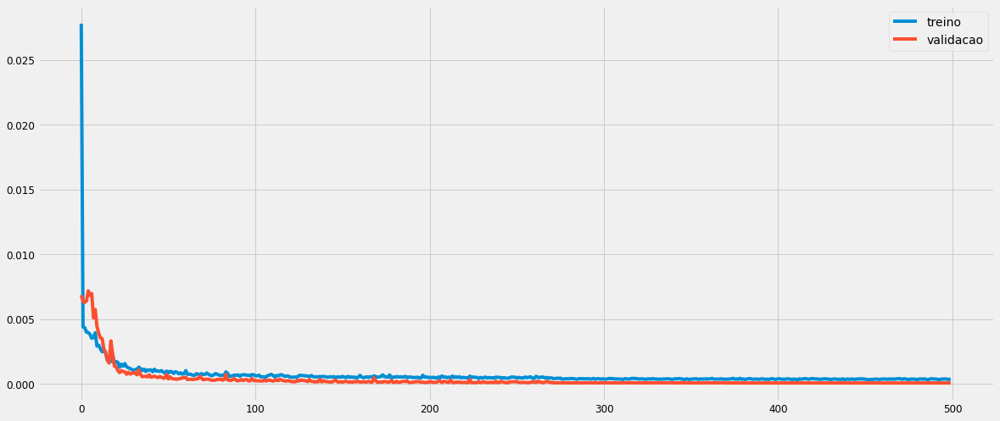

In [162]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [163]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [164]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.6421833],
       [0.6509386],
       [0.6559574],
       [0.6668315],
       [0.675987 ]], dtype=float32)

In [165]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[15063.274],
       [15210.984],
       [15295.657],
       [15479.113],
       [15633.576]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

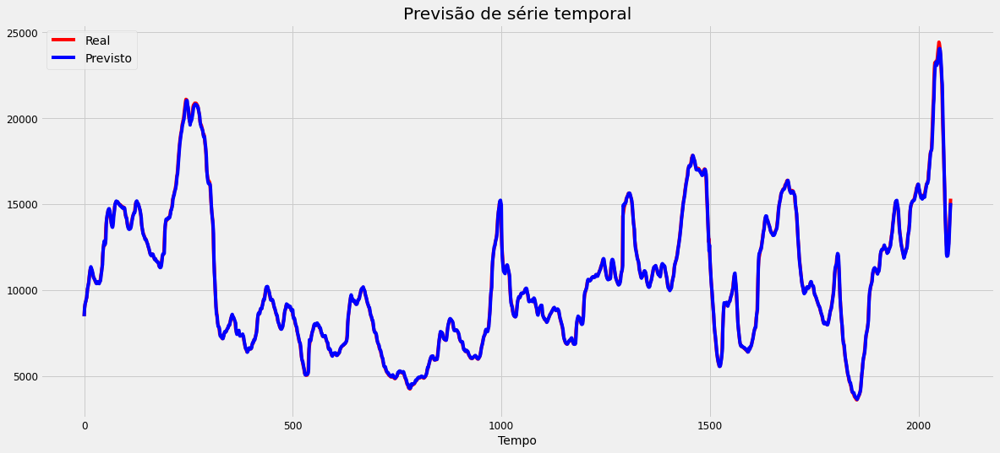

In [166]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

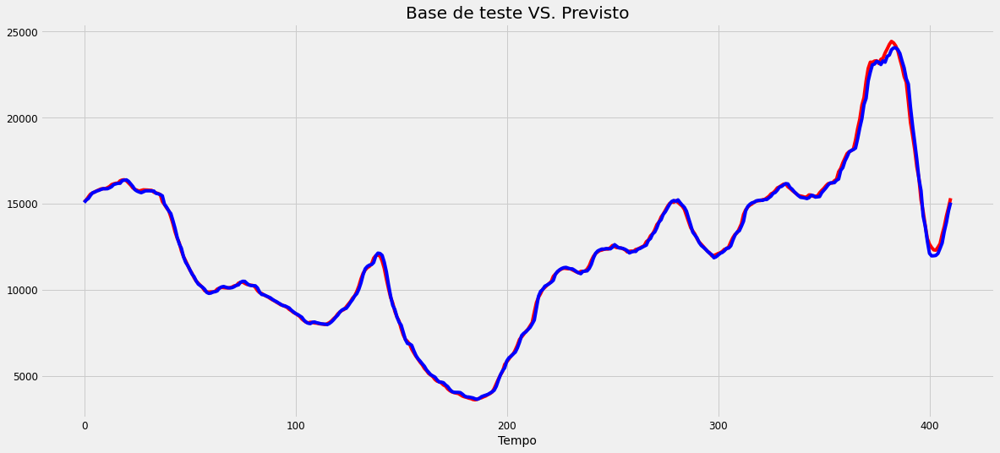

In [167]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [168]:
lstm_hs4_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_hs4_rmse)
lstm_hs4_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_hs4_mse)
lstm_hs4_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_hs4_mape, '%')
lstm_hs4_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  182.0919373620804
MSE:  33157.47365227581
MAPE:  0.8880870096255007 %
R2:  0.9984035296914194


## HS5

### SARIMA

In [169]:
data = baltic.loc[baltic['Route'] == 'HS5'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS5'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).HS5.mean()
data.head()

Date
2013-01-31    6528.454545
2013-02-28    5586.600000
2013-03-31    6956.800000
2013-04-30    6763.619048
2013-05-31    6491.476190
Freq: M, Name: HS5, dtype: float64

#### Divisão da base

In [170]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [171]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [172]:
y = data.copy()
y.tail()

Date
2020-12-31    10871.277778
2021-01-31    11327.900000
2021-02-28    13016.100000
2021-03-31    22217.304348
2021-04-30    22471.666667
Freq: M, Name: HS5, dtype: float64

#### Exibição da série

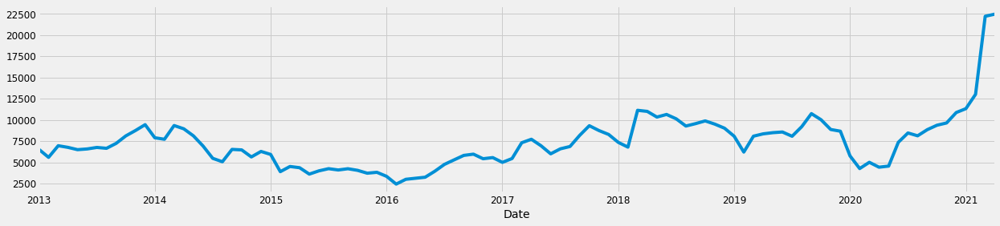

In [173]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

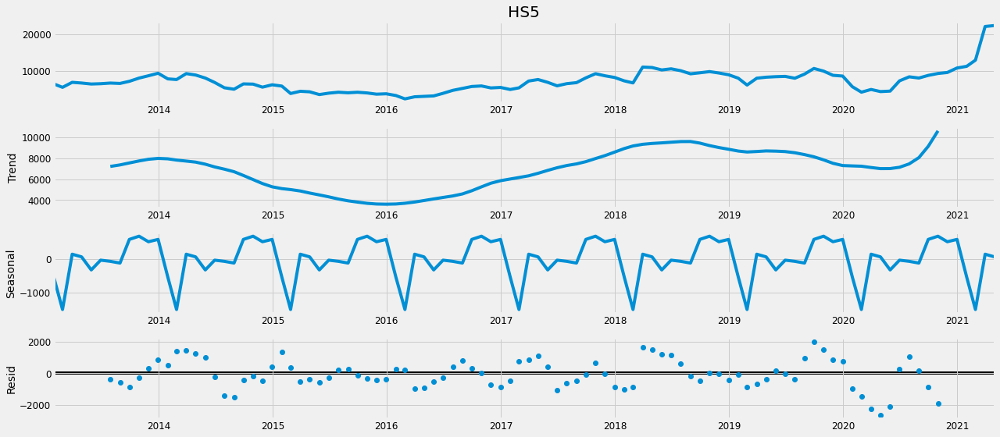

In [174]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [175]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [176]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2061.8430231357165


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1818.4866543539533
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1679.6461064298103
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1452.0399749011824
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1700.0418094214579
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1664.0679199928304
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1475.4947507603993
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1448.5348159198404
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1970.9585264535347
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2682.7031352199306
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1570.8874412470532
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1348.9391889879857
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1610.8829207353106


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1548.53216510626
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1393.6458089781038
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1366.4823464997112
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1694.9314408097232
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1490.2886003412593
ARIMA(0, 1, 0)x(0, 1, 0, 12)12 - AIC:1498.8242539407497
ARIMA(0, 1, 0)x(0, 1, 1, 12)12 - AIC:1275.4133393222462
ARIMA(0, 1, 0)x(1, 0, 0, 12)12 - AIC:1504.9450159440173
ARIMA(0, 1, 0)x(1, 0, 1, 12)12 - AIC:1474.5992183554151
ARIMA(0, 1, 0)x(1, 1, 0, 12)12 - AIC:1305.5700851062534
ARIMA(0, 1, 0)x(1, 1, 1, 12)12 - AIC:1274.553806104595
ARIMA(0, 1, 1)x(0, 0, 0, 12)12 - AIC:1676.1923080154195
ARIMA(0, 1, 1)x(0, 0, 1, 12)12 - AIC:1468.5310854139543
ARIMA(0, 1, 1)x(0, 1, 0, 12)12 - AIC:1471.7171083098806
ARIMA(0, 1, 1)x(0, 1, 1, 12)12 - AIC:1249.0613528881165
ARIMA(0, 1, 1)x(1, 0, 0, 12)12 - AIC:1499.1315455169886
ARIMA(0, 1, 1)x(1, 0, 1, 12)12 - AIC:1441.2575016696453
ARIMA(0, 1, 1)x(1, 1, 0, 12)12 - AIC:1294.322698852

C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 0, 0)x(0, 0, 1, 12)12 - AIC:1515.8943221520874
ARIMA(1, 0, 0)x(0, 1, 0, 12)12 - AIC:1514.7839968153019
ARIMA(1, 0, 0)x(0, 1, 1, 12)12 - AIC:1295.2213339330342
ARIMA(1, 0, 0)x(1, 0, 0, 12)12 - AIC:1503.250766567443
ARIMA(1, 0, 0)x(1, 0, 1, 12)12 - AIC:1499.8623210368846
ARIMA(1, 0, 0)x(1, 1, 0, 12)12 - AIC:1306.1557785738278
ARIMA(1, 0, 0)x(1, 1, 1, 12)12 - AIC:1295.8178406162265
ARIMA(1, 0, 1)x(0, 0, 0, 12)12 - AIC:1694.9812893265266


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:1500.462319724888
ARIMA(1, 0, 1)x(0, 1, 0, 12)12 - AIC:1490.2468145449543
ARIMA(1, 0, 1)x(0, 1, 1, 12)12 - AIC:1268.7814396244805
ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:1500.4926391209442
ARIMA(1, 0, 1)x(1, 0, 1, 12)12 - AIC:1466.8469584879297
ARIMA(1, 0, 1)x(1, 1, 0, 12)12 - AIC:1296.129119297
ARIMA(1, 0, 1)x(1, 1, 1, 12)12 - AIC:1267.453461617821
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:1694.5448468857007
ARIMA(1, 1, 0)x(0, 0, 1, 12)12 - AIC:1486.8935499536146
ARIMA(1, 1, 0)x(0, 1, 0, 12)12 - AIC:1487.5371172430705
ARIMA(1, 1, 0)x(0, 1, 1, 12)12 - AIC:1265.0487562048538
ARIMA(1, 1, 0)x(1, 0, 0, 12)12 - AIC:1481.97823785301
ARIMA(1, 1, 0)x(1, 0, 1, 12)12 - AIC:1456.9603197270744
ARIMA(1, 1, 0)x(1, 1, 0, 12)12 - AIC:1275.7293301992408
ARIMA(1, 1, 0)x(1, 1, 1, 12)12 - AIC:1264.0280049167252
ARIMA(1, 1, 1)x(0, 0, 0, 12)12 - AIC:1673.873536874241
ARIMA(1, 1, 1)x(0, 0, 1, 12)12 - AIC:1469.258942840505
ARIMA(1, 1, 1)x(0, 1, 0, 12)12 - AIC:1473.255190446279
ARI

#### Ajuste considerando o menor valor de AIC

In [177]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1755      0.570      0.308      0.758      -0.942       1.293
ma.L1          0.2595      0.669      0.388      0.698      -1.052       1.571
ar.S.L12      -0.3548      0.229     -1.549      0.121      -0.804       0.094
ma.S.L12      -0.5890      0.218     -2.707      0.007      -1.015      -0.163
sigma2      1.355e+06   1.64e+05      8.274      0.000    1.03e+06    1.68e+06


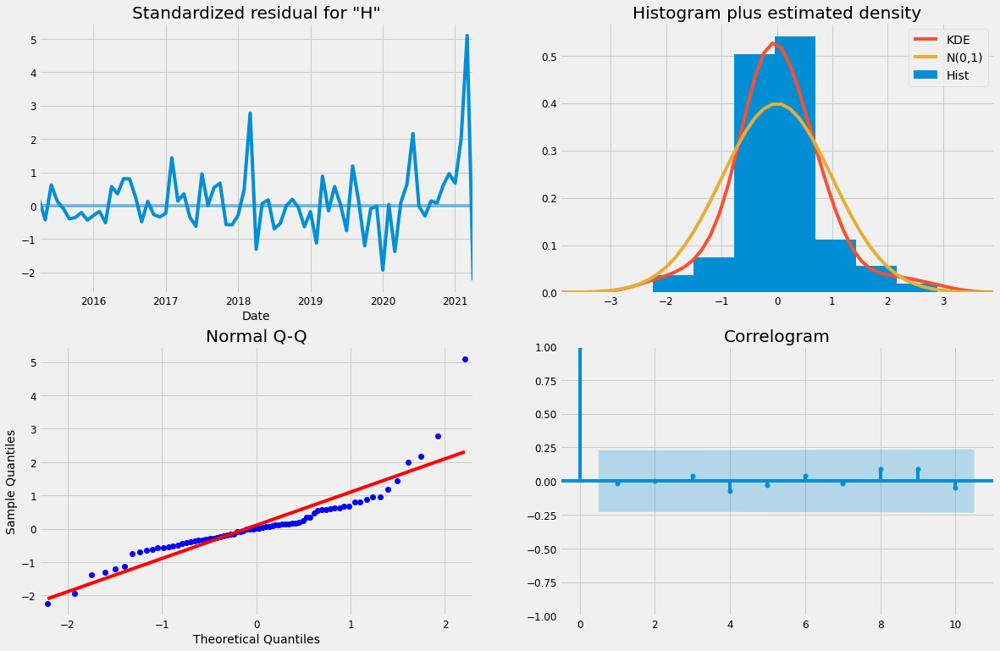

In [178]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

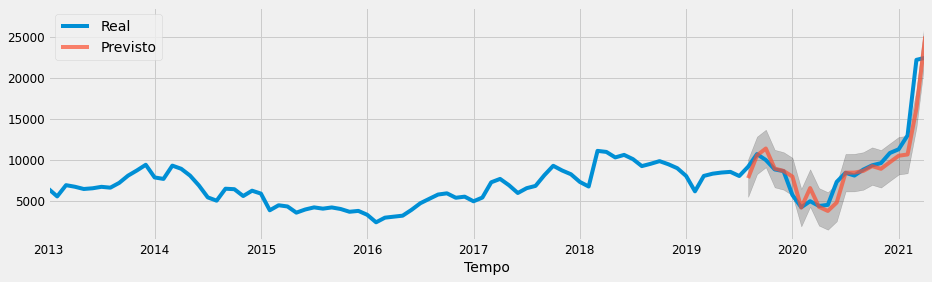

In [179]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [180]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_hs5_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_hs5_rmse)
sarima_hs5_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_hs5_mse)
sarima_hs5_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_hs5_mape, '%')
sarima_hs5_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  1804.8980006156992
MSE:  3257656.7926265486
MAPE:  11.666942790128813 %
R2:  0.8543787923211466


### LSTM

#### Divisão da base

training_set

In [181]:
temp = baltic.loc[baltic['Route'] == 'HS5'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS5'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,HS5
53267,2013-01-02,6658.0
53268,2013-01-03,6663.0
53269,2013-01-04,6663.0
53270,2013-01-07,6599.0
53271,2013-01-08,6575.0


In [182]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[6658.],
       [6663.],
       [6663.],
       [6599.],
       [6575.]])

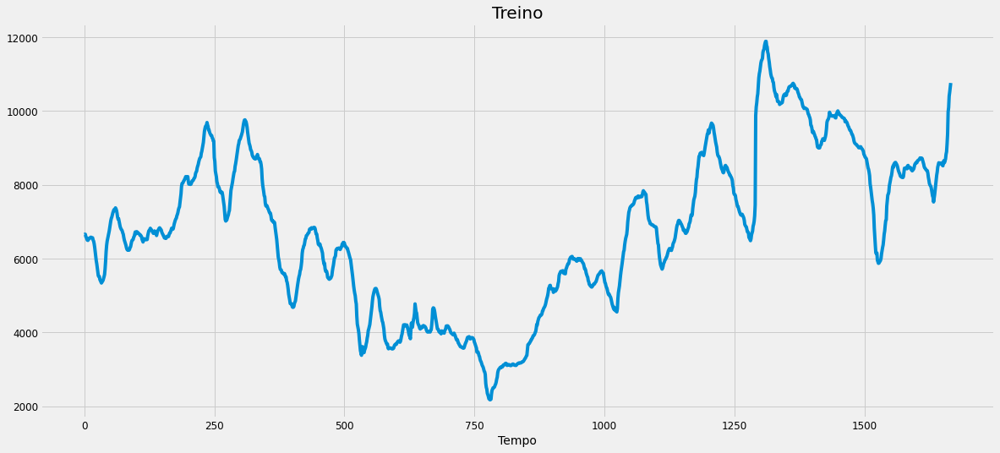

In [183]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [184]:
temp = baltic.loc[baltic['Route'] == 'HS5'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS5'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,HS5
54934,2019-09-02,10800.0
54935,2019-09-03,10888.0
54936,2019-09-04,10950.0
54937,2019-09-05,10975.0
54938,2019-09-06,10963.0


In [185]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[10800.],
       [10888.],
       [10950.],
       [10975.],
       [10963.]])

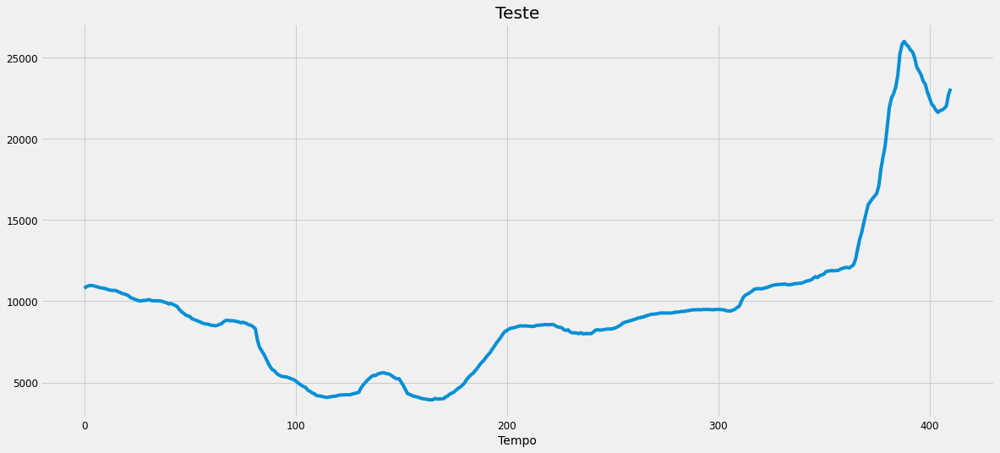

In [186]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [187]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [188]:
training_set_scaled[0:5]

array([[0.46140387],
       [0.46191848],
       [0.46191848],
       [0.45533141],
       [0.45286126]])

##### Criar a estrutura de dados

In [189]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [190]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.461404,0.461918,0.461918,0.455331,0.452861,0.448436,0.445451,0.444833,0.448333,0.449979
1,0.461918,0.461918,0.455331,0.452861,0.448436,0.445451,0.444833,0.448333,0.449979,0.449671
2,0.461918,0.455331,0.452861,0.448436,0.445451,0.444833,0.448333,0.449979,0.449671,0.451420
3,0.455331,0.452861,0.448436,0.445451,0.444833,0.448333,0.449979,0.449671,0.451420,0.453479
4,0.452861,0.448436,0.445451,0.444833,0.448333,0.449979,0.449671,0.451420,0.453479,0.453685


In [191]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.461404,0.461918,0.461918,0.455331,0.452861,0.448436,0.445451,0.444833,0.448333,0.449979
1,0.461918,0.461918,0.455331,0.452861,0.448436,0.445451,0.444833,0.448333,0.449979,0.449671
2,0.461918,0.455331,0.452861,0.448436,0.445451,0.444833,0.448333,0.449979,0.449671,0.451420
3,0.455331,0.452861,0.448436,0.445451,0.444833,0.448333,0.449979,0.449671,0.451420,0.453479
4,0.452861,0.448436,0.445451,0.444833,0.448333,0.449979,0.449671,0.451420,0.453479,0.453685


##### *Reshaping*

In [192]:
X_train.shape

(1657, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [193]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [194]:
X_train.shape

(1657, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [195]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_10 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_10 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_11 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_11 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_12 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_12 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_4 (Dense)              (None, 1)                

###### Treinamento

In [196]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1491 samples, validate on 166 samples
Epoch 1/1000
1491/1491 [==============================] - 2s 1ms/step - loss: 0.0335 - val_loss: 0.0032
Epoch 2/1000
1491/1491 [==============================] - 1s 676us/step - loss: 0.0049 - val_loss: 0.0032
Epoch 3/1000
1491/1491 [==============================] - 1s 721us/step - loss: 0.0041 - val_loss: 0.0038
Epoch 4/1000
1491/1491 [==============================] - 1s 722us/step - loss: 0.0038 - val_loss: 0.0033
Epoch 5/1000
1491/1491 [==============================] - 1s 725us/step - loss: 0.0034 - val_loss: 0.0028
Epoch 6/1000
1491/1491 [==============================] - 1s 694us/step - loss: 0.0037 - val_loss: 0.0047
Epoch 7/1000
1491/1491 [==============================] - 1s 684us/step - loss: 0.0038 - val_loss: 0.0029
Epoch 8/1000
1491/1491 [==============================] - 1s 684us/step - loss: 0.0035 - val_loss: 0.0036
Epoch 9/1000
1491/1491 [==============================] - 1s 686us/step - loss: 0.0036 - val_loss: 0.0026
E

1491/1491 [==============================] - 1s 680us/step - loss: 7.8814e-04 - val_loss: 2.3758e-04
Epoch 76/1000
1491/1491 [==============================] - 1s 690us/step - loss: 8.2923e-04 - val_loss: 2.5362e-04
Epoch 77/1000
1491/1491 [==============================] - 1s 685us/step - loss: 7.2730e-04 - val_loss: 2.6595e-04
Epoch 78/1000
1491/1491 [==============================] - 1s 688us/step - loss: 7.8890e-04 - val_loss: 2.4834e-04
Epoch 79/1000
1491/1491 [==============================] - 1s 675us/step - loss: 7.2358e-04 - val_loss: 2.1818e-04
Epoch 80/1000
1491/1491 [==============================] - 1s 725us/step - loss: 7.2622e-04 - val_loss: 2.1734e-04
Epoch 81/1000
1491/1491 [==============================] - 1s 707us/step - loss: 7.9975e-04 - val_loss: 3.3523e-04
Epoch 82/1000
1491/1491 [==============================] - 1s 714us/step - loss: 7.3676e-04 - val_loss: 6.8886e-04
Epoch 83/1000
1491/1491 [==============================] - 1s 683us/step - loss: 7.6501e-04 - 

Epoch 146/1000
1491/1491 [==============================] - 1s 667us/step - loss: 5.6076e-04 - val_loss: 1.6041e-04
Epoch 147/1000
1491/1491 [==============================] - 1s 665us/step - loss: 6.0037e-04 - val_loss: 2.6896e-04
Epoch 148/1000
1491/1491 [==============================] - 1s 668us/step - loss: 5.7716e-04 - val_loss: 3.1841e-04
Epoch 149/1000
1491/1491 [==============================] - 1s 666us/step - loss: 5.3299e-04 - val_loss: 1.8935e-04
Epoch 150/1000
1491/1491 [==============================] - 1s 668us/step - loss: 5.7281e-04 - val_loss: 1.4229e-04
Epoch 151/1000
1491/1491 [==============================] - 1s 671us/step - loss: 5.2991e-04 - val_loss: 3.9103e-04
Epoch 152/1000
1491/1491 [==============================] - 1s 668us/step - loss: 6.1146e-04 - val_loss: 1.4514e-04
Epoch 153/1000
1491/1491 [==============================] - 1s 666us/step - loss: 5.0546e-04 - val_loss: 1.3371e-04
Epoch 154/1000
1491/1491 [==============================] - 1s 666us/ste

1491/1491 [==============================] - 1s 694us/step - loss: 4.9902e-04 - val_loss: 1.0742e-04
Epoch 217/1000
1491/1491 [==============================] - 1s 692us/step - loss: 4.7848e-04 - val_loss: 5.0613e-04
Epoch 218/1000
1491/1491 [==============================] - 1s 680us/step - loss: 5.3634e-04 - val_loss: 8.5712e-05
Epoch 219/1000
1491/1491 [==============================] - 1s 728us/step - loss: 4.8161e-04 - val_loss: 1.3876e-04
Epoch 220/1000
1491/1491 [==============================] - 1s 723us/step - loss: 4.6798e-04 - val_loss: 2.1263e-04
Epoch 221/1000
1491/1491 [==============================] - 1s 711us/step - loss: 4.8134e-04 - val_loss: 8.7769e-05
Epoch 222/1000
1491/1491 [==============================] - 1s 709us/step - loss: 5.3022e-04 - val_loss: 9.1140e-05
Epoch 223/1000
1491/1491 [==============================] - 1s 688us/step - loss: 5.1642e-04 - val_loss: 1.2566e-04
Epoch 224/1000
1491/1491 [==============================] - 1s 696us/step - loss: 4.787

Epoch 287/1000
1491/1491 [==============================] - 1s 685us/step - loss: 3.9245e-04 - val_loss: 7.8987e-05
Epoch 288/1000
1491/1491 [==============================] - 1s 688us/step - loss: 4.2493e-04 - val_loss: 7.9234e-05
Epoch 289/1000
1491/1491 [==============================] - 1s 684us/step - loss: 3.8135e-04 - val_loss: 1.1172e-04
Epoch 290/1000
1491/1491 [==============================] - 1s 685us/step - loss: 4.0601e-04 - val_loss: 9.9975e-05
Epoch 291/1000
1491/1491 [==============================] - 1s 680us/step - loss: 3.9077e-04 - val_loss: 8.0386e-05
Epoch 292/1000
1491/1491 [==============================] - 1s 687us/step - loss: 4.2236e-04 - val_loss: 8.0045e-05
Epoch 293/1000
1491/1491 [==============================] - 1s 688us/step - loss: 3.8865e-04 - val_loss: 7.8993e-05
Epoch 294/1000
1491/1491 [==============================] - 1s 679us/step - loss: 3.7019e-04 - val_loss: 8.3594e-05
Epoch 295/1000
1491/1491 [==============================] - 1s 684us/ste

1491/1491 [==============================] - 1s 893us/step - loss: 3.7691e-04 - val_loss: 7.5132e-05
Epoch 358/1000
1491/1491 [==============================] - 1s 847us/step - loss: 3.5722e-04 - val_loss: 7.4900e-05
Epoch 359/1000
1491/1491 [==============================] - 1s 843us/step - loss: 3.7621e-04 - val_loss: 7.1520e-05
Epoch 360/1000
1491/1491 [==============================] - 1s 855us/step - loss: 3.9863e-04 - val_loss: 7.4145e-05
Epoch 361/1000
1491/1491 [==============================] - 1s 854us/step - loss: 3.7540e-04 - val_loss: 7.4195e-05
Epoch 362/1000
1491/1491 [==============================] - 1s 775us/step - loss: 3.5958e-04 - val_loss: 7.3053e-05
Epoch 363/1000
1491/1491 [==============================] - 1s 773us/step - loss: 3.8766e-04 - val_loss: 7.2639e-05
Epoch 364/1000
1491/1491 [==============================] - 1s 773us/step - loss: 3.6116e-04 - val_loss: 7.2311e-05
Epoch 365/1000
1491/1491 [==============================] - 1s 772us/step - loss: 3.570

Epoch 428/1000
1491/1491 [==============================] - 1s 813us/step - loss: 3.8267e-04 - val_loss: 7.5371e-05
Epoch 429/1000
1491/1491 [==============================] - 1s 803us/step - loss: 3.8574e-04 - val_loss: 7.2392e-05
Epoch 430/1000
1491/1491 [==============================] - 1s 810us/step - loss: 3.7177e-04 - val_loss: 7.2982e-05
Epoch 431/1000
1491/1491 [==============================] - 1s 839us/step - loss: 3.9646e-04 - val_loss: 7.1354e-05
Epoch 432/1000
1491/1491 [==============================] - 1s 834us/step - loss: 4.0876e-04 - val_loss: 7.1886e-05
Epoch 433/1000
1491/1491 [==============================] - 1s 782us/step - loss: 3.6017e-04 - val_loss: 7.1226e-05
Epoch 434/1000
1491/1491 [==============================] - 1s 769us/step - loss: 3.7356e-04 - val_loss: 7.7297e-05
Epoch 435/1000
1491/1491 [==============================] - 1s 860us/step - loss: 3.4686e-04 - val_loss: 7.1436e-05
Epoch 436/1000
1491/1491 [==============================] - 1s 900us/ste

1491/1491 [==============================] - 1s 772us/step - loss: 4.0114e-04 - val_loss: 7.2819e-05
Epoch 499/1000
1491/1491 [==============================] - 1s 768us/step - loss: 3.5608e-04 - val_loss: 7.2724e-05
Epoch 500/1000
1491/1491 [==============================] - 1s 778us/step - loss: 3.3637e-04 - val_loss: 7.3004e-05
Epoch 501/1000
1491/1491 [==============================] - 1s 769us/step - loss: 3.6957e-04 - val_loss: 7.3222e-05
Epoch 502/1000
1491/1491 [==============================] - 1s 802us/step - loss: 3.7097e-04 - val_loss: 7.2867e-05
Epoch 503/1000
1491/1491 [==============================] - 1s 862us/step - loss: 3.4724e-04 - val_loss: 7.3028e-05
Epoch 504/1000
1491/1491 [==============================] - 1s 854us/step - loss: 3.9537e-04 - val_loss: 7.2632e-05
Epoch 505/1000
1491/1491 [==============================] - 1s 797us/step - loss: 3.5997e-04 - val_loss: 7.3648e-05
Epoch 506/1000
1491/1491 [==============================] - 1s 769us/step - loss: 3.471

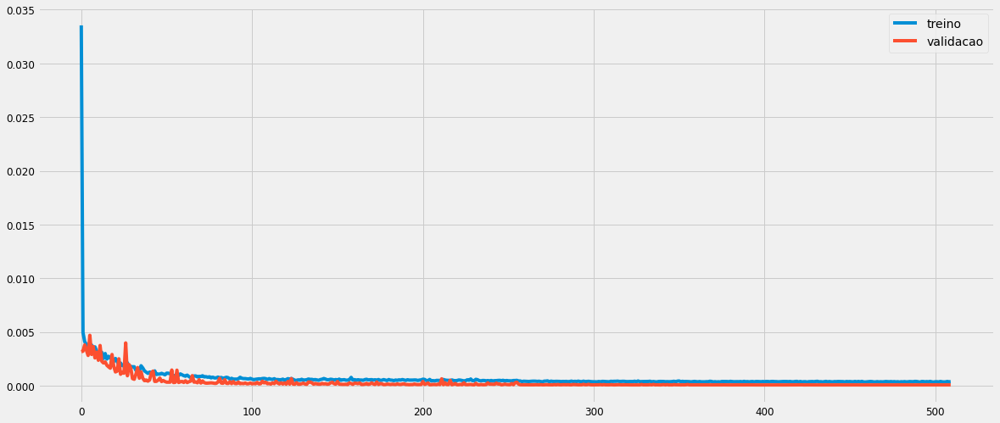

In [197]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [198]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [199]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.89032006],
       [0.89217377],
       [0.89906543],
       [0.90287733],
       [0.9040086 ]], dtype=float32)

In [200]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[10825.35 ],
       [10843.36 ],
       [10910.32 ],
       [10947.355],
       [10958.348]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

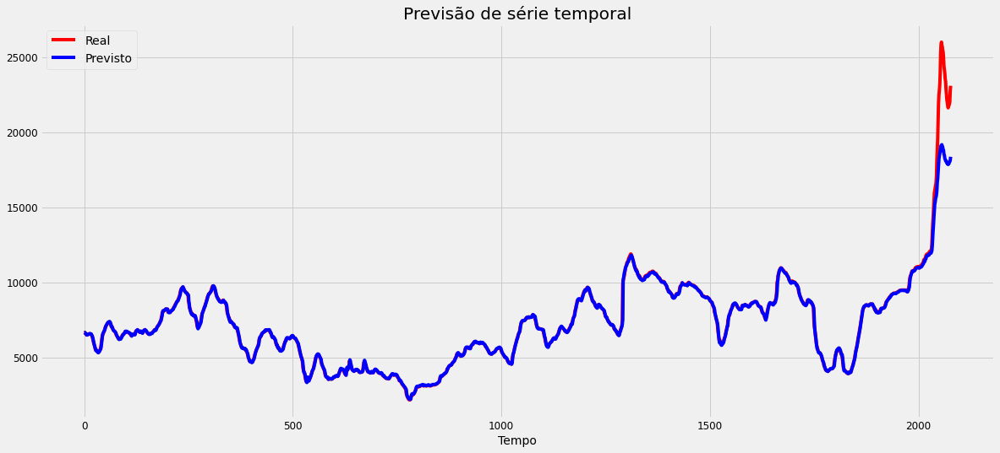

In [201]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

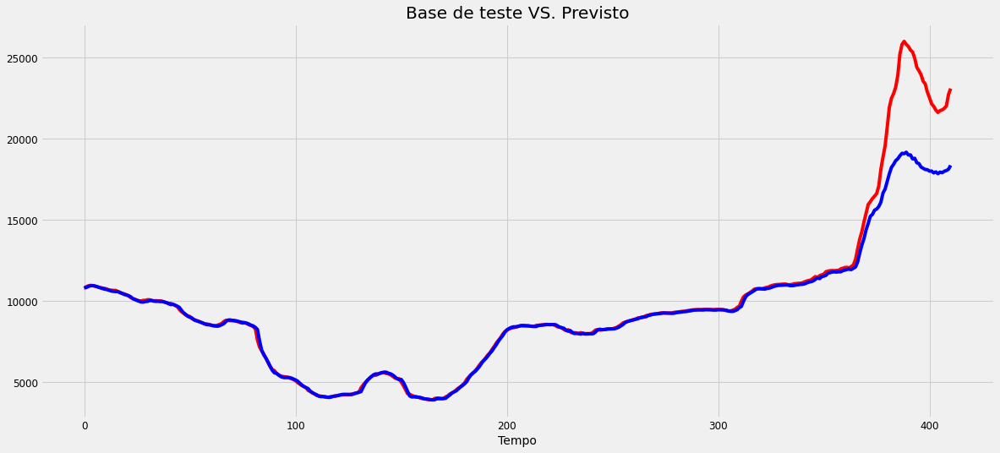

In [202]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [203]:
#import math
#from sklearn.metrics import mean_squared_error
lstm_hs5_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_hs5_rmse)
lstm_hs5_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_hs5_mse)
lstm_hs5_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_hs5_mape, '%')
#from sklearn.metrics import r2_score
lstm_hs5_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  1438.4346240746725
MSE:  2069094.1677368442
MAPE:  2.455501985848585 %
R2:  0.9102627303523438


## HS6

### SARIMA

In [204]:
data = baltic.loc[baltic['Route'] == 'HS6'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS6'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).HS6.mean()
data.head()

Date
2013-01-31    6422.818182
2013-02-28    5387.650000
2013-03-31    6989.400000
2013-04-30    6741.380952
2013-05-31    6490.476190
Freq: M, Name: HS6, dtype: float64

#### Divisão da base

In [205]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [206]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [207]:
y = data.copy()
y.tail()

Date
2020-12-31     9334.444444
2021-01-31     9934.600000
2021-02-28    12058.850000
2021-03-31    21047.086957
2021-04-30    22305.466667
Freq: M, Name: HS6, dtype: float64

#### Exibição da série

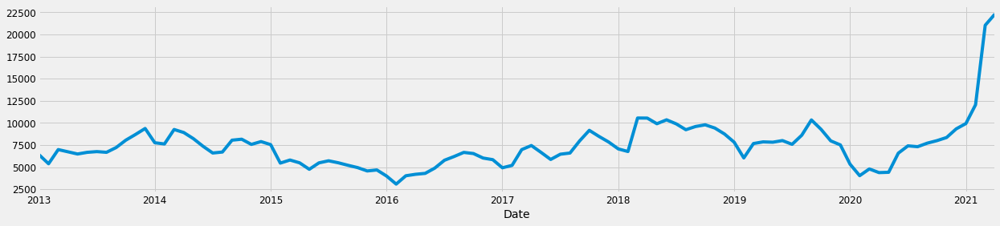

In [208]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

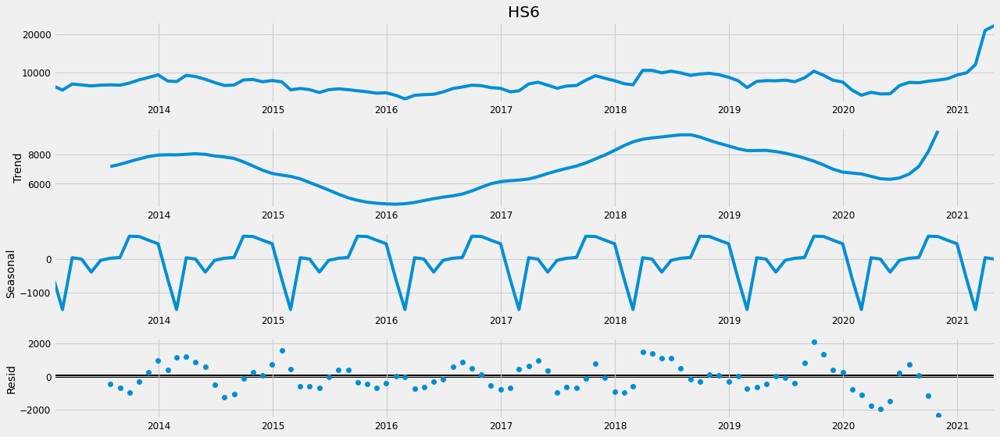

In [209]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [210]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [211]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2060.1684772902217


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1816.6838271568251
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1666.4890435504276
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1438.6909331601153
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1686.7499816684779
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1660.5427338482857
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1462.3645823855331
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1437.7342780146353
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1920.4370673360727


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1779.281886633788
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1571.1986163641627
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1334.1841588712412
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1596.6263418769995


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1549.817937907105
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1391.1842094176802
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1333.9437080692092
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1686.024738186058
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1480.9750992004685
ARIMA(0, 1, 0)x(0, 1, 0, 12)12 - AIC:1489.280758576458
ARIMA(0, 1, 0)x(0, 1, 1, 12)12 - AIC:1269.7067511713
ARIMA(0, 1, 0)x(1, 0, 0, 12)12 - AIC:1496.1916890230536
ARIMA(0, 1, 0)x(1, 0, 1, 12)12 - AIC:1466.630595474249
ARIMA(0, 1, 0)x(1, 1, 0, 12)12 - AIC:1299.4285272298514
ARIMA(0, 1, 0)x(1, 1, 1, 12)12 - AIC:1268.9365159767158
ARIMA(0, 1, 1)x(0, 0, 0, 12)12 - AIC:1661.6602979042127
ARIMA(0, 1, 1)x(0, 0, 1, 12)12 - AIC:1451.3302007402533
ARIMA(0, 1, 1)x(0, 1, 0, 12)12 - AIC:1456.129904983745
ARIMA(0, 1, 1)x(0, 1, 1, 12)12 - AIC:1234.774518069169
ARIMA(0, 1, 1)x(1, 0, 0, 12)12 - AIC:1483.8939890668623
ARIMA(0, 1, 1)x(1, 0, 1, 12)12 - AIC:1425.5267979663042
ARIMA(0, 1, 1)x(1, 1, 0, 12)12 - AIC:1279.8633510709399
A

C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:1487.1572058029758
ARIMA(1, 0, 1)x(0, 1, 0, 12)12 - AIC:1475.139387152451
ARIMA(1, 0, 1)x(0, 1, 1, 12)12 - AIC:1254.4493922167617
ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:1485.856600133645
ARIMA(1, 0, 1)x(1, 0, 1, 12)12 - AIC:1449.8385329517062
ARIMA(1, 0, 1)x(1, 1, 0, 12)12 - AIC:1282.4376796115985
ARIMA(1, 0, 1)x(1, 1, 1, 12)12 - AIC:1253.6460074990127
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:1682.1305039693032
ARIMA(1, 1, 0)x(0, 0, 1, 12)12 - AIC:1472.7494331155256
ARIMA(1, 1, 0)x(0, 1, 0, 12)12 - AIC:1471.9182199752368
ARIMA(1, 1, 0)x(0, 1, 1, 12)12 - AIC:1251.2595316934082
ARIMA(1, 1, 0)x(1, 0, 0, 12)12 - AIC:1466.5795375092264
ARIMA(1, 1, 0)x(1, 0, 1, 12)12 - AIC:1440.070217328523
ARIMA(1, 1, 0)x(1, 1, 0, 12)12 - AIC:1261.9443142057612
ARIMA(1, 1, 0)x(1, 1, 1, 12)12 - AIC:1250.5420003566248
ARIMA(1, 1, 1)x(0, 0, 0, 12)12 - AIC:1659.7572636384161
ARIMA(1, 1, 1)x(0, 0, 1, 12)12 - AIC:1452.5899681560647
ARIMA(1, 1, 1)x(0, 1, 0, 12)12 - AIC:1457.443802975

#### Ajuste considerando o menor valor de AIC

In [212]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1772      0.340      0.521      0.603      -0.490       0.844
ma.L1          0.3958      0.431      0.919      0.358      -0.448       1.240
ar.S.L12      -0.3412      0.251     -1.357      0.175      -0.834       0.152
ma.S.L12      -0.6190      0.217     -2.847      0.004      -1.045      -0.193
sigma2      1.106e+06   1.52e+05      7.263      0.000    8.08e+05     1.4e+06


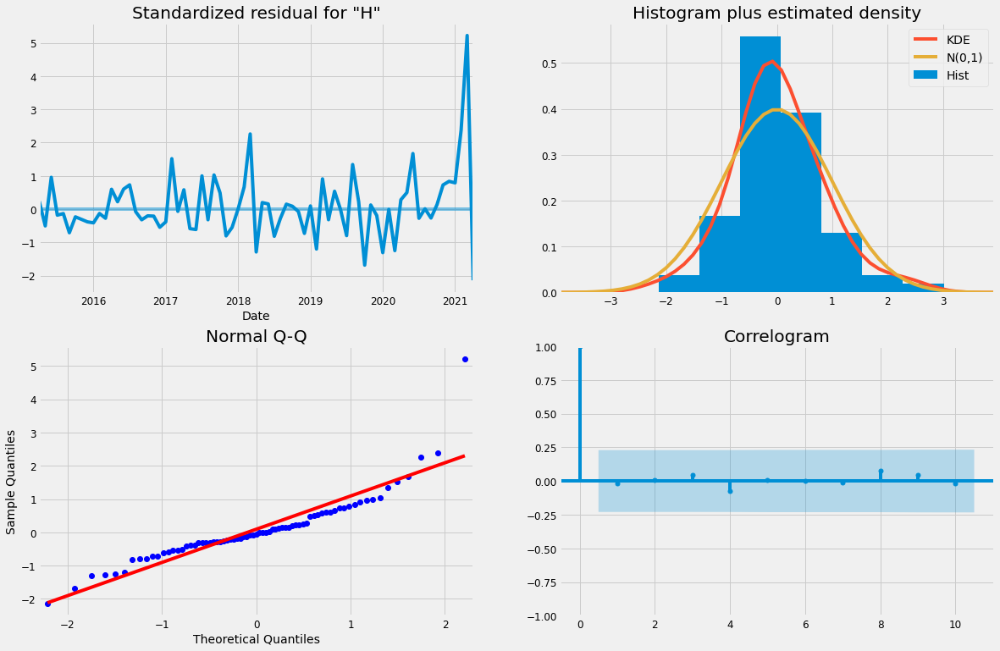

In [213]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

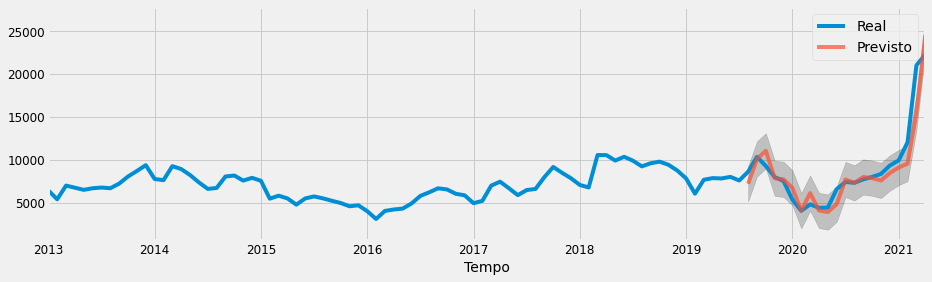

In [214]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [215]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_hs6_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_hs6_rmse)
sarima_hs6_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_hs6_mse)
sarima_hs6_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_hs6_mape, '%')
sarima_hs6_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  1633.8225551159364
MSE:  2669376.141605567
MAPE:  11.15079312287354 %
R2:  0.875328015566247


### LSTM

#### Divisão da base

training_set

In [216]:
temp = baltic.loc[baltic['Route'] == 'HS6'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS6'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,HS6
55345,2013-01-02,6755.0
55346,2013-01-03,6710.0
55347,2013-01-04,6679.0
55348,2013-01-07,6591.0
55349,2013-01-08,6538.0


In [217]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[6755.],
       [6710.],
       [6679.],
       [6591.],
       [6538.]])

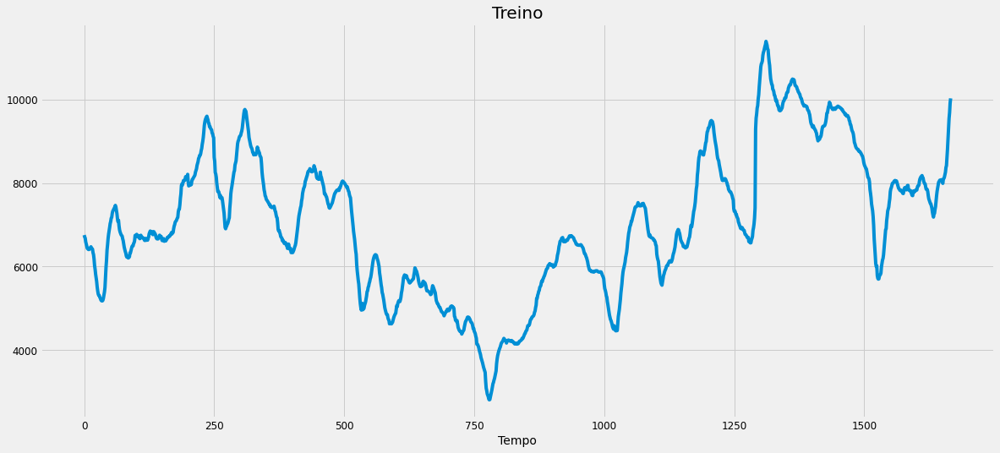

In [218]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [219]:
temp = baltic.loc[baltic['Route'] == 'HS6'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS6'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,HS6
57012,2019-09-02,10163.0
57013,2019-09-03,10375.0
57014,2019-09-04,10475.0
57015,2019-09-05,10531.0
57016,2019-09-06,10550.0


In [220]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[10163.],
       [10375.],
       [10475.],
       [10531.],
       [10550.]])

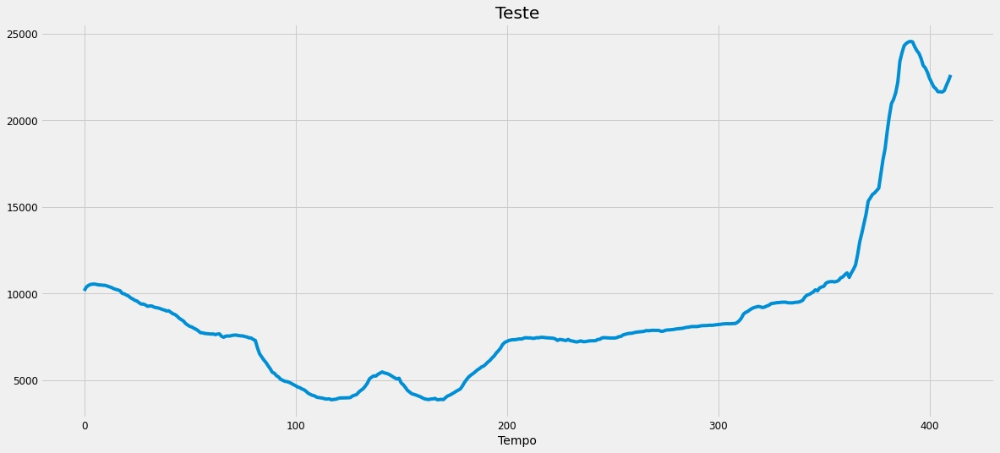

In [221]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [222]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [223]:
training_set_scaled[0:5]

array([[0.45960419],
       [0.45436554],
       [0.45075669],
       [0.44051222],
       [0.43434226]])

##### Criar a estrutura de dados

In [224]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [225]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.459604,0.454366,0.450757,0.440512,0.434342,0.429220,0.422817,0.422235,0.419558,0.419325
1,0.454366,0.450757,0.440512,0.434342,0.429220,0.422817,0.422235,0.419558,0.419325,0.419790
2,0.450757,0.440512,0.434342,0.429220,0.422817,0.422235,0.419558,0.419325,0.419790,0.421886
3,0.440512,0.434342,0.429220,0.422817,0.422235,0.419558,0.419325,0.419790,0.421886,0.425146
4,0.434342,0.429220,0.422817,0.422235,0.419558,0.419325,0.419790,0.421886,0.425146,0.427008


In [226]:
pd.DataFrame(y_train).head()

,0
0,0.419790
1,0.421886
2,0.425146
3,0.427008
4,0.423749


##### *Reshaping*

In [227]:
X_train.shape

(1657, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [228]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [229]:
X_train.shape

(1657, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [230]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_13 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_13 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_14 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_14 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_15 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_15 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_5 (Dense)              (None, 1)                

###### Treinamento

In [231]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1491 samples, validate on 166 samples
Epoch 1/1000
1491/1491 [==============================] - 2s 1ms/step - loss: 0.0287 - val_loss: 0.0042
Epoch 2/1000
1491/1491 [==============================] - 1s 721us/step - loss: 0.0050 - val_loss: 0.0030
Epoch 3/1000
1491/1491 [==============================] - 1s 708us/step - loss: 0.0040 - val_loss: 0.0031
Epoch 4/1000
1491/1491 [==============================] - 1s 729us/step - loss: 0.0040 - val_loss: 0.0035
Epoch 5/1000
1491/1491 [==============================] - 1s 728us/step - loss: 0.0037 - val_loss: 0.0029
Epoch 6/1000
1491/1491 [==============================] - 1s 705us/step - loss: 0.0037 - val_loss: 0.0033
Epoch 7/1000
1491/1491 [==============================] - 1s 683us/step - loss: 0.0036 - val_loss: 0.0027
Epoch 8/1000
1491/1491 [==============================] - 1s 698us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 9/1000
1491/1491 [==============================] - 1s 690us/step - loss: 0.0037 - val_loss: 0.0041
E

Epoch 75/1000
1491/1491 [==============================] - 1s 812us/step - loss: 7.7133e-04 - val_loss: 2.1695e-04
Epoch 76/1000
1491/1491 [==============================] - 1s 803us/step - loss: 7.7675e-04 - val_loss: 3.1618e-04
Epoch 77/1000
1491/1491 [==============================] - 1s 797us/step - loss: 7.2218e-04 - val_loss: 1.7582e-04
Epoch 78/1000
1491/1491 [==============================] - 1s 787us/step - loss: 6.6411e-04 - val_loss: 2.4161e-04
Epoch 79/1000
1491/1491 [==============================] - 1s 811us/step - loss: 6.5447e-04 - val_loss: 3.1518e-04
Epoch 80/1000
1491/1491 [==============================] - 1s 789us/step - loss: 7.3911e-04 - val_loss: 4.1902e-04
Epoch 81/1000
1491/1491 [==============================] - 1s 794us/step - loss: 6.7301e-04 - val_loss: 2.5313e-04
Epoch 82/1000
1491/1491 [==============================] - 1s 807us/step - loss: 6.7960e-04 - val_loss: 1.6232e-04
Epoch 83/1000
1491/1491 [==============================] - 1s 843us/step - loss:

Epoch 146/1000
1491/1491 [==============================] - 1s 838us/step - loss: 4.5275e-04 - val_loss: 1.0099e-04
Epoch 147/1000
1491/1491 [==============================] - 1s 832us/step - loss: 5.0828e-04 - val_loss: 1.7072e-04
Epoch 148/1000
1491/1491 [==============================] - 1s 808us/step - loss: 4.5461e-04 - val_loss: 1.0186e-04
Epoch 149/1000
1491/1491 [==============================] - 1s 816us/step - loss: 5.4329e-04 - val_loss: 4.5718e-04
Epoch 150/1000
1491/1491 [==============================] - 1s 837us/step - loss: 5.3083e-04 - val_loss: 1.3288e-04
Epoch 151/1000
1491/1491 [==============================] - 1s 816us/step - loss: 4.6591e-04 - val_loss: 1.2537e-04
Epoch 152/1000
1491/1491 [==============================] - 1s 833us/step - loss: 4.9395e-04 - val_loss: 9.8572e-05
Epoch 153/1000
1491/1491 [==============================] - 1s 783us/step - loss: 4.9363e-04 - val_loss: 9.2695e-05
Epoch 154/1000
1491/1491 [==============================] - 1s 793us/ste

1491/1491 [==============================] - 1s 863us/step - loss: 3.7073e-04 - val_loss: 6.7047e-05
Epoch 217/1000
1491/1491 [==============================] - 1s 851us/step - loss: 3.4975e-04 - val_loss: 1.0241e-04
Epoch 218/1000
1491/1491 [==============================] - 1s 792us/step - loss: 3.7029e-04 - val_loss: 7.0598e-05
Epoch 219/1000
1491/1491 [==============================] - 1s 779us/step - loss: 3.6862e-04 - val_loss: 6.8599e-05
Epoch 220/1000
1491/1491 [==============================] - 1s 775us/step - loss: 3.6864e-04 - val_loss: 7.1143e-05
Epoch 221/1000
1491/1491 [==============================] - 1s 776us/step - loss: 3.5326e-04 - val_loss: 6.6958e-05
Epoch 222/1000
1491/1491 [==============================] - 1s 780us/step - loss: 3.4420e-04 - val_loss: 7.8543e-05
Epoch 223/1000
1491/1491 [==============================] - 1s 782us/step - loss: 3.4459e-04 - val_loss: 8.1867e-05
Epoch 224/1000
1491/1491 [==============================] - 1s 784us/step - loss: 3.827

Epoch 287/1000
1491/1491 [==============================] - 1s 812us/step - loss: 3.3579e-04 - val_loss: 6.2944e-05
Epoch 288/1000
1491/1491 [==============================] - 1s 785us/step - loss: 3.4248e-04 - val_loss: 6.3001e-05
Epoch 289/1000
1491/1491 [==============================] - 1s 786us/step - loss: 3.6171e-04 - val_loss: 6.3155e-05
Epoch 290/1000
1491/1491 [==============================] - 1s 773us/step - loss: 3.3065e-04 - val_loss: 6.3841e-05
Epoch 291/1000
1491/1491 [==============================] - 1s 783us/step - loss: 3.7272e-04 - val_loss: 6.3343e-05
Epoch 292/1000
1491/1491 [==============================] - 1s 785us/step - loss: 3.3780e-04 - val_loss: 6.3695e-05
Epoch 293/1000
1491/1491 [==============================] - 1s 788us/step - loss: 3.6340e-04 - val_loss: 6.4312e-05
Epoch 294/1000
1491/1491 [==============================] - 1s 800us/step - loss: 3.3116e-04 - val_loss: 6.2690e-05
Epoch 295/1000
1491/1491 [==============================] - 1s 843us/ste

1491/1491 [==============================] - 1s 792us/step - loss: 3.2108e-04 - val_loss: 6.1460e-05
Epoch 358/1000
1491/1491 [==============================] - 1s 801us/step - loss: 3.4321e-04 - val_loss: 6.0681e-05
Epoch 359/1000
1491/1491 [==============================] - 1s 787us/step - loss: 3.2353e-04 - val_loss: 6.1854e-05
Epoch 360/1000
1491/1491 [==============================] - 1s 791us/step - loss: 3.2518e-04 - val_loss: 6.1743e-05
Epoch 361/1000
1491/1491 [==============================] - 1s 849us/step - loss: 3.3903e-04 - val_loss: 6.3524e-05
Epoch 362/1000
1491/1491 [==============================] - 1s 839us/step - loss: 3.5413e-04 - val_loss: 6.5287e-05
Epoch 363/1000
1491/1491 [==============================] - 1s 829us/step - loss: 3.6479e-04 - val_loss: 6.1630e-05
Epoch 364/1000
1491/1491 [==============================] - 1s 785us/step - loss: 3.4108e-04 - val_loss: 6.0371e-05
Epoch 365/1000
1491/1491 [==============================] - 1s 794us/step - loss: 3.281

Epoch 428/1000
1491/1491 [==============================] - 1s 778us/step - loss: 3.3661e-04 - val_loss: 6.0787e-05
Epoch 429/1000
1491/1491 [==============================] - 1s 810us/step - loss: 3.1954e-04 - val_loss: 6.0530e-05
Epoch 430/1000
1491/1491 [==============================] - 1s 816us/step - loss: 3.3616e-04 - val_loss: 6.0268e-05
Epoch 431/1000
1491/1491 [==============================] - 1s 796us/step - loss: 3.0325e-04 - val_loss: 6.0430e-05
Epoch 432/1000
1491/1491 [==============================] - 1s 767us/step - loss: 3.1699e-04 - val_loss: 6.0548e-05
Epoch 433/1000
1491/1491 [==============================] - 1s 771us/step - loss: 3.2353e-04 - val_loss: 6.0646e-05
Epoch 434/1000
1491/1491 [==============================] - 1s 770us/step - loss: 3.3480e-04 - val_loss: 6.0597e-05
Epoch 435/1000
1491/1491 [==============================] - 1s 770us/step - loss: 3.3100e-04 - val_loss: 6.0589e-05
Epoch 436/1000
1491/1491 [==============================] - 1s 768us/ste

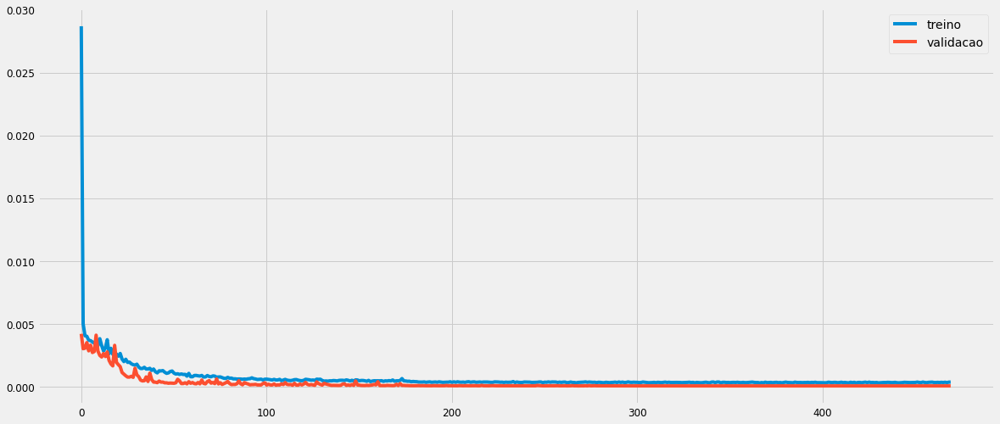

In [232]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [233]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [234]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.84969354],
       [0.8628553 ],
       [0.88458264],
       [0.8967072 ],
       [0.9025234 ]], dtype=float32)

In [235]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[10105.867],
       [10218.927],
       [10405.564],
       [10509.715],
       [10559.676]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

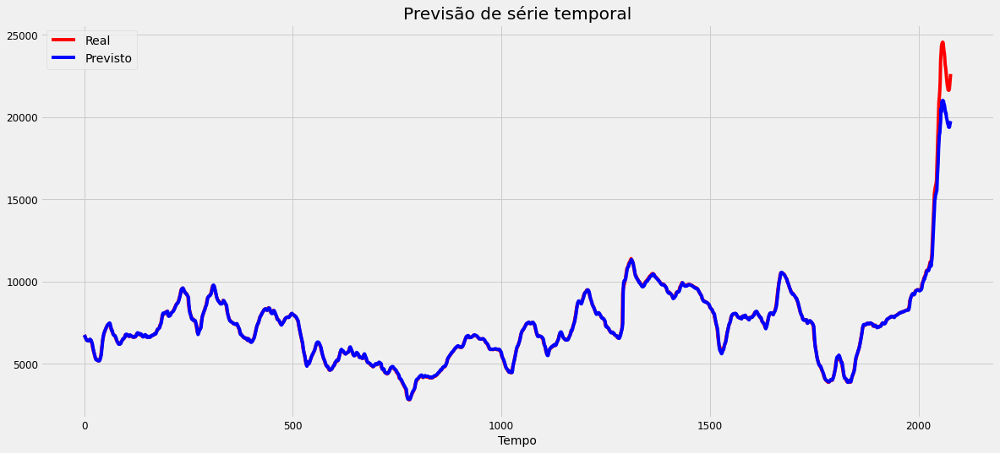

In [236]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

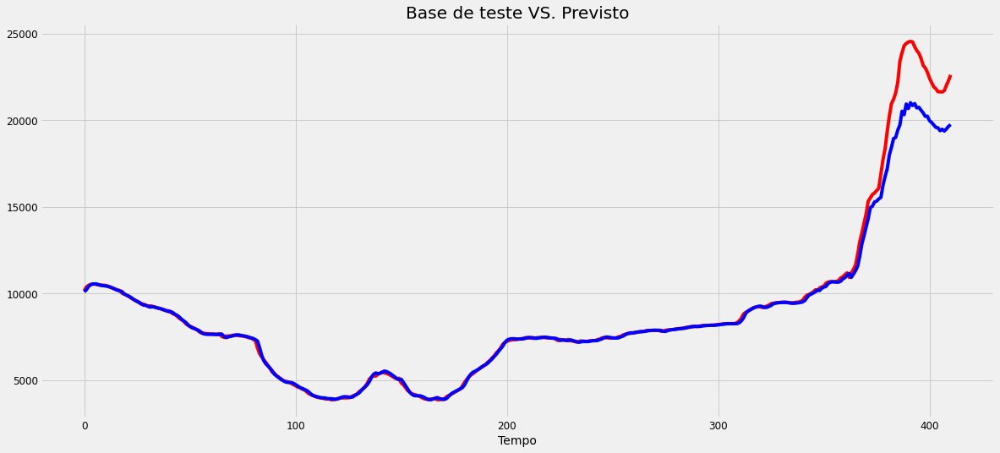

In [237]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [238]:
lstm_hs6_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_hs6_rmse)
lstm_hs6_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_hs6_mse)
lstm_hs6_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_hs6_mape, '%')
lstm_hs6_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  806.4558929632334
MSE:  650371.1072951262
MAPE:  1.69591757394208 %
R2:  0.9700968170045345


## HS7

### SARIMA

In [239]:
data = baltic.loc[baltic['Route'] == 'HS7'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS7'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).HS7.mean()
data.head()

Date
2018-03-31    10623.523810
2018-04-30    10142.100000
2018-05-31     9621.619048
2018-06-30     9904.142857
2018-07-31     9331.909091
Freq: M, Name: HS7, dtype: float64

#### Divisão da base

In [240]:
# Início da série
straining = data.index[0]
straining

Timestamp('2018-03-31 00:00:00', freq='M')

In [241]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2020-08-31 00:00:00', freq='M')

In [242]:
y = data.copy()
y.tail()

Date
2020-12-31     9065.833333
2021-01-31     9483.100000
2021-02-28    11359.450000
2021-03-31    20611.260870
2021-04-30    21742.600000
Freq: M, Name: HS7, dtype: float64

#### Exibição da série

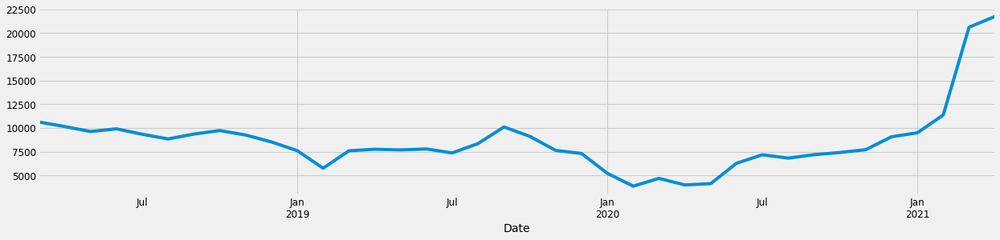

In [243]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

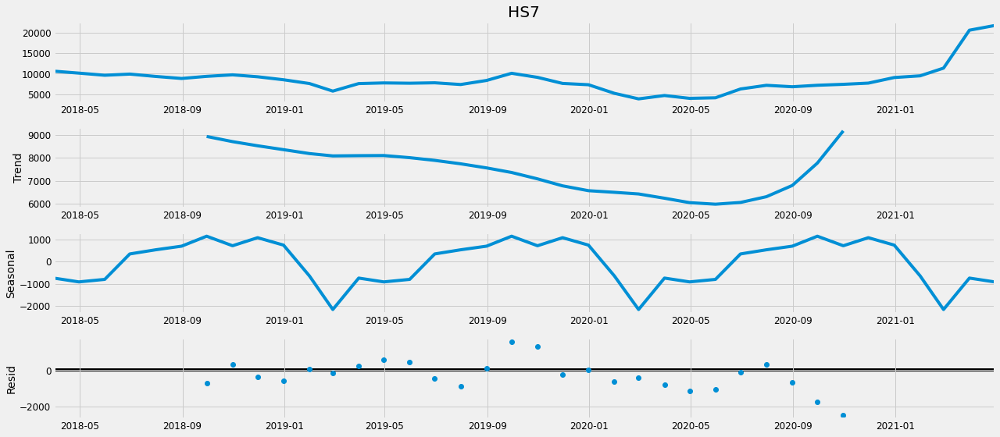

In [244]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [245]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [246]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:782.5705634306933
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1108.1881141623517
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:502.7205658710318


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:868: UserWarning:

Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.



ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:271.40593571250224
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:523.7751302764703
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:497.05459557622316
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:287.2879051823408
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:258.3419752740476
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:735.7884267382407
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:2851.826380382393
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:463.18668652125086


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:239.1614777995428
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:529.430063132232


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:458.93163684270075
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:278.5591762243903
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:227.01788224807103
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:645.7114796438013


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1069.2264196732053
ARIMA(0, 1, 0)x(0, 1, 0, 12)12 - AIC:440.04811653945006
ARIMA(0, 1, 0)x(0, 1, 1, 12)12 - AIC:218.0618365236418
ARIMA(0, 1, 0)x(1, 0, 0, 12)12 - AIC:457.27420016378363
ARIMA(0, 1, 0)x(1, 0, 1, 12)12 - AIC:432.705559672183
ARIMA(0, 1, 0)x(1, 1, 0, 12)12 - AIC:243.63416442089073
ARIMA(0, 1, 0)x(1, 1, 1, 12)12 - AIC:217.88945660204863
ARIMA(0, 1, 1)x(0, 0, 0, 12)12 - AIC:627.4276223844902


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 1, 1)x(0, 0, 1, 12)12 - AIC:1720.8668460122633
ARIMA(0, 1, 1)x(0, 1, 0, 12)12 - AIC:418.0547706356517
ARIMA(0, 1, 1)x(0, 1, 1, 12)12 - AIC:198.91018902319752
ARIMA(0, 1, 1)x(1, 0, 0, 12)12 - AIC:453.60611523865475
ARIMA(0, 1, 1)x(1, 0, 1, 12)12 - AIC:410.576976892615
ARIMA(0, 1, 1)x(1, 1, 0, 12)12 - AIC:242.7852042042481
ARIMA(0, 1, 1)x(1, 1, 1, 12)12 - AIC:198.16490425282842
ARIMA(1, 0, 0)x(0, 0, 0, 12)12 - AIC:663.1041508641727
ARIMA(1, 0, 0)x(0, 0, 1, 12)12 - AIC:2200.334094198992
ARIMA(1, 0, 0)x(0, 1, 0, 12)12 - AIC:454.6255251452197
ARIMA(1, 0, 0)x(0, 1, 1, 12)12 - AIC:229.20307621122237
ARIMA(1, 0, 0)x(1, 0, 0, 12)12 - AIC:451.2234654363074
ARIMA(1, 0, 0)x(1, 0, 1, 12)12 - AIC:450.75795819067463
ARIMA(1, 0, 0)x(1, 1, 0, 12)12 - AIC:245.35580921133797
ARIMA(1, 0, 0)x(1, 1, 1, 12)12 - AIC:228.55049241901273
ARIMA(1, 0, 1)x(0, 0, 0, 12)12 - AIC:646.0207700098794


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:2106.5952718318867
ARIMA(1, 0, 1)x(0, 1, 0, 12)12 - AIC:436.7568045142003
ARIMA(1, 0, 1)x(0, 1, 1, 12)12 - AIC:213.3775413672821
ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:453.2047272901687
ARIMA(1, 0, 1)x(1, 0, 1, 12)12 - AIC:433.64789130200825
ARIMA(1, 0, 1)x(1, 1, 0, 12)12 - AIC:245.71683440852394
ARIMA(1, 0, 1)x(1, 1, 1, 12)12 - AIC:211.19505528931194
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:644.7630198767577


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 1, 0)x(0, 0, 1, 12)12 - AIC:600.7630186970941
ARIMA(1, 1, 0)x(0, 1, 0, 12)12 - AIC:434.09554855306044
ARIMA(1, 1, 0)x(0, 1, 1, 12)12 - AIC:216.93622370131214
ARIMA(1, 1, 0)x(1, 0, 0, 12)12 - AIC:436.1846046317917
ARIMA(1, 1, 0)x(1, 0, 1, 12)12 - AIC:427.946494800717
ARIMA(1, 1, 0)x(1, 1, 0, 12)12 - AIC:223.83210647424642
ARIMA(1, 1, 0)x(1, 1, 1, 12)12 - AIC:215.69761516089724
ARIMA(1, 1, 1)x(0, 0, 0, 12)12 - AIC:628.6936964800643


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 1, 1)x(0, 0, 1, 12)12 - AIC:1617.337913147992
ARIMA(1, 1, 1)x(0, 1, 0, 12)12 - AIC:418.78996896631253
ARIMA(1, 1, 1)x(0, 1, 1, 12)12 - AIC:200.50064920923563
ARIMA(1, 1, 1)x(1, 0, 0, 12)12 - AIC:437.86243976484116
ARIMA(1, 1, 1)x(1, 0, 1, 12)12 - AIC:412.572656912584
ARIMA(1, 1, 1)x(1, 1, 0, 12)12 - AIC:225.48640794519636
ARIMA(1, 1, 1)x(1, 1, 1, 12)12 - AIC:200.07509890247758


#### Ajuste considerando o menor valor de AIC

In [247]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1251      0.693      0.181      0.857      -1.233       1.483
ma.L1          0.5362      0.538      0.997      0.319      -0.518       1.591
ar.S.L12      -0.9899      0.814     -1.216      0.224      -2.585       0.605
ma.S.L12      -1.1707      0.740     -1.581      0.114      -2.622       0.280
sigma2      1.425e+06   4.99e-07   2.86e+12      0.000    1.42e+06    1.42e+06


In [249]:
#results.plot_diagnostics(figsize=(18, 12))
#plt.show()

#### Previsão

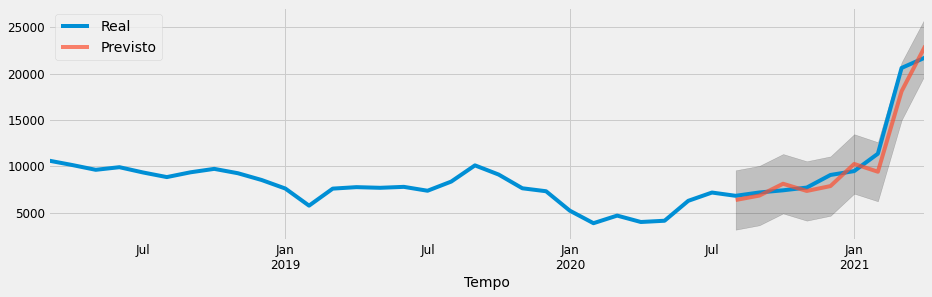

In [250]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [251]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_hs7_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_hs7_rmse)
sarima_hs7_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_hs7_mse)
sarima_hs7_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_hs7_mape, '%')
sarima_hs7_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  1276.5521138201389
MSE:  1629585.2992986648
MAPE:  9.116566896846045 %
R2:  0.9455181540098317


### LSTM

#### Divisão da base

training_set

In [252]:
temp = baltic.loc[baltic['Route'] == 'HS7'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS7'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,HS7
57423,2018-03-01,9456.0
57424,2018-03-02,9669.0
57425,2018-03-05,9794.0
57426,2018-03-06,9981.0
57427,2018-03-07,10053.0


In [253]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[ 9456.],
       [ 9669.],
       [ 9794.],
       [ 9981.],
       [10053.]])

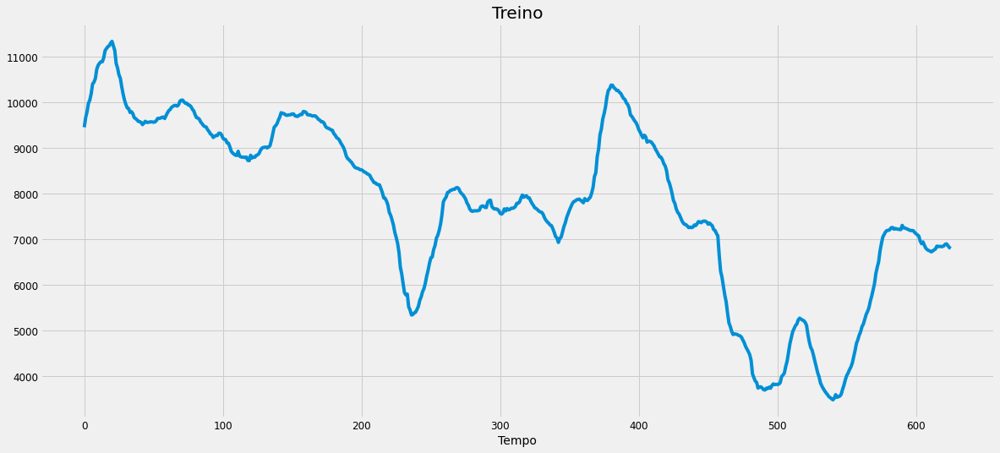

In [254]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [255]:
temp = baltic.loc[baltic['Route'] == 'HS7'].copy().drop(columns=['Route']).rename(columns = {'USD': 'HS7'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,HS7
58049,2020-09-01,6797.0
58050,2020-09-02,6791.0
58051,2020-09-03,6810.0
58052,2020-09-04,6878.0
58053,2020-09-07,6938.0


In [256]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[6797.],
       [6791.],
       [6810.],
       [6878.],
       [6938.]])

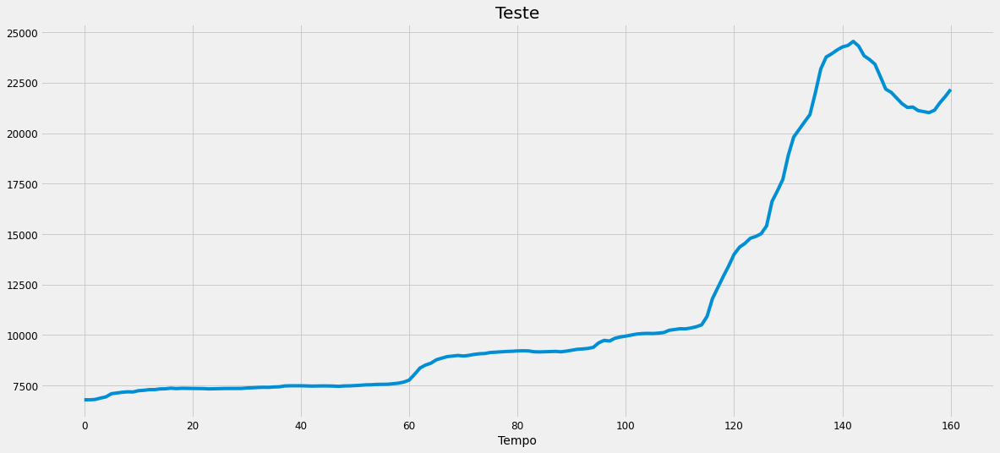

In [257]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [258]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [259]:
training_set_scaled[0:5]

array([[0.76043788],
       [0.78755092],
       [0.80346232],
       [0.82726578],
       [0.83643075]])

##### Criar a estrutura de dados

In [260]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [261]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.760438,0.787551,0.803462,0.827266,0.836431,0.854379,0.881365,0.886202,0.896512,0.922352
1,0.787551,0.803462,0.827266,0.836431,0.854379,0.881365,0.886202,0.896512,0.922352,0.933172
2,0.803462,0.827266,0.836431,0.854379,0.881365,0.886202,0.896512,0.922352,0.933172,0.939027
3,0.827266,0.836431,0.854379,0.881365,0.886202,0.896512,0.922352,0.933172,0.939027,0.942974
4,0.836431,0.854379,0.881365,0.886202,0.896512,0.922352,0.933172,0.939027,0.942974,0.943101


In [262]:
pd.DataFrame(y_train).head()

,0
0,0.933172
1,0.939027
2,0.942974
3,0.943101
4,0.953793


##### *Reshaping*

In [263]:
X_train.shape

(616, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [264]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [265]:
X_train.shape

(616, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [266]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_16 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_16 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_17 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_17 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_18 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_18 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                

###### Treinamento

In [267]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 554 samples, validate on 62 samples
Epoch 1/1000
554/554 [==============================] - 2s 3ms/step - loss: 0.0919 - val_loss: 0.0081
Epoch 2/1000
554/554 [==============================] - 0s 700us/step - loss: 0.0162 - val_loss: 0.0017
Epoch 3/1000
554/554 [==============================] - 0s 691us/step - loss: 0.0105 - val_loss: 0.0022
Epoch 4/1000
554/554 [==============================] - 0s 700us/step - loss: 0.0071 - val_loss: 0.0036
Epoch 5/1000
554/554 [==============================] - 0s 713us/step - loss: 0.0064 - val_loss: 0.0039
Epoch 6/1000
554/554 [==============================] - 0s 713us/step - loss: 0.0063 - val_loss: 0.0031
Epoch 7/1000
554/554 [==============================] - 0s 702us/step - loss: 0.0061 - val_loss: 0.0033
Epoch 8/1000
554/554 [==============================] - 0s 696us/step - loss: 0.0062 - val_loss: 0.0036
Epoch 9/1000
554/554 [==============================] - 0s 705us/step - loss: 0.0064 - val_loss: 0.0035
Epoch 10/1000
554/554

554/554 [==============================] - 0s 819us/step - loss: 0.0027 - val_loss: 3.2139e-04
Epoch 78/1000
554/554 [==============================] - 0s 778us/step - loss: 0.0022 - val_loss: 2.6441e-04
Epoch 79/1000
554/554 [==============================] - 0s 769us/step - loss: 0.0024 - val_loss: 2.5721e-04
Epoch 80/1000
554/554 [==============================] - 0s 767us/step - loss: 0.0019 - val_loss: 2.2005e-04
Epoch 81/1000
554/554 [==============================] - 0s 770us/step - loss: 0.0021 - val_loss: 4.8384e-04
Epoch 82/1000
554/554 [==============================] - 0s 772us/step - loss: 0.0024 - val_loss: 3.6398e-04
Epoch 83/1000
554/554 [==============================] - 0s 763us/step - loss: 0.0021 - val_loss: 2.9139e-04
Epoch 84/1000
554/554 [==============================] - 0s 815us/step - loss: 0.0018 - val_loss: 2.1689e-04
Epoch 85/1000
554/554 [==============================] - 0s 772us/step - loss: 0.0018 - val_loss: 2.9519e-04
Epoch 86/1000
554/554 [==========

Epoch 152/1000
554/554 [==============================] - 0s 786us/step - loss: 0.0012 - val_loss: 1.3396e-04
Epoch 153/1000
554/554 [==============================] - 0s 787us/step - loss: 0.0011 - val_loss: 1.1035e-04
Epoch 154/1000
554/554 [==============================] - 0s 785us/step - loss: 0.0011 - val_loss: 1.0607e-04
Epoch 155/1000
554/554 [==============================] - 0s 769us/step - loss: 0.0012 - val_loss: 1.7795e-04
Epoch 156/1000
554/554 [==============================] - 0s 767us/step - loss: 0.0012 - val_loss: 1.8438e-04
Epoch 157/1000
554/554 [==============================] - 0s 773us/step - loss: 0.0012 - val_loss: 1.3196e-04
Epoch 158/1000
554/554 [==============================] - 0s 769us/step - loss: 0.0013 - val_loss: 1.3446e-04
Epoch 159/1000
554/554 [==============================] - 0s 768us/step - loss: 0.0013 - val_loss: 5.4361e-04
Epoch 160/1000
554/554 [==============================] - 0s 759us/step - loss: 0.0012 - val_loss: 1.7402e-04
Epoch 161/

554/554 [==============================] - 0s 767us/step - loss: 8.1227e-04 - val_loss: 9.9301e-05
Epoch 226/1000
554/554 [==============================] - 0s 769us/step - loss: 9.7362e-04 - val_loss: 2.9283e-04
Epoch 227/1000
554/554 [==============================] - 0s 766us/step - loss: 9.5683e-04 - val_loss: 7.8965e-05
Epoch 228/1000
554/554 [==============================] - 0s 812us/step - loss: 8.7533e-04 - val_loss: 1.5032e-04
Epoch 229/1000
554/554 [==============================] - 0s 774us/step - loss: 9.2021e-04 - val_loss: 1.0266e-04
Epoch 230/1000
554/554 [==============================] - 0s 807us/step - loss: 8.7882e-04 - val_loss: 9.8212e-05
Epoch 231/1000
554/554 [==============================] - 0s 772us/step - loss: 9.1000e-04 - val_loss: 8.4954e-05
Epoch 232/1000
554/554 [==============================] - 0s 855us/step - loss: 9.1427e-04 - val_loss: 9.4865e-05
Epoch 233/1000
554/554 [==============================] - 0s 794us/step - loss: 9.0148e-04 - val_loss: 

Epoch 297/1000
554/554 [==============================] - 0s 810us/step - loss: 7.9452e-04 - val_loss: 7.1439e-05
Epoch 298/1000
554/554 [==============================] - 0s 833us/step - loss: 7.4902e-04 - val_loss: 7.8207e-05
Epoch 299/1000
554/554 [==============================] - 0s 808us/step - loss: 6.8807e-04 - val_loss: 1.2010e-04
Epoch 300/1000
554/554 [==============================] - 0s 841us/step - loss: 8.0652e-04 - val_loss: 8.2027e-05
Epoch 301/1000
554/554 [==============================] - 0s 816us/step - loss: 8.2405e-04 - val_loss: 7.9175e-05
Epoch 302/1000
554/554 [==============================] - 0s 841us/step - loss: 6.8282e-04 - val_loss: 8.2649e-05
Epoch 303/1000
554/554 [==============================] - 0s 823us/step - loss: 7.7328e-04 - val_loss: 9.3506e-05
Epoch 304/1000
554/554 [==============================] - 0s 817us/step - loss: 7.5478e-04 - val_loss: 8.4630e-05
Epoch 305/1000
554/554 [==============================] - 0s 850us/step - loss: 7.2755e-

Epoch 369/1000
554/554 [==============================] - 0s 763us/step - loss: 6.8514e-04 - val_loss: 8.7074e-05
Epoch 370/1000
554/554 [==============================] - 0s 762us/step - loss: 7.6225e-04 - val_loss: 8.0985e-05
Epoch 371/1000
554/554 [==============================] - 0s 761us/step - loss: 7.7809e-04 - val_loss: 7.9420e-05
Epoch 372/1000
554/554 [==============================] - 0s 759us/step - loss: 6.9665e-04 - val_loss: 8.2021e-05
Epoch 373/1000
554/554 [==============================] - 0s 761us/step - loss: 7.5128e-04 - val_loss: 8.0617e-05
Epoch 374/1000
554/554 [==============================] - 0s 763us/step - loss: 7.4073e-04 - val_loss: 7.9329e-05
Epoch 375/1000
554/554 [==============================] - 0s 767us/step - loss: 7.3635e-04 - val_loss: 8.0799e-05
Epoch 376/1000
554/554 [==============================] - 0s 761us/step - loss: 7.5213e-04 - val_loss: 8.1032e-05


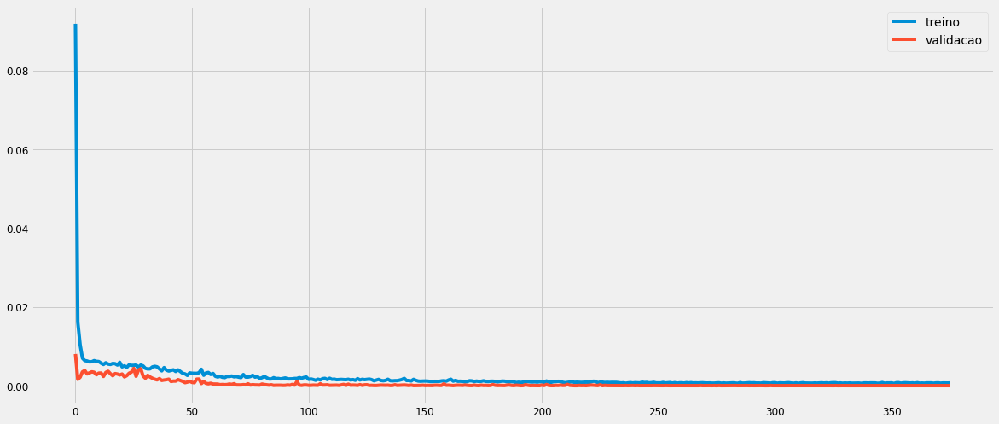

In [268]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [269]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [270]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.42573124],
       [0.4192207 ],
       [0.41505888],
       [0.41520917],
       [0.42133206]], dtype=float32)

In [271]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[6826.545 ],
       [6775.398 ],
       [6742.7026],
       [6743.8833],
       [6791.985 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

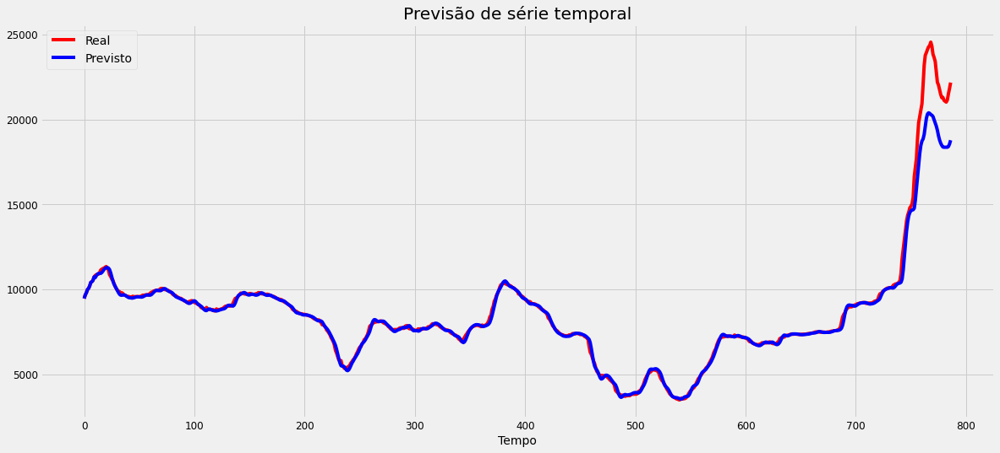

In [272]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

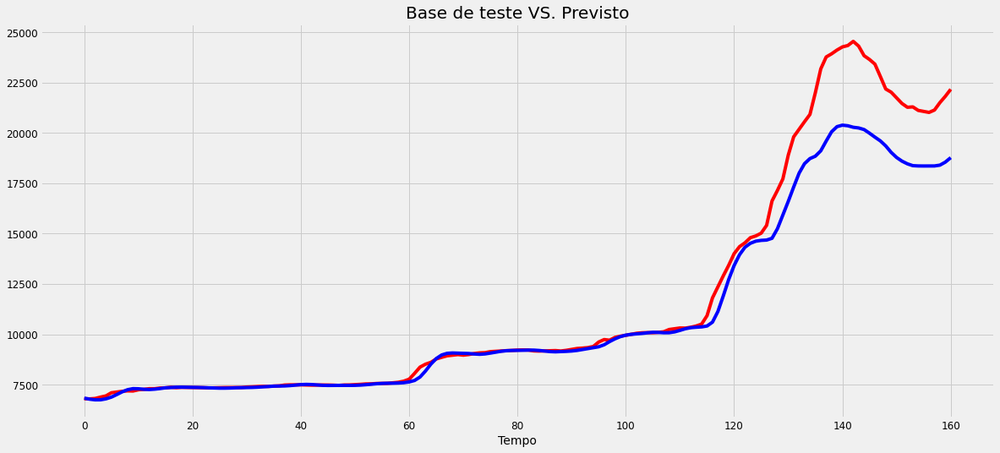

In [273]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [274]:
lstm_hs7_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_hs7_rmse)
lstm_hs7_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_hs7_mse)
lstm_hs7_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_hs7_mape, '%')
lstm_hs7_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  1462.4217653491392
MSE:  2138677.4197668927
MAPE:  3.765212747074951 %
R2:  0.9324538378073863


## S1B

### SARIMA

In [275]:
data = baltic.loc[baltic['Route'] == 'S1B'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S1B'}) 
data = data.groupby([pd.Grouper(key='Date', freq='M')]).S1B.mean()
data.head()

Date
2013-01-31     9502.090909
2013-02-28    10051.050000
2013-03-31    12115.950000
2013-04-30    13620.142857
2013-05-31    13341.190476
Freq: M, Name: S1B, dtype: float64

#### Divisão da base

In [276]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [277]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [278]:
y = data.copy()
y.tail()

Date
2020-12-31    20380.333333
2021-01-31    21017.800000
2021-02-28    27860.800000
2021-03-31    32305.000000
2021-04-30    27538.866667
Freq: M, Name: S1B, dtype: float64

#### Exibição da série

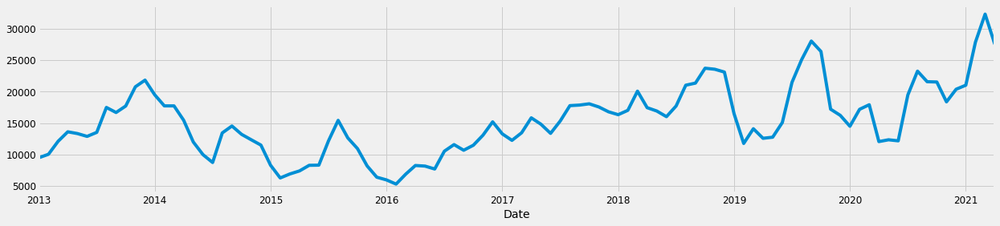

In [279]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

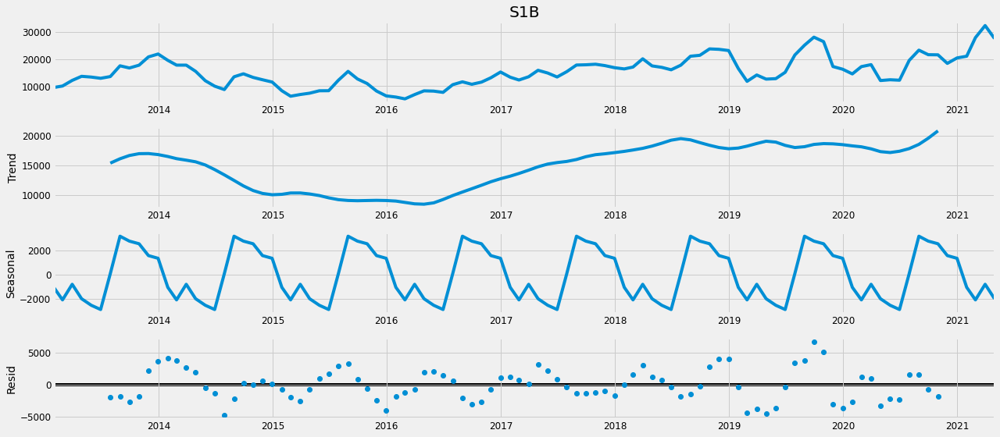

In [280]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [281]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [282]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2203.377867377529
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1859.8212662351398
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1749.8645665871825
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1505.34353869919
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1774.1149388126603
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1730.0138182181788
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1530.3971959613543
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1505.937723227226
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:2110.4176767558497
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1839.4283646485653
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1636.700124604621
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1405.8290690119175
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1874.8709046516797
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1833.5477474488741
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1462.5845239845355
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1407.742647489978
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1825.2723875763102
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1600.050063179433

#### Ajuste considerando o menor valor de AIC

In [283]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4526      0.196     -2.306      0.021      -0.837      -0.068
ma.L1          0.8959      0.107      8.344      0.000       0.685       1.106
ar.S.L12      -0.1504      0.317     -0.475      0.635      -0.771       0.470
ma.S.L12      -0.4318      0.349     -1.238      0.216      -1.115       0.252
sigma2      6.501e+06    1.3e+06      5.005      0.000    3.95e+06    9.05e+06


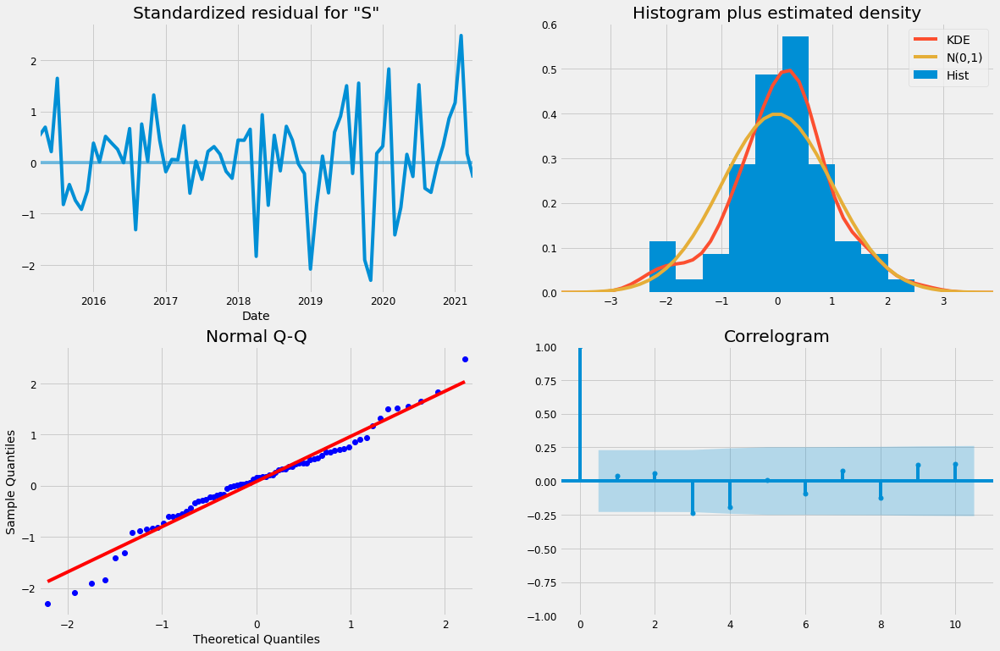

In [284]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

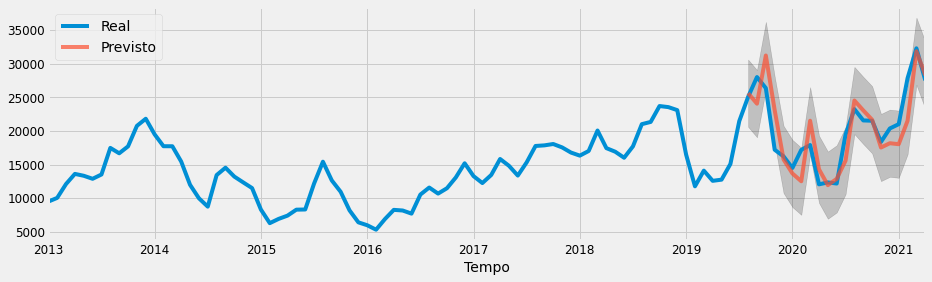

In [285]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [286]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_s1b_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_s1b_rmse)
sarima_s1b_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_s1b_mse)
sarima_s1b_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_s1b_mape, '%')
sarima_s1b_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  3004.1560895817074
MSE:  9024953.810570855
MAPE:  11.494559572260188 %
R2:  0.7128076071946599


### LSTM

#### Divisão da base

training_set

In [287]:
temp = baltic.loc[baltic['Route'] == 'S1B'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S1B'}) 
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,S1B
24847,2013-01-02,9555.0
24848,2013-01-03,9532.0
24849,2013-01-04,9514.0
24850,2013-01-07,9536.0
24851,2013-01-08,9555.0


In [288]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[9555.],
       [9532.],
       [9514.],
       [9536.],
       [9555.]])

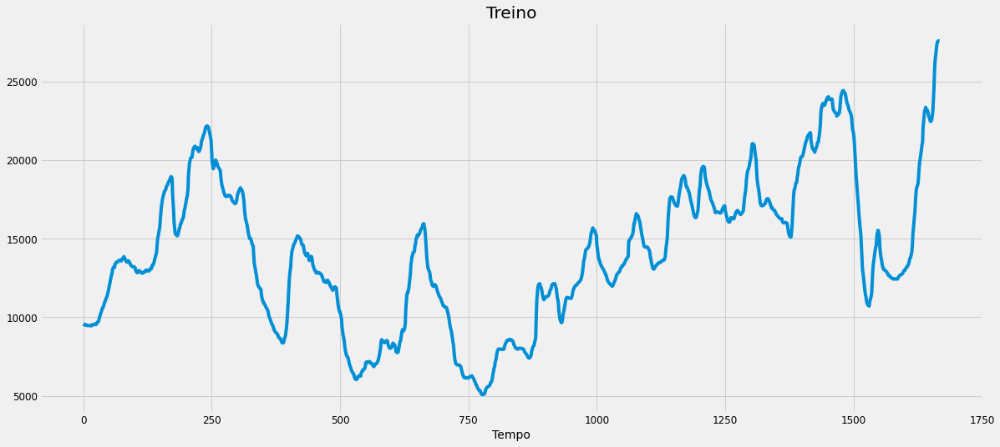

In [289]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [290]:
temp = baltic.loc[baltic['Route'] == 'S1B'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S1B'}) 
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,S1B
26515,2019-09-02,27579.0
26516,2019-09-03,27604.0
26517,2019-09-04,27571.0
26518,2019-09-05,27568.0
26519,2019-09-06,27568.0


In [291]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[27579.],
       [27604.],
       [27571.],
       [27568.],
       [27568.]])

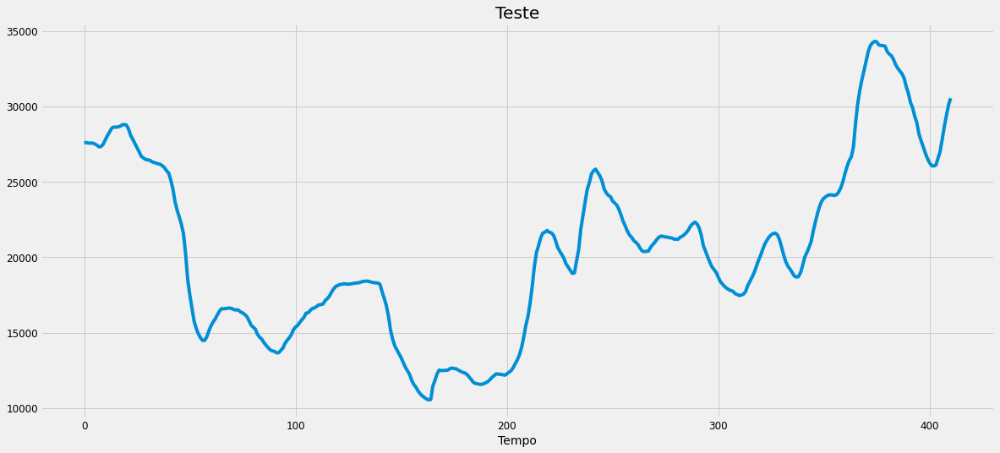

In [292]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [293]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [294]:
training_set_scaled[0:5]

array([[0.19866696],
       [0.19764497],
       [0.19684515],
       [0.19782271],
       [0.19866696]])

##### Criar a estrutura de dados

In [295]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [296]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.198667,0.197645,0.196845,0.197823,0.198667,0.197556,0.195512,0.195201,0.194890,0.194801
1,0.197645,0.196845,0.197823,0.198667,0.197556,0.195512,0.195201,0.194890,0.194801,0.195201
2,0.196845,0.197823,0.198667,0.197556,0.195512,0.195201,0.194890,0.194801,0.195201,0.195201
3,0.197823,0.198667,0.197556,0.195512,0.195201,0.194890,0.194801,0.195201,0.195201,0.195201
4,0.198667,0.197556,0.195512,0.195201,0.194890,0.194801,0.195201,0.195201,0.195201,0.195201


In [297]:
pd.DataFrame(y_train).head()

,0
0,0.195201
1,0.195201
2,0.195201
3,0.195201
4,0.194801


##### *Reshaping*

In [298]:
X_train.shape

(1658, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [299]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [300]:
X_train.shape

(1658, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [301]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_19 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_19 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_20 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_20 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_21 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_21 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_7 (Dense)              (None, 1)                

###### Treinamento

In [302]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1492 samples, validate on 166 samples
Epoch 1/1000
1492/1492 [==============================] - 2s 1ms/step - loss: 0.0200 - val_loss: 0.0077
Epoch 2/1000
1492/1492 [==============================] - 1s 687us/step - loss: 0.0037 - val_loss: 0.0081
Epoch 3/1000
1492/1492 [==============================] - 1s 734us/step - loss: 0.0034 - val_loss: 0.0064
Epoch 4/1000
1492/1492 [==============================] - 1s 752us/step - loss: 0.0034 - val_loss: 0.0061
Epoch 5/1000
1492/1492 [==============================] - 1s 753us/step - loss: 0.0031 - val_loss: 0.0056
Epoch 6/1000
1492/1492 [==============================] - 1s 728us/step - loss: 0.0034 - val_loss: 0.0062
Epoch 7/1000
1492/1492 [==============================] - 1s 735us/step - loss: 0.0028 - val_loss: 0.0067
Epoch 8/1000
1492/1492 [==============================] - 1s 711us/step - loss: 0.0028 - val_loss: 0.0051
Epoch 9/1000
1492/1492 [==============================] - 1s 687us/step - loss: 0.0025 - val_loss: 0.0056
E

1492/1492 [==============================] - 1s 690us/step - loss: 5.3605e-04 - val_loss: 4.7028e-04
Epoch 75/1000
1492/1492 [==============================] - 1s 705us/step - loss: 5.6099e-04 - val_loss: 3.7686e-04
Epoch 76/1000
1492/1492 [==============================] - 1s 693us/step - loss: 6.8577e-04 - val_loss: 4.4485e-04
Epoch 77/1000
1492/1492 [==============================] - 1s 706us/step - loss: 4.6361e-04 - val_loss: 3.3599e-04
Epoch 78/1000
1492/1492 [==============================] - 1s 734us/step - loss: 5.1074e-04 - val_loss: 3.9792e-04
Epoch 79/1000
1492/1492 [==============================] - 1s 738us/step - loss: 5.4701e-04 - val_loss: 3.9516e-04
Epoch 80/1000
1492/1492 [==============================] - 1s 728us/step - loss: 5.0201e-04 - val_loss: 3.1614e-04
Epoch 81/1000
1492/1492 [==============================] - 1s 702us/step - loss: 5.7222e-04 - val_loss: 5.6529e-04
Epoch 82/1000
1492/1492 [==============================] - 1s 738us/step - loss: 5.3356e-04 - 

Epoch 145/1000
1492/1492 [==============================] - 1s 705us/step - loss: 4.3671e-04 - val_loss: 3.0260e-04
Epoch 146/1000
1492/1492 [==============================] - 1s 694us/step - loss: 4.1336e-04 - val_loss: 2.0088e-04
Epoch 147/1000
1492/1492 [==============================] - 1s 685us/step - loss: 4.4299e-04 - val_loss: 3.0788e-04
Epoch 148/1000
1492/1492 [==============================] - 1s 694us/step - loss: 4.5321e-04 - val_loss: 1.8547e-04
Epoch 149/1000
1492/1492 [==============================] - 1s 682us/step - loss: 3.8650e-04 - val_loss: 3.3063e-04
Epoch 150/1000
1492/1492 [==============================] - 1s 690us/step - loss: 4.1550e-04 - val_loss: 1.6332e-04
Epoch 151/1000
1492/1492 [==============================] - 1s 677us/step - loss: 4.2741e-04 - val_loss: 1.8933e-04
Epoch 152/1000
1492/1492 [==============================] - 1s 678us/step - loss: 3.9052e-04 - val_loss: 4.9485e-04
Epoch 153/1000
1492/1492 [==============================] - 1s 694us/ste

1492/1492 [==============================] - 1s 703us/step - loss: 4.0868e-04 - val_loss: 2.2077e-04
Epoch 216/1000
1492/1492 [==============================] - 1s 713us/step - loss: 4.5566e-04 - val_loss: 2.6213e-04
Epoch 217/1000
1492/1492 [==============================] - 1s 722us/step - loss: 3.9102e-04 - val_loss: 1.2294e-04
Epoch 218/1000
1492/1492 [==============================] - 1s 693us/step - loss: 3.8120e-04 - val_loss: 1.0504e-04
Epoch 219/1000
1492/1492 [==============================] - 1s 680us/step - loss: 3.7848e-04 - val_loss: 1.4360e-04
Epoch 220/1000
1492/1492 [==============================] - 1s 681us/step - loss: 3.4671e-04 - val_loss: 1.6041e-04
Epoch 221/1000
1492/1492 [==============================] - 1s 706us/step - loss: 3.4626e-04 - val_loss: 1.8776e-04
Epoch 222/1000
1492/1492 [==============================] - 1s 687us/step - loss: 3.4472e-04 - val_loss: 1.1696e-04
Epoch 223/1000
1492/1492 [==============================] - 1s 682us/step - loss: 3.739

Epoch 286/1000
1492/1492 [==============================] - 1s 679us/step - loss: 3.8653e-04 - val_loss: 8.8156e-05
Epoch 287/1000
1492/1492 [==============================] - 1s 682us/step - loss: 3.7795e-04 - val_loss: 9.9076e-05
Epoch 288/1000
1492/1492 [==============================] - 1s 705us/step - loss: 3.3555e-04 - val_loss: 4.0219e-04
Epoch 289/1000
1492/1492 [==============================] - 1s 695us/step - loss: 3.5404e-04 - val_loss: 9.6041e-05
Epoch 290/1000
1492/1492 [==============================] - 1s 688us/step - loss: 3.5761e-04 - val_loss: 1.7267e-04
Epoch 291/1000
1492/1492 [==============================] - 1s 691us/step - loss: 3.5686e-04 - val_loss: 2.4204e-04
Epoch 292/1000
1492/1492 [==============================] - 1s 680us/step - loss: 3.8195e-04 - val_loss: 1.5991e-04
Epoch 293/1000
1492/1492 [==============================] - 1s 713us/step - loss: 3.0749e-04 - val_loss: 2.1711e-04
Epoch 294/1000
1492/1492 [==============================] - 1s 718us/ste

1492/1492 [==============================] - 1s 726us/step - loss: 3.2788e-04 - val_loss: 8.8759e-05
Epoch 357/1000
1492/1492 [==============================] - 1s 705us/step - loss: 2.9435e-04 - val_loss: 8.0376e-05
Epoch 358/1000
1492/1492 [==============================] - 1s 675us/step - loss: 2.6335e-04 - val_loss: 8.0145e-05
Epoch 359/1000
1492/1492 [==============================] - 1s 677us/step - loss: 2.9365e-04 - val_loss: 1.0050e-04
Epoch 360/1000
1492/1492 [==============================] - 1s 668us/step - loss: 2.9912e-04 - val_loss: 7.9521e-05
Epoch 361/1000
1492/1492 [==============================] - 1s 680us/step - loss: 3.0062e-04 - val_loss: 1.6054e-04
Epoch 362/1000
1492/1492 [==============================] - 1s 678us/step - loss: 2.9337e-04 - val_loss: 7.7888e-05
Epoch 363/1000
1492/1492 [==============================] - 1s 681us/step - loss: 2.9806e-04 - val_loss: 1.3657e-04
Epoch 364/1000
1492/1492 [==============================] - 1s 706us/step - loss: 3.125

Epoch 427/1000
1492/1492 [==============================] - 1s 795us/step - loss: 2.9012e-04 - val_loss: 7.7029e-05
Epoch 428/1000
1492/1492 [==============================] - 1s 787us/step - loss: 2.7862e-04 - val_loss: 8.6559e-05
Epoch 429/1000
1492/1492 [==============================] - 1s 794us/step - loss: 2.8086e-04 - val_loss: 8.2583e-05
Epoch 430/1000
1492/1492 [==============================] - 1s 835us/step - loss: 2.5285e-04 - val_loss: 8.6150e-05
Epoch 431/1000
1492/1492 [==============================] - 1s 845us/step - loss: 2.9936e-04 - val_loss: 8.5197e-05
Epoch 432/1000
1492/1492 [==============================] - 1s 817us/step - loss: 2.8717e-04 - val_loss: 8.5776e-05
Epoch 433/1000
1492/1492 [==============================] - 1s 812us/step - loss: 2.7782e-04 - val_loss: 8.7343e-05
Epoch 434/1000
1492/1492 [==============================] - 1s 789us/step - loss: 2.6778e-04 - val_loss: 8.2442e-05
Epoch 435/1000
1492/1492 [==============================] - 1s 783us/ste

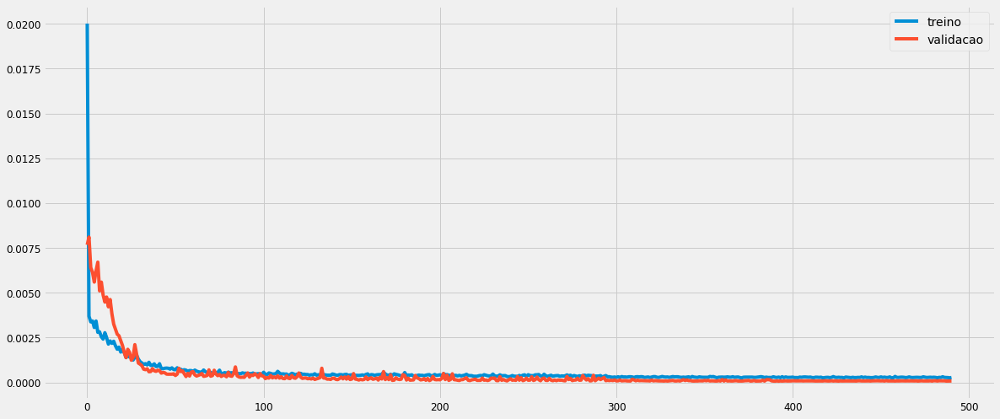

In [303]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [304]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [305]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.985878  ],
       [0.98533976],
       [0.9863603 ],
       [0.9844309 ],
       [0.98395514]], dtype=float32)

In [306]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[27271.184],
       [27259.07 ],
       [27282.037],
       [27238.617],
       [27227.91 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

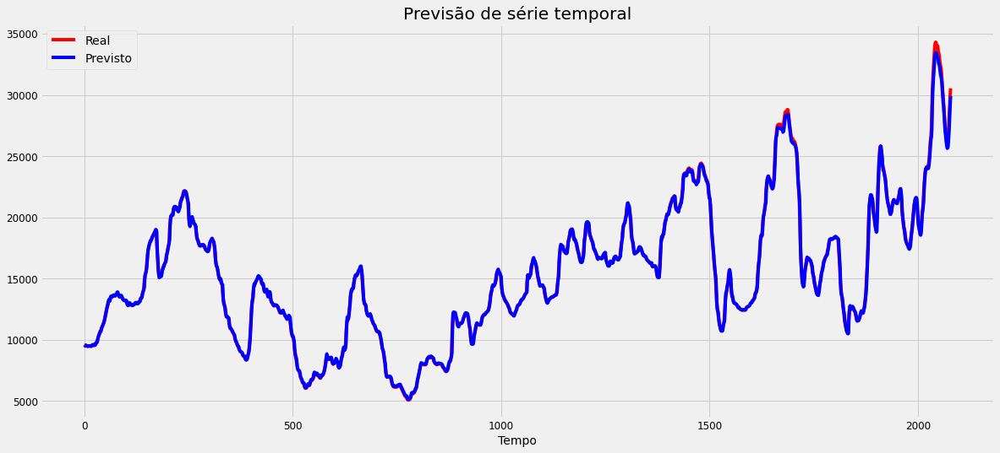

In [307]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

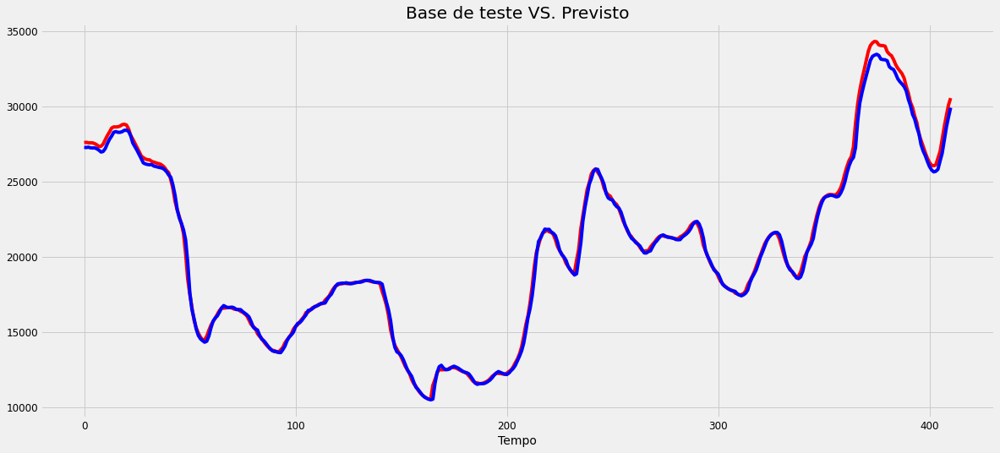

In [308]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [309]:
lstm_s1b_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_s1b_rmse)
lstm_s1b_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_s1b_mse)
lstm_s1b_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_s1b_mape, '%')
lstm_s1b_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  328.5137752873986
MSE:  107921.30055357941
MAPE:  0.9383360652493771 %
R2:  0.9968905335682761


## S1C

### SARIMA

In [310]:
data = baltic.loc[baltic['Route'] == 'S1C'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S1C'})  
data = data.groupby([pd.Grouper(key='Date', freq='M')]).S1C.mean()
data.head()

Date
2015-10-31    12963.933333
2015-11-30    11475.904762
2015-12-31     9154.777778
2016-01-31     9032.300000
2016-02-29     7153.904762
Freq: M, Name: S1C, dtype: float64

#### Divisão da base

In [311]:
# Início da série
straining = data.index[0]
straining

Timestamp('2015-10-31 00:00:00', freq='M')

In [312]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2020-03-31 00:00:00', freq='M')

In [313]:
y = data.copy()
y.tail()

Date
2020-12-31    23249.444444
2021-01-31    24596.350000
2021-02-28    29461.500000
2021-03-31    32375.608696
2021-04-30    25676.600000
Freq: M, Name: S1C, dtype: float64

#### Exibição da série

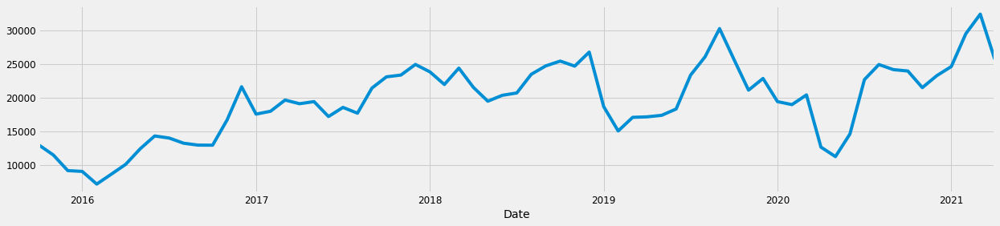

In [314]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

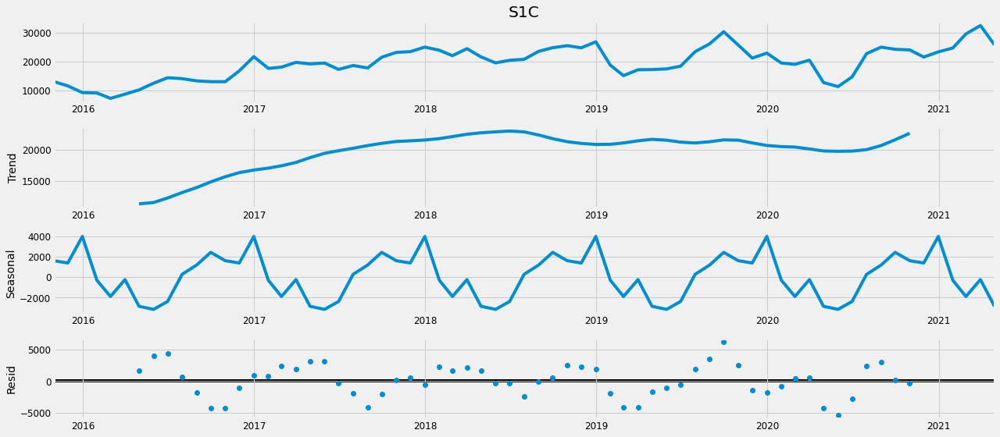

In [315]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [316]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [317]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1498.8199140316171
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1199.851195710099
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1092.8285593134071
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:834.9975900551283
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1109.8432335544987
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1078.730444710182
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:858.9459440806144
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:839.6774773649014
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1431.610327969221
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1162.4600889372614
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1036.8678207780695
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:793.492231613996
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1076.1254994319227
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1158.0854471829866
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:839.720556137551
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:802.5386182783258
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1225.7230033380783
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1001.5177802234933
ARI

#### Ajuste considerando o menor valor de AIC

In [318]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0718      0.521      0.138      0.890      -0.950       1.093
ma.L1          0.4542      0.446      1.019      0.308      -0.419       1.328
ar.S.L12      -0.4942      0.202     -2.451      0.014      -0.889      -0.099
ma.S.L12      -0.1690      0.347     -0.487      0.626      -0.849       0.511
sigma2      9.188e+06   2.31e+06      3.971      0.000    4.65e+06    1.37e+07


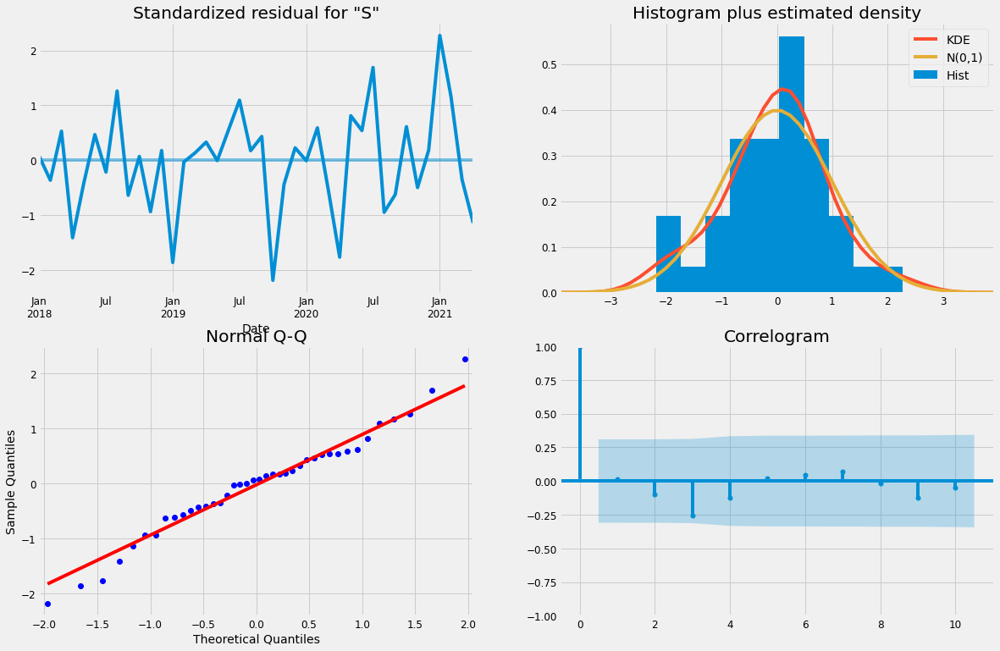

In [319]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

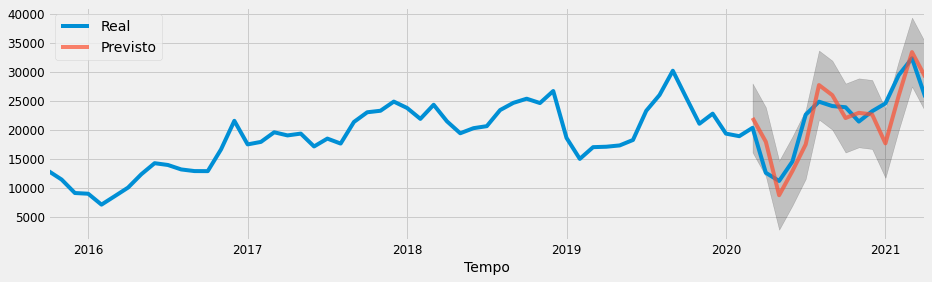

In [320]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [321]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_s1c_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_s1c_rmse)
sarima_s1c_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_s1c_mse)
sarima_s1c_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_s1c_mape, '%')
sarima_s1c_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  3351.1105179403194
MSE:  11229941.703450236
MAPE:  14.259455204804345 %
R2:  0.6604081147667675


### LSTM

#### Divisão da base

training_set

In [322]:
temp = baltic.loc[baltic['Route'] == 'S1C'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S1C'}) 
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,S1C
26926,2015-10-12,12581.0
26927,2015-10-13,12583.0
26928,2015-10-14,12667.0
26929,2015-10-15,12647.0
26930,2015-10-16,12667.0


In [323]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[12581.],
       [12583.],
       [12667.],
       [12647.],
       [12667.]])

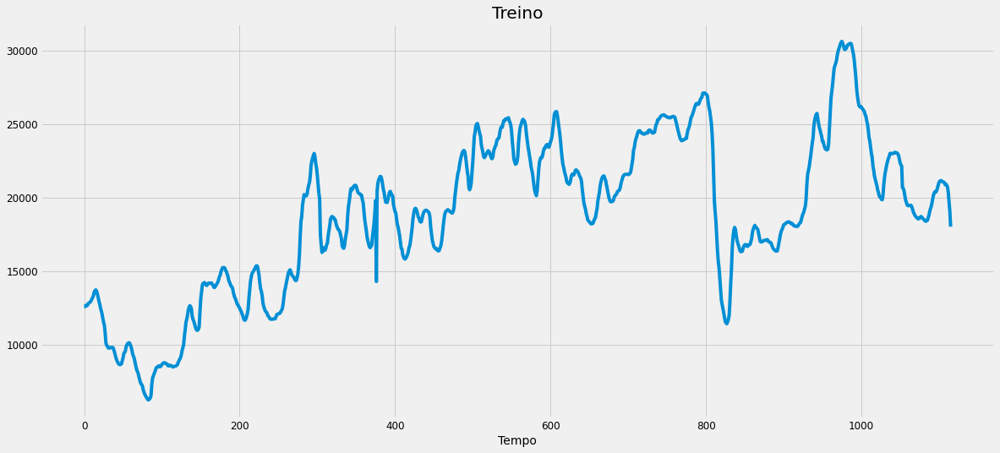

In [324]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [325]:
temp = baltic.loc[baltic['Route'] == 'S1C'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S1C'}) 
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,S1C
28042,2020-03-31,16806.0
28043,2020-04-01,15839.0
28044,2020-04-02,15269.0
28045,2020-04-03,14703.0
28046,2020-04-06,14394.0


In [326]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[16806.],
       [15839.],
       [15269.],
       [14703.],
       [14394.]])

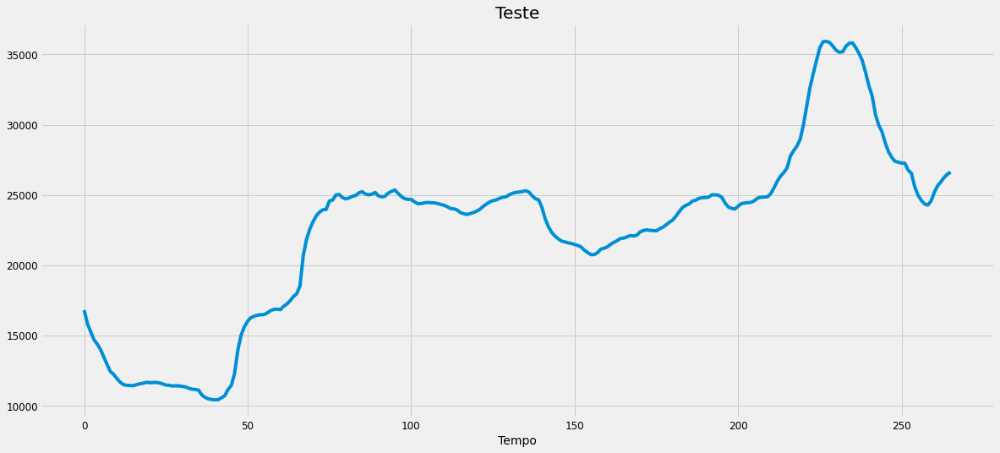

In [327]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [328]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [329]:
training_set_scaled[0:5]

array([[0.25975359],
       [0.25983573],
       [0.26328542],
       [0.26246407],
       [0.26328542]])

##### Criar a estrutura de dados

In [330]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [331]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.259754,0.259836,0.263285,0.262464,0.263285,0.268296,0.269774,0.271622,0.273018,0.276386
1,0.259836,0.263285,0.262464,0.263285,0.268296,0.269774,0.271622,0.273018,0.276386,0.281971
2,0.263285,0.262464,0.263285,0.268296,0.269774,0.271622,0.273018,0.276386,0.281971,0.285421
3,0.262464,0.263285,0.268296,0.269774,0.271622,0.273018,0.276386,0.281971,0.285421,0.291335
4,0.263285,0.268296,0.269774,0.271622,0.273018,0.276386,0.281971,0.285421,0.291335,0.300903


In [332]:
pd.DataFrame(y_train).head()

,0
0,0.281971
1,0.285421
2,0.291335
3,0.300903
4,0.304846


##### *Reshaping*

In [333]:
X_train.shape

(1106, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [334]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [335]:
X_train.shape

(1106, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [336]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_22 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_22 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_23 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_23 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_24 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_24 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_8 (Dense)              (None, 1)                

###### Treinamento

In [337]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 995 samples, validate on 111 samples
Epoch 1/1000
995/995 [==============================] - 2s 2ms/step - loss: 0.0531 - val_loss: 0.0041
Epoch 2/1000
995/995 [==============================] - 1s 896us/step - loss: 0.0090 - val_loss: 0.0026
Epoch 3/1000
995/995 [==============================] - 1s 898us/step - loss: 0.0073 - val_loss: 0.0023
Epoch 4/1000
995/995 [==============================] - 1s 921us/step - loss: 0.0072 - val_loss: 0.0024
Epoch 5/1000
995/995 [==============================] - 1s 954us/step - loss: 0.0065 - val_loss: 0.0024
Epoch 6/1000
995/995 [==============================] - 1s 995us/step - loss: 0.0077 - val_loss: 0.0029
Epoch 7/1000
995/995 [==============================] - 1s 977us/step - loss: 0.0062 - val_loss: 0.0031
Epoch 8/1000
995/995 [==============================] - 1s 878us/step - loss: 0.0063 - val_loss: 0.0020
Epoch 9/1000
995/995 [==============================] - 1s 902us/step - loss: 0.0066 - val_loss: 0.0021
Epoch 10/1000
995/99

Epoch 77/1000
995/995 [==============================] - 1s 916us/step - loss: 0.0014 - val_loss: 2.5123e-04
Epoch 78/1000
995/995 [==============================] - 1s 899us/step - loss: 0.0014 - val_loss: 3.9211e-04
Epoch 79/1000
995/995 [==============================] - 1s 850us/step - loss: 0.0014 - val_loss: 1.7391e-04
Epoch 80/1000
995/995 [==============================] - 1s 909us/step - loss: 0.0014 - val_loss: 1.8345e-04
Epoch 81/1000
995/995 [==============================] - 1s 906us/step - loss: 0.0014 - val_loss: 3.5801e-04
Epoch 82/1000
995/995 [==============================] - 1s 886us/step - loss: 0.0014 - val_loss: 1.7548e-04
Epoch 83/1000
995/995 [==============================] - 1s 865us/step - loss: 0.0014 - val_loss: 7.6865e-04
Epoch 84/1000
995/995 [==============================] - 1s 891us/step - loss: 0.0015 - val_loss: 2.4163e-04
Epoch 85/1000
995/995 [==============================] - 1s 844us/step - loss: 0.0014 - val_loss: 3.0239e-04
Epoch 86/1000
995/9

Epoch 151/1000
995/995 [==============================] - 1s 983us/step - loss: 8.8395e-04 - val_loss: 1.3702e-04
Epoch 152/1000
995/995 [==============================] - 1s 880us/step - loss: 8.9978e-04 - val_loss: 1.5424e-04
Epoch 153/1000
995/995 [==============================] - 1s 829us/step - loss: 8.2795e-04 - val_loss: 1.1308e-04
Epoch 154/1000
995/995 [==============================] - 1s 874us/step - loss: 8.3350e-04 - val_loss: 1.0618e-04
Epoch 155/1000
995/995 [==============================] - 1s 863us/step - loss: 7.7945e-04 - val_loss: 3.3993e-04
Epoch 156/1000
995/995 [==============================] - 1s 841us/step - loss: 8.1418e-04 - val_loss: 1.3062e-04
Epoch 157/1000
995/995 [==============================] - 1s 861us/step - loss: 9.0530e-04 - val_loss: 2.6890e-04
Epoch 158/1000
995/995 [==============================] - 1s 857us/step - loss: 8.8289e-04 - val_loss: 1.1357e-04
Epoch 159/1000
995/995 [==============================] - 1s 843us/step - loss: 7.4564e-

Epoch 223/1000
995/995 [==============================] - 1s 900us/step - loss: 6.5002e-04 - val_loss: 9.0499e-05
Epoch 224/1000
995/995 [==============================] - 1s 899us/step - loss: 6.7253e-04 - val_loss: 8.9722e-05
Epoch 225/1000
995/995 [==============================] - 1s 892us/step - loss: 6.2117e-04 - val_loss: 1.0424e-04
Epoch 226/1000
995/995 [==============================] - 1s 908us/step - loss: 6.0392e-04 - val_loss: 8.9947e-05
Epoch 227/1000
995/995 [==============================] - 1s 871us/step - loss: 6.9826e-04 - val_loss: 1.0267e-04
Epoch 228/1000
995/995 [==============================] - 1s 858us/step - loss: 6.0631e-04 - val_loss: 9.1838e-05
Epoch 229/1000
995/995 [==============================] - 1s 881us/step - loss: 6.3913e-04 - val_loss: 8.7825e-05
Epoch 230/1000
995/995 [==============================] - 1s 885us/step - loss: 6.5319e-04 - val_loss: 1.4252e-04
Epoch 231/1000
995/995 [==============================] - 1s 921us/step - loss: 6.0575e-

Epoch 295/1000
995/995 [==============================] - 1s 910us/step - loss: 6.4047e-04 - val_loss: 8.4880e-05
Epoch 296/1000
995/995 [==============================] - 1s 978us/step - loss: 6.3741e-04 - val_loss: 8.7991e-05
Epoch 297/1000
995/995 [==============================] - 1s 941us/step - loss: 5.8622e-04 - val_loss: 8.5906e-05
Epoch 298/1000
995/995 [==============================] - 1s 920us/step - loss: 6.1832e-04 - val_loss: 8.9500e-05
Epoch 299/1000
995/995 [==============================] - 1s 923us/step - loss: 6.4179e-04 - val_loss: 9.5344e-05
Epoch 300/1000
995/995 [==============================] - 1s 932us/step - loss: 6.1176e-04 - val_loss: 8.9165e-05
Epoch 301/1000
995/995 [==============================] - 1s 874us/step - loss: 6.4208e-04 - val_loss: 8.9214e-05
Epoch 302/1000
995/995 [==============================] - 1s 924us/step - loss: 6.3968e-04 - val_loss: 8.7205e-05
Epoch 303/1000
995/995 [==============================] - 1s 858us/step - loss: 6.1717e-

Epoch 367/1000
995/995 [==============================] - 1s 923us/step - loss: 5.9988e-04 - val_loss: 8.4820e-05
Epoch 368/1000
995/995 [==============================] - 1s 947us/step - loss: 5.8226e-04 - val_loss: 8.4056e-05
Epoch 369/1000
995/995 [==============================] - 1s 885us/step - loss: 6.1108e-04 - val_loss: 8.6924e-05
Epoch 370/1000
995/995 [==============================] - 1s 870us/step - loss: 6.1848e-04 - val_loss: 9.3859e-05
Epoch 371/1000
995/995 [==============================] - 1s 849us/step - loss: 6.1478e-04 - val_loss: 9.0556e-05
Epoch 372/1000
995/995 [==============================] - 1s 834us/step - loss: 6.5035e-04 - val_loss: 8.9378e-05
Epoch 373/1000
995/995 [==============================] - 1s 830us/step - loss: 6.0663e-04 - val_loss: 8.8833e-05
Epoch 374/1000
995/995 [==============================] - 1s 832us/step - loss: 5.9971e-04 - val_loss: 8.8904e-05
Epoch 375/1000
995/995 [==============================] - 1s 815us/step - loss: 6.0366e-

Epoch 439/1000
995/995 [==============================] - 1s 862us/step - loss: 5.5412e-04 - val_loss: 8.5695e-05
Epoch 440/1000
995/995 [==============================] - 1s 868us/step - loss: 5.7052e-04 - val_loss: 8.5522e-05


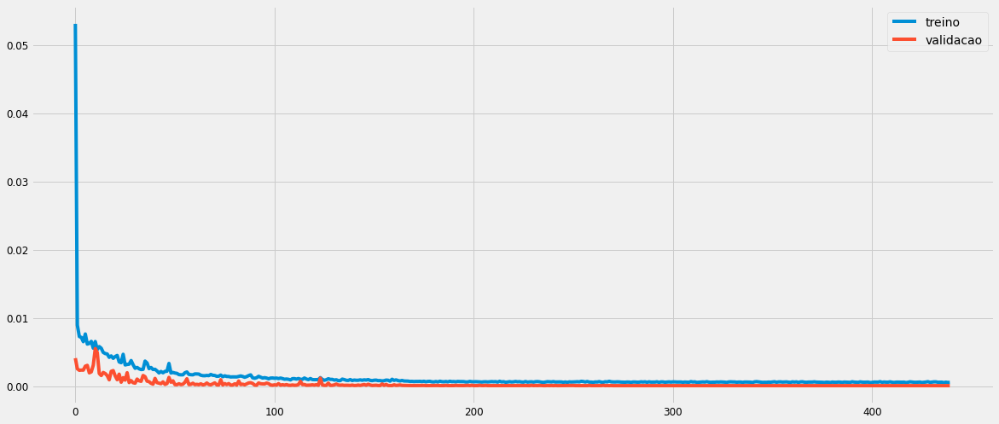

In [338]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [339]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [340]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.4726731 ],
       [0.41855088],
       [0.3694632 ],
       [0.34042627],
       [0.32525894]], dtype=float32)

In [341]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[17765.59 ],
       [16447.713],
       [15252.429],
       [14545.38 ],
       [14176.055]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

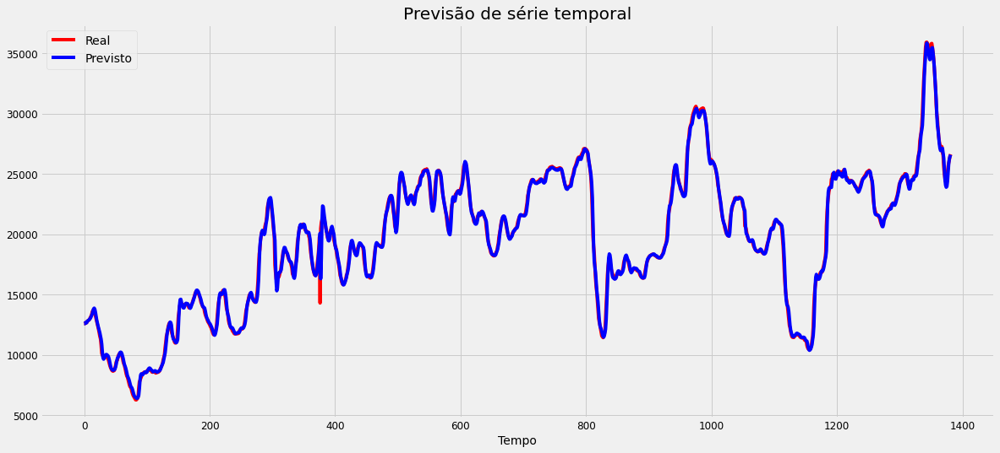

In [342]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

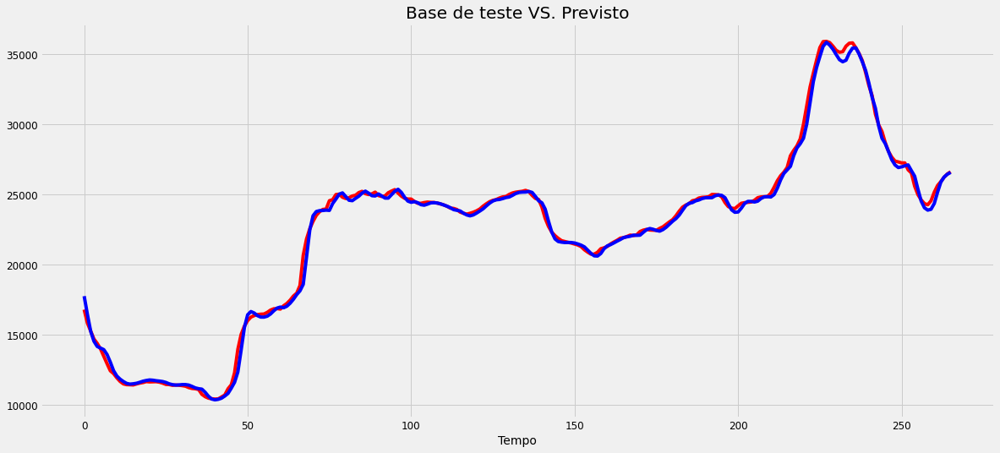

In [343]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [344]:
lstm_s1c_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_s1c_rmse)
lstm_s1c_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_s1c_mse)
lstm_s1c_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_s1c_mape, '%')
lstm_s1c_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  344.61468024675264
MSE:  118759.27784157157
MAPE:  1.0435234188953768 %
R2:  0.9969798185282492


## S2

### SARIMA

In [345]:
data = baltic.loc[baltic['Route'] == 'S2'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S2'}) 
data = data.groupby([pd.Grouper(key='Date', freq='M')]).S2.mean()
data.head()

Date
2013-01-31    6434.954545
2013-02-28    5292.700000
2013-03-31    8409.050000
2013-04-30    8196.857143
2013-05-31    7270.857143
Freq: M, Name: S2, dtype: float64

#### Divisão da base

In [346]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [347]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [348]:
y = data.copy()
y.tail()

Date
2020-12-31     9510.000000
2021-01-31    10210.950000
2021-02-28    12505.850000
2021-03-31    21658.086957
2021-04-30    22621.000000
Freq: M, Name: S2, dtype: float64

#### Exibição da série

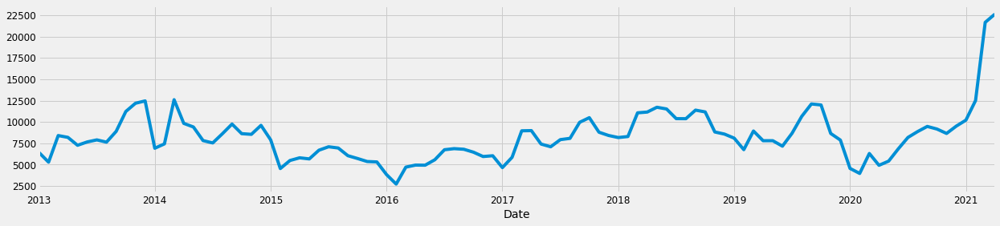

In [349]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

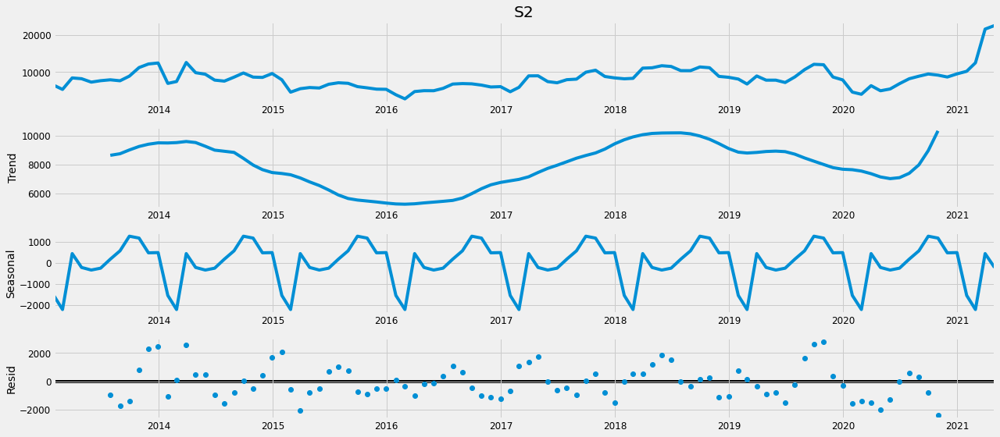

In [350]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [351]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [352]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2081.4065520093204
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1783.0767890338648
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1677.5257554753318
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1442.9532374644812
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1697.4565455267798
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1669.6114684644704
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1471.4917515774846
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1436.238348449722
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1990.4643708369247
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1735.6322252982156
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1590.1976498354368
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1338.3077114439734
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1615.5510093001117
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1557.3082219186085
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1408.1947328133742
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1340.1847816445654
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1744.2822252675182
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1516.2608994

C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 0, 0)x(0, 0, 1, 12)12 - AIC:1549.5350845788516
ARIMA(1, 0, 0)x(0, 1, 0, 12)12 - AIC:1548.5242269548985
ARIMA(1, 0, 0)x(0, 1, 1, 12)12 - AIC:1303.9325378219282
ARIMA(1, 0, 0)x(1, 0, 0, 12)12 - AIC:1527.7957644065964
ARIMA(1, 0, 0)x(1, 0, 1, 12)12 - AIC:1518.0372487852105
ARIMA(1, 0, 0)x(1, 1, 0, 12)12 - AIC:1321.7601409838348
ARIMA(1, 0, 0)x(1, 1, 1, 12)12 - AIC:1305.7785851532087
ARIMA(1, 0, 1)x(0, 0, 0, 12)12 - AIC:1746.394115610944


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:1547.44843825303
ARIMA(1, 0, 1)x(0, 1, 0, 12)12 - AIC:1523.7791966146683
ARIMA(1, 0, 1)x(0, 1, 1, 12)12 - AIC:1271.9185060440918
ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:1526.1605071474041
ARIMA(1, 0, 1)x(1, 0, 1, 12)12 - AIC:1484.679104206423
ARIMA(1, 0, 1)x(1, 1, 0, 12)12 - AIC:1309.4387904618088
ARIMA(1, 0, 1)x(1, 1, 1, 12)12 - AIC:1273.8637207186707
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:1745.1456523206696
ARIMA(1, 1, 0)x(0, 0, 1, 12)12 - AIC:1513.5428291559354
ARIMA(1, 1, 0)x(0, 1, 0, 12)12 - AIC:1524.4210255124074
ARIMA(1, 1, 0)x(0, 1, 1, 12)12 - AIC:1265.2935128691715
ARIMA(1, 1, 0)x(1, 0, 0, 12)12 - AIC:1506.2952807558088
ARIMA(1, 1, 0)x(1, 0, 1, 12)12 - AIC:1485.1838186809568
ARIMA(1, 1, 0)x(1, 1, 0, 12)12 - AIC:1284.7990839611532
ARIMA(1, 1, 0)x(1, 1, 1, 12)12 - AIC:1267.2396492017892
ARIMA(1, 1, 1)x(0, 0, 0, 12)12 - AIC:1720.8899632801313
ARIMA(1, 1, 1)x(0, 0, 1, 12)12 - AIC:1490.9219228723791
ARIMA(1, 1, 1)x(0, 1, 0, 12)12 - AIC:1502.202607604

#### Ajuste considerando o menor valor de AIC

In [353]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3472      0.249      1.397      0.162      -0.140       0.834
ma.L1          0.1058      0.330      0.321      0.748      -0.540       0.752
ar.S.L12      -0.0068      0.227     -0.030      0.976      -0.451       0.438
ma.S.L12      -1.1964      0.464     -2.577      0.010      -2.106      -0.286
sigma2      9.908e+05   7.12e+05      1.392      0.164   -4.04e+05    2.39e+06


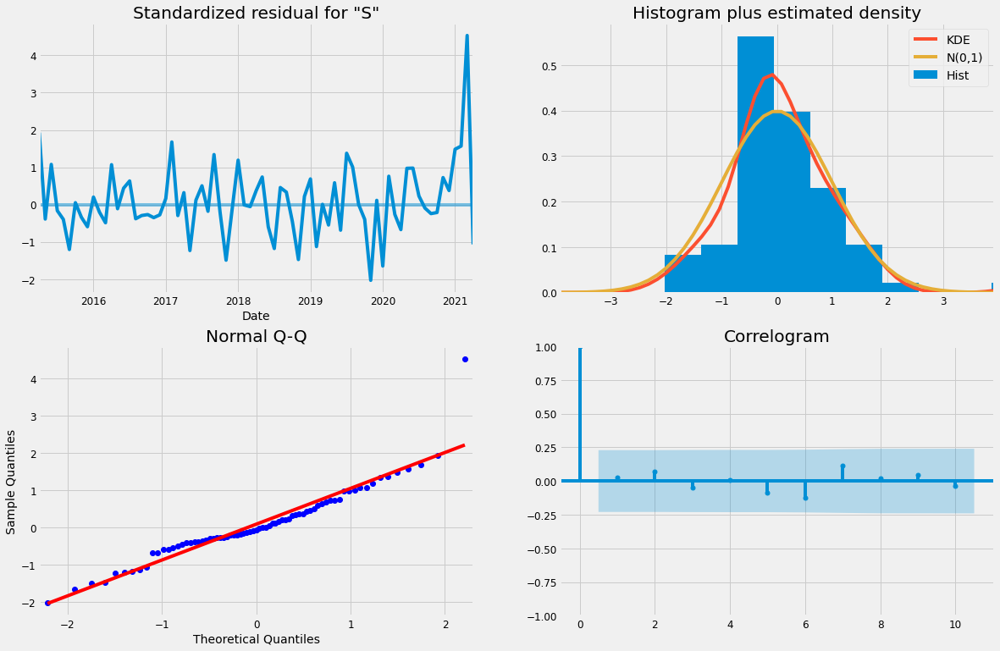

In [354]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

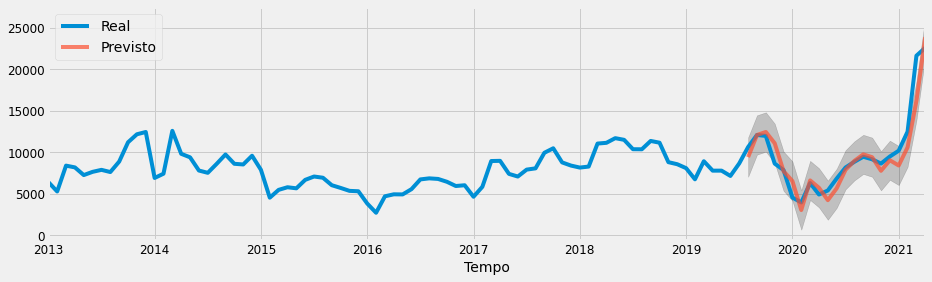

In [355]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [356]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_s2_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_s2_rmse)
sarima_s2_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_s2_mse)
sarima_s2_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_s2_mape, '%')
sarima_s2_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  1621.0258073997425
MSE:  2627724.668255987
MAPE:  12.428965024890612 %
R2:  0.8797077319082833


### LSTM

#### Divisão da base

training_set

In [357]:
temp = baltic.loc[baltic['Route'] == 'S2'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S2'}) 
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,S2
28308,2013-01-02,7044.0
28309,2013-01-03,7018.0
28310,2013-01-04,7004.0
28311,2013-01-07,6971.0
28312,2013-01-08,6944.0


In [358]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[7044.],
       [7018.],
       [7004.],
       [6971.],
       [6944.]])

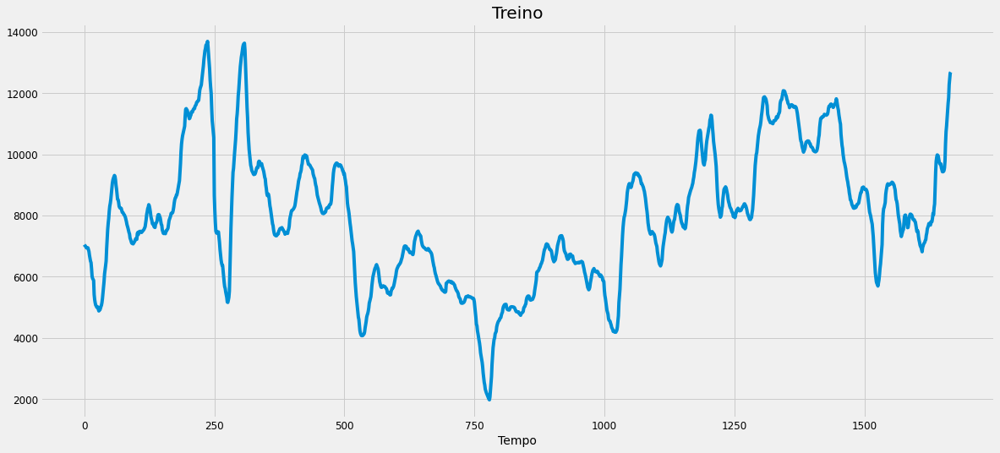

In [359]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [360]:
temp = baltic.loc[baltic['Route'] == 'S2'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S2'}) 
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,S2
29975,2019-09-02,12721.0
29976,2019-09-03,12779.0
29977,2019-09-04,12786.0
29978,2019-09-05,12657.0
29979,2019-09-06,12543.0


In [361]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[12721.],
       [12779.],
       [12786.],
       [12657.],
       [12543.]])

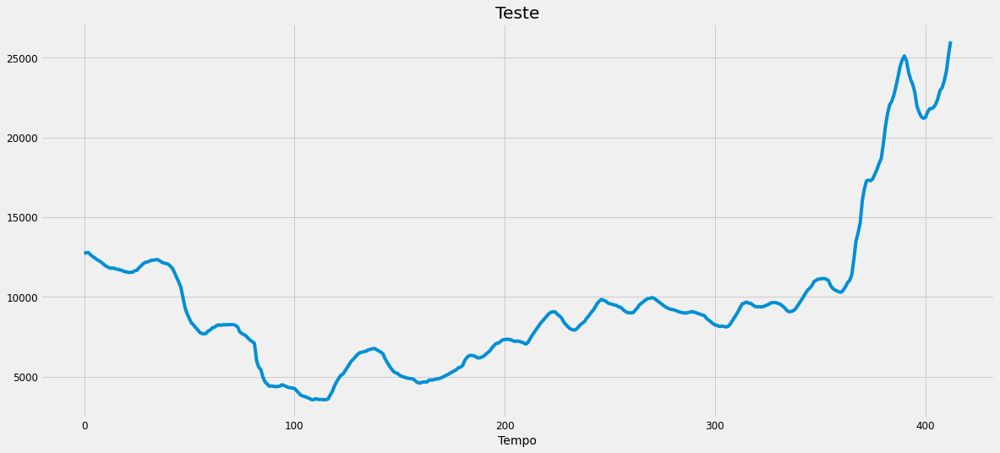

In [362]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [363]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [364]:
training_set_scaled[0:5]

array([[0.43277598],
       [0.43055793],
       [0.42936359],
       [0.42654837],
       [0.42424501]])

##### Criar a estrutura de dados

In [365]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [366]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.432776,0.430558,0.429364,0.426548,0.424245,0.423733,0.424245,0.424160,0.419212,0.413923
1,0.430558,0.429364,0.426548,0.424245,0.423733,0.424245,0.424160,0.419212,0.413923,0.403088
2,0.429364,0.426548,0.424245,0.423733,0.424245,0.424160,0.419212,0.413923,0.403088,0.394728
3,0.426548,0.424245,0.423733,0.424245,0.424160,0.419212,0.413923,0.403088,0.394728,0.386965
4,0.424245,0.423733,0.424245,0.424160,0.419212,0.413923,0.403088,0.394728,0.386965,0.382785


In [367]:
pd.DataFrame(y_train).head()

,0
0,0.403088
1,0.394728
2,0.386965
3,0.382785
4,0.365723


##### *Reshaping*

In [368]:
X_train.shape

(1657, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [369]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [370]:
X_train.shape

(1657, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [371]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_25 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_25 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_26 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_26 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_27 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_27 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_9 (Dense)              (None, 1)                

###### Treinamento

In [372]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1491 samples, validate on 166 samples
Epoch 1/1000
1491/1491 [==============================] - 2s 2ms/step - loss: 0.0353 - val_loss: 0.0049
Epoch 2/1000
1491/1491 [==============================] - 1s 714us/step - loss: 0.0062 - val_loss: 0.0045
Epoch 3/1000
1491/1491 [==============================] - 1s 740us/step - loss: 0.0061 - val_loss: 0.0044
Epoch 4/1000
1491/1491 [==============================] - 1s 724us/step - loss: 0.0054 - val_loss: 0.0040
Epoch 5/1000
1491/1491 [==============================] - 1s 729us/step - loss: 0.0053 - val_loss: 0.0040
Epoch 6/1000
1491/1491 [==============================] - 1s 722us/step - loss: 0.0050 - val_loss: 0.0045
Epoch 7/1000
1491/1491 [==============================] - 1s 743us/step - loss: 0.0049 - val_loss: 0.0036
Epoch 8/1000
1491/1491 [==============================] - 1s 731us/step - loss: 0.0047 - val_loss: 0.0039
Epoch 9/1000
1491/1491 [==============================] - 1s 722us/step - loss: 0.0046 - val_loss: 0.0030
E

Epoch 75/1000
1491/1491 [==============================] - 1s 732us/step - loss: 7.7442e-04 - val_loss: 4.7083e-04
Epoch 76/1000
1491/1491 [==============================] - 1s 732us/step - loss: 6.9024e-04 - val_loss: 3.2171e-04
Epoch 77/1000
1491/1491 [==============================] - 1s 734us/step - loss: 7.0628e-04 - val_loss: 3.8138e-04
Epoch 78/1000
1491/1491 [==============================] - 1s 716us/step - loss: 7.0777e-04 - val_loss: 3.2216e-04
Epoch 79/1000
1491/1491 [==============================] - 1s 725us/step - loss: 7.2735e-04 - val_loss: 3.1205e-04
Epoch 80/1000
1491/1491 [==============================] - 1s 743us/step - loss: 6.0190e-04 - val_loss: 3.3407e-04
Epoch 81/1000
1491/1491 [==============================] - 1s 721us/step - loss: 7.5188e-04 - val_loss: 3.4283e-04
Epoch 82/1000
1491/1491 [==============================] - 1s 797us/step - loss: 6.2291e-04 - val_loss: 4.4273e-04
Epoch 83/1000
1491/1491 [==============================] - 1s 778us/step - loss:

Epoch 146/1000
1491/1491 [==============================] - 1s 828us/step - loss: 3.7736e-04 - val_loss: 1.7528e-04
Epoch 147/1000
1491/1491 [==============================] - 1s 866us/step - loss: 5.1345e-04 - val_loss: 1.6295e-04
Epoch 148/1000
1491/1491 [==============================] - 1s 854us/step - loss: 4.2322e-04 - val_loss: 1.7468e-04
Epoch 149/1000
1491/1491 [==============================] - 1s 824us/step - loss: 4.4208e-04 - val_loss: 2.8856e-04
Epoch 150/1000
1491/1491 [==============================] - 1s 803us/step - loss: 4.7088e-04 - val_loss: 1.7415e-04
Epoch 151/1000
1491/1491 [==============================] - 1s 803us/step - loss: 4.1100e-04 - val_loss: 1.4263e-04
Epoch 152/1000
1491/1491 [==============================] - 1s 806us/step - loss: 4.6491e-04 - val_loss: 1.4354e-04
Epoch 153/1000
1491/1491 [==============================] - 1s 841us/step - loss: 4.1495e-04 - val_loss: 2.3618e-04
Epoch 154/1000
1491/1491 [==============================] - 1s 818us/ste

1491/1491 [==============================] - 1s 804us/step - loss: 3.8110e-04 - val_loss: 1.0663e-04
Epoch 217/1000
1491/1491 [==============================] - 1s 803us/step - loss: 4.3130e-04 - val_loss: 1.3046e-04
Epoch 218/1000
1491/1491 [==============================] - 1s 802us/step - loss: 3.9576e-04 - val_loss: 1.0679e-04
Epoch 219/1000
1491/1491 [==============================] - 1s 803us/step - loss: 3.5115e-04 - val_loss: 1.2480e-04
Epoch 220/1000
1491/1491 [==============================] - 1s 804us/step - loss: 3.5396e-04 - val_loss: 9.9314e-05
Epoch 221/1000
1491/1491 [==============================] - 1s 828us/step - loss: 3.6116e-04 - val_loss: 1.3050e-04
Epoch 222/1000
1491/1491 [==============================] - 1s 843us/step - loss: 3.4293e-04 - val_loss: 1.0216e-04
Epoch 223/1000
1491/1491 [==============================] - 1s 817us/step - loss: 3.5040e-04 - val_loss: 9.7546e-05
Epoch 224/1000
1491/1491 [==============================] - 1s 829us/step - loss: 3.306

Epoch 287/1000
1491/1491 [==============================] - 1s 838us/step - loss: 3.0658e-04 - val_loss: 8.8931e-05
Epoch 288/1000
1491/1491 [==============================] - 1s 822us/step - loss: 2.9168e-04 - val_loss: 9.4621e-05
Epoch 289/1000
1491/1491 [==============================] - 1s 834us/step - loss: 2.8787e-04 - val_loss: 9.1533e-05
Epoch 290/1000
1491/1491 [==============================] - 1s 845us/step - loss: 2.7567e-04 - val_loss: 8.8480e-05
Epoch 291/1000
1491/1491 [==============================] - 1s 851us/step - loss: 2.7560e-04 - val_loss: 9.5261e-05
Epoch 292/1000
1491/1491 [==============================] - 1s 813us/step - loss: 3.0189e-04 - val_loss: 1.0077e-04
Epoch 293/1000
1491/1491 [==============================] - 1s 830us/step - loss: 3.0537e-04 - val_loss: 9.0661e-05
Epoch 294/1000
1491/1491 [==============================] - 1s 825us/step - loss: 2.6644e-04 - val_loss: 8.8611e-05
Epoch 295/1000
1491/1491 [==============================] - 1s 806us/ste

1491/1491 [==============================] - 1s 805us/step - loss: 2.6382e-04 - val_loss: 8.4672e-05
Epoch 358/1000
1491/1491 [==============================] - 1s 801us/step - loss: 3.1001e-04 - val_loss: 8.4929e-05
Epoch 359/1000
1491/1491 [==============================] - 1s 806us/step - loss: 3.1317e-04 - val_loss: 8.7712e-05
Epoch 360/1000
1491/1491 [==============================] - 1s 804us/step - loss: 3.0768e-04 - val_loss: 9.2576e-05
Epoch 361/1000
1491/1491 [==============================] - 1s 804us/step - loss: 2.7665e-04 - val_loss: 8.2305e-05
Epoch 362/1000
1491/1491 [==============================] - 1s 803us/step - loss: 2.7632e-04 - val_loss: 8.2557e-05
Epoch 363/1000
1491/1491 [==============================] - 1s 807us/step - loss: 2.8341e-04 - val_loss: 8.2150e-05
Epoch 364/1000
1491/1491 [==============================] - 1s 811us/step - loss: 2.5670e-04 - val_loss: 8.2320e-05
Epoch 365/1000
1491/1491 [==============================] - 1s 827us/step - loss: 3.027

Epoch 428/1000
1491/1491 [==============================] - 1s 806us/step - loss: 2.9041e-04 - val_loss: 8.1537e-05
Epoch 429/1000
1491/1491 [==============================] - 1s 814us/step - loss: 2.6779e-04 - val_loss: 8.1787e-05
Epoch 430/1000
1491/1491 [==============================] - 1s 810us/step - loss: 2.8575e-04 - val_loss: 8.1592e-05
Epoch 431/1000
1491/1491 [==============================] - 1s 806us/step - loss: 2.7504e-04 - val_loss: 8.2106e-05
Epoch 432/1000
1491/1491 [==============================] - 1s 845us/step - loss: 2.8468e-04 - val_loss: 8.2099e-05
Epoch 433/1000
1491/1491 [==============================] - 1s 874us/step - loss: 2.8566e-04 - val_loss: 8.2294e-05
Epoch 434/1000
1491/1491 [==============================] - 1s 842us/step - loss: 2.7721e-04 - val_loss: 8.2836e-05
Epoch 435/1000
1491/1491 [==============================] - 1s 803us/step - loss: 2.8848e-04 - val_loss: 8.2237e-05
Epoch 436/1000
1491/1491 [==============================] - 1s 805us/ste

1491/1491 [==============================] - 1s 853us/step - loss: 2.4992e-04 - val_loss: 8.1338e-05
Epoch 499/1000
1491/1491 [==============================] - 1s 857us/step - loss: 2.5675e-04 - val_loss: 8.1381e-05
Epoch 500/1000
1491/1491 [==============================] - 1s 815us/step - loss: 2.8621e-04 - val_loss: 8.1314e-05
Epoch 501/1000
1491/1491 [==============================] - 1s 801us/step - loss: 2.9084e-04 - val_loss: 8.1397e-05
Epoch 502/1000
1491/1491 [==============================] - 1s 800us/step - loss: 2.8393e-04 - val_loss: 8.1277e-05
Epoch 503/1000
1491/1491 [==============================] - 1s 801us/step - loss: 2.8619e-04 - val_loss: 8.1170e-05
Epoch 504/1000
1491/1491 [==============================] - 1s 802us/step - loss: 2.5931e-04 - val_loss: 8.1231e-05
Epoch 505/1000
1491/1491 [==============================] - 1s 801us/step - loss: 2.8592e-04 - val_loss: 8.1156e-05
Epoch 506/1000
1491/1491 [==============================] - 1s 802us/step - loss: 2.794

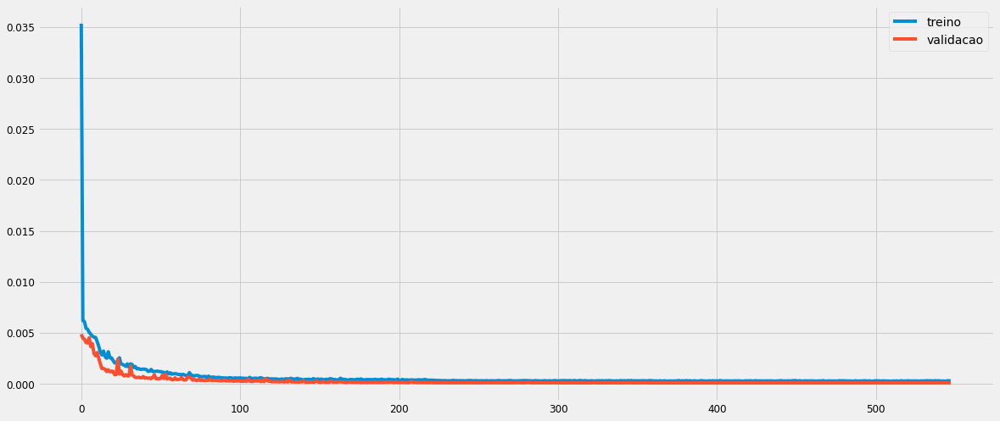

In [373]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [374]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [375]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.9167257 ],
       [0.9163859 ],
       [0.9201832 ],
       [0.91752285],
       [0.9004042 ]], dtype=float32)

In [376]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[12716.858],
       [12712.876],
       [12757.388],
       [12726.203],
       [12525.539]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

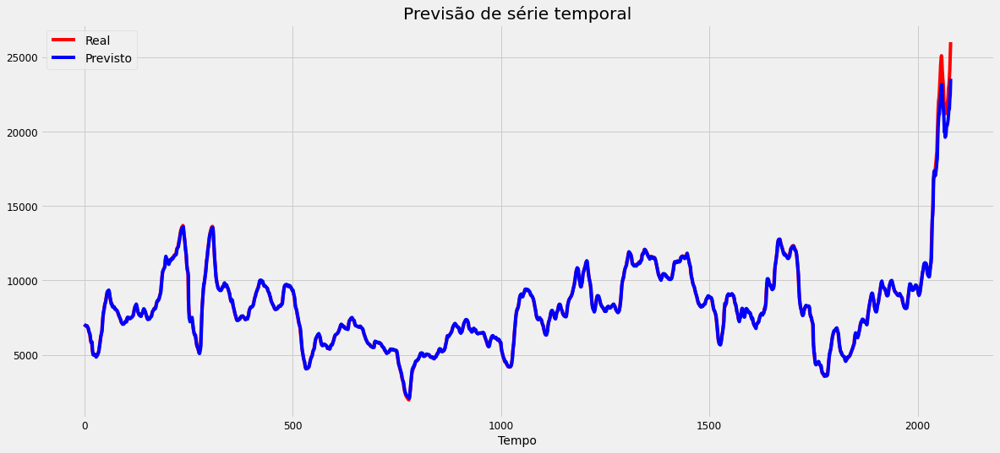

In [377]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

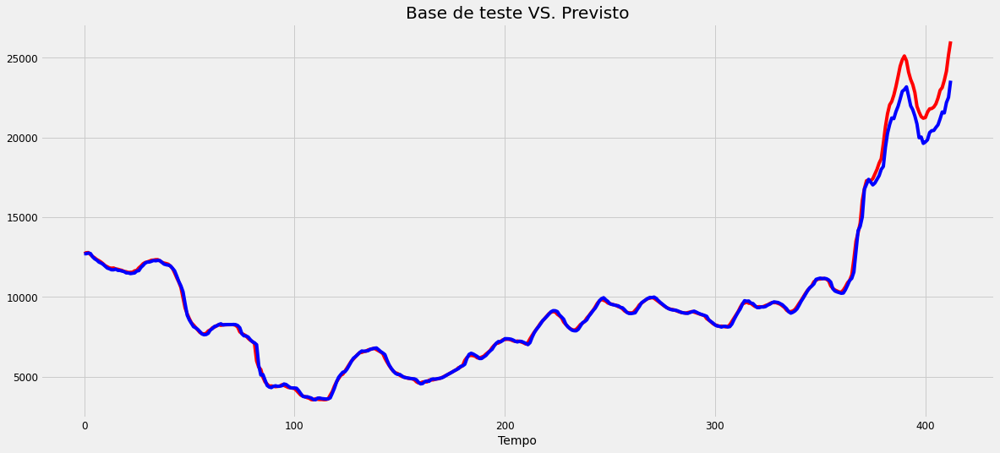

In [378]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [379]:
lstm_s2_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_s2_rmse)
lstm_s2_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_s2_mse)
lstm_s2_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_s2_mape, '%')
lstm_s2_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  490.5916754002844
MSE:  240680.19197205798
MAPE:  1.4034380564614382 %
R2:  0.9894514850065007


## S3

### SARIMA

In [380]:
data = baltic.loc[baltic['Route'] == 'S3'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S3'}) 
data = data.groupby([pd.Grouper(key='Date', freq='M')]).S3.mean()
data.head()

Date
2013-01-31    4605.454545
2013-02-28    3784.900000
2013-03-31    4913.800000
2013-04-30    4642.428571
2013-05-31    4269.904762
Freq: M, Name: S3, dtype: float64

#### Divisão da base

In [381]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [382]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [383]:
y = data.copy()
y.tail()

Date
2020-12-31     4146.388889
2021-01-31     4933.500000
2021-02-28     7271.850000
2021-03-31    14493.043478
2021-04-30    16832.000000
Freq: M, Name: S3, dtype: float64

#### Exibição da série

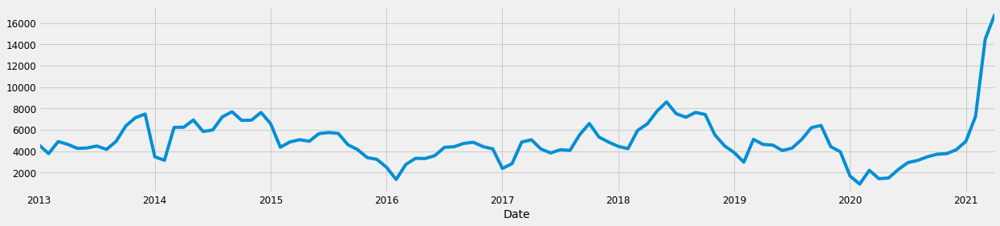

In [384]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

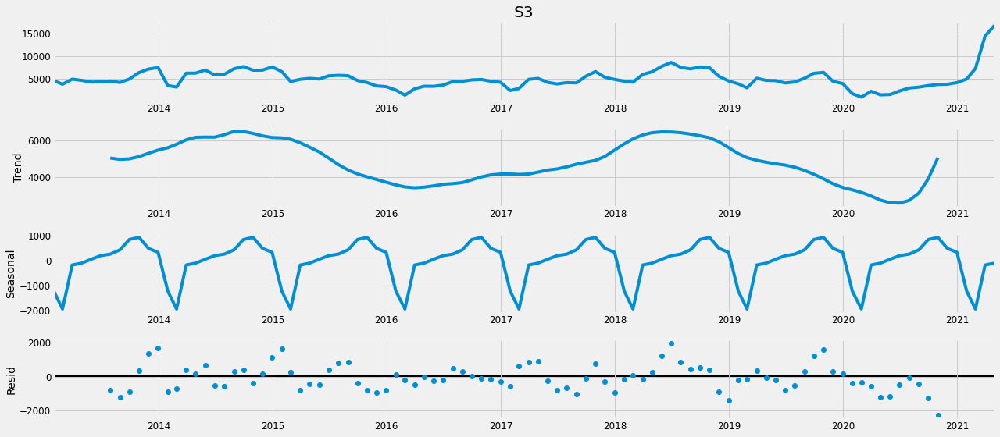

In [385]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [386]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [387]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1987.4480800723854
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1703.444598927836
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1642.941167694184
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1397.5690576009317
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1660.300399115722
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1639.5512252730923
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1435.8151796505183
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1405.5212185374135
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1847.7110731445002
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1653.9792015769312
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1536.4668185984624
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1302.7951805230587
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1572.660925636812
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1527.264517699415
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1356.3668456718904
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1302.5053853777752
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1682.0841420886154
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1470.04306431573

#### Ajuste considerando o menor valor de AIC

In [388]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4792      0.225      2.134      0.033       0.039       0.919
ma.L1          0.0945      0.348      0.272      0.786      -0.587       0.776
ar.S.L12      -0.1013      0.219     -0.462      0.644      -0.531       0.328
ma.S.L12      -0.7362      0.193     -3.808      0.000      -1.115      -0.357
sigma2      8.547e+05   1.51e+05      5.644      0.000    5.58e+05    1.15e+06


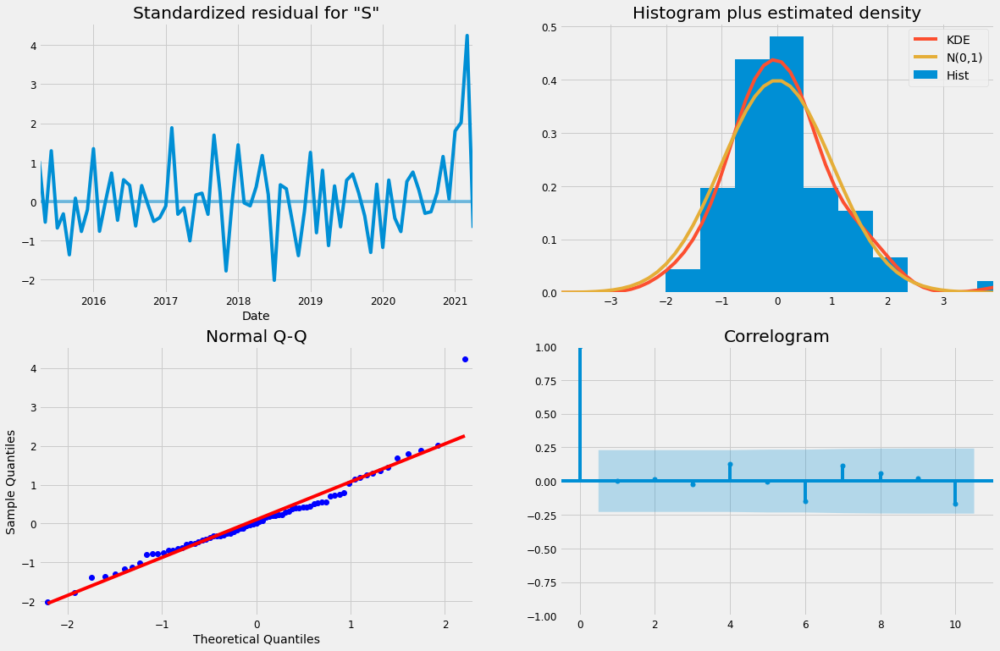

In [389]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

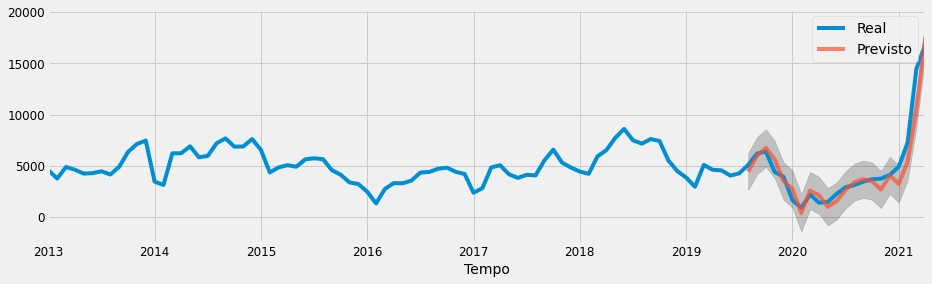

In [390]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [391]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_s3_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_s3_rmse)
sarima_s3_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_s3_mse)
sarima_s3_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_s3_mape, '%')
sarima_s3_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  1165.0940052717767
MSE:  1357444.0411202307
MAPE:  21.771855103740783 %
R2:  0.9111026385149356


### LSTM

#### Divisão da base

training_set

In [392]:
temp = baltic.loc[baltic['Route'] == 'S3'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S3'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,S3
30388,2013-01-02,4914.0
30389,2013-01-03,4931.0
30390,2013-01-04,4930.0
30391,2013-01-07,4903.0
30392,2013-01-08,4890.0


In [393]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[4914.],
       [4931.],
       [4930.],
       [4903.],
       [4890.]])

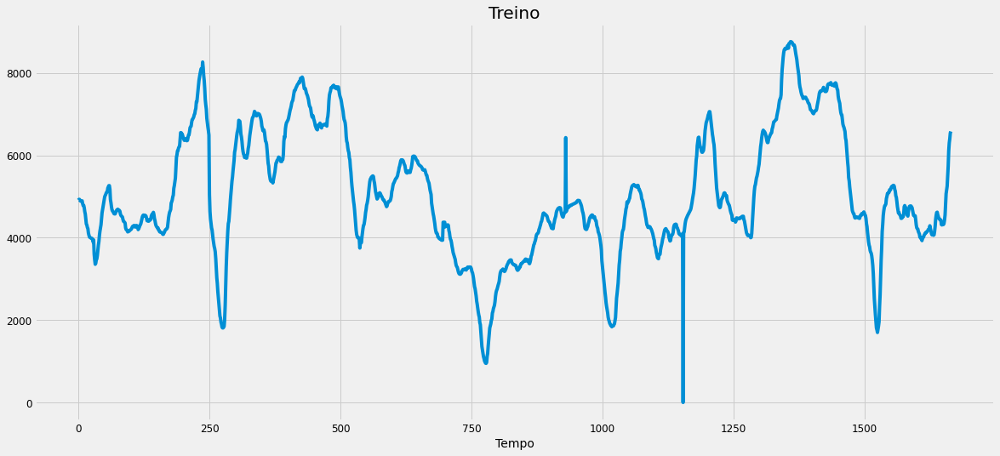

In [394]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [395]:
temp = baltic.loc[baltic['Route'] == 'S3'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S3'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,S3
32054,2019-09-02,6600.0
32055,2019-09-03,6540.0
32056,2019-09-04,6520.0
32057,2019-09-05,6510.0
32058,2019-09-06,6440.0


In [396]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[6600.],
       [6540.],
       [6520.],
       [6510.],
       [6440.]])

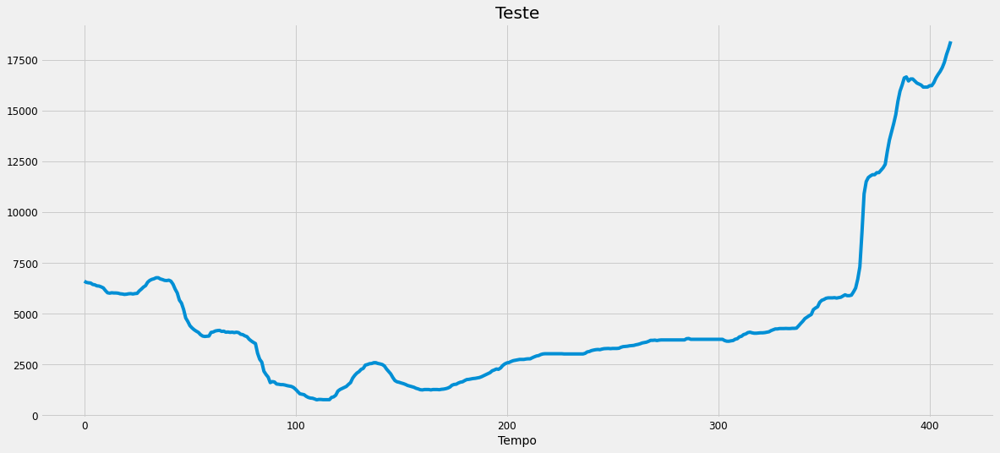

In [397]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [398]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [399]:
training_set_scaled[0:5]

array([[0.5609589 ],
       [0.56289954],
       [0.56278539],
       [0.5597032 ],
       [0.55821918]])

##### Criar a estrutura de dados

In [400]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [401]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.560959,0.562900,0.562785,0.559703,0.558219,0.557648,0.558562,0.558790,0.550799,0.545662
1,0.562900,0.562785,0.559703,0.558219,0.557648,0.558562,0.558790,0.550799,0.545662,0.546233
2,0.562785,0.559703,0.558219,0.557648,0.558562,0.558790,0.550799,0.545662,0.546233,0.539726
3,0.559703,0.558219,0.557648,0.558562,0.558790,0.550799,0.545662,0.546233,0.539726,0.529110
4,0.558219,0.557648,0.558562,0.558790,0.550799,0.545662,0.546233,0.539726,0.529110,0.522260


In [402]:
pd.DataFrame(y_train).head()

,0
0,0.546233
1,0.539726
2,0.529110
3,0.522260
4,0.507420


##### *Reshaping*

In [403]:
X_train.shape

(1656, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [404]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [405]:
X_train.shape

(1656, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [406]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_28 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_28 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_29 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_29 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_30 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_30 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_10 (Dense)             (None, 1)               

###### Treinamento

In [408]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1490 samples, validate on 166 samples
Epoch 1/1000
1490/1490 [==============================] - 1s 797us/step - loss: 0.0037 - val_loss: 0.0027
Epoch 2/1000
1490/1490 [==============================] - 1s 777us/step - loss: 0.0042 - val_loss: 0.0025
Epoch 3/1000
1490/1490 [==============================] - 1s 765us/step - loss: 0.0037 - val_loss: 0.0025
Epoch 4/1000
1490/1490 [==============================] - 1s 746us/step - loss: 0.0032 - val_loss: 0.0022
Epoch 5/1000
1490/1490 [==============================] - 1s 740us/step - loss: 0.0032 - val_loss: 0.0018
Epoch 6/1000
1490/1490 [==============================] - 1s 729us/step - loss: 0.0030 - val_loss: 0.0018
Epoch 7/1000
1490/1490 [==============================] - 1s 726us/step - loss: 0.0029 - val_loss: 0.0015
Epoch 8/1000
1490/1490 [==============================] - 1s 710us/step - loss: 0.0029 - val_loss: 0.0014
Epoch 9/1000
1490/1490 [==============================] - 1s 704us/step - loss: 0.0028 - val_loss: 0.0020

Epoch 75/1000
1490/1490 [==============================] - 1s 678us/step - loss: 9.0275e-04 - val_loss: 5.6573e-04
Epoch 76/1000
1490/1490 [==============================] - 1s 675us/step - loss: 9.6185e-04 - val_loss: 3.3241e-04
Epoch 77/1000
1490/1490 [==============================] - 1s 688us/step - loss: 9.1446e-04 - val_loss: 3.3991e-04
Epoch 78/1000
1490/1490 [==============================] - 1s 676us/step - loss: 8.8253e-04 - val_loss: 3.5735e-04
Epoch 79/1000
1490/1490 [==============================] - 1s 668us/step - loss: 8.9246e-04 - val_loss: 3.3770e-04
Epoch 80/1000
1490/1490 [==============================] - 1s 680us/step - loss: 0.0010 - val_loss: 3.6753e-04
Epoch 81/1000
1490/1490 [==============================] - 1s 674us/step - loss: 8.6164e-04 - val_loss: 4.0374e-04
Epoch 82/1000
1490/1490 [==============================] - 1s 671us/step - loss: 9.1908e-04 - val_loss: 3.1559e-04
Epoch 83/1000
1490/1490 [==============================] - 1s 673us/step - loss: 8.7

Epoch 146/1000
1490/1490 [==============================] - 1s 678us/step - loss: 6.1551e-04 - val_loss: 2.1212e-04
Epoch 147/1000
1490/1490 [==============================] - 1s 673us/step - loss: 7.0250e-04 - val_loss: 2.0780e-04
Epoch 148/1000
1490/1490 [==============================] - 1s 682us/step - loss: 6.6333e-04 - val_loss: 1.9140e-04
Epoch 149/1000
1490/1490 [==============================] - 1s 710us/step - loss: 6.5268e-04 - val_loss: 2.8030e-04
Epoch 150/1000
1490/1490 [==============================] - 1s 691us/step - loss: 6.4044e-04 - val_loss: 2.7169e-04
Epoch 151/1000
1490/1490 [==============================] - 1s 721us/step - loss: 6.1462e-04 - val_loss: 2.2968e-04
Epoch 152/1000
1490/1490 [==============================] - 1s 677us/step - loss: 6.5854e-04 - val_loss: 2.1725e-04
Epoch 153/1000
1490/1490 [==============================] - 1s 673us/step - loss: 7.0277e-04 - val_loss: 1.8147e-04
Epoch 154/1000
1490/1490 [==============================] - 1s 676us/ste

1490/1490 [==============================] - 1s 673us/step - loss: 6.3072e-04 - val_loss: 1.7321e-04
Epoch 217/1000
1490/1490 [==============================] - 1s 680us/step - loss: 6.5601e-04 - val_loss: 1.7965e-04
Epoch 218/1000
1490/1490 [==============================] - 1s 674us/step - loss: 6.6492e-04 - val_loss: 2.2977e-04
Epoch 219/1000
1490/1490 [==============================] - 1s 674us/step - loss: 5.9435e-04 - val_loss: 1.8835e-04
Epoch 220/1000
1490/1490 [==============================] - 1s 674us/step - loss: 6.0125e-04 - val_loss: 1.8652e-04
Epoch 221/1000
1490/1490 [==============================] - 1s 673us/step - loss: 6.0284e-04 - val_loss: 1.6830e-04
Epoch 222/1000
1490/1490 [==============================] - 1s 672us/step - loss: 6.4281e-04 - val_loss: 2.4857e-04
Epoch 223/1000
1490/1490 [==============================] - 1s 697us/step - loss: 6.4898e-04 - val_loss: 2.5774e-04
Epoch 224/1000
1490/1490 [==============================] - 1s 676us/step - loss: 6.263

Epoch 287/1000
1490/1490 [==============================] - 1s 677us/step - loss: 5.4320e-04 - val_loss: 1.7710e-04
Epoch 288/1000
1490/1490 [==============================] - 1s 674us/step - loss: 5.5392e-04 - val_loss: 1.8613e-04
Epoch 289/1000
1490/1490 [==============================] - 1s 671us/step - loss: 5.2644e-04 - val_loss: 1.7952e-04
Epoch 290/1000
1490/1490 [==============================] - 1s 702us/step - loss: 5.5127e-04 - val_loss: 2.2129e-04
Epoch 291/1000
1490/1490 [==============================] - 1s 700us/step - loss: 5.4428e-04 - val_loss: 1.9680e-04
Epoch 292/1000
1490/1490 [==============================] - 1s 725us/step - loss: 5.4054e-04 - val_loss: 1.9962e-04
Epoch 293/1000
1490/1490 [==============================] - 1s 673us/step - loss: 5.3127e-04 - val_loss: 1.7745e-04
Epoch 294/1000
1490/1490 [==============================] - 1s 671us/step - loss: 5.4399e-04 - val_loss: 1.8691e-04
Epoch 295/1000
1490/1490 [==============================] - 1s 674us/ste

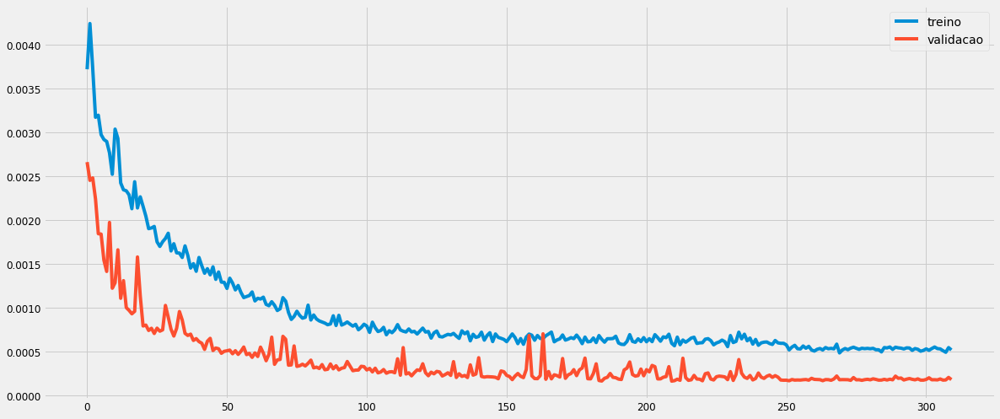

In [409]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [410]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [411]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.7681209 ],
       [0.76677644],
       [0.7575961 ],
       [0.7496129 ],
       [0.744671  ]], dtype=float32)

In [412]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[6728.739 ],
       [6716.9614],
       [6636.5415],
       [6566.6094],
       [6523.318 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

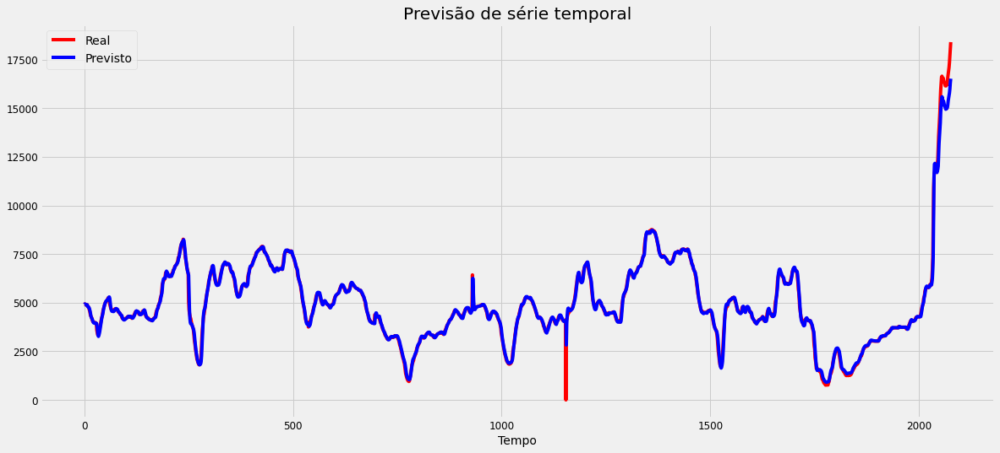

In [413]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

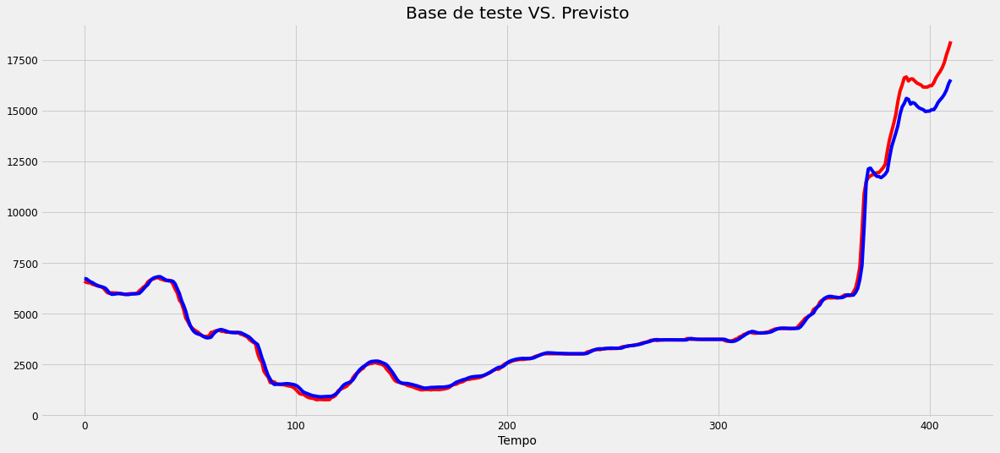

In [414]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

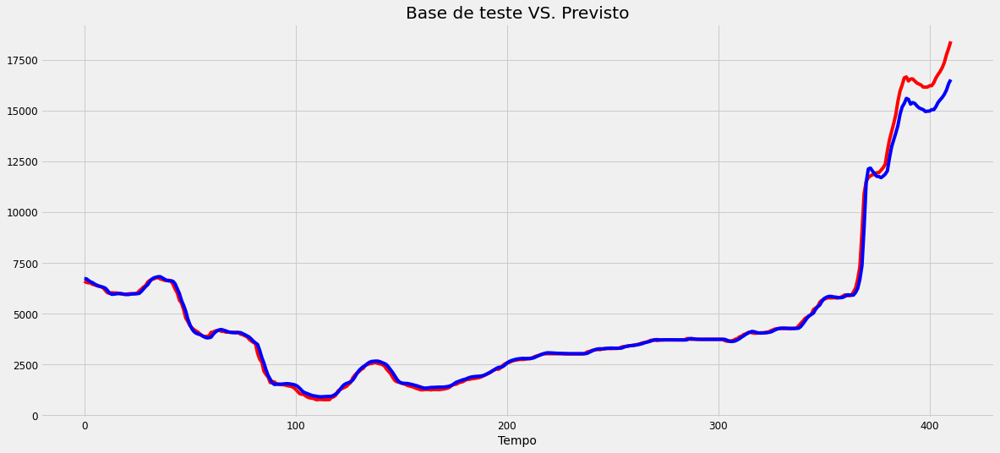

In [415]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [416]:
lstm_s3_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_s3_rmse)
lstm_s3_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_s3_mse)
lstm_s3_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_s3_mape, '%')
lstm_s3_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  376.6779634057504
MSE:  141886.28811550382
MAPE:  3.4478151837730073 %
R2:  0.9906638477138497


## S4A

### SARIMA

In [417]:
data = baltic.loc[baltic['Route'] == 'S4A'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S4A'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).S4A.mean()
data.head()

Date
2013-01-31    14684.090909
2013-02-28    15740.800000
2013-03-31    20163.250000
2013-04-30    18417.333333
2013-05-31    18173.666667
Freq: M, Name: S4A, dtype: float64

#### Divisão da base

In [418]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [419]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [420]:
y = data.copy()
y.tail()

Date
2020-12-31    18440.555556
2021-01-31    21057.750000
2021-02-28    26556.000000
2021-03-31    27185.478261
2021-04-30    16528.533333
Freq: M, Name: S4A, dtype: float64

#### Exibição da série

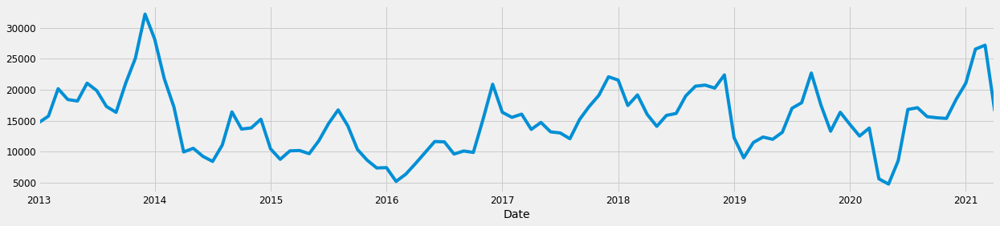

In [421]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

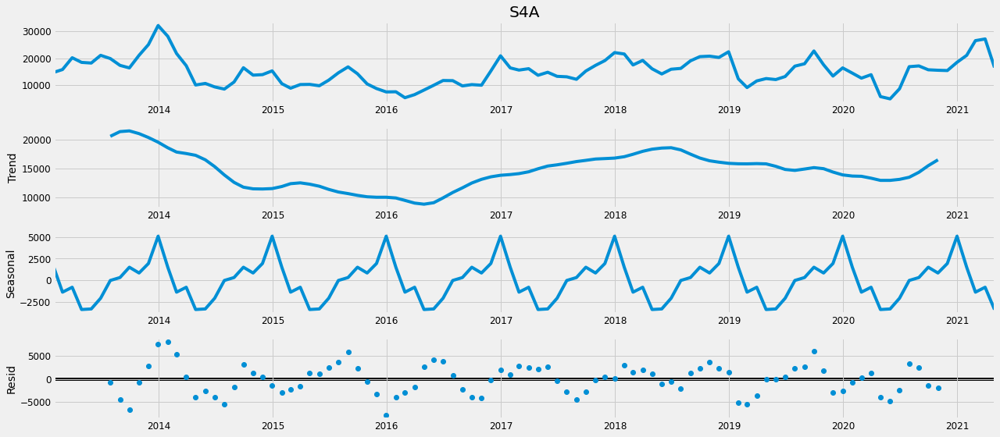

In [422]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [423]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [424]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2199.4498380737296
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1882.2058046005343
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1777.127499142347
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1498.2542543887025
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1795.642065828263
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1741.6276883098556
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1541.0877500754145
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1499.9556650895195
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:2104.2875168387213
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1834.481094778625
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1699.229324832446
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1420.1883898253716
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1870.378326795746
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1651.2166563960081
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1480.3152001080591
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1445.6139787706138
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1871.4938569392732
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1635.37005460811

#### Ajuste considerando o menor valor de AIC

In [425]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0701      0.363     -0.193      0.847      -0.782       0.642
ma.L1          0.4257      0.325      1.311      0.190      -0.211       1.062
ar.S.L12      -0.1465      0.134     -1.089      0.276      -0.410       0.117
ma.S.L12      -0.6482      0.092     -7.045      0.000      -0.829      -0.468
sigma2      8.769e+06   1.47e+06      5.946      0.000    5.88e+06    1.17e+07


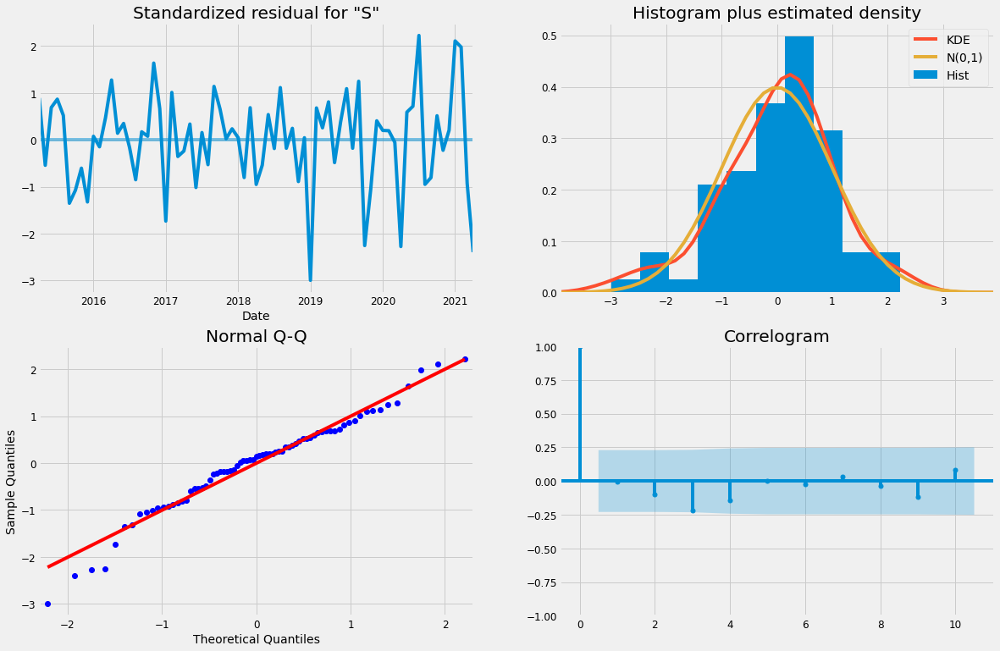

In [426]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

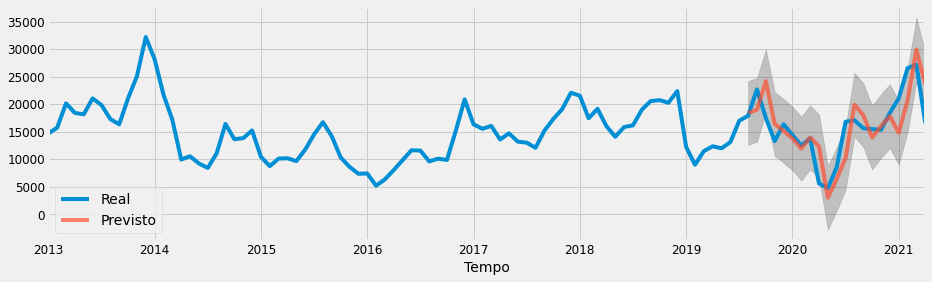

In [427]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [428]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_s4a_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_s4a_rmse)
sarima_s4a_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_s4a_mse)
sarima_s4a_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_s4a_mape, '%')
sarima_s4a_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  3871.2120635482393
MSE:  14986282.840961417
MAPE:  22.510378111410937 %
R2:  0.5067967664465476


### LSTM

#### Divisão da base

training_set

In [429]:
temp = baltic.loc[baltic['Route'] == 'S4A'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S4A'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,S4A
32465,2013-01-02,13889.0
32466,2013-01-03,14070.0
32467,2013-01-04,14151.0
32468,2013-01-07,14260.0
32469,2013-01-08,14370.0


In [430]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[13889.],
       [14070.],
       [14151.],
       [14260.],
       [14370.]])

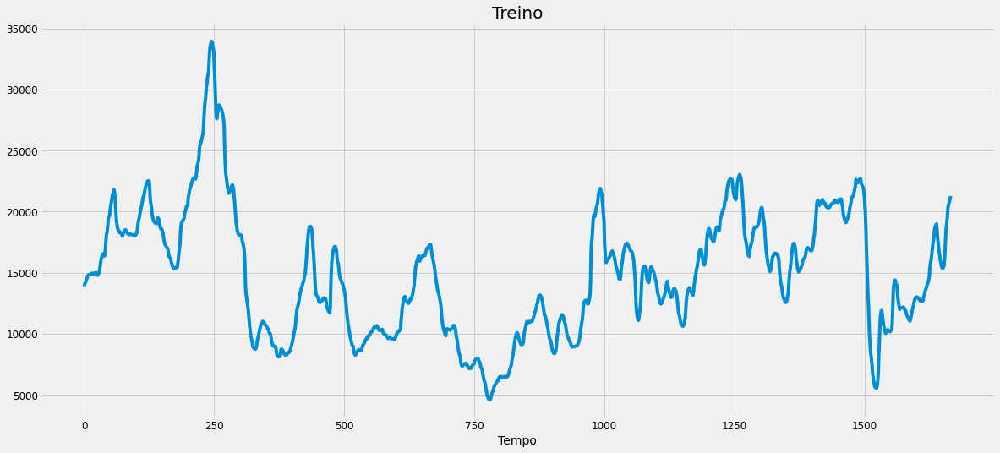

In [431]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [432]:
temp = baltic.loc[baltic['Route'] == 'S4A'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S4A'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,S4A
34131,2019-09-02,21639.0
34132,2019-09-03,21984.0
34133,2019-09-04,22203.0
34134,2019-09-05,22469.0
34135,2019-09-06,22619.0


In [433]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[21639.],
       [21984.],
       [22203.],
       [22469.],
       [22619.]])

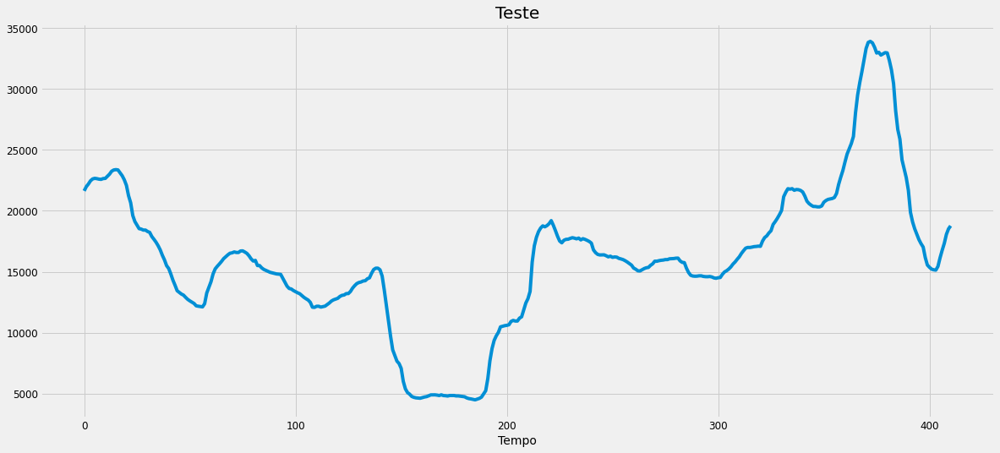

In [434]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [435]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [436]:
training_set_scaled[0:5]

array([[0.31678141],
       [0.32295004],
       [0.32571059],
       [0.3294254 ],
       [0.33317429]])

##### Criar a estrutura de dados

In [437]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [438]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.316781,0.322950,0.325711,0.329425,0.333174,0.337946,0.342206,0.346125,0.348511,0.348511
1,0.322950,0.325711,0.329425,0.333174,0.337946,0.342206,0.346125,0.348511,0.348511,0.348851
2,0.325711,0.329425,0.333174,0.337946,0.342206,0.346125,0.348511,0.348511,0.348851,0.350215
3,0.329425,0.333174,0.337946,0.342206,0.346125,0.348511,0.348511,0.348851,0.350215,0.350044
4,0.333174,0.337946,0.342206,0.346125,0.348511,0.348511,0.348851,0.350215,0.350044,0.350385


In [439]:
pd.DataFrame(y_train).head()

,0
0,0.348851
1,0.350215
2,0.350044
3,0.350385
4,0.351237


##### *Reshaping*

In [440]:
X_train.shape

(1656, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [441]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [442]:
X_train.shape

(1656, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [443]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_31 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_31 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_32 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_32 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_33 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_33 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_11 (Dense)             (None, 1)               

###### Treinamento

In [444]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1490 samples, validate on 166 samples
Epoch 1/1000
1490/1490 [==============================] - 2s 1ms/step - loss: 0.0219 - val_loss: 0.0075
Epoch 2/1000
1490/1490 [==============================] - 1s 665us/step - loss: 0.0043 - val_loss: 0.0070
Epoch 3/1000
1490/1490 [==============================] - 1s 670us/step - loss: 0.0040 - val_loss: 0.0066
Epoch 4/1000
1490/1490 [==============================] - 1s 669us/step - loss: 0.0039 - val_loss: 0.0067
Epoch 5/1000
1490/1490 [==============================] - 1s 669us/step - loss: 0.0034 - val_loss: 0.0066
Epoch 6/1000
1490/1490 [==============================] - 1s 671us/step - loss: 0.0036 - val_loss: 0.0058
Epoch 7/1000
1490/1490 [==============================] - 1s 672us/step - loss: 0.0031 - val_loss: 0.0055
Epoch 8/1000
1490/1490 [==============================] - 1s 670us/step - loss: 0.0028 - val_loss: 0.0051
Epoch 9/1000
1490/1490 [==============================] - 1s 667us/step - loss: 0.0027 - val_loss: 0.0043
E

1490/1490 [==============================] - 1s 709us/step - loss: 5.1622e-04 - val_loss: 3.4446e-04
Epoch 75/1000
1490/1490 [==============================] - 1s 690us/step - loss: 5.5332e-04 - val_loss: 5.0572e-04
Epoch 76/1000
1490/1490 [==============================] - 1s 727us/step - loss: 5.1817e-04 - val_loss: 3.4114e-04
Epoch 77/1000
1490/1490 [==============================] - 1s 669us/step - loss: 4.7364e-04 - val_loss: 3.4553e-04
Epoch 78/1000
1490/1490 [==============================] - 1s 668us/step - loss: 4.7015e-04 - val_loss: 3.1398e-04
Epoch 79/1000
1490/1490 [==============================] - 1s 670us/step - loss: 4.4531e-04 - val_loss: 2.7341e-04
Epoch 80/1000
1490/1490 [==============================] - 1s 667us/step - loss: 4.3645e-04 - val_loss: 2.8006e-04
Epoch 81/1000
1490/1490 [==============================] - 1s 670us/step - loss: 5.0072e-04 - val_loss: 2.9841e-04
Epoch 82/1000
1490/1490 [==============================] - 1s 667us/step - loss: 4.6696e-04 - 

Epoch 145/1000
1490/1490 [==============================] - 1s 668us/step - loss: 4.0989e-04 - val_loss: 1.6845e-04
Epoch 146/1000
1490/1490 [==============================] - 1s 669us/step - loss: 3.4467e-04 - val_loss: 2.2050e-04
Epoch 147/1000
1490/1490 [==============================] - 1s 668us/step - loss: 3.8298e-04 - val_loss: 1.1804e-04
Epoch 148/1000
1490/1490 [==============================] - 1s 674us/step - loss: 3.6714e-04 - val_loss: 1.5292e-04
Epoch 149/1000
1490/1490 [==============================] - 1s 669us/step - loss: 3.9515e-04 - val_loss: 2.2300e-04
Epoch 150/1000
1490/1490 [==============================] - 1s 673us/step - loss: 4.1672e-04 - val_loss: 1.3771e-04
Epoch 151/1000
1490/1490 [==============================] - 1s 669us/step - loss: 3.7645e-04 - val_loss: 1.5334e-04
Epoch 152/1000
1490/1490 [==============================] - 1s 689us/step - loss: 3.5923e-04 - val_loss: 1.3931e-04
Epoch 153/1000
1490/1490 [==============================] - 1s 716us/ste

1490/1490 [==============================] - 1s 711us/step - loss: 2.6544e-04 - val_loss: 8.7924e-05
Epoch 216/1000
1490/1490 [==============================] - 1s 743us/step - loss: 2.5779e-04 - val_loss: 9.7591e-05
Epoch 217/1000
1490/1490 [==============================] - 1s 692us/step - loss: 2.5496e-04 - val_loss: 8.4048e-05
Epoch 218/1000
1490/1490 [==============================] - 1s 708us/step - loss: 2.6127e-04 - val_loss: 8.5325e-05
Epoch 219/1000
1490/1490 [==============================] - 1s 694us/step - loss: 2.6464e-04 - val_loss: 8.7558e-05
Epoch 220/1000
1490/1490 [==============================] - 1s 690us/step - loss: 2.6147e-04 - val_loss: 8.7190e-05
Epoch 221/1000
1490/1490 [==============================] - 1s 687us/step - loss: 2.6779e-04 - val_loss: 9.1319e-05
Epoch 222/1000
1490/1490 [==============================] - 1s 698us/step - loss: 2.4495e-04 - val_loss: 8.7074e-05
Epoch 223/1000
1490/1490 [==============================] - 1s 686us/step - loss: 2.416

Epoch 286/1000
1490/1490 [==============================] - 1s 788us/step - loss: 2.1985e-04 - val_loss: 7.7123e-05
Epoch 287/1000
1490/1490 [==============================] - 1s 702us/step - loss: 2.2716e-04 - val_loss: 7.7796e-05
Epoch 288/1000
1490/1490 [==============================] - 1s 692us/step - loss: 2.6123e-04 - val_loss: 8.4717e-05
Epoch 289/1000
1490/1490 [==============================] - 1s 706us/step - loss: 2.3413e-04 - val_loss: 8.7344e-05
Epoch 290/1000
1490/1490 [==============================] - 1s 734us/step - loss: 2.7101e-04 - val_loss: 8.7326e-05
Epoch 291/1000
1490/1490 [==============================] - 1s 712us/step - loss: 2.5344e-04 - val_loss: 7.3869e-05
Epoch 292/1000
1490/1490 [==============================] - 1s 738us/step - loss: 2.3903e-04 - val_loss: 7.2797e-05
Epoch 293/1000
1490/1490 [==============================] - 1s 692us/step - loss: 2.4747e-04 - val_loss: 7.4954e-05
Epoch 294/1000
1490/1490 [==============================] - 1s 691us/ste

1490/1490 [==============================] - 1s 676us/step - loss: 2.3150e-04 - val_loss: 7.2928e-05
Epoch 357/1000
1490/1490 [==============================] - 1s 669us/step - loss: 2.7284e-04 - val_loss: 7.1414e-05
Epoch 358/1000
1490/1490 [==============================] - 1s 671us/step - loss: 2.7114e-04 - val_loss: 7.3533e-05
Epoch 359/1000
1490/1490 [==============================] - 1s 666us/step - loss: 2.7179e-04 - val_loss: 7.1796e-05
Epoch 360/1000
1490/1490 [==============================] - 1s 667us/step - loss: 2.3463e-04 - val_loss: 7.1986e-05
Epoch 361/1000
1490/1490 [==============================] - 1s 672us/step - loss: 2.1693e-04 - val_loss: 7.1083e-05
Epoch 362/1000
1490/1490 [==============================] - 1s 671us/step - loss: 2.3447e-04 - val_loss: 7.0991e-05
Epoch 363/1000
1490/1490 [==============================] - 1s 671us/step - loss: 2.6847e-04 - val_loss: 7.2876e-05
Epoch 364/1000
1490/1490 [==============================] - 1s 669us/step - loss: 2.335

Epoch 427/1000
1490/1490 [==============================] - 1s 669us/step - loss: 2.3153e-04 - val_loss: 7.2125e-05
Epoch 428/1000
1490/1490 [==============================] - 1s 672us/step - loss: 2.4710e-04 - val_loss: 7.2026e-05
Epoch 429/1000
1490/1490 [==============================] - 1s 668us/step - loss: 2.3380e-04 - val_loss: 7.1840e-05
Epoch 430/1000
1490/1490 [==============================] - 1s 668us/step - loss: 2.2617e-04 - val_loss: 7.1714e-05
Epoch 431/1000
1490/1490 [==============================] - 1s 704us/step - loss: 2.3628e-04 - val_loss: 7.1343e-05
Epoch 432/1000
1490/1490 [==============================] - 1s 699us/step - loss: 2.6662e-04 - val_loss: 7.1449e-05
Epoch 433/1000
1490/1490 [==============================] - 1s 722us/step - loss: 2.6651e-04 - val_loss: 7.1441e-05
Epoch 434/1000
1490/1490 [==============================] - 1s 671us/step - loss: 2.3493e-04 - val_loss: 7.1264e-05
Epoch 435/1000
1490/1490 [==============================] - 1s 667us/ste

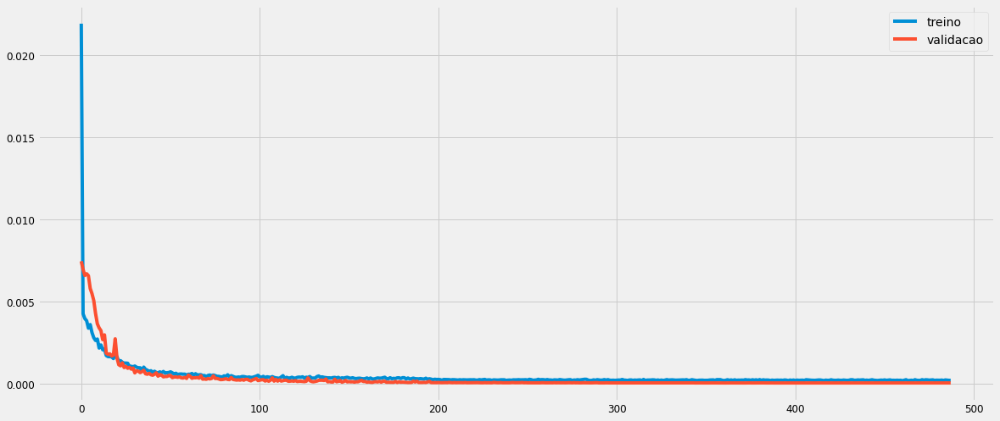

In [445]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [446]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [447]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.57117057],
       [0.5868815 ],
       [0.59918845],
       [0.60471517],
       [0.6140989 ]], dtype=float32)

In [448]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[21353.287],
       [21814.277],
       [22175.389],
       [22337.553],
       [22612.89 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

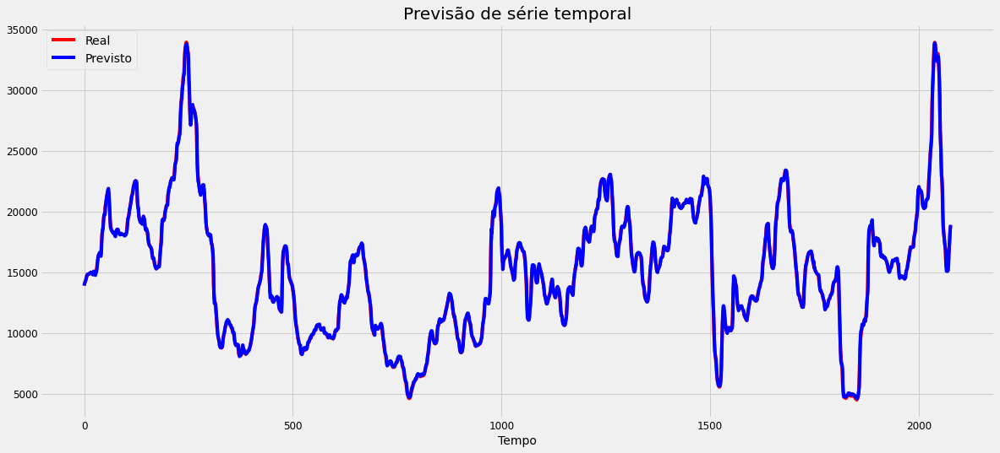

In [449]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

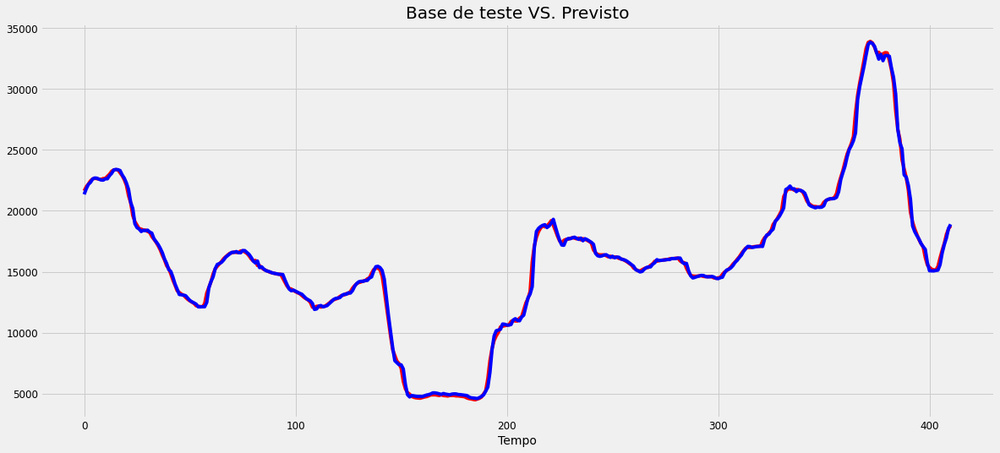

In [450]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [451]:
lstm_s4a_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_s4a_rmse)
lstm_s4a_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_s4a_mse)
lstm_s4a_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_s4a_mape, '%')
lstm_s4a_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  264.3541620079415
MSE:  69883.12297092099
MAPE:  1.15357678744232 %
R2:  0.9980728853715428


## S4B

### SARIMA

In [452]:
data = baltic.loc[baltic['Route'] == 'S4B'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S4B'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).S4B.mean()
data.head()

Date
2013-01-31    3318.409091
2013-02-28    2702.600000
2013-03-31    3578.050000
2013-04-30    3784.571429
2013-05-31    3663.428571
Freq: M, Name: S4B, dtype: float64

#### Divisão da base

In [453]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [454]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [455]:
y = data.copy()
y.tail()

Date
2020-12-31    12470.944444
2021-01-31    12183.350000
2021-02-28    15666.150000
2021-03-31    19350.347826
2021-04-30    16993.800000
Freq: M, Name: S4B, dtype: float64

#### Exibição da série

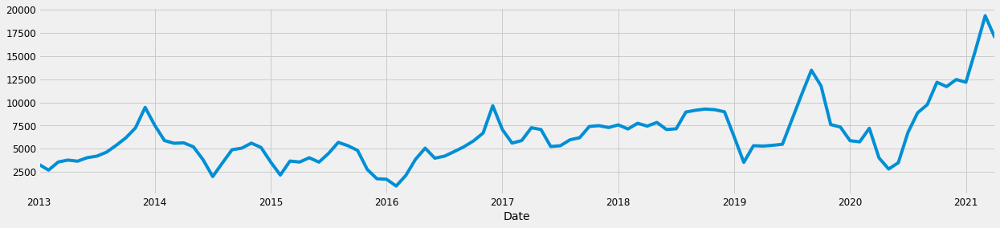

In [456]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

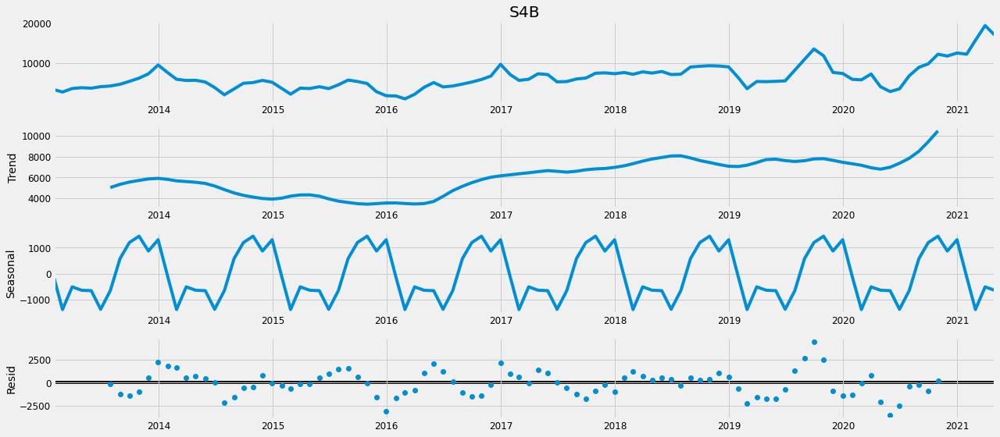

In [457]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [458]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [459]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2040.9617007439351
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1730.2891839435067
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1658.5917196541561
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1436.7969318068551
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1678.8775943345167
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1640.810179139154
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1456.5646131716337
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1438.6677941031573
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1947.8428003593906
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1699.8158250610604
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1566.2701940958584
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1349.2901262362022
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1604.5899942320032
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1540.0283214660149
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1388.1622689034903
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1351.2051695878179
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1708.2779850255681
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1499.0354177

#### Ajuste considerando o menor valor de AIC

In [460]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0953      0.284     -0.335      0.737      -0.652       0.462
ma.L1          0.4986      0.243      2.052      0.040       0.022       0.975
ar.S.L12      -0.0430      0.268     -0.160      0.873      -0.569       0.483
ma.S.L12      -0.6690      0.290     -2.303      0.021      -1.238      -0.100
sigma2      1.854e+06   2.87e+05      6.464      0.000    1.29e+06    2.42e+06


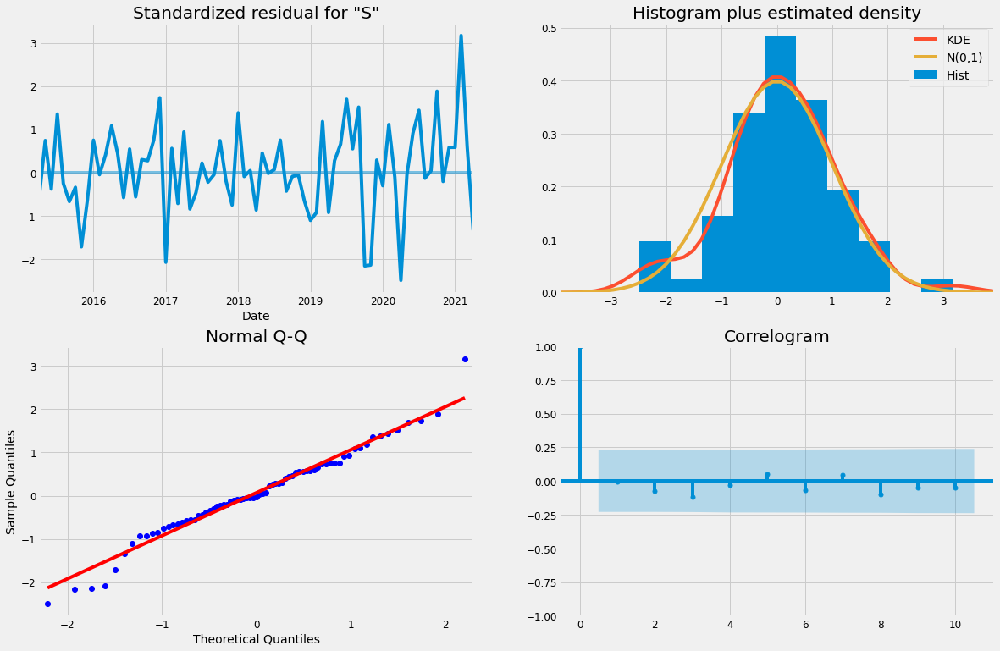

In [461]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

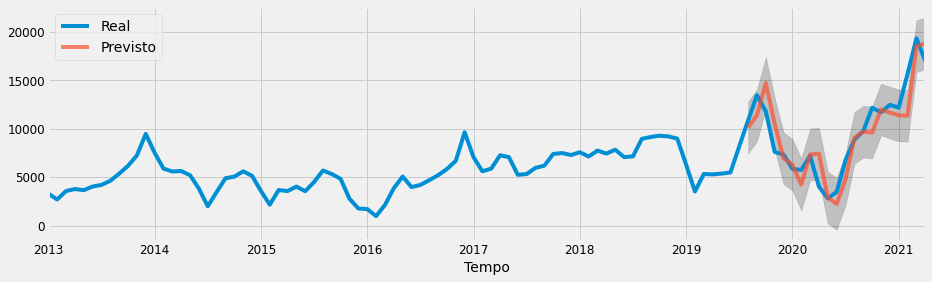

In [462]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [463]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_s4b_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_s4b_rmse)
sarima_s4b_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_s4b_mse)
sarima_s4b_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_s4b_mape, '%')
sarima_s4b_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  1852.5443928151215
MSE:  3431920.727350747
MAPE:  17.099664015327477 %
R2:  0.8194926511296208


### LSTM

#### Divisão da base

training_set

In [464]:
temp = baltic.loc[baltic['Route'] == 'S4B'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S4B'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,S4B
34542,2013-01-02,3489.0
34543,2013-01-03,3488.0
34544,2013-01-04,3468.0
34545,2013-01-07,3458.0
34546,2013-01-08,3438.0


In [465]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[3489.],
       [3488.],
       [3468.],
       [3458.],
       [3438.]])

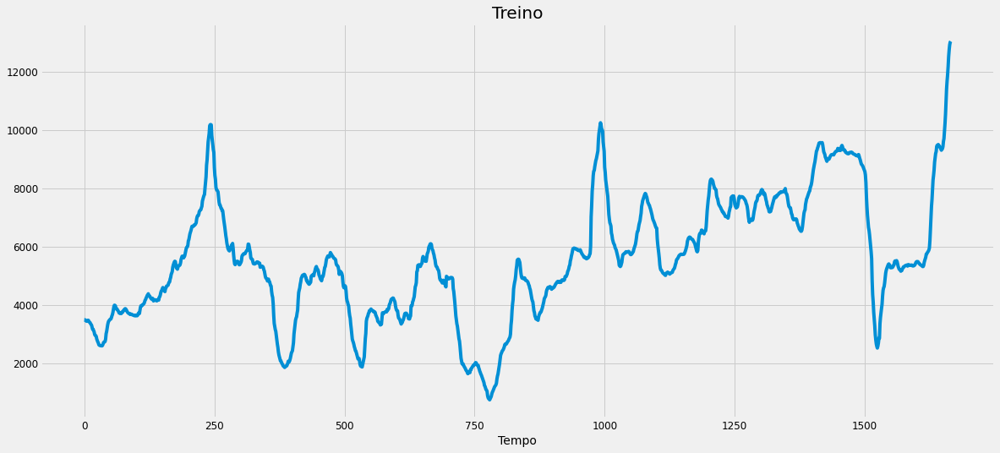

In [466]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [467]:
temp = baltic.loc[baltic['Route'] == 'S4B'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S4B'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,S4B
36208,2019-09-02,13236.0
36209,2019-09-03,13341.0
36210,2019-09-04,13406.0
36211,2019-09-05,13428.0
36212,2019-09-06,13444.0


In [468]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[13236.],
       [13341.],
       [13406.],
       [13428.],
       [13444.]])

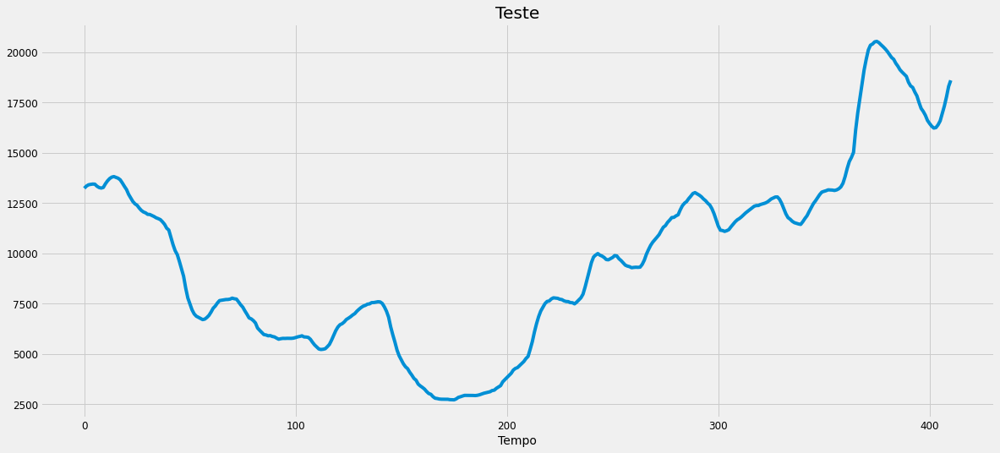

In [469]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [470]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [471]:
training_set_scaled[0:5]

array([[0.223604  ],
       [0.22352272],
       [0.2218971 ],
       [0.22108429],
       [0.21945867]])

##### Criar a estrutura de dados

In [472]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [473]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.223604,0.223523,0.221897,0.221084,0.219459,0.219215,0.220434,0.222060,0.221653,0.217996
1,0.223523,0.221897,0.221084,0.219459,0.219215,0.220434,0.222060,0.221653,0.217996,0.216614
2,0.221897,0.221084,0.219459,0.219215,0.220434,0.222060,0.221653,0.217996,0.216614,0.215801
3,0.221084,0.219459,0.219215,0.220434,0.222060,0.221653,0.217996,0.216614,0.215801,0.212550
4,0.219459,0.219215,0.220434,0.222060,0.221653,0.217996,0.216614,0.215801,0.212550,0.210274


In [474]:
pd.DataFrame(y_train).head()

,0
0,0.216614
1,0.215801
2,0.212550
3,0.210274
4,0.208242


##### *Reshaping*

In [475]:
X_train.shape

(1656, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [476]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [477]:
X_train.shape

(1656, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [478]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_34 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_34 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_35 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_35 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_36 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_36 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_12 (Dense)             (None, 1)               

###### Treinamento

In [479]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1490 samples, validate on 166 samples
Epoch 1/1000
1490/1490 [==============================] - 2s 1ms/step - loss: 0.0192 - val_loss: 0.0097
Epoch 2/1000
1490/1490 [==============================] - 1s 706us/step - loss: 0.0036 - val_loss: 0.0070
Epoch 3/1000
1490/1490 [==============================] - 1s 707us/step - loss: 0.0030 - val_loss: 0.0061
Epoch 4/1000
1490/1490 [==============================] - 1s 706us/step - loss: 0.0030 - val_loss: 0.0059
Epoch 5/1000
1490/1490 [==============================] - 1s 709us/step - loss: 0.0029 - val_loss: 0.0058
Epoch 6/1000
1490/1490 [==============================] - 1s 706us/step - loss: 0.0029 - val_loss: 0.0057
Epoch 7/1000
1490/1490 [==============================] - 1s 706us/step - loss: 0.0027 - val_loss: 0.0056
Epoch 8/1000
1490/1490 [==============================] - 1s 703us/step - loss: 0.0024 - val_loss: 0.0058
Epoch 9/1000
1490/1490 [==============================] - 1s 707us/step - loss: 0.0024 - val_loss: 0.0052
E

Epoch 74/1000
1490/1490 [==============================] - 1s 736us/step - loss: 4.3063e-04 - val_loss: 4.0328e-04
Epoch 75/1000
1490/1490 [==============================] - 1s 734us/step - loss: 4.0094e-04 - val_loss: 4.8254e-04
Epoch 76/1000
1490/1490 [==============================] - 1s 704us/step - loss: 3.9048e-04 - val_loss: 3.0912e-04
Epoch 77/1000
1490/1490 [==============================] - 1s 706us/step - loss: 4.1329e-04 - val_loss: 2.7606e-04
Epoch 78/1000
1490/1490 [==============================] - 1s 704us/step - loss: 3.8325e-04 - val_loss: 3.4773e-04
Epoch 79/1000
1490/1490 [==============================] - 1s 704us/step - loss: 4.2113e-04 - val_loss: 2.8758e-04
Epoch 80/1000
1490/1490 [==============================] - 1s 705us/step - loss: 4.1965e-04 - val_loss: 3.2055e-04
Epoch 81/1000
1490/1490 [==============================] - 1s 707us/step - loss: 4.4627e-04 - val_loss: 3.7105e-04
Epoch 82/1000
1490/1490 [==============================] - 1s 703us/step - loss:

Epoch 145/1000
1490/1490 [==============================] - 1s 713us/step - loss: 2.9698e-04 - val_loss: 1.6276e-04
Epoch 146/1000
1490/1490 [==============================] - 1s 708us/step - loss: 2.9993e-04 - val_loss: 1.5578e-04
Epoch 147/1000
1490/1490 [==============================] - 1s 726us/step - loss: 2.8965e-04 - val_loss: 1.4060e-04
Epoch 148/1000
1490/1490 [==============================] - 1s 746us/step - loss: 3.2126e-04 - val_loss: 1.6883e-04
Epoch 149/1000
1490/1490 [==============================] - 1s 758us/step - loss: 3.0576e-04 - val_loss: 1.8207e-04
Epoch 150/1000
1490/1490 [==============================] - 1s 708us/step - loss: 3.2824e-04 - val_loss: 1.5911e-04
Epoch 151/1000
1490/1490 [==============================] - 1s 705us/step - loss: 3.2560e-04 - val_loss: 2.4824e-04
Epoch 152/1000
1490/1490 [==============================] - 1s 706us/step - loss: 3.2157e-04 - val_loss: 2.4681e-04
Epoch 153/1000
1490/1490 [==============================] - 1s 706us/ste

1490/1490 [==============================] - 1s 703us/step - loss: 2.9429e-04 - val_loss: 1.0250e-04
Epoch 216/1000
1490/1490 [==============================] - 1s 707us/step - loss: 2.7170e-04 - val_loss: 1.1336e-04
Epoch 217/1000
1490/1490 [==============================] - 1s 703us/step - loss: 2.9299e-04 - val_loss: 9.7690e-05
Epoch 218/1000
1490/1490 [==============================] - 1s 706us/step - loss: 3.5251e-04 - val_loss: 1.4478e-04
Epoch 219/1000
1490/1490 [==============================] - 1s 704us/step - loss: 2.8389e-04 - val_loss: 1.1883e-04
Epoch 220/1000
1490/1490 [==============================] - 1s 709us/step - loss: 2.8936e-04 - val_loss: 2.4350e-04
Epoch 221/1000
1490/1490 [==============================] - 1s 731us/step - loss: 3.0843e-04 - val_loss: 2.5196e-04
Epoch 222/1000
1490/1490 [==============================] - 1s 732us/step - loss: 2.5699e-04 - val_loss: 2.2739e-04
Epoch 223/1000
1490/1490 [==============================] - 1s 754us/step - loss: 2.803

Epoch 286/1000
1490/1490 [==============================] - 1s 707us/step - loss: 2.1752e-04 - val_loss: 9.0380e-05
Epoch 287/1000
1490/1490 [==============================] - 1s 695us/step - loss: 2.0530e-04 - val_loss: 1.1644e-04
Epoch 288/1000
1490/1490 [==============================] - 1s 712us/step - loss: 2.2905e-04 - val_loss: 1.4047e-04
Epoch 289/1000
1490/1490 [==============================] - 1s 705us/step - loss: 2.2923e-04 - val_loss: 9.4704e-05
Epoch 290/1000
1490/1490 [==============================] - 1s 708us/step - loss: 2.2345e-04 - val_loss: 1.3026e-04
Epoch 291/1000
1490/1490 [==============================] - 1s 708us/step - loss: 2.1101e-04 - val_loss: 1.1517e-04
Epoch 292/1000
1490/1490 [==============================] - 1s 710us/step - loss: 2.1820e-04 - val_loss: 1.3556e-04
Epoch 293/1000
1490/1490 [==============================] - 1s 703us/step - loss: 2.3347e-04 - val_loss: 9.1754e-05
Epoch 294/1000
1490/1490 [==============================] - 1s 710us/ste

1490/1490 [==============================] - 1s 708us/step - loss: 1.8341e-04 - val_loss: 9.9713e-05
Epoch 357/1000
1490/1490 [==============================] - 1s 743us/step - loss: 2.0353e-04 - val_loss: 9.6497e-05
Epoch 358/1000
1490/1490 [==============================] - 1s 738us/step - loss: 2.0426e-04 - val_loss: 9.9263e-05
Epoch 359/1000
1490/1490 [==============================] - 1s 786us/step - loss: 2.0777e-04 - val_loss: 9.6331e-05
Epoch 360/1000
1490/1490 [==============================] - 1s 705us/step - loss: 2.0542e-04 - val_loss: 9.5989e-05
Epoch 361/1000
1490/1490 [==============================] - 1s 707us/step - loss: 2.0578e-04 - val_loss: 1.0237e-04
Epoch 362/1000
1490/1490 [==============================] - 1s 704us/step - loss: 2.0846e-04 - val_loss: 9.8713e-05
Epoch 363/1000
1490/1490 [==============================] - 1s 711us/step - loss: 2.1102e-04 - val_loss: 9.7844e-05
Epoch 364/1000
1490/1490 [==============================] - 1s 713us/step - loss: 1.885

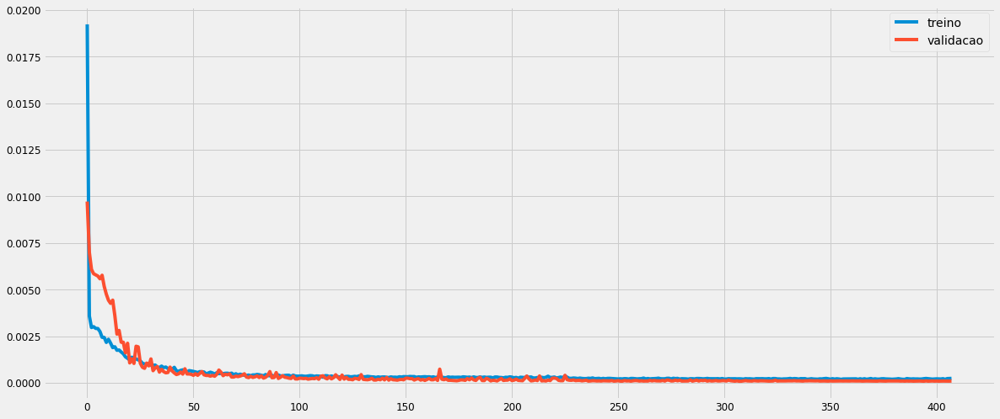

In [480]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [481]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [482]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.9828441 ],
       [0.99992216],
       [1.0069795 ],
       [1.0082543 ],
       [1.0078696 ]], dtype=float32)

In [483]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[12829.932],
       [13040.043],
       [13126.869],
       [13142.553],
       [13137.82 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

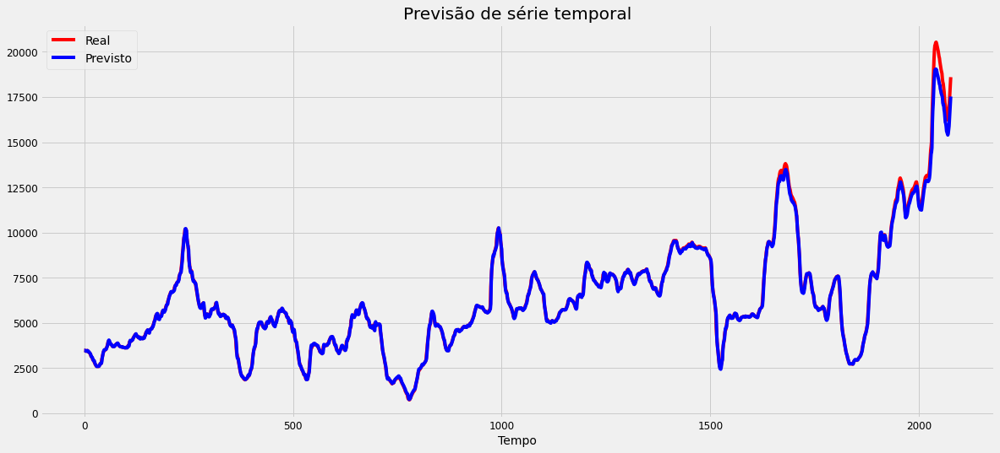

In [484]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

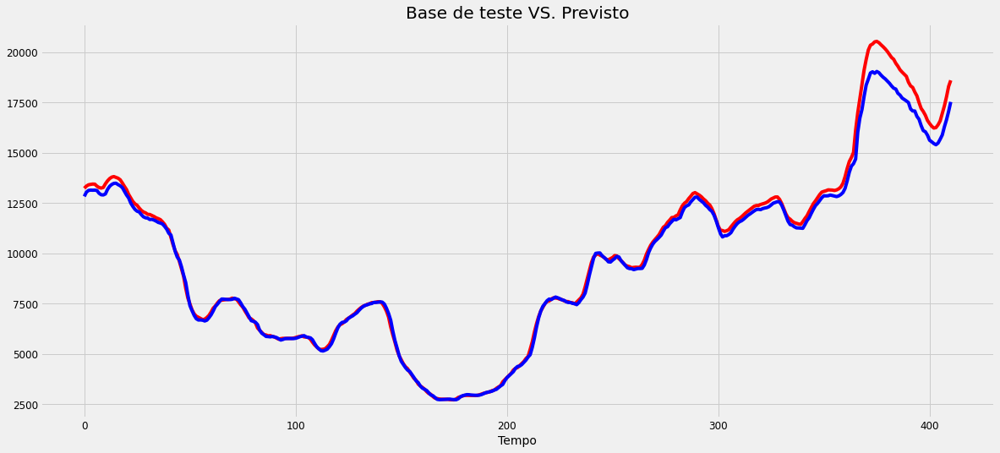

In [485]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [486]:
lstm_s4b_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_s4b_rmse)
lstm_s4b_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_s4b_mse)
lstm_s4b_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_s4b_mape, '%')
lstm_s4b_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  434.64648243876854
MSE:  188917.56469639475
MAPE:  1.9125113145573958 %
R2:  0.9907463797570568


## S5

### SARIMA

In [487]:
data = baltic.loc[baltic['Route'] == 'S5'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S5'}) 
data = data.groupby([pd.Grouper(key='Date', freq='M')]).S5.mean()
data.head()

Date
2013-01-31    13404.954545
2013-02-28    11882.000000
2013-03-31    14361.300000
2013-04-30    15993.523810
2013-05-31    13947.809524
Freq: M, Name: S5, dtype: float64

#### Divisão da base

In [488]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [489]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [490]:
y = data.copy()
y.tail()

Date
2020-12-31    15318.777778
2021-01-31    16221.800000
2021-02-28    19646.500000
2021-03-31    27106.956522
2021-04-30    25051.133333
Freq: M, Name: S5, dtype: float64

#### Exibição da série

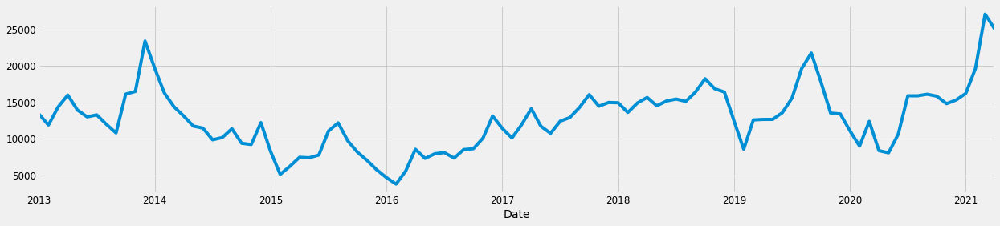

In [491]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

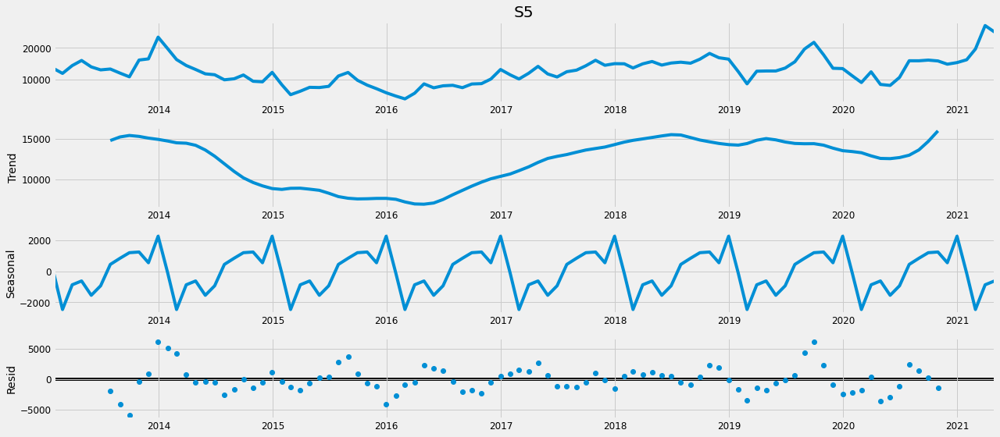

In [492]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [493]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [494]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2164.641158961261
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1857.2703658366704
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1729.3268192003397
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1481.6675071871882
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1750.7973039167935
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1712.2382973737017
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1512.686524629909
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1482.8186342095344
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:2031.9811019060746
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1806.4018852866973
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1650.1592627746181
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1410.851981468071
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1682.8757735168008
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1616.6815875019201
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1453.4234694013553
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1412.380188298003
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1797.841559826405
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1561.38166164400

#### Ajuste considerando o menor valor de AIC

In [495]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0459      0.310      0.148      0.882      -0.562       0.653
ma.L1          0.3103      0.309      1.003      0.316      -0.296       0.917
ar.S.L12       0.0519      0.266      0.195      0.845      -0.469       0.573
ma.S.L12      -0.6366      0.234     -2.722      0.006      -1.095      -0.178
sigma2      3.942e+06    6.1e+05      6.463      0.000    2.75e+06    5.14e+06


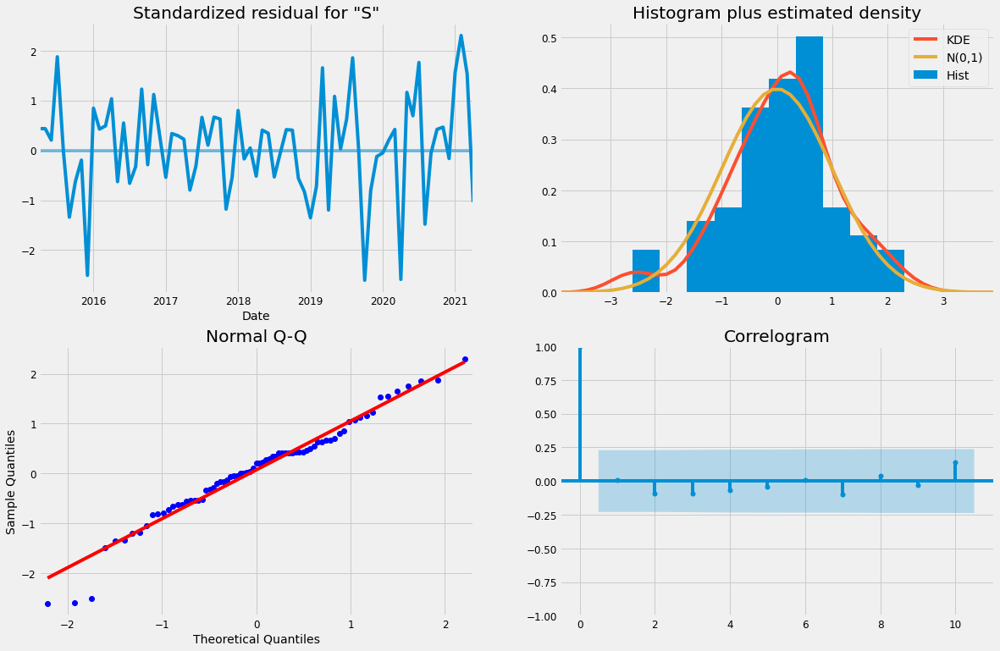

In [496]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

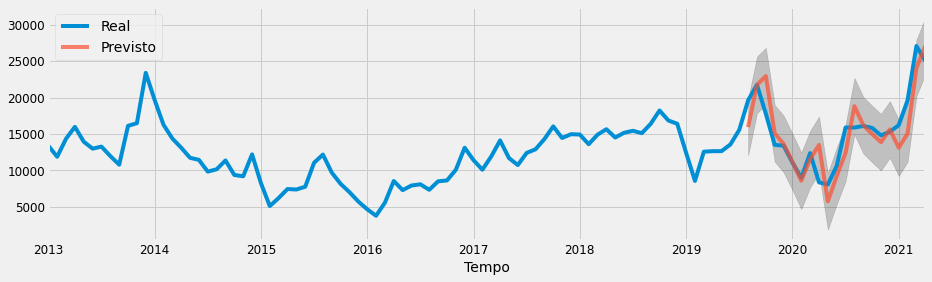

In [497]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [498]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_s5_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_s5_rmse)
sarima_s5_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_s5_mse)
sarima_s5_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_s5_mape, '%')
sarima_s5_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  2619.069853634009
MSE:  6859526.89821447
MAPE:  13.969780866147454 %
R2:  0.7211095703496677


### LSTM

#### Divisão da base

training_set

In [499]:
temp = baltic.loc[baltic['Route'] == 'S5'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S5'}) 
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,S5
36619,2013-01-02,12294.0
36620,2013-01-03,12361.0
36621,2013-01-04,12444.0
36622,2013-01-07,12550.0
36623,2013-01-08,12678.0


In [500]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[12294.],
       [12361.],
       [12444.],
       [12550.],
       [12678.]])

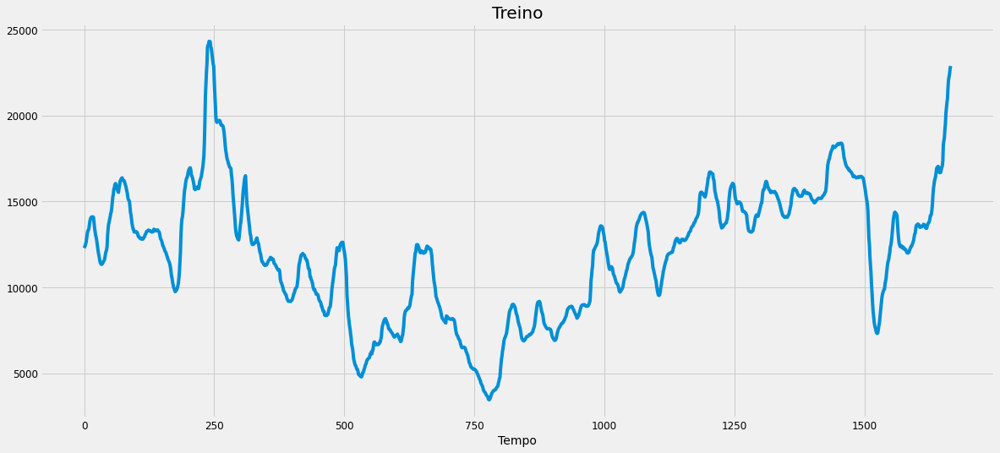

In [501]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [502]:
temp = baltic.loc[baltic['Route'] == 'S5'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S5'}) 
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,S5
38285,2019-09-02,23098.0
38286,2019-09-03,23235.0
38287,2019-09-04,23302.0
38288,2019-09-05,23182.0
38289,2019-09-06,22926.0


In [503]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[23098.],
       [23235.],
       [23302.],
       [23182.],
       [22926.]])

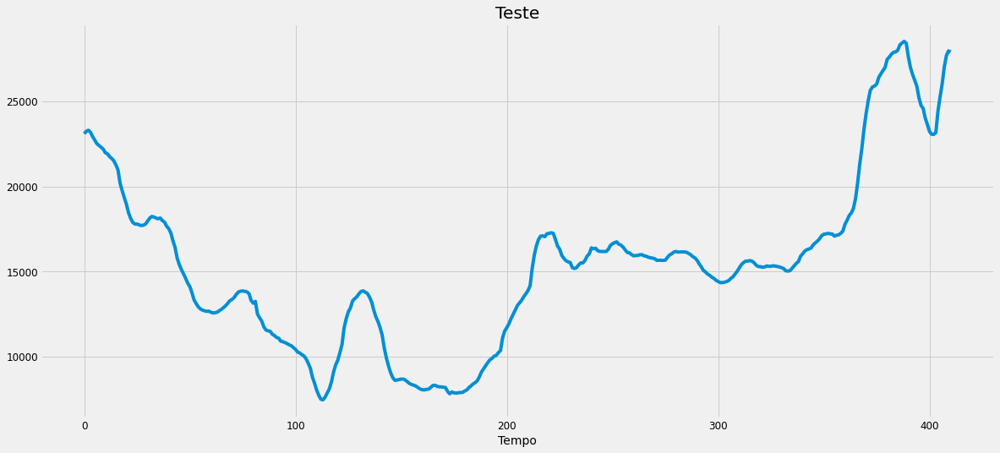

In [504]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [505]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [506]:
training_set_scaled[0:5]

array([[0.42335906],
       [0.42657141],
       [0.43055089],
       [0.43563312],
       [0.44177015]])

##### Criar a estrutura de dados

In [507]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [508]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.423359,0.426571,0.430551,0.435633,0.441770,0.453469,0.463585,0.471065,0.472935,0.477442
1,0.426571,0.430551,0.435633,0.441770,0.453469,0.463585,0.471065,0.472935,0.477442,0.488086
2,0.430551,0.435633,0.441770,0.453469,0.463585,0.471065,0.472935,0.477442,0.488086,0.497962
3,0.435633,0.441770,0.453469,0.463585,0.471065,0.472935,0.477442,0.488086,0.497962,0.504627
4,0.441770,0.453469,0.463585,0.471065,0.472935,0.477442,0.488086,0.497962,0.504627,0.508079


In [509]:
pd.DataFrame(y_train).head()

,0
0,0.488086
1,0.497962
2,0.504627
3,0.508079
4,0.509949


##### *Reshaping*

In [510]:
X_train.shape

(1656, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [511]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [512]:
X_train.shape

(1656, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [513]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_37 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_37 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_38 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_38 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_39 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_39 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_13 (Dense)             (None, 1)               

###### Treinamento

In [514]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1490 samples, validate on 166 samples
Epoch 1/1000
1490/1490 [==============================] - 2s 1ms/step - loss: 0.0253 - val_loss: 0.0057
Epoch 2/1000
1490/1490 [==============================] - 1s 704us/step - loss: 0.0040 - val_loss: 0.0048
Epoch 3/1000
1490/1490 [==============================] - 1s 708us/step - loss: 0.0037 - val_loss: 0.0047
Epoch 4/1000
1490/1490 [==============================] - 1s 717us/step - loss: 0.0038 - val_loss: 0.0046
Epoch 5/1000
1490/1490 [==============================] - 1s 711us/step - loss: 0.0036 - val_loss: 0.0047
Epoch 6/1000
1490/1490 [==============================] - 1s 709us/step - loss: 0.0034 - val_loss: 0.0044
Epoch 7/1000
1490/1490 [==============================] - 1s 723us/step - loss: 0.0032 - val_loss: 0.0045
Epoch 8/1000
1490/1490 [==============================] - 1s 747us/step - loss: 0.0029 - val_loss: 0.0038
Epoch 9/1000
1490/1490 [==============================] - 1s 746us/step - loss: 0.0028 - val_loss: 0.0036
E

Epoch 74/1000
1490/1490 [==============================] - 1s 703us/step - loss: 5.7972e-04 - val_loss: 2.9093e-04
Epoch 75/1000
1490/1490 [==============================] - 1s 703us/step - loss: 6.0287e-04 - val_loss: 3.3413e-04
Epoch 76/1000
1490/1490 [==============================] - 1s 706us/step - loss: 5.4098e-04 - val_loss: 1.8202e-04
Epoch 77/1000
1490/1490 [==============================] - 1s 705us/step - loss: 4.8654e-04 - val_loss: 1.7477e-04
Epoch 78/1000
1490/1490 [==============================] - 1s 706us/step - loss: 4.7442e-04 - val_loss: 2.1328e-04
Epoch 79/1000
1490/1490 [==============================] - 1s 707us/step - loss: 4.6154e-04 - val_loss: 1.6994e-04
Epoch 80/1000
1490/1490 [==============================] - 1s 707us/step - loss: 4.5576e-04 - val_loss: 1.7359e-04
Epoch 81/1000
1490/1490 [==============================] - 1s 736us/step - loss: 4.8915e-04 - val_loss: 3.9448e-04
Epoch 82/1000
1490/1490 [==============================] - 1s 734us/step - loss:

Epoch 145/1000
1490/1490 [==============================] - 1s 709us/step - loss: 3.7447e-04 - val_loss: 1.9379e-04
Epoch 146/1000
1490/1490 [==============================] - 1s 707us/step - loss: 3.8963e-04 - val_loss: 1.3899e-04
Epoch 147/1000
1490/1490 [==============================] - 1s 709us/step - loss: 3.8538e-04 - val_loss: 1.2300e-04
Epoch 148/1000
1490/1490 [==============================] - 1s 708us/step - loss: 3.4499e-04 - val_loss: 1.7213e-04
Epoch 149/1000
1490/1490 [==============================] - 1s 703us/step - loss: 3.3488e-04 - val_loss: 1.2658e-04
Epoch 150/1000
1490/1490 [==============================] - 1s 705us/step - loss: 3.5371e-04 - val_loss: 1.3473e-04
Epoch 151/1000
1490/1490 [==============================] - 1s 704us/step - loss: 3.5384e-04 - val_loss: 1.4293e-04
Epoch 152/1000
1490/1490 [==============================] - 1s 707us/step - loss: 4.3871e-04 - val_loss: 2.2501e-04
Epoch 153/1000
1490/1490 [==============================] - 1s 708us/ste

1490/1490 [==============================] - 1s 707us/step - loss: 3.5392e-04 - val_loss: 9.5330e-05
Epoch 216/1000
1490/1490 [==============================] - 1s 748us/step - loss: 3.0001e-04 - val_loss: 9.1691e-05
Epoch 217/1000
1490/1490 [==============================] - 1s 732us/step - loss: 3.9604e-04 - val_loss: 1.0318e-04
Epoch 218/1000
1490/1490 [==============================] - 1s 751us/step - loss: 3.5170e-04 - val_loss: 1.3195e-04
Epoch 219/1000
1490/1490 [==============================] - 1s 707us/step - loss: 3.5723e-04 - val_loss: 9.4656e-05
Epoch 220/1000
1490/1490 [==============================] - 1s 706us/step - loss: 3.0172e-04 - val_loss: 2.0568e-04
Epoch 221/1000
1490/1490 [==============================] - 1s 803us/step - loss: 3.0969e-04 - val_loss: 7.3695e-05
Epoch 222/1000
1490/1490 [==============================] - 1s 784us/step - loss: 3.5410e-04 - val_loss: 2.3765e-04
Epoch 223/1000
1490/1490 [==============================] - 1s 769us/step - loss: 3.892

Epoch 286/1000
1490/1490 [==============================] - 1s 714us/step - loss: 2.4808e-04 - val_loss: 7.2932e-05
Epoch 287/1000
1490/1490 [==============================] - 1s 715us/step - loss: 2.4703e-04 - val_loss: 8.7561e-05
Epoch 288/1000
1490/1490 [==============================] - 1s 713us/step - loss: 2.3748e-04 - val_loss: 7.8762e-05
Epoch 289/1000
1490/1490 [==============================] - 1s 724us/step - loss: 2.3718e-04 - val_loss: 6.3964e-05
Epoch 290/1000
1490/1490 [==============================] - 1s 755us/step - loss: 2.6287e-04 - val_loss: 7.5521e-05
Epoch 291/1000
1490/1490 [==============================] - 1s 747us/step - loss: 2.5287e-04 - val_loss: 6.1994e-05
Epoch 292/1000
1490/1490 [==============================] - 1s 722us/step - loss: 2.5319e-04 - val_loss: 8.7811e-05
Epoch 293/1000
1490/1490 [==============================] - 1s 710us/step - loss: 2.3103e-04 - val_loss: 6.8365e-05
Epoch 294/1000
1490/1490 [==============================] - 1s 710us/ste

1490/1490 [==============================] - 1s 712us/step - loss: 2.4025e-04 - val_loss: 6.1052e-05
Epoch 357/1000
1490/1490 [==============================] - 1s 710us/step - loss: 2.3449e-04 - val_loss: 5.9462e-05
Epoch 358/1000
1490/1490 [==============================] - 1s 712us/step - loss: 2.4382e-04 - val_loss: 5.9200e-05
Epoch 359/1000
1490/1490 [==============================] - 1s 723us/step - loss: 2.3176e-04 - val_loss: 5.8340e-05
Epoch 360/1000
1490/1490 [==============================] - 1s 708us/step - loss: 2.3400e-04 - val_loss: 5.7389e-05
Epoch 361/1000
1490/1490 [==============================] - 1s 709us/step - loss: 2.1614e-04 - val_loss: 6.0294e-05
Epoch 362/1000
1490/1490 [==============================] - 1s 712us/step - loss: 2.4879e-04 - val_loss: 5.7266e-05
Epoch 363/1000
1490/1490 [==============================] - 1s 712us/step - loss: 2.4632e-04 - val_loss: 6.6110e-05
Epoch 364/1000
1490/1490 [==============================] - 1s 753us/step - loss: 2.338

Epoch 427/1000
1490/1490 [==============================] - 1s 709us/step - loss: 2.3826e-04 - val_loss: 5.8296e-05
Epoch 428/1000
1490/1490 [==============================] - 1s 707us/step - loss: 2.5112e-04 - val_loss: 5.8726e-05
Epoch 429/1000
1490/1490 [==============================] - 1s 704us/step - loss: 2.1827e-04 - val_loss: 6.0968e-05
Epoch 430/1000
1490/1490 [==============================] - 1s 710us/step - loss: 2.6007e-04 - val_loss: 5.9454e-05
Epoch 431/1000
1490/1490 [==============================] - 1s 698us/step - loss: 2.5605e-04 - val_loss: 5.6648e-05
Epoch 432/1000
1490/1490 [==============================] - 1s 715us/step - loss: 2.5344e-04 - val_loss: 5.7389e-05
Epoch 433/1000
1490/1490 [==============================] - 1s 709us/step - loss: 2.1271e-04 - val_loss: 5.7320e-05
Epoch 434/1000
1490/1490 [==============================] - 1s 707us/step - loss: 2.3215e-04 - val_loss: 5.7728e-05
Epoch 435/1000
1490/1490 [==============================] - 1s 706us/ste

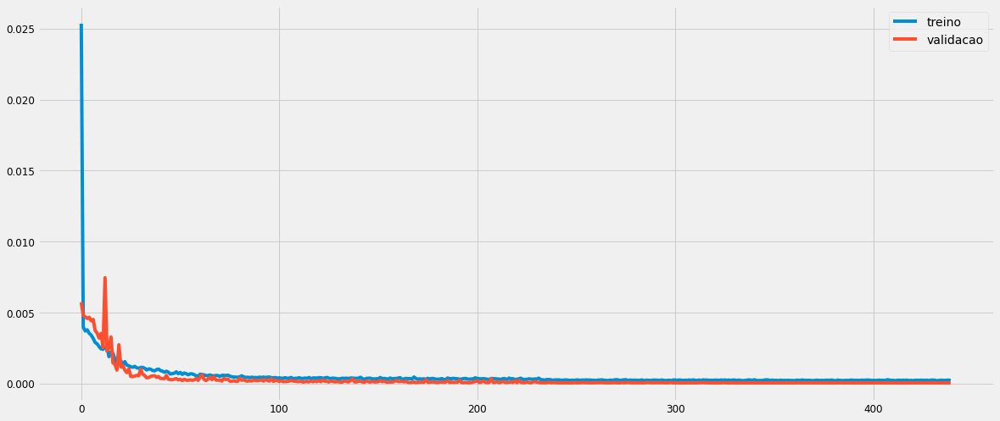

In [515]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [516]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [517]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.9322577 ],
       [0.9403921 ],
       [0.9460569 ],
       [0.9470039 ],
       [0.93690413]], dtype=float32)

In [518]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[22908.098],
       [23077.756],
       [23195.908],
       [23215.66 ],
       [23005.008]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

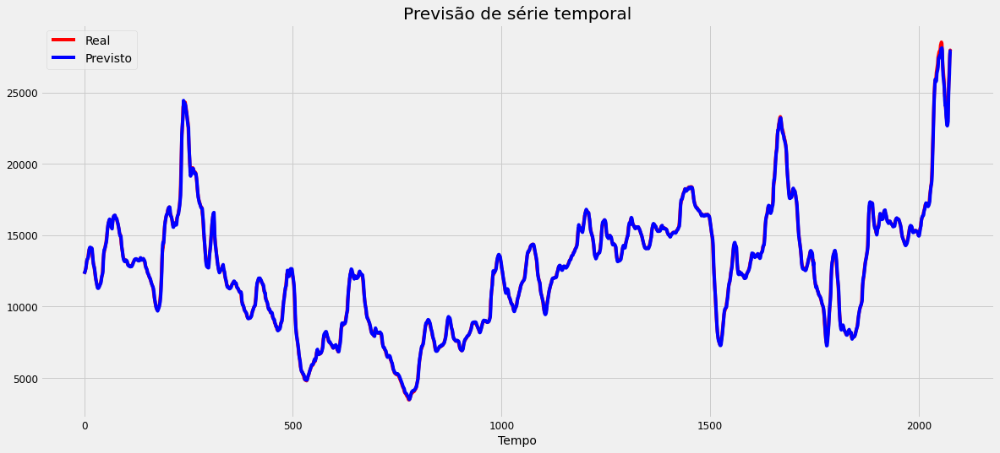

In [519]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

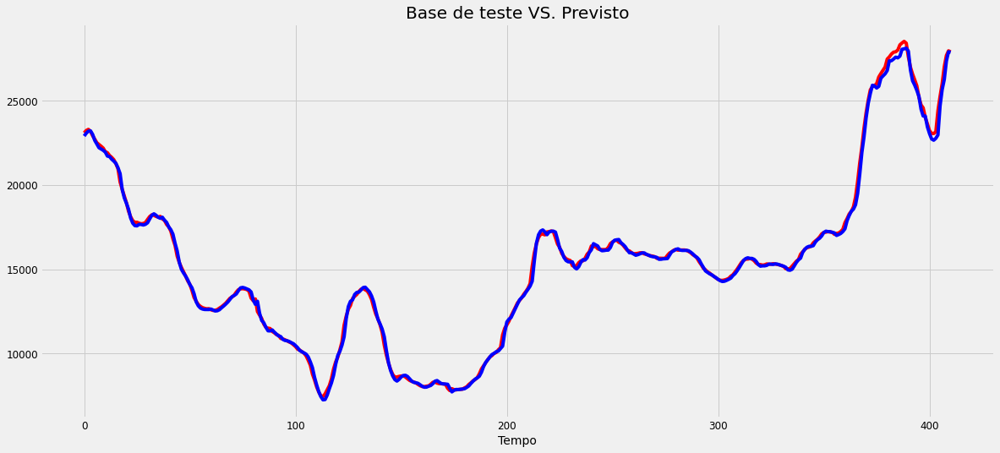

In [520]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [521]:
lstm_s5_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_s5_rmse)
lstm_s5_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_s5_mse)
lstm_s5_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_s5_mape, '%')
lstm_s5_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  200.02032034965472
MSE:  40008.1285527785
MAPE:  0.8264902730611496 %
R2:  0.9984368049816535


## S8

### SARIMA

In [522]:
data = baltic.loc[baltic['Route'] == 'S8'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S8'})  
data = data.groupby([pd.Grouper(key='Date', freq='M')]).S8.mean()
data.head()

Date
2013-01-31    7303.545455
2013-02-28    6077.600000
2013-03-31    9320.050000
2013-04-30    8795.857143
2013-05-31    8287.714286
Freq: M, Name: S8, dtype: float64

#### Divisão da base

In [523]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [524]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [525]:
y = data.copy()
y.tail()

Date
2020-12-31     9678.222222
2021-01-31     9773.900000
2021-02-28    11142.000000
2021-03-31    19958.304348
2021-04-30    20692.750000
Freq: M, Name: S8, dtype: float64

#### Exibição da série

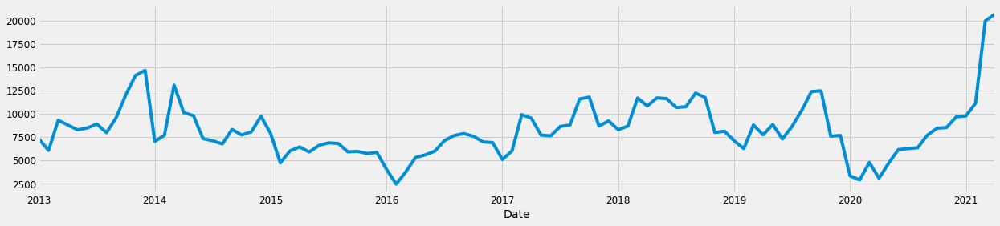

In [526]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

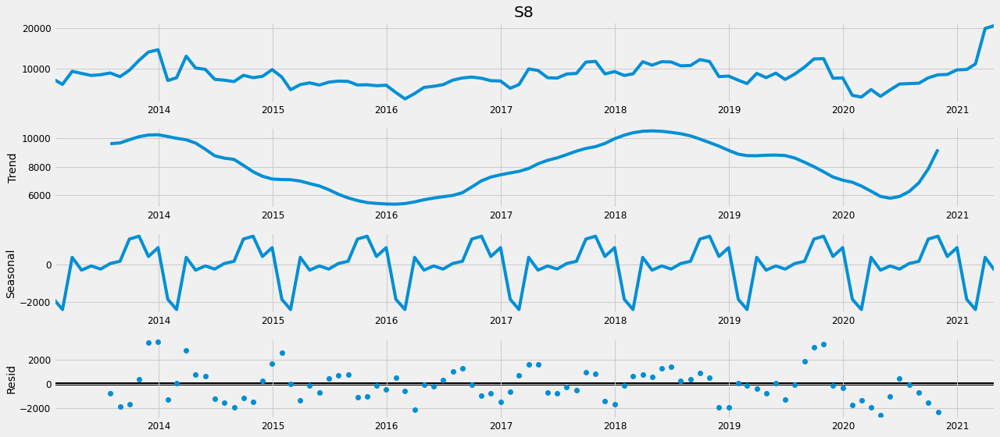

In [527]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [528]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [529]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2082.56131621361
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1784.1834080011076
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1686.0282989244167
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1445.9151149238603
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1703.633884101991
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1674.8708371737862
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1476.5087147145662
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1445.4107056461603
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1991.4708260340933
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1737.168849314215
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1595.1044865172487
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1351.9532192423515
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1634.6704620902908
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1571.945774059533
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1409.969694492184
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1354.3258388104357
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1770.1082270379989
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1532.202432728578

#### Ajuste considerando o menor valor de AIC

In [530]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3973      0.403      0.985      0.325      -0.393       1.188
ma.L1         -0.1497      0.469     -0.319      0.749      -1.068       0.769
ar.S.L12       0.0314      0.213      0.148      0.883      -0.386       0.449
ma.S.L12      -1.3249      0.293     -4.525      0.000      -1.899      -0.751
sigma2      1.211e+06   5.59e+05      2.166      0.030    1.15e+05    2.31e+06


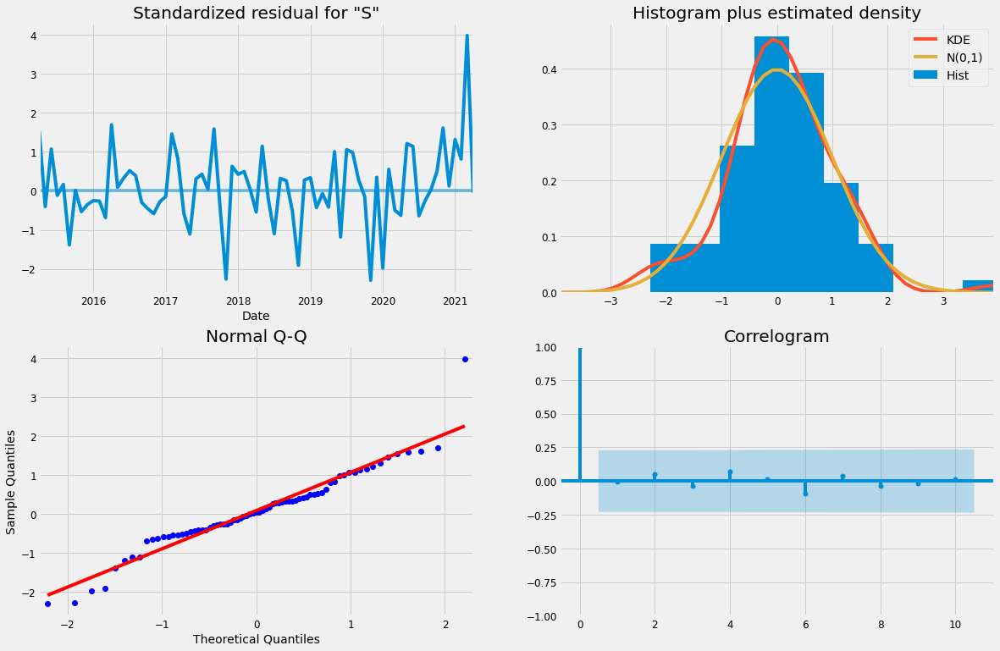

In [531]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

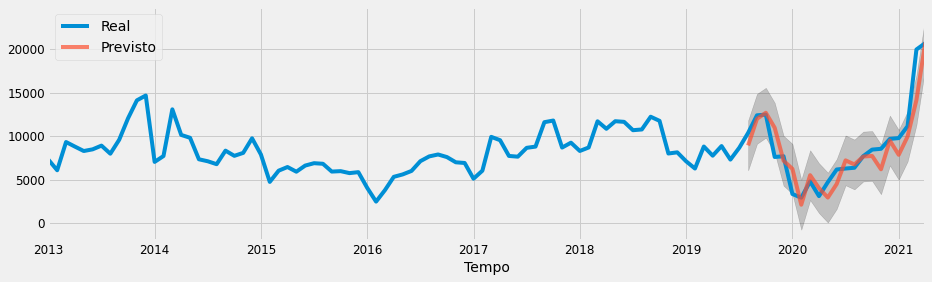

In [532]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [533]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_s8_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_s8_rmse)
sarima_s8_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_s8_mse)
sarima_s8_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_s8_mape, '%')
sarima_s8_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  1904.7217889269436
MSE:  3627965.0932130567
MAPE:  19.658455224478836 %
R2:  0.832528310290316


### LSTM

#### Divisão da base

training_set

In [534]:
temp = baltic.loc[baltic['Route'] == 'S8'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S8'})  
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,S8
38696,2013-01-02,8975.0
38697,2013-01-03,8788.0
38698,2013-01-04,8660.0
38699,2013-01-07,8565.0
38700,2013-01-08,8420.0


In [535]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[8975.],
       [8788.],
       [8660.],
       [8565.],
       [8420.]])

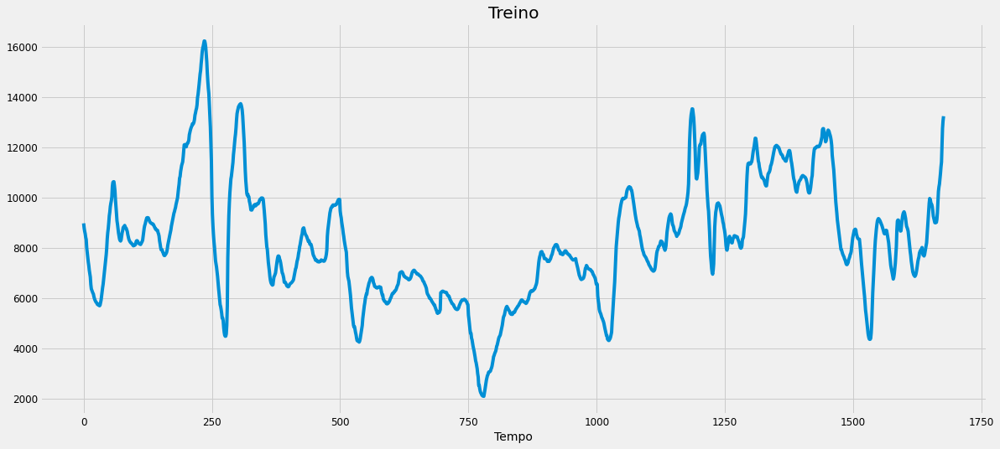

In [536]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [537]:
temp = baltic.loc[baltic['Route'] == 'S8'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S8'})  
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,S8
40373,2019-09-02,13306.0
40374,2019-09-03,13303.0
40375,2019-09-04,13238.0
40376,2019-09-05,13138.0
40377,2019-09-06,12863.0


In [538]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[13306.],
       [13303.],
       [13238.],
       [13138.],
       [12863.]])

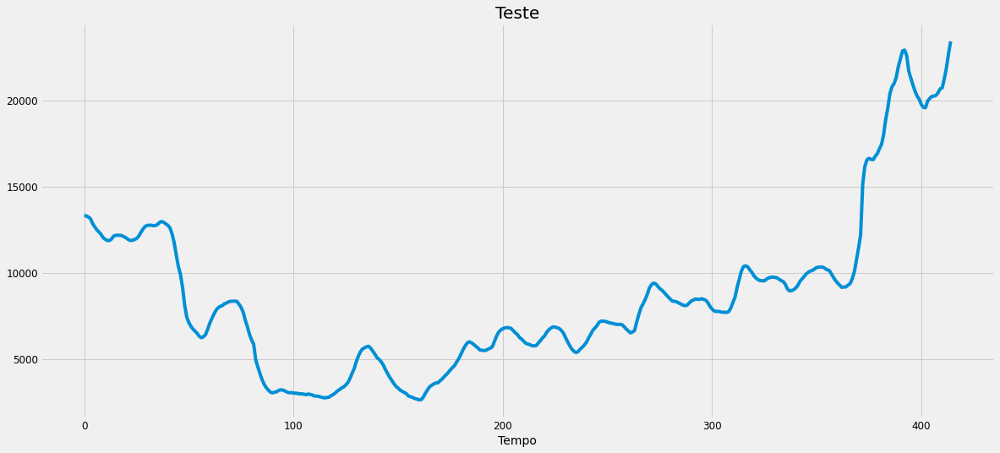

In [539]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [540]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [541]:
training_set_scaled[0:5]

array([[0.48684583],
       [0.47362093],
       [0.4645686 ],
       [0.45785007],
       [0.44759547]])

##### Criar a estrutura de dados

In [542]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [543]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.486846,0.473621,0.464569,0.457850,0.447595,0.441231,0.417893,0.404455,0.389604,0.378642
1,0.473621,0.464569,0.457850,0.447595,0.441231,0.417893,0.404455,0.389604,0.378642,0.368388
2,0.464569,0.457850,0.447595,0.441231,0.417893,0.404455,0.389604,0.378642,0.368388,0.354950
3,0.457850,0.447595,0.441231,0.417893,0.404455,0.389604,0.378642,0.368388,0.354950,0.344696
4,0.447595,0.441231,0.417893,0.404455,0.389604,0.378642,0.368388,0.354950,0.344696,0.335856


In [544]:
pd.DataFrame(y_train).head()

,0
0,0.368388
1,0.354950
2,0.344696
3,0.335856
4,0.314639


##### *Reshaping*

In [545]:
X_train.shape

(1667, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [546]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [547]:
X_train.shape

(1667, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [548]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_40 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_40 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_41 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_41 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_42 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_42 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_14 (Dense)             (None, 1)               

###### Treinamento

In [549]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1500 samples, validate on 167 samples
Epoch 1/1000
1500/1500 [==============================] - 2s 1ms/step - loss: 0.0335 - val_loss: 0.0070
Epoch 2/1000
1500/1500 [==============================] - 1s 737us/step - loss: 0.0061 - val_loss: 0.0055
Epoch 3/1000
1500/1500 [==============================] - 1s 742us/step - loss: 0.0059 - val_loss: 0.0055
Epoch 4/1000
1500/1500 [==============================] - 1s 740us/step - loss: 0.0056 - val_loss: 0.0051
Epoch 5/1000
1500/1500 [==============================] - 1s 762us/step - loss: 0.0049 - val_loss: 0.0050
Epoch 6/1000
1500/1500 [==============================] - 1s 764us/step - loss: 0.0045 - val_loss: 0.0056
Epoch 7/1000
1500/1500 [==============================] - 1s 758us/step - loss: 0.0049 - val_loss: 0.0042
Epoch 8/1000
1500/1500 [==============================] - 1s 776us/step - loss: 0.0040 - val_loss: 0.0040
Epoch 9/1000
1500/1500 [==============================] - 1s 790us/step - loss: 0.0033 - val_loss: 0.0029
E

1500/1500 [==============================] - 1s 733us/step - loss: 5.7527e-04 - val_loss: 3.6972e-04
Epoch 75/1000
1500/1500 [==============================] - 1s 731us/step - loss: 5.6846e-04 - val_loss: 2.4259e-04
Epoch 76/1000
1500/1500 [==============================] - 1s 741us/step - loss: 6.3662e-04 - val_loss: 2.5208e-04
Epoch 77/1000
1500/1500 [==============================] - 1s 732us/step - loss: 5.5946e-04 - val_loss: 2.6488e-04
Epoch 78/1000
1500/1500 [==============================] - 1s 764us/step - loss: 6.2535e-04 - val_loss: 2.4647e-04
Epoch 79/1000
1500/1500 [==============================] - 1s 755us/step - loss: 5.8096e-04 - val_loss: 2.4170e-04
Epoch 80/1000
1500/1500 [==============================] - 1s 777us/step - loss: 5.7139e-04 - val_loss: 2.3497e-04
Epoch 81/1000
1500/1500 [==============================] - 1s 734us/step - loss: 5.3589e-04 - val_loss: 2.5325e-04
Epoch 82/1000
1500/1500 [==============================] - 1s 733us/step - loss: 6.0612e-04 - 

Epoch 145/1000
1500/1500 [==============================] - 1s 856us/step - loss: 3.4368e-04 - val_loss: 1.5509e-04
Epoch 146/1000
1500/1500 [==============================] - 1s 857us/step - loss: 3.8396e-04 - val_loss: 1.2000e-04
Epoch 147/1000
1500/1500 [==============================] - 1s 860us/step - loss: 3.5680e-04 - val_loss: 1.2341e-04
Epoch 148/1000
1500/1500 [==============================] - 1s 882us/step - loss: 3.4864e-04 - val_loss: 1.9469e-04
Epoch 149/1000
1500/1500 [==============================] - 1s 889us/step - loss: 3.6048e-04 - val_loss: 1.1506e-04
Epoch 150/1000
1500/1500 [==============================] - 1s 905us/step - loss: 3.2084e-04 - val_loss: 1.0308e-04
Epoch 151/1000
1500/1500 [==============================] - 1s 860us/step - loss: 3.2780e-04 - val_loss: 9.2436e-05
Epoch 152/1000
1500/1500 [==============================] - 1s 857us/step - loss: 3.2262e-04 - val_loss: 1.1532e-04
Epoch 153/1000
1500/1500 [==============================] - 1s 849us/ste

1500/1500 [==============================] - 1s 854us/step - loss: 2.6983e-04 - val_loss: 8.6721e-05
Epoch 216/1000
1500/1500 [==============================] - 1s 848us/step - loss: 3.0134e-04 - val_loss: 7.8067e-05
Epoch 217/1000
1500/1500 [==============================] - 1s 848us/step - loss: 2.8789e-04 - val_loss: 7.0616e-05
Epoch 218/1000
1500/1500 [==============================] - 1s 854us/step - loss: 3.1190e-04 - val_loss: 1.1259e-04
Epoch 219/1000
1500/1500 [==============================] - 1s 855us/step - loss: 3.4678e-04 - val_loss: 9.0244e-05
Epoch 220/1000
1500/1500 [==============================] - 1s 856us/step - loss: 3.3728e-04 - val_loss: 1.2993e-04
Epoch 221/1000
1500/1500 [==============================] - 1s 884us/step - loss: 3.5892e-04 - val_loss: 1.0459e-04
Epoch 222/1000
1500/1500 [==============================] - 1s 886us/step - loss: 3.1248e-04 - val_loss: 1.1656e-04
Epoch 223/1000
1500/1500 [==============================] - 1s 913us/step - loss: 3.639

Epoch 286/1000
1500/1500 [==============================] - 1s 853us/step - loss: 2.5560e-04 - val_loss: 5.8831e-05
Epoch 287/1000
1500/1500 [==============================] - 1s 854us/step - loss: 2.6227e-04 - val_loss: 6.2238e-05
Epoch 288/1000
1500/1500 [==============================] - 1s 850us/step - loss: 2.9372e-04 - val_loss: 5.8317e-05
Epoch 289/1000
1500/1500 [==============================] - 1s 854us/step - loss: 2.6514e-04 - val_loss: 6.1293e-05
Epoch 290/1000
1500/1500 [==============================] - 1s 849us/step - loss: 2.2987e-04 - val_loss: 5.9695e-05
Epoch 291/1000
1500/1500 [==============================] - 1s 852us/step - loss: 2.5881e-04 - val_loss: 5.8111e-05
Epoch 292/1000
1500/1500 [==============================] - 1s 857us/step - loss: 2.6878e-04 - val_loss: 6.0521e-05
Epoch 293/1000
1500/1500 [==============================] - 1s 856us/step - loss: 2.4497e-04 - val_loss: 6.0617e-05
Epoch 294/1000
1500/1500 [==============================] - 1s 854us/ste

1500/1500 [==============================] - 1s 851us/step - loss: 2.4427e-04 - val_loss: 5.5892e-05
Epoch 357/1000
1500/1500 [==============================] - 1s 898us/step - loss: 2.5128e-04 - val_loss: 5.5937e-05
Epoch 358/1000
1500/1500 [==============================] - 1s 893us/step - loss: 2.6106e-04 - val_loss: 6.8224e-05
Epoch 359/1000
1500/1500 [==============================] - 1s 885us/step - loss: 2.4945e-04 - val_loss: 5.6264e-05
Epoch 360/1000
1500/1500 [==============================] - 1s 857us/step - loss: 2.3883e-04 - val_loss: 5.9272e-05
Epoch 361/1000
1500/1500 [==============================] - 1s 902us/step - loss: 2.6632e-04 - val_loss: 6.1586e-05
Epoch 362/1000
1500/1500 [==============================] - 1s 903us/step - loss: 2.5682e-04 - val_loss: 5.6911e-05
Epoch 363/1000
1500/1500 [==============================] - 1s 860us/step - loss: 2.4898e-04 - val_loss: 6.2520e-05
Epoch 364/1000
1500/1500 [==============================] - 1s 852us/step - loss: 2.555

Epoch 427/1000
1500/1500 [==============================] - 1s 850us/step - loss: 2.3167e-04 - val_loss: 5.4784e-05
Epoch 428/1000
1500/1500 [==============================] - 1s 855us/step - loss: 2.7415e-04 - val_loss: 5.4599e-05
Epoch 429/1000
1500/1500 [==============================] - 1s 857us/step - loss: 2.4049e-04 - val_loss: 5.4352e-05
Epoch 430/1000
1500/1500 [==============================] - 1s 897us/step - loss: 2.3874e-04 - val_loss: 5.4971e-05
Epoch 431/1000
1500/1500 [==============================] - 1s 891us/step - loss: 2.3968e-04 - val_loss: 5.4481e-05
Epoch 432/1000
1500/1500 [==============================] - 1s 916us/step - loss: 2.3511e-04 - val_loss: 5.4610e-05
Epoch 433/1000
1500/1500 [==============================] - 1s 857us/step - loss: 2.3837e-04 - val_loss: 5.4361e-05
Epoch 434/1000
1500/1500 [==============================] - 1s 851us/step - loss: 2.3391e-04 - val_loss: 5.4327e-05
Epoch 435/1000
1500/1500 [==============================] - 1s 859us/ste

1500/1500 [==============================] - 1s 863us/step - loss: 2.3602e-04 - val_loss: 5.4182e-05
Epoch 498/1000
1500/1500 [==============================] - 1s 864us/step - loss: 2.2691e-04 - val_loss: 5.4219e-05
Epoch 499/1000
1500/1500 [==============================] - 1s 863us/step - loss: 2.4849e-04 - val_loss: 5.4239e-05
Epoch 500/1000
1500/1500 [==============================] - 1s 864us/step - loss: 2.2078e-04 - val_loss: 5.4249e-05
Epoch 501/1000
1500/1500 [==============================] - 1s 881us/step - loss: 2.3468e-04 - val_loss: 5.4235e-05
Epoch 502/1000
1500/1500 [==============================] - 1s 912us/step - loss: 2.4130e-04 - val_loss: 5.4353e-05
Epoch 503/1000
1500/1500 [==============================] - 1s 914us/step - loss: 2.3583e-04 - val_loss: 5.4263e-05
Epoch 504/1000
1500/1500 [==============================] - 1s 871us/step - loss: 2.4334e-04 - val_loss: 5.4270e-05
Epoch 505/1000
1500/1500 [==============================] - 1s 866us/step - loss: 2.496

Epoch 568/1000
1500/1500 [==============================] - 1s 863us/step - loss: 2.2373e-04 - val_loss: 5.4562e-05
Epoch 569/1000
1500/1500 [==============================] - 1s 888us/step - loss: 2.0859e-04 - val_loss: 5.4469e-05
Epoch 570/1000
1500/1500 [==============================] - 1s 915us/step - loss: 2.4375e-04 - val_loss: 5.4420e-05
Epoch 571/1000
1500/1500 [==============================] - 1s 891us/step - loss: 2.5154e-04 - val_loss: 5.4460e-05
Epoch 572/1000
1500/1500 [==============================] - 1s 934us/step - loss: 2.1591e-04 - val_loss: 5.4433e-05
Epoch 573/1000
1500/1500 [==============================] - 1s 912us/step - loss: 2.3209e-04 - val_loss: 5.4424e-05
Epoch 574/1000
1500/1500 [==============================] - 1s 909us/step - loss: 2.2984e-04 - val_loss: 5.4342e-05
Epoch 575/1000
1500/1500 [==============================] - 1s 909us/step - loss: 2.2073e-04 - val_loss: 5.4436e-05
Epoch 576/1000
1500/1500 [==============================] - 1s 896us/ste

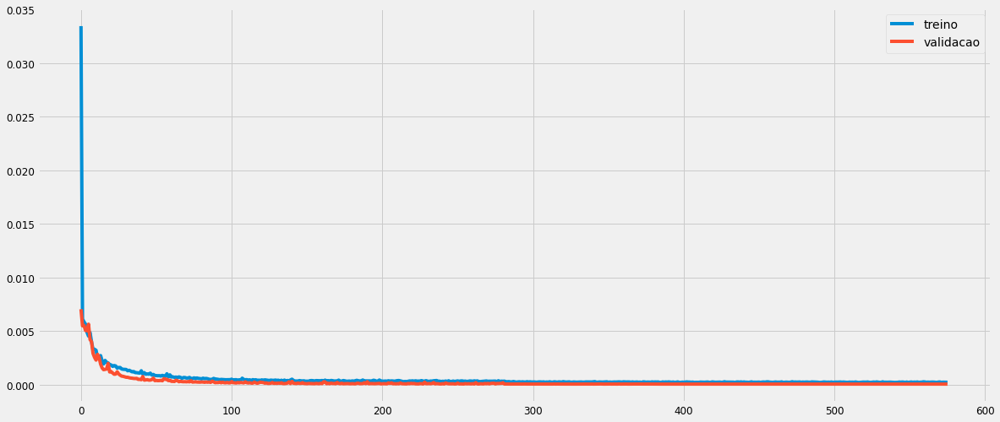

In [550]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [551]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [552]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.7987977 ],
       [0.79569334],
       [0.79084617],
       [0.78232515],
       [0.7725652 ]], dtype=float32)

In [553]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[13386.   ],
       [13342.104],
       [13273.564],
       [13153.077],
       [13015.071]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

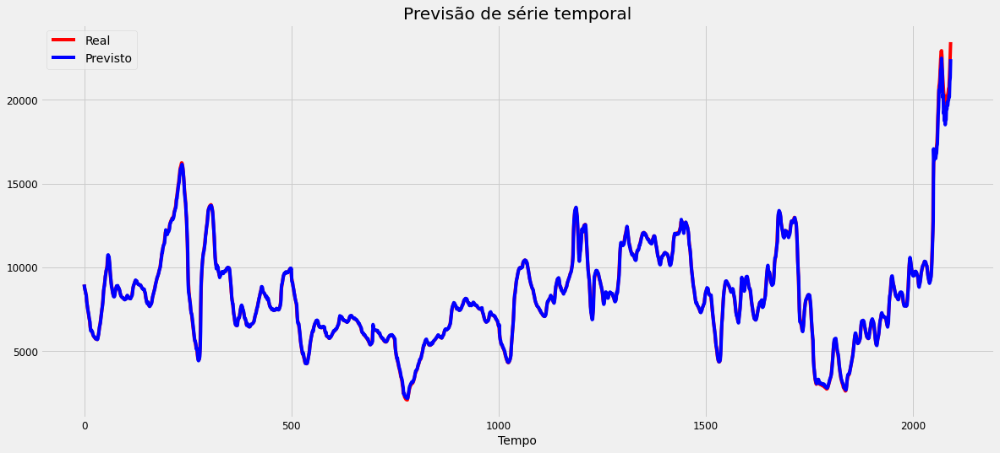

In [554]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

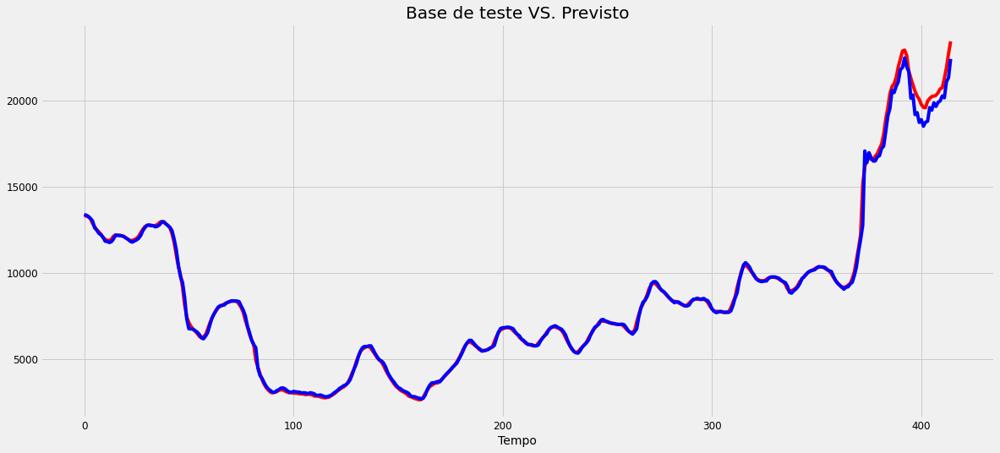

In [555]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [556]:
lstm_s8_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_s8_rmse)
lstm_s8_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_s8_mse)
lstm_s8_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_s8_mape, '%')
lstm_s8_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  285.054510441187
MSE:  81256.07392286479
MAPE:  1.4109061726608028 %
R2:  0.9964439099312966


## S9

### SARIMA

In [557]:
data = baltic.loc[baltic['Route'] == 'S9'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S9'})  
data = data.groupby([pd.Grouper(key='Date', freq='M')]).S9.mean()
data.head()

Date
2013-01-31    5633.454545
2013-02-28    5908.950000
2013-03-31    8763.650000
2013-04-30    9950.714286
2013-05-31    8746.476190
Freq: M, Name: S9, dtype: float64

#### Divisão da base

In [558]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [559]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [560]:
y = data.copy()
y.tail()

Date
2020-12-31     9768.555556
2021-01-31    10526.750000
2021-02-28    14100.100000
2021-03-31    21835.869565
2021-04-30    15629.266667
Freq: M, Name: S9, dtype: float64

#### Exibição da série

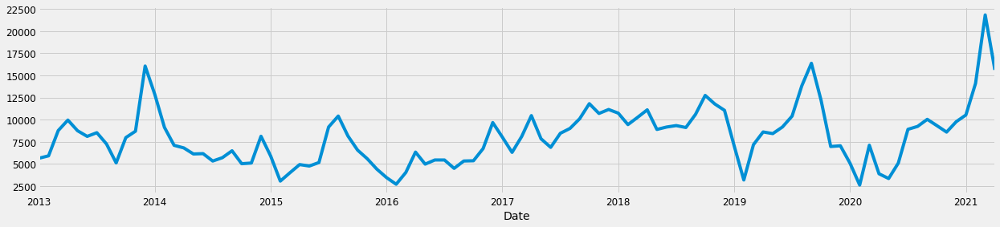

In [561]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

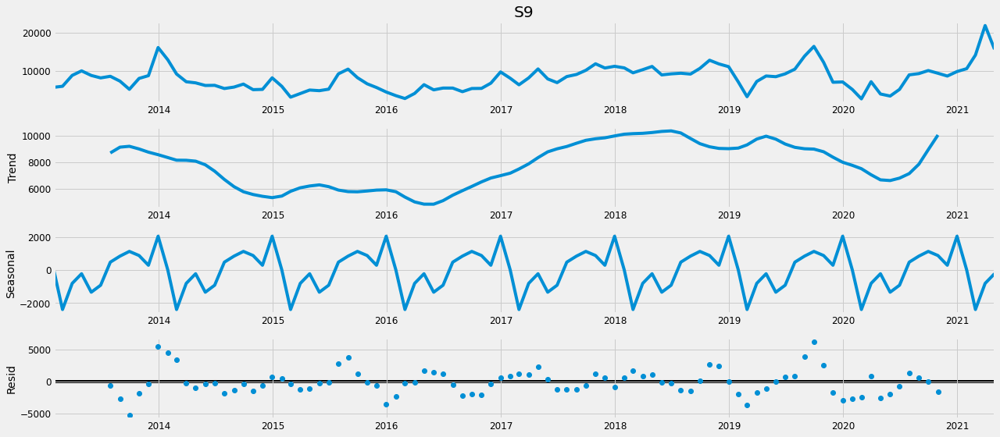

In [562]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [563]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [564]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2079.968001601852
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1792.099557879204
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1695.0121356051375
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1454.787635030017
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1716.860048795349
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1676.9540782599347
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1481.110224790095
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1453.4961849786744
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1989.0919823763577
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1655.852417860601
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1608.6408036260873
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1380.0134913904235
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1643.8059538804068
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1586.6957417155288
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1421.1210369833343
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1374.7338600700912
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1798.10657691653
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1563.5118531842234


#### Ajuste considerando o menor valor de AIC

In [565]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1145      0.417     -0.275      0.783      -0.931       0.702
ma.L1          0.4660      0.405      1.149      0.250      -0.329       1.261
ar.S.L12       0.1788      0.479      0.373      0.709      -0.760       1.118
ma.S.L12      -0.6141      0.440     -1.395      0.163      -1.477       0.249
sigma2      5.217e+06   9.87e+05      5.287      0.000    3.28e+06    7.15e+06


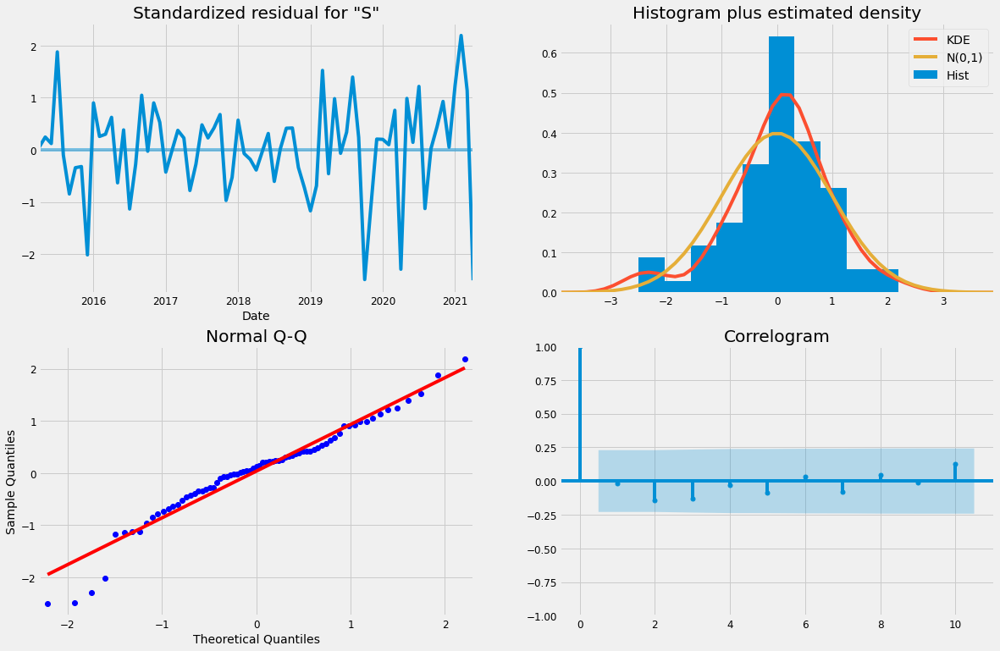

In [566]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

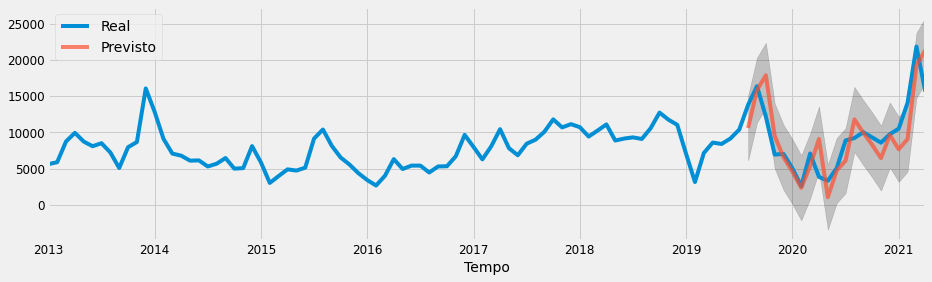

In [567]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [568]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_s9_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_s9_rmse)
sarima_s9_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_s9_mse)
sarima_s9_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_s9_mape, '%')
sarima_s9_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  2909.0840032153496
MSE:  8462769.737763444
MAPE:  27.368001932234122 %
R2:  0.6142610299752863


### LSTM

#### Divisão da base

training_set

In [569]:
temp = baltic.loc[baltic['Route'] == 'S9'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S9'}) 
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,S9
40788,2013-01-02,3938.0
40789,2013-01-03,4078.0
40790,2013-01-04,4194.0
40791,2013-01-07,4371.0
40792,2013-01-08,4593.0


In [570]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[3938.],
       [4078.],
       [4194.],
       [4371.],
       [4593.]])

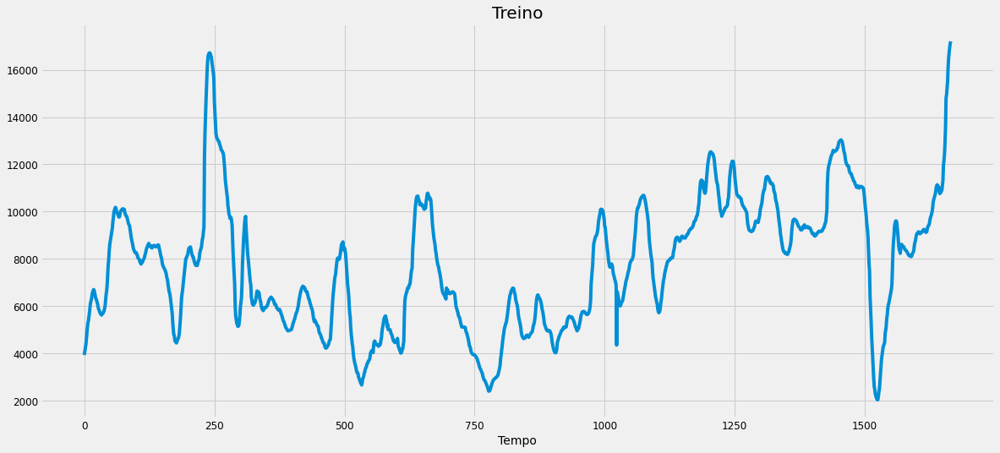

In [571]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [572]:
temp = baltic.loc[baltic['Route'] == 'S9'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S9'}) 
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,S9
42454,2019-09-02,17342.0
42455,2019-09-03,17406.0
42456,2019-09-04,17454.0
42457,2019-09-05,17406.0
42458,2019-09-06,17289.0


In [573]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[17342.],
       [17406.],
       [17454.],
       [17406.],
       [17289.]])

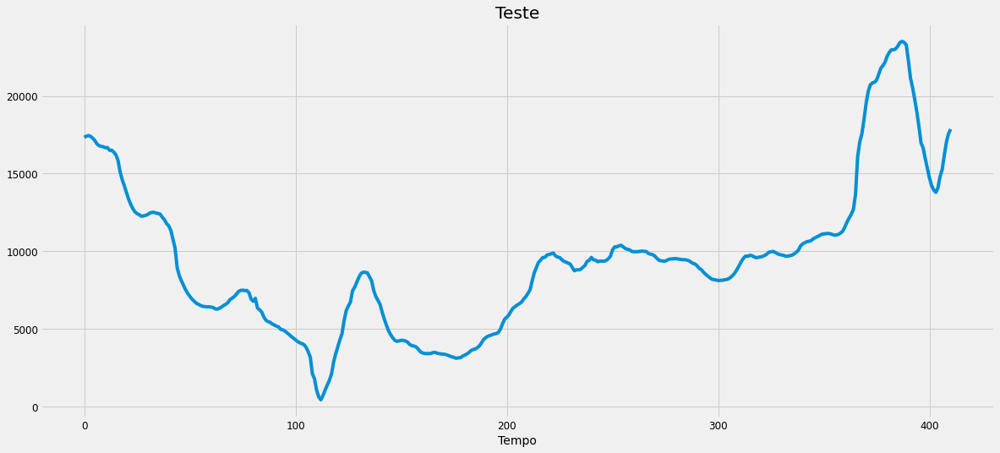

In [574]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [575]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [576]:
training_set_scaled[0:5]

array([[0.12501649],
       [0.13425254],
       [0.14190526],
       [0.15358227],
       [0.168228  ]])

##### Criar a estrutura de dados

In [577]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [578]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.125016,0.134253,0.141905,0.153582,0.168228,0.186634,0.202072,0.214474,0.221071,0.232089
1,0.134253,0.141905,0.153582,0.168228,0.186634,0.202072,0.214474,0.221071,0.232089,0.243832
2,0.141905,0.153582,0.168228,0.186634,0.202072,0.214474,0.221071,0.232089,0.243832,0.258873
3,0.153582,0.168228,0.186634,0.202072,0.214474,0.221071,0.232089,0.243832,0.258873,0.270220
4,0.168228,0.186634,0.202072,0.214474,0.221071,0.232089,0.243832,0.258873,0.270220,0.276818


In [579]:
pd.DataFrame(y_train).head()

,0
0,0.243832
1,0.258873
2,0.270220
3,0.276818
4,0.282689


##### *Reshaping*

In [580]:
X_train.shape

(1656, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [581]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [582]:
X_train.shape

(1656, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [583]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_43 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_43 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_44 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_44 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_45 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_45 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_15 (Dense)             (None, 1)               

###### Treinamento

In [584]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1490 samples, validate on 166 samples
Epoch 1/1000
1490/1490 [==============================] - 2s 1ms/step - loss: 0.0216 - val_loss: 0.0089
Epoch 2/1000
1490/1490 [==============================] - 1s 726us/step - loss: 0.0051 - val_loss: 0.0081
Epoch 3/1000
1490/1490 [==============================] - 1s 741us/step - loss: 0.0047 - val_loss: 0.0076
Epoch 4/1000
1490/1490 [==============================] - 1s 741us/step - loss: 0.0042 - val_loss: 0.0078
Epoch 5/1000
1490/1490 [==============================] - 1s 746us/step - loss: 0.0039 - val_loss: 0.0067
Epoch 6/1000
1490/1490 [==============================] - 1s 749us/step - loss: 0.0040 - val_loss: 0.0074
Epoch 7/1000
1490/1490 [==============================] - 1s 763us/step - loss: 0.0034 - val_loss: 0.0069
Epoch 8/1000
1490/1490 [==============================] - 1s 743us/step - loss: 0.0029 - val_loss: 0.0049
Epoch 9/1000
1490/1490 [==============================] - 1s 736us/step - loss: 0.0027 - val_loss: 0.0033
E

Epoch 74/1000
1490/1490 [==============================] - 1s 724us/step - loss: 5.7157e-04 - val_loss: 3.1705e-04
Epoch 75/1000
1490/1490 [==============================] - 1s 722us/step - loss: 5.9025e-04 - val_loss: 4.6790e-04
Epoch 76/1000
1490/1490 [==============================] - 1s 719us/step - loss: 5.5486e-04 - val_loss: 3.0547e-04
Epoch 77/1000
1490/1490 [==============================] - 1s 723us/step - loss: 5.4267e-04 - val_loss: 4.3277e-04
Epoch 78/1000
1490/1490 [==============================] - 1s 720us/step - loss: 5.3632e-04 - val_loss: 3.1383e-04
Epoch 79/1000
1490/1490 [==============================] - 1s 727us/step - loss: 5.5117e-04 - val_loss: 2.8486e-04
Epoch 80/1000
1490/1490 [==============================] - 1s 724us/step - loss: 5.2617e-04 - val_loss: 2.6191e-04
Epoch 81/1000
1490/1490 [==============================] - 1s 725us/step - loss: 5.3982e-04 - val_loss: 2.7654e-04
Epoch 82/1000
1490/1490 [==============================] - 1s 721us/step - loss:

Epoch 145/1000
1490/1490 [==============================] - 1s 738us/step - loss: 4.3543e-04 - val_loss: 2.6708e-04
Epoch 146/1000
1490/1490 [==============================] - 1s 723us/step - loss: 4.3550e-04 - val_loss: 1.9550e-04
Epoch 147/1000
1490/1490 [==============================] - 1s 738us/step - loss: 4.1309e-04 - val_loss: 1.5269e-04
Epoch 148/1000
1490/1490 [==============================] - 1s 740us/step - loss: 3.9602e-04 - val_loss: 1.5225e-04
Epoch 149/1000
1490/1490 [==============================] - 1s 728us/step - loss: 4.4935e-04 - val_loss: 1.7214e-04
Epoch 150/1000
1490/1490 [==============================] - 1s 729us/step - loss: 4.2002e-04 - val_loss: 2.7765e-04
Epoch 151/1000
1490/1490 [==============================] - 1s 723us/step - loss: 4.3321e-04 - val_loss: 3.0302e-04
Epoch 152/1000
1490/1490 [==============================] - 1s 723us/step - loss: 4.4235e-04 - val_loss: 3.2578e-04
Epoch 153/1000
1490/1490 [==============================] - 1s 725us/ste

1490/1490 [==============================] - 1s 852us/step - loss: 3.1644e-04 - val_loss: 1.4150e-04
Epoch 216/1000
1490/1490 [==============================] - 1s 842us/step - loss: 3.0343e-04 - val_loss: 1.5216e-04
Epoch 217/1000
1490/1490 [==============================] - 1s 850us/step - loss: 3.2326e-04 - val_loss: 1.4278e-04
Epoch 218/1000
1490/1490 [==============================] - 1s 857us/step - loss: 3.3083e-04 - val_loss: 1.4221e-04
Epoch 219/1000
1490/1490 [==============================] - 1s 829us/step - loss: 3.4692e-04 - val_loss: 1.3689e-04
Epoch 220/1000
1490/1490 [==============================] - 1s 871us/step - loss: 3.2322e-04 - val_loss: 1.5703e-04
Epoch 221/1000
1490/1490 [==============================] - 1s 838us/step - loss: 3.2307e-04 - val_loss: 1.5236e-04
Epoch 222/1000
1490/1490 [==============================] - 1s 826us/step - loss: 3.1758e-04 - val_loss: 1.4584e-04
Epoch 223/1000
1490/1490 [==============================] - 1s 826us/step - loss: 3.200

Epoch 286/1000
1490/1490 [==============================] - 1s 866us/step - loss: 3.1623e-04 - val_loss: 1.4527e-04
Epoch 287/1000
1490/1490 [==============================] - 1s 866us/step - loss: 3.3774e-04 - val_loss: 1.4474e-04
Epoch 288/1000
1490/1490 [==============================] - 1s 922us/step - loss: 3.0554e-04 - val_loss: 1.4328e-04
Epoch 289/1000
1490/1490 [==============================] - 1s 891us/step - loss: 3.0978e-04 - val_loss: 1.3165e-04
Epoch 290/1000
1490/1490 [==============================] - 1s 840us/step - loss: 3.0154e-04 - val_loss: 1.4946e-04
Epoch 291/1000
1490/1490 [==============================] - 1s 888us/step - loss: 3.3477e-04 - val_loss: 1.2852e-04
Epoch 292/1000
1490/1490 [==============================] - 1s 859us/step - loss: 3.0671e-04 - val_loss: 1.3512e-04
Epoch 293/1000
1490/1490 [==============================] - 1s 840us/step - loss: 3.1927e-04 - val_loss: 1.3815e-04
Epoch 294/1000
1490/1490 [==============================] - 1s 848us/ste

1490/1490 [==============================] - 1s 829us/step - loss: 2.7481e-04 - val_loss: 1.3202e-04
Epoch 357/1000
1490/1490 [==============================] - 1s 832us/step - loss: 2.7694e-04 - val_loss: 1.3749e-04
Epoch 358/1000
1490/1490 [==============================] - 1s 830us/step - loss: 2.9162e-04 - val_loss: 1.3100e-04
Epoch 359/1000
1490/1490 [==============================] - 1s 846us/step - loss: 3.0441e-04 - val_loss: 1.3115e-04
Epoch 360/1000
1490/1490 [==============================] - 1s 850us/step - loss: 2.9279e-04 - val_loss: 1.3195e-04
Epoch 361/1000
1490/1490 [==============================] - 1s 826us/step - loss: 3.0258e-04 - val_loss: 1.3503e-04
Epoch 362/1000
1490/1490 [==============================] - 1s 844us/step - loss: 2.9403e-04 - val_loss: 1.2961e-04
Epoch 363/1000
1490/1490 [==============================] - 1s 930us/step - loss: 3.1137e-04 - val_loss: 1.3143e-04
Epoch 364/1000
1490/1490 [==============================] - 1s 909us/step - loss: 2.982

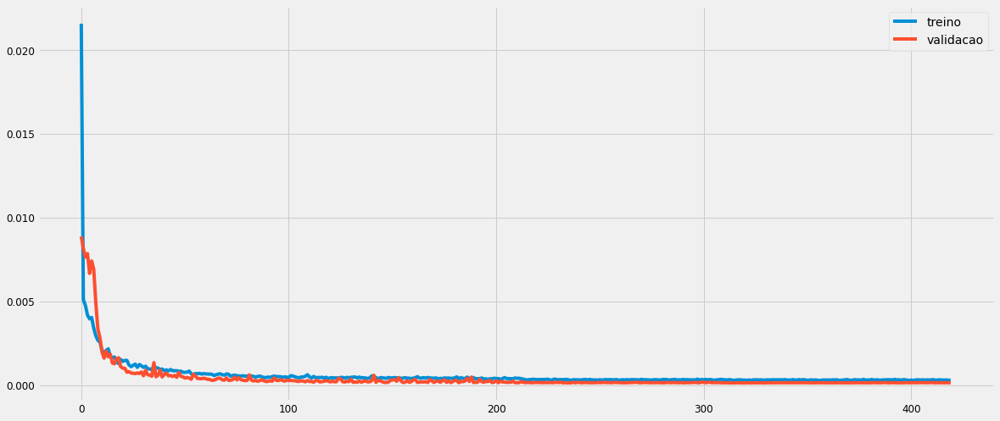

In [585]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [586]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [587]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.98840845],
       [0.99784005],
       [0.99814284],
       [1.0005182 ],
       [0.99438167]], dtype=float32)

In [588]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[17025.295],
       [17168.26 ],
       [17172.85 ],
       [17208.855],
       [17115.836]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

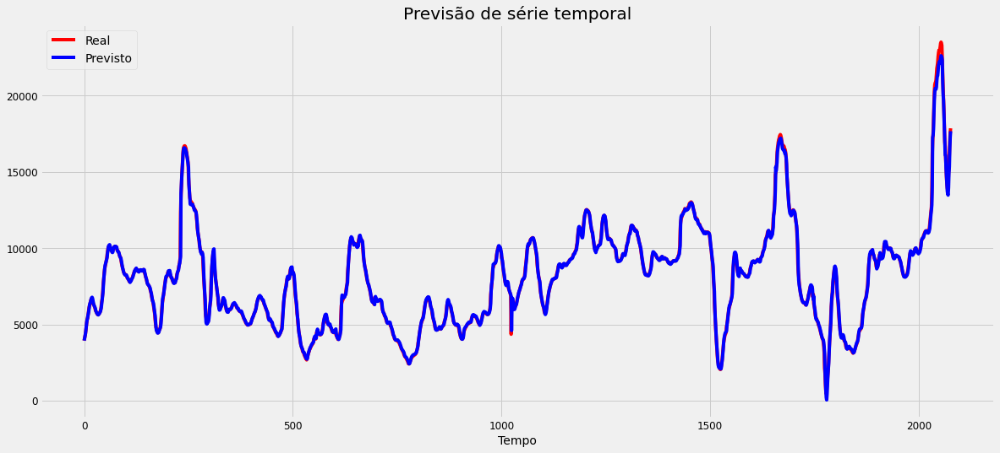

In [589]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

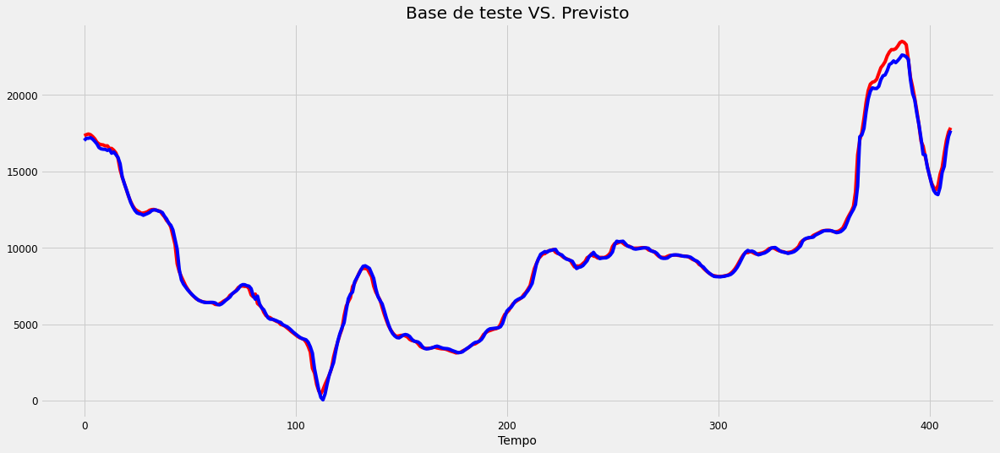

In [590]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [591]:
lstm_s9_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_s9_rmse)
lstm_s9_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_s9_mse)
lstm_s9_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_s9_mape, '%')
lstm_s9_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  267.7331145052259
MSE:  71681.0206026684
MAPE:  2.2342812052505137 %
R2:  0.9969726039405502


## S10

### SARIMA

In [592]:
data = baltic.loc[baltic['Route'] == 'S10'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S10'})  
data = data.groupby([pd.Grouper(key='Date', freq='M')]).S10.mean()
data.head()

Date
2013-01-31    4482.772727
2013-02-28    3883.350000
2013-03-31    6451.450000
2013-04-30    5977.761905
2013-05-31    5406.904762
Freq: M, Name: S10, dtype: float64

#### Divisão da base

In [593]:
# Início da série
straining = data.index[0]
straining

Timestamp('2013-01-31 00:00:00', freq='M')

In [594]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-08-31 00:00:00', freq='M')

In [595]:
y = data.copy()
y.tail()

Date
2020-12-31    10796.055556
2021-01-31    10912.600000
2021-02-28    13019.600000
2021-03-31    23392.652174
2021-04-30    22513.875000
Freq: M, Name: S10, dtype: float64

#### Exibição da série

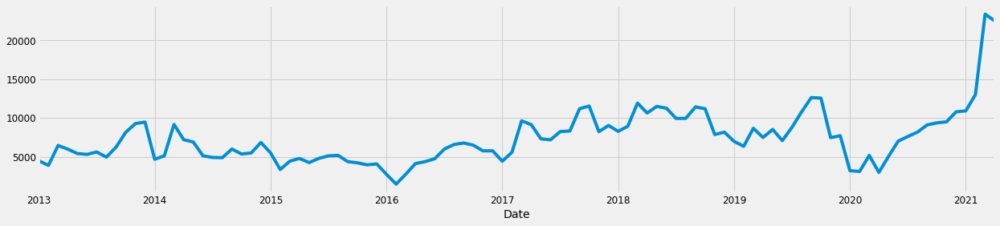

In [596]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

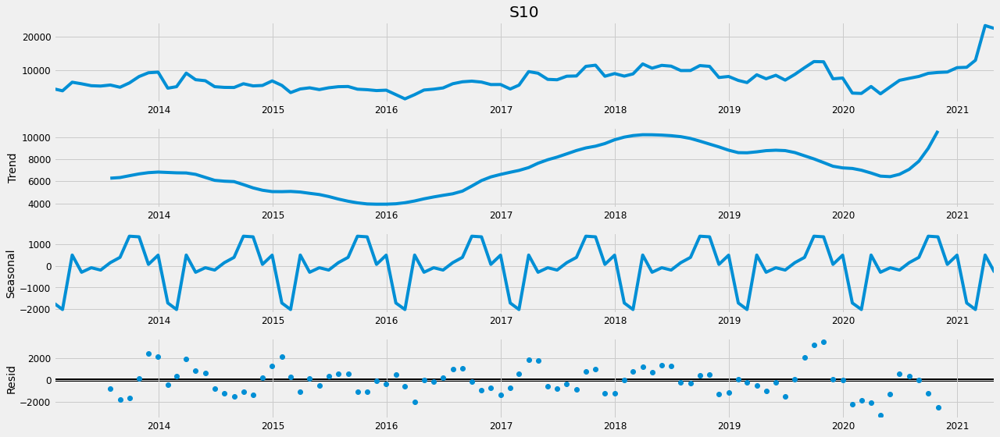

In [597]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [598]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [599]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2065.7699425556243
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1785.566620481989
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1694.2712581823369
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1467.4725161942813
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1714.709173180521
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1681.9446335150099
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1487.361372512627
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1462.2622154236046
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1974.8050654365404
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1724.687619581909
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1596.0977548045767
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1385.6997218238944
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1635.3947893011282
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1573.4429118513428
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1414.9148971012983
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1370.884872516366
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1760.7272816467723
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1533.68810339399

#### Ajuste considerando o menor valor de AIC

In [600]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4246      0.603      0.704      0.481      -0.757       1.606
ma.L1         -0.2246      0.682     -0.330      0.742      -1.561       1.111
ar.S.L12      -0.0301      0.315     -0.096      0.924      -0.647       0.586
ma.S.L12      -0.6686      0.212     -3.155      0.002      -1.084      -0.253
sigma2       2.51e+06   3.31e+05      7.593      0.000    1.86e+06    3.16e+06


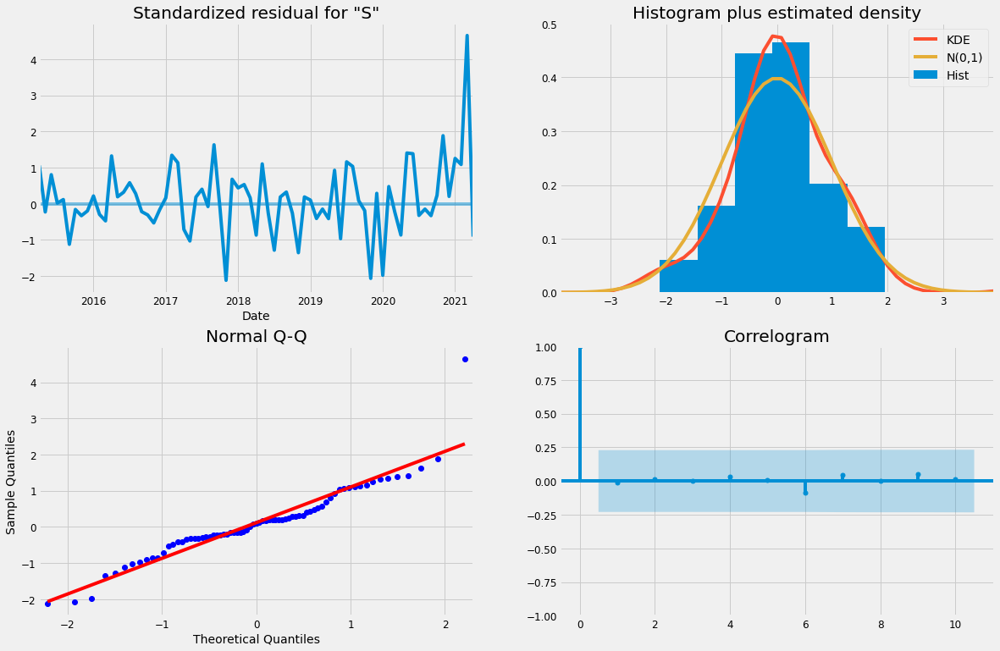

In [601]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

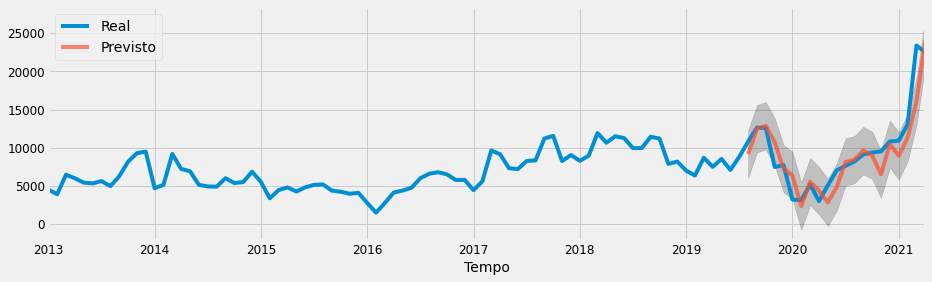

In [602]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [603]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_s10_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_s10_rmse)
sarima_s10_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_s10_mse)
sarima_s10_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_s10_mape, '%')
sarima_s10_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  2278.0605078948274
MSE:  5189559.677630039
MAPE:  21.062070600624438 %
R2:  0.8120394865475677


### LSTM

#### Divisão da base

training_set

In [604]:
temp = baltic.loc[baltic['Route'] == 'S10'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S10'}) 
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,S10
42865,2013-01-02,5425.0
42866,2013-01-03,5294.0
42867,2013-01-04,5173.0
42868,2013-01-07,5116.0
42869,2013-01-08,5025.0


In [605]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[5425.],
       [5294.],
       [5173.],
       [5116.],
       [5025.]])

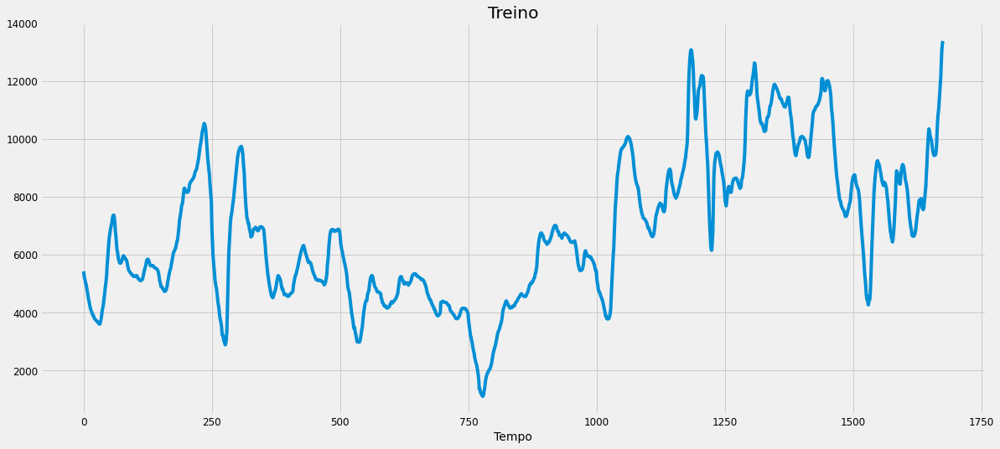

In [606]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [607]:
temp = baltic.loc[baltic['Route'] == 'S10'].copy().drop(columns=['Route']).rename(columns = {'USD': 'S10'}) 
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,S10
44540,2019-09-02,13428.0
44541,2019-09-03,13400.0
44542,2019-09-04,13328.0
44543,2019-09-05,13228.0
44544,2019-09-06,13022.0


In [608]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[13428.],
       [13400.],
       [13328.],
       [13228.],
       [13022.]])

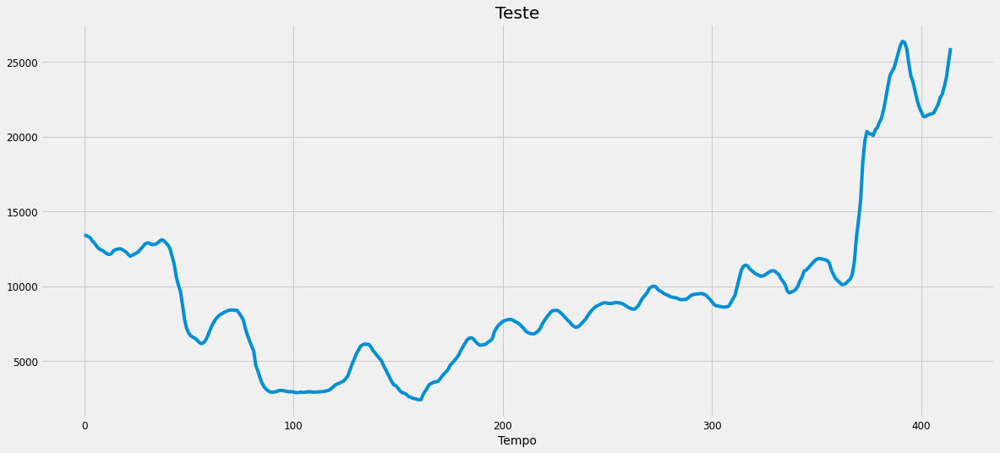

In [609]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [610]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [611]:
training_set_scaled[0:5]

array([[0.35178252],
       [0.34111997],
       [0.33127137],
       [0.32663194],
       [0.31922513]])

In [612]:
pd.DataFrame(y_train).head()

,0
0,0.243832
1,0.258873
2,0.270220
3,0.276818
4,0.282689


##### *Reshaping*

In [613]:
X_train.shape

(1656, 10, 1)

Shape de input da lstm = (batch_size, timesteps, features)

In [614]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [615]:
X_train.shape

(1656, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [616]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_46 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_46 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_47 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_47 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_48 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_48 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_16 (Dense)             (None, 1)               

###### Treinamento

In [617]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1490 samples, validate on 166 samples
Epoch 1/1000
1490/1490 [==============================] - 2s 2ms/step - loss: 0.0215 - val_loss: 0.0097
Epoch 2/1000
1490/1490 [==============================] - 1s 814us/step - loss: 0.0052 - val_loss: 0.0090
Epoch 3/1000
1490/1490 [==============================] - 1s 783us/step - loss: 0.0047 - val_loss: 0.0085
Epoch 4/1000
1490/1490 [==============================] - 1s 785us/step - loss: 0.0041 - val_loss: 0.0072
Epoch 5/1000
1490/1490 [==============================] - 1s 762us/step - loss: 0.0040 - val_loss: 0.0070
Epoch 6/1000
1490/1490 [==============================] - 1s 771us/step - loss: 0.0033 - val_loss: 0.0059
Epoch 7/1000
1490/1490 [==============================] - 1s 757us/step - loss: 0.0032 - val_loss: 0.0047
Epoch 8/1000
1490/1490 [==============================] - 1s 760us/step - loss: 0.0029 - val_loss: 0.0042
Epoch 9/1000
1490/1490 [==============================] - 1s 765us/step - loss: 0.0031 - val_loss: 0.0040
E

Epoch 74/1000
1490/1490 [==============================] - 1s 901us/step - loss: 6.0305e-04 - val_loss: 4.0674e-04
Epoch 75/1000
1490/1490 [==============================] - 1s 925us/step - loss: 5.4288e-04 - val_loss: 4.3614e-04
Epoch 76/1000
1490/1490 [==============================] - 1s 960us/step - loss: 5.4525e-04 - val_loss: 3.3273e-04
Epoch 77/1000
1490/1490 [==============================] - 1s 942us/step - loss: 6.0818e-04 - val_loss: 3.0149e-04
Epoch 78/1000
1490/1490 [==============================] - 1s 910us/step - loss: 5.8373e-04 - val_loss: 4.7820e-04
Epoch 79/1000
1490/1490 [==============================] - 1s 920us/step - loss: 5.8217e-04 - val_loss: 3.3690e-04
Epoch 80/1000
1490/1490 [==============================] - 1s 922us/step - loss: 5.2357e-04 - val_loss: 5.2130e-04
Epoch 81/1000
1490/1490 [==============================] - 1s 915us/step - loss: 5.3709e-04 - val_loss: 7.6501e-04
Epoch 82/1000
1490/1490 [==============================] - 1s 890us/step - loss:

Epoch 145/1000
1490/1490 [==============================] - 1s 901us/step - loss: 4.6038e-04 - val_loss: 2.2767e-04
Epoch 146/1000
1490/1490 [==============================] - 1s 945us/step - loss: 4.3272e-04 - val_loss: 3.9318e-04
Epoch 147/1000
1490/1490 [==============================] - 1s 951us/step - loss: 3.9409e-04 - val_loss: 2.2018e-04
Epoch 148/1000
1490/1490 [==============================] - 1s 919us/step - loss: 4.4229e-04 - val_loss: 2.3054e-04
Epoch 149/1000
1490/1490 [==============================] - 1s 888us/step - loss: 3.9605e-04 - val_loss: 1.6321e-04
Epoch 150/1000
1490/1490 [==============================] - 1s 887us/step - loss: 4.2387e-04 - val_loss: 2.0567e-04
Epoch 151/1000
1490/1490 [==============================] - 1s 870us/step - loss: 4.2906e-04 - val_loss: 1.5088e-04
Epoch 152/1000
1490/1490 [==============================] - 1s 874us/step - loss: 3.9017e-04 - val_loss: 2.0818e-04
Epoch 153/1000
1490/1490 [==============================] - 1s 878us/ste

1490/1490 [==============================] - 1s 863us/step - loss: 3.7022e-04 - val_loss: 1.6784e-04
Epoch 216/1000
1490/1490 [==============================] - 1s 857us/step - loss: 3.5007e-04 - val_loss: 3.2144e-04
Epoch 217/1000
1490/1490 [==============================] - 1s 883us/step - loss: 4.2583e-04 - val_loss: 2.1653e-04
Epoch 218/1000
1490/1490 [==============================] - 1s 900us/step - loss: 3.5877e-04 - val_loss: 1.7189e-04
Epoch 219/1000
1490/1490 [==============================] - 1s 906us/step - loss: 3.5383e-04 - val_loss: 2.2243e-04
Epoch 220/1000
1490/1490 [==============================] - 1s 858us/step - loss: 3.8139e-04 - val_loss: 2.8313e-04
Epoch 221/1000
1490/1490 [==============================] - 1s 863us/step - loss: 3.7497e-04 - val_loss: 2.1384e-04
Epoch 222/1000
1490/1490 [==============================] - 1s 871us/step - loss: 3.9121e-04 - val_loss: 1.7829e-04
Epoch 223/1000
1490/1490 [==============================] - 1s 857us/step - loss: 4.095

Epoch 286/1000
1490/1490 [==============================] - 1s 865us/step - loss: 2.9616e-04 - val_loss: 1.7895e-04
Epoch 287/1000
1490/1490 [==============================] - 1s 865us/step - loss: 2.7778e-04 - val_loss: 1.6063e-04
Epoch 288/1000
1490/1490 [==============================] - 1s 862us/step - loss: 3.1063e-04 - val_loss: 1.4301e-04
Epoch 289/1000
1490/1490 [==============================] - 1s 861us/step - loss: 3.1302e-04 - val_loss: 1.3780e-04
Epoch 290/1000
1490/1490 [==============================] - 1s 883us/step - loss: 3.1593e-04 - val_loss: 1.6507e-04
Epoch 291/1000
1490/1490 [==============================] - 1s 914us/step - loss: 3.1719e-04 - val_loss: 1.5178e-04
Epoch 292/1000
1490/1490 [==============================] - 1s 918us/step - loss: 3.0389e-04 - val_loss: 1.6877e-04
Epoch 293/1000
1490/1490 [==============================] - 1s 865us/step - loss: 3.0739e-04 - val_loss: 1.5685e-04
Epoch 294/1000
1490/1490 [==============================] - 1s 865us/ste

1490/1490 [==============================] - 1s 868us/step - loss: 3.2429e-04 - val_loss: 1.4774e-04
Epoch 357/1000
1490/1490 [==============================] - 1s 863us/step - loss: 2.6107e-04 - val_loss: 1.4557e-04
Epoch 358/1000
1490/1490 [==============================] - 1s 858us/step - loss: 2.9977e-04 - val_loss: 1.4721e-04
Epoch 359/1000
1490/1490 [==============================] - 1s 859us/step - loss: 3.2675e-04 - val_loss: 1.3714e-04
Epoch 360/1000
1490/1490 [==============================] - 1s 861us/step - loss: 3.1724e-04 - val_loss: 1.4663e-04
Epoch 361/1000
1490/1490 [==============================] - 1s 867us/step - loss: 3.2843e-04 - val_loss: 1.3939e-04
Epoch 362/1000
1490/1490 [==============================] - 1s 874us/step - loss: 3.0953e-04 - val_loss: 1.3985e-04
Epoch 363/1000
1490/1490 [==============================] - 1s 893us/step - loss: 3.0889e-04 - val_loss: 1.3858e-04
Epoch 364/1000
1490/1490 [==============================] - 1s 921us/step - loss: 2.679

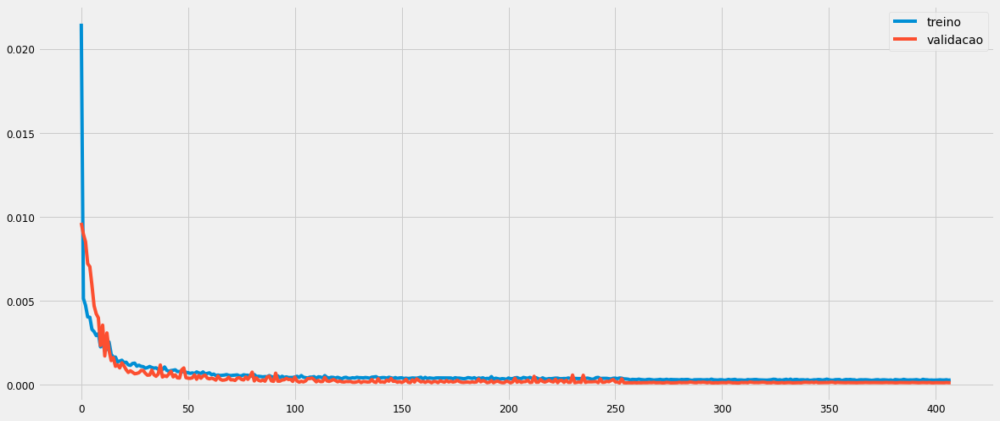

In [618]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [619]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [620]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.9922184 ],
       [0.99026906],
       [0.98371494],
       [0.9751142 ],
       [0.9648473 ]], dtype=float32)

In [621]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[13293.3955],
       [13269.446 ],
       [13188.922 ],
       [13083.254 ],
       [12957.114 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

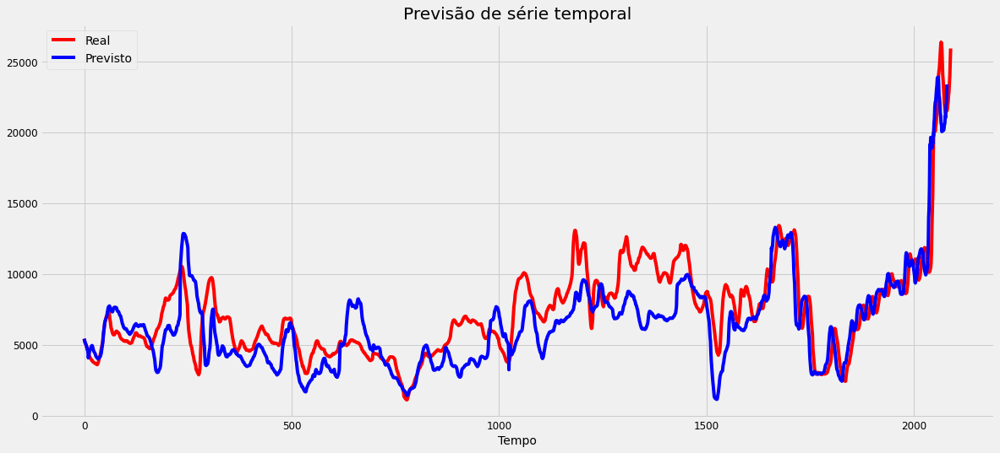

In [622]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

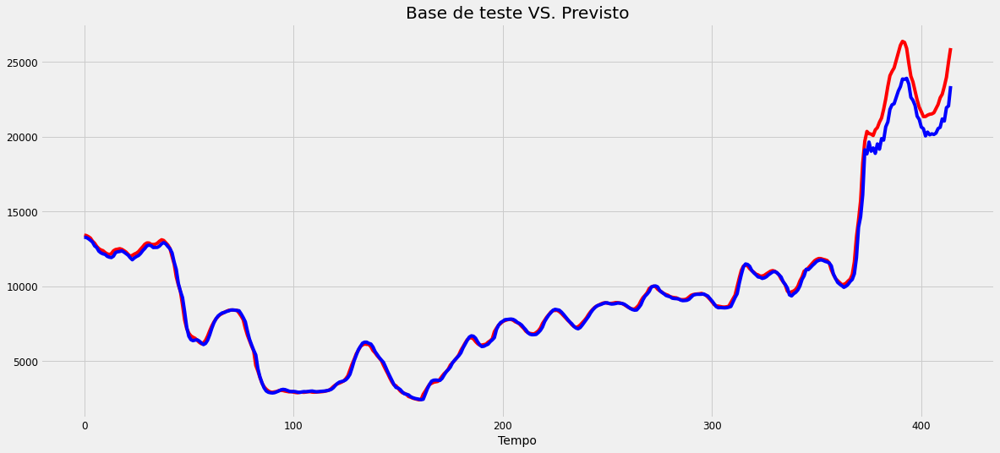

In [623]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [624]:
lstm_s10_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_s10_rmse)
lstm_s10_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_s10_mse)
lstm_s10_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_s10_mape, '%')
lstm_s10_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  603.1472867146582
MSE:  363786.6494712541
MAPE:  2.1117739497520804 %
R2:  0.9876707247193972


## P1A_82

### SARIMA

In [625]:
data = baltic.loc[baltic['Route'] == 'P1A_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P1A_82'})  
data = data.groupby([pd.Grouper(key='Date', freq='M')]).P1A_82.mean()
data.head()

Date
2014-01-31    14606.227273
2014-02-28     8965.800000
2014-03-31     5364.571429
2014-04-30     3218.700000
2014-05-31     6584.500000
Freq: M, Name: P1A_82, dtype: float64

#### Divisão da base

In [626]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-01-31 00:00:00', freq='M')

In [627]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-10-31 00:00:00', freq='M')

In [628]:
y = data.copy()
y.tail()

Date
2020-12-31    13761.555556
2021-01-31    15186.250000
2021-02-28    19777.000000
2021-03-31    18533.391304
2021-04-30    16117.733333
Freq: M, Name: P1A_82, dtype: float64

#### Exibição da série

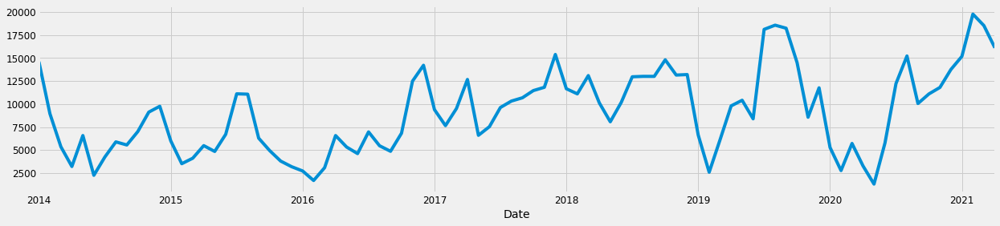

In [629]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

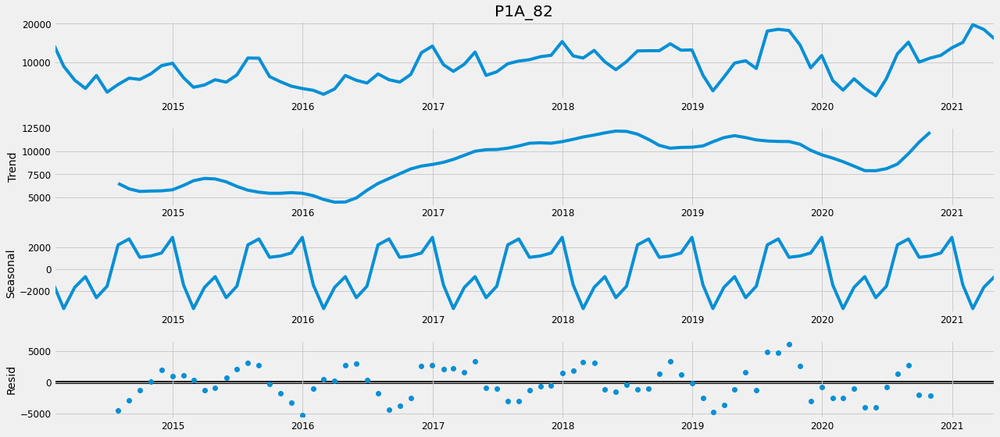

In [630]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [631]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [632]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1852.143912973084
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1556.4380178122028
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1500.087662635196
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1260.4896965616165
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1523.1599194996636
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1493.4213639790921
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1281.960596718433
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1262.3094980019043
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1787.3179931560244
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1517.8687760254677
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1440.5171923632138
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1203.370261128786
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1569.9595084575167
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1528.0240493575375
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1239.9136766563374
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1205.120567099848
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1624.6320742072069
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1398.60643152132

#### Ajuste considerando o menor valor de AIC

In [633]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.8493      0.115     -7.400      0.000      -1.074      -0.624
ma.L1          0.9810      0.215      4.558      0.000       0.559       1.403
ar.S.L12      -0.1376      0.309     -0.445      0.656      -0.744       0.469
ma.S.L12      -0.4958      0.235     -2.114      0.034      -0.955      -0.036
sigma2      1.243e+07    1.4e-08   8.85e+14      0.000    1.24e+07    1.24e+07


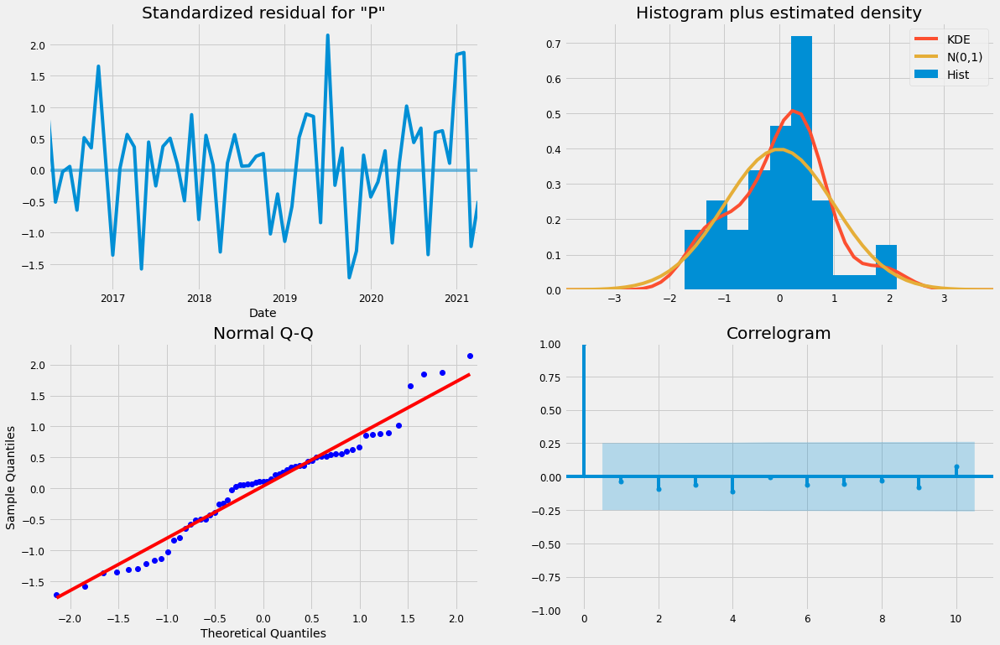

In [634]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

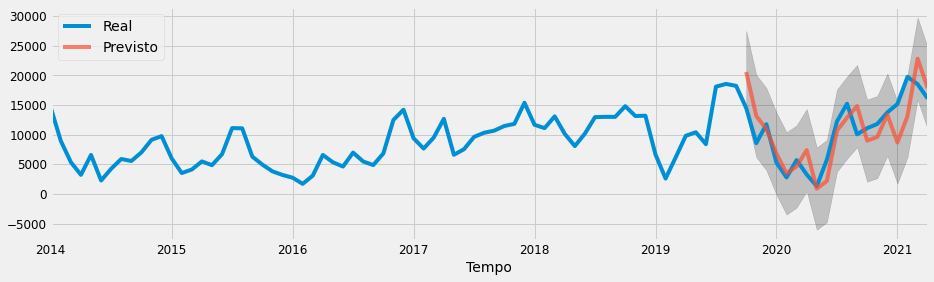

In [635]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [636]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_p1a82_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_p1a82_rmse)
sarima_p1a82_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_p1a82_mse)
sarima_p1a82_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_p1a82_mape, '%')
sarima_p1a82_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  3561.574831639864
MSE:  12684815.281370526
MAPE:  32.68643077858385 %
R2:  0.5467191964196934


### LSTM

#### Divisão da base

training_set

In [637]:
temp = baltic.loc[baltic['Route'] == 'P1A_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P1A_82'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,P1A_82
17868,2014-01-02,17843.0
17869,2014-01-03,17600.0
17870,2014-01-06,17308.0
17871,2014-01-07,16964.0
17872,2014-01-08,16711.0


In [638]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[17843.],
       [17600.],
       [17308.],
       [16964.],
       [16711.]])

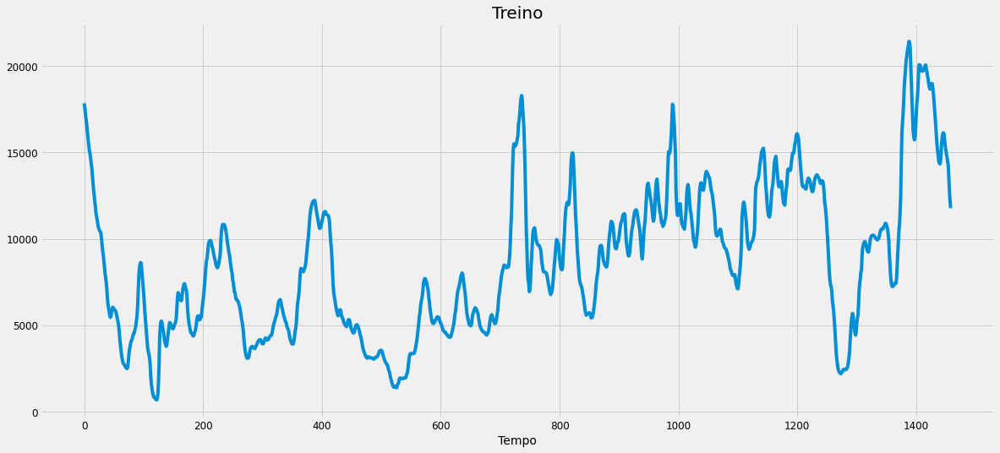

In [639]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [640]:
temp = baltic.loc[baltic['Route'] == 'P1A_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P1A_82'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,P1A_82
19327,2019-10-31,11425.0
19328,2019-11-01,11050.0
19329,2019-11-04,10595.0
19330,2019-11-05,10055.0
19331,2019-11-06,9410.0


In [641]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[11425.],
       [11050.],
       [10595.],
       [10055.],
       [ 9410.]])

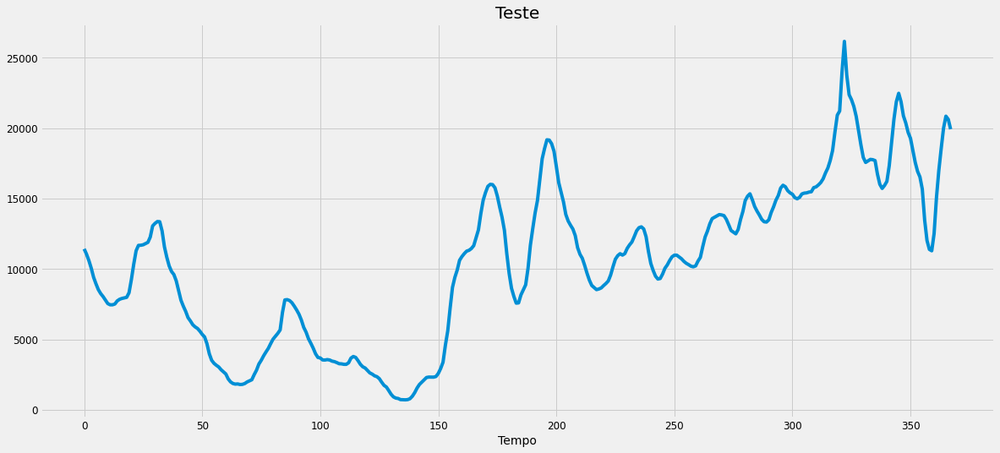

In [642]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [643]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [644]:
training_set_scaled[0:5]

array([[0.82704918],
       [0.81533269],
       [0.80125362],
       [0.78466731],
       [0.77246866]])

##### Criar a estrutura de dados

In [645]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [646]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.827049,0.815333,0.801254,0.784667,0.772469,0.753857,0.736451,0.720106,0.705641,0.693587
1,0.815333,0.801254,0.784667,0.772469,0.753857,0.736451,0.720106,0.705641,0.693587,0.684137
2,0.801254,0.784667,0.772469,0.753857,0.736451,0.720106,0.705641,0.693587,0.684137,0.671360
3,0.784667,0.772469,0.753857,0.736451,0.720106,0.705641,0.693587,0.684137,0.671360,0.657763
4,0.772469,0.753857,0.736451,0.720106,0.705641,0.693587,0.684137,0.671360,0.657763,0.644166


In [647]:
pd.DataFrame(y_train).head()

,0
0,0.684137
1,0.671360
2,0.657763
3,0.644166
4,0.622806


##### *Reshaping*

In [648]:
X_train.shape

(1449, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [649]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [650]:
X_train.shape

(1449, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [651]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_49 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_49 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_50 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_50 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_51 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_51 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_17 (Dense)             (None, 1)               

###### Treinamento

In [652]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1304 samples, validate on 145 samples
Epoch 1/1000
1304/1304 [==============================] - 2s 2ms/step - loss: 0.0209 - val_loss: 0.0181
Epoch 2/1000
1304/1304 [==============================] - 1s 825us/step - loss: 0.0070 - val_loss: 0.0135
Epoch 3/1000
1304/1304 [==============================] - 1s 851us/step - loss: 0.0072 - val_loss: 0.0114
Epoch 4/1000
1304/1304 [==============================] - 1s 939us/step - loss: 0.0063 - val_loss: 0.0091
Epoch 5/1000
1304/1304 [==============================] - 1s 991us/step - loss: 0.0059 - val_loss: 0.0126
Epoch 6/1000
1304/1304 [==============================] - 1s 1ms/step - loss: 0.0050 - val_loss: 0.0095
Epoch 7/1000
1304/1304 [==============================] - 1s 1ms/step - loss: 0.0047 - val_loss: 0.0211
Epoch 8/1000
1304/1304 [==============================] - 1s 979us/step - loss: 0.0041 - val_loss: 0.0045
Epoch 9/1000
1304/1304 [==============================] - 1s 955us/step - loss: 0.0034 - val_loss: 0.0045
Epoch

1304/1304 [==============================] - 1s 874us/step - loss: 5.9796e-04 - val_loss: 3.3085e-04
Epoch 75/1000
1304/1304 [==============================] - 1s 875us/step - loss: 5.6214e-04 - val_loss: 3.5652e-04
Epoch 76/1000
1304/1304 [==============================] - 1s 870us/step - loss: 5.6161e-04 - val_loss: 4.0113e-04
Epoch 77/1000
1304/1304 [==============================] - 1s 873us/step - loss: 5.5482e-04 - val_loss: 2.8966e-04
Epoch 78/1000
1304/1304 [==============================] - 1s 921us/step - loss: 5.2192e-04 - val_loss: 4.0649e-04
Epoch 79/1000
1304/1304 [==============================] - 1s 897us/step - loss: 5.1265e-04 - val_loss: 2.2446e-04
Epoch 80/1000
1304/1304 [==============================] - 1s 917us/step - loss: 5.6162e-04 - val_loss: 3.8146e-04
Epoch 81/1000
1304/1304 [==============================] - 1s 870us/step - loss: 5.7212e-04 - val_loss: 2.4478e-04
Epoch 82/1000
1304/1304 [==============================] - 1s 874us/step - loss: 5.1564e-04 - 

1304/1304 [==============================] - 1s 873us/step - loss: 3.7791e-04 - val_loss: 1.8516e-04
Epoch 146/1000
1304/1304 [==============================] - 1s 863us/step - loss: 3.6804e-04 - val_loss: 1.6736e-04
Epoch 147/1000
1304/1304 [==============================] - 1s 883us/step - loss: 3.8574e-04 - val_loss: 4.7391e-04
Epoch 148/1000
1304/1304 [==============================] - 1s 914us/step - loss: 4.5274e-04 - val_loss: 5.0491e-04
Epoch 149/1000
1304/1304 [==============================] - 1s 908us/step - loss: 3.9884e-04 - val_loss: 2.2746e-04
Epoch 150/1000
1304/1304 [==============================] - 1s 884us/step - loss: 3.5884e-04 - val_loss: 2.9979e-04
Epoch 151/1000
1304/1304 [==============================] - 1s 870us/step - loss: 3.8753e-04 - val_loss: 2.0272e-04
Epoch 152/1000
1304/1304 [==============================] - 1s 862us/step - loss: 3.5287e-04 - val_loss: 1.6297e-04
Epoch 153/1000
1304/1304 [==============================] - 1s 866us/step - loss: 4.287

Epoch 216/1000
1304/1304 [==============================] - 1s 880us/step - loss: 2.7959e-04 - val_loss: 2.8371e-04
Epoch 217/1000
1304/1304 [==============================] - 1s 922us/step - loss: 2.9425e-04 - val_loss: 2.7605e-04
Epoch 218/1000
1304/1304 [==============================] - 1s 904us/step - loss: 2.9871e-04 - val_loss: 3.8243e-04
Epoch 219/1000
1304/1304 [==============================] - 1s 943us/step - loss: 3.0846e-04 - val_loss: 2.5667e-04
Epoch 220/1000
1304/1304 [==============================] - 1s 878us/step - loss: 3.0533e-04 - val_loss: 2.4033e-04
Epoch 221/1000
1304/1304 [==============================] - 1s 881us/step - loss: 3.1736e-04 - val_loss: 2.4970e-04
Epoch 222/1000
1304/1304 [==============================] - 1s 879us/step - loss: 2.8483e-04 - val_loss: 1.6822e-04
Epoch 223/1000
1304/1304 [==============================] - 1s 874us/step - loss: 2.8788e-04 - val_loss: 3.9636e-04
Epoch 224/1000
1304/1304 [==============================] - 1s 880us/ste

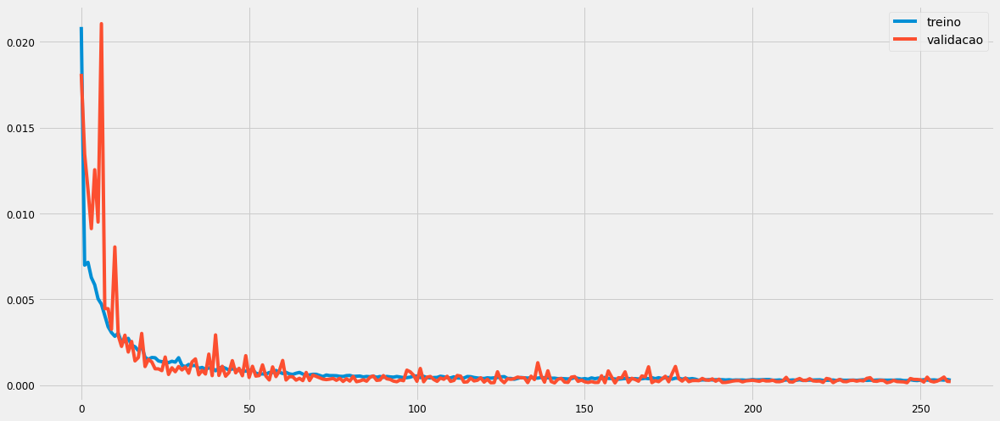

In [653]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [654]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [655]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.5201212 ],
       [0.5069912 ],
       [0.48866314],
       [0.46356985],
       [0.4337527 ]], dtype=float32)

In [656]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[11477.314],
       [11204.998],
       [10824.873],
       [10304.438],
       [ 9686.03 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

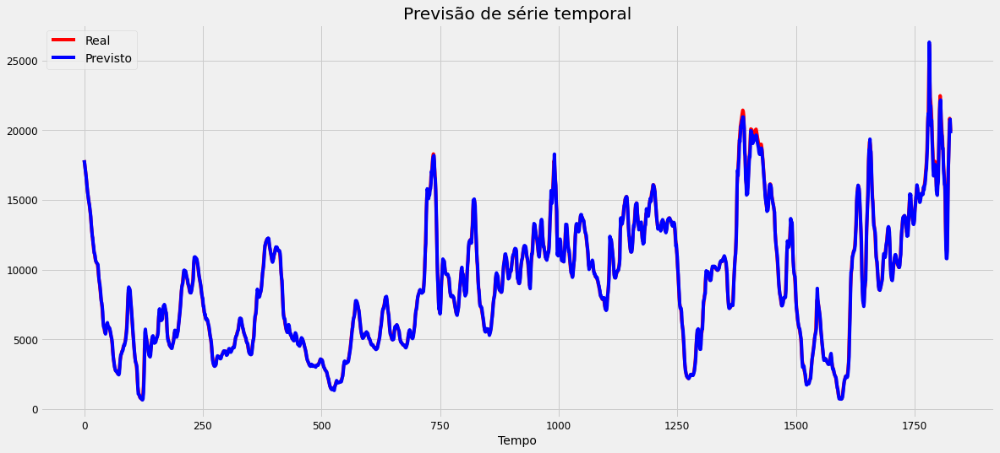

In [657]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

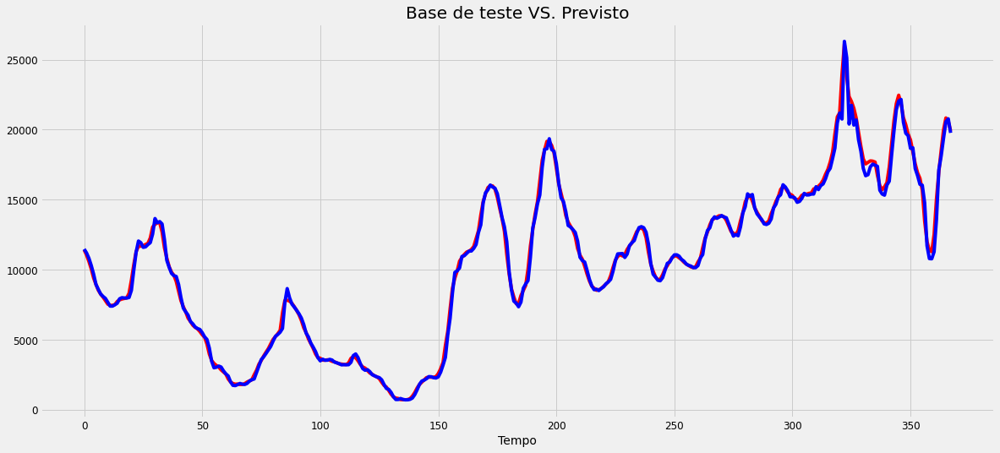

In [658]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [659]:
lstm_p1a82_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_p1a82_rmse)
lstm_p1a82_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_p1a82_mse)
lstm_p1a82_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_p1a82_mape, '%')
lstm_p1a82_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  376.5970671442965
MSE:  141825.35098168574
MAPE:  2.535611181289522 %
R2:  0.9955969939962881


## P2A_82

### SARIMA

In [660]:
data = baltic.loc[baltic['Route'] == 'P2A_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P2A_82'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).P2A_82.mean()
data.head()

Date
2014-01-31    23326.772727
2014-02-28    19360.350000
2014-03-31    16355.857143
2014-04-30    13722.750000
2014-05-31    14735.850000
Freq: M, Name: P2A_82, dtype: float64

#### Divisão da base

In [661]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-01-31 00:00:00', freq='M')

In [662]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-10-31 00:00:00', freq='M')

In [663]:
y = data.copy()
y.tail()

Date
2020-12-31    19018.222222
2021-01-31    21873.200000
2021-02-28    26027.000000
2021-03-31    28745.913043
2021-04-30    28957.666667
Freq: M, Name: P2A_82, dtype: float64

#### Exibição da série

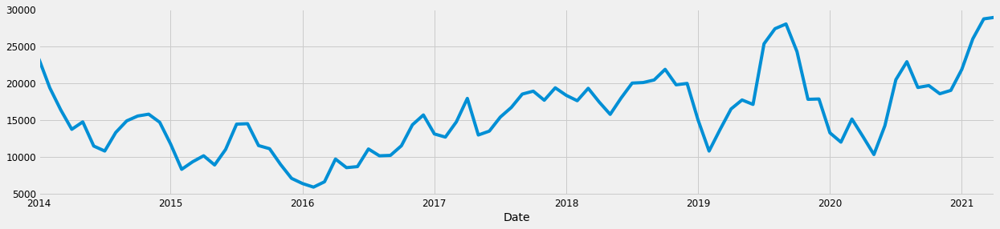

In [664]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

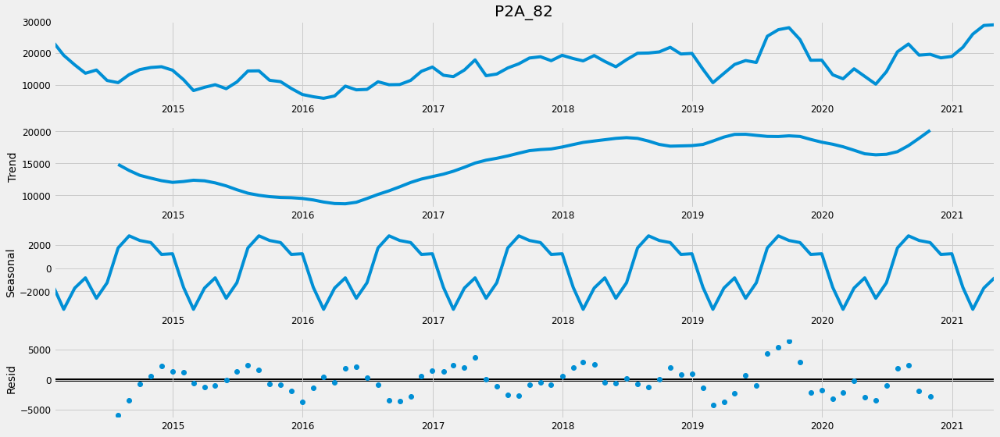

In [665]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [666]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [667]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1938.4767255836027
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1643.8886467087602
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1510.3912700123321
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1269.092633720603
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1535.6844868809633
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1497.2521666780444
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1290.3607455065135
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1270.8987303325716
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1855.3118288890719
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1587.352285878841
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1458.9688175094573
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1212.4439893258177
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1623.813791541332
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1429.819585180939
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1254.0006341626731
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1200.8336186110105
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1594.4132152640304
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1373.5273867014

C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 0, 0)x(0, 0, 0, 12)12 - AIC:1616.2343363332443
ARIMA(1, 0, 0)x(0, 0, 1, 12)12 - AIC:1392.099815615435
ARIMA(1, 0, 0)x(0, 1, 0, 12)12 - AIC:1413.2320385536307
ARIMA(1, 0, 0)x(0, 1, 1, 12)12 - AIC:1179.167098820614
ARIMA(1, 0, 0)x(1, 0, 0, 12)12 - AIC:1390.893674186259
ARIMA(1, 0, 0)x(1, 0, 1, 12)12 - AIC:1392.7005523188263
ARIMA(1, 0, 0)x(1, 1, 0, 12)12 - AIC:1178.0933640047701
ARIMA(1, 0, 0)x(1, 1, 1, 12)12 - AIC:1179.559132912528
ARIMA(1, 0, 1)x(0, 0, 0, 12)12 - AIC:1591.39256623476
ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:1371.074028004143
ARIMA(1, 0, 1)x(0, 1, 0, 12)12 - AIC:1390.9771055927035
ARIMA(1, 0, 1)x(0, 1, 1, 12)12 - AIC:1158.641271214354
ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:1387.2608428259193
ARIMA(1, 0, 1)x(1, 0, 1, 12)12 - AIC:1371.5692019411777
ARIMA(1, 0, 1)x(1, 1, 0, 12)12 - AIC:1177.1405934660436
ARIMA(1, 0, 1)x(1, 1, 1, 12)12 - AIC:1157.4980723748022
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:1591.7877431517093
ARIMA(1, 1, 0)x(0, 0, 1, 12)12 - AIC:1370.838348641808
A

In [668]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0823      1.230      0.067      0.947      -2.328       2.492
ma.L1          0.1098      1.181      0.093      0.926      -2.205       2.425
ar.S.L12      -0.2403      0.363     -0.662      0.508      -0.952       0.471
ma.S.L12      -0.3125      0.242     -1.291      0.197      -0.787       0.162
sigma2      8.494e+06   2.07e+06      4.100      0.000    4.43e+06    1.26e+07


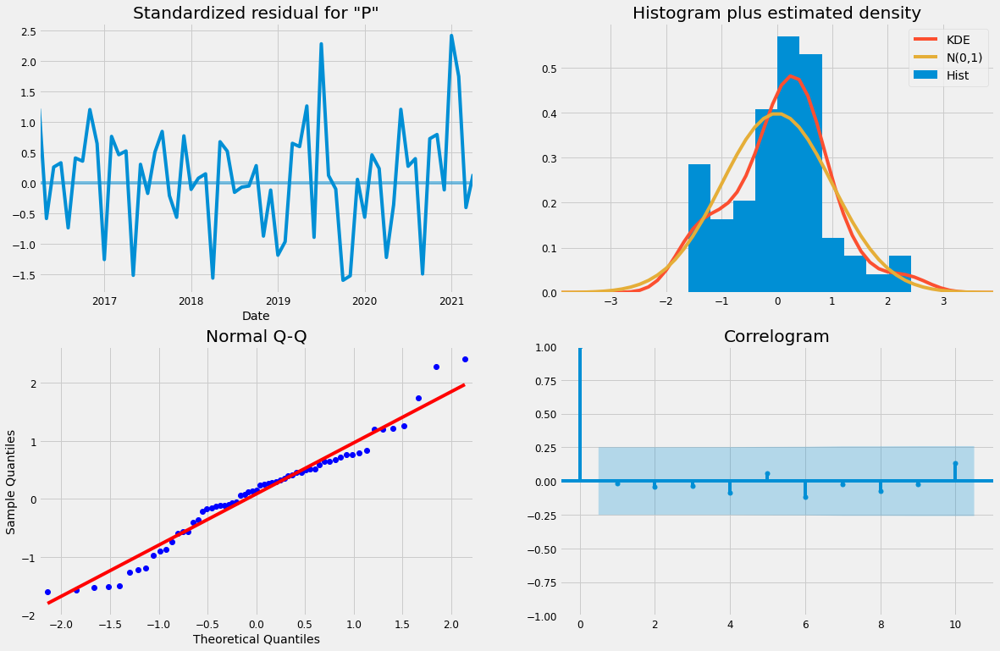

In [669]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

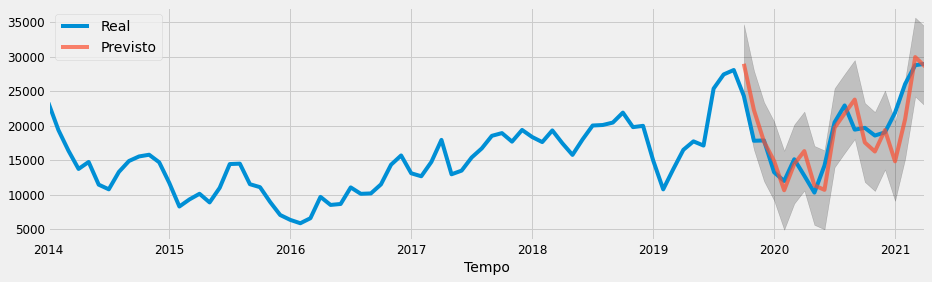

In [670]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [671]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_p2a82_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_p2a82_rmse)
sarima_p2a82_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_p2a82_mse)
sarima_p2a82_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_p2a82_mape, '%')
sarima_p2a82_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  3084.266490255922
MSE:  9512699.782915581
MAPE:  13.146502535754717 %
R2:  0.6627741007062302


### LSTM

#### Divisão da base

training_set

In [672]:
temp = baltic.loc[baltic['Route'] == 'P2A_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P2A_82'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,P2A_82
19695,2014-01-02,25163.0
19696,2014-01-03,24786.0
19697,2014-01-06,24446.0
19698,2014-01-07,24060.0
19699,2014-01-08,23970.0


In [673]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[25163.],
       [24786.],
       [24446.],
       [24060.],
       [23970.]])

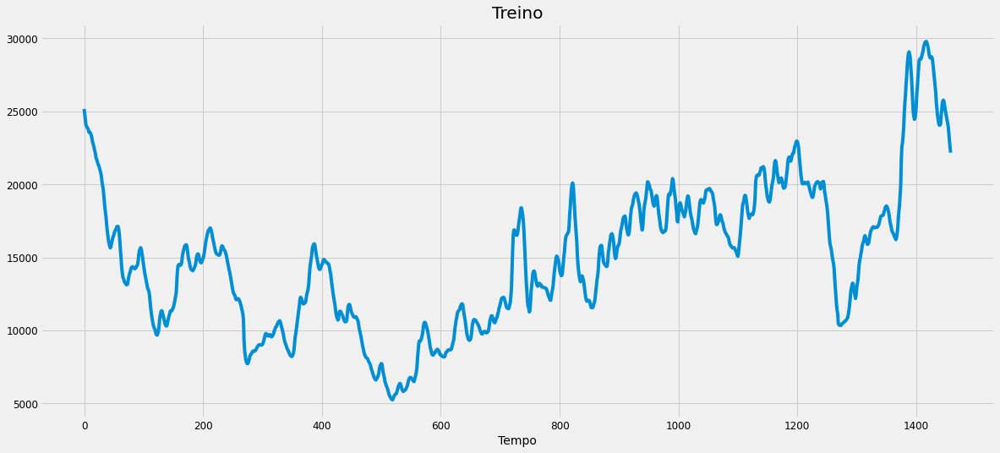

In [674]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [675]:
temp = baltic.loc[baltic['Route'] == 'P2A_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P2A_82'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,P2A_82
21154,2019-10-31,21905.0
21155,2019-11-01,21580.0
21156,2019-11-04,21220.0
21157,2019-11-05,20720.0
21158,2019-11-06,20155.0


In [676]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[21905.],
       [21580.],
       [21220.],
       [20720.],
       [20155.]])

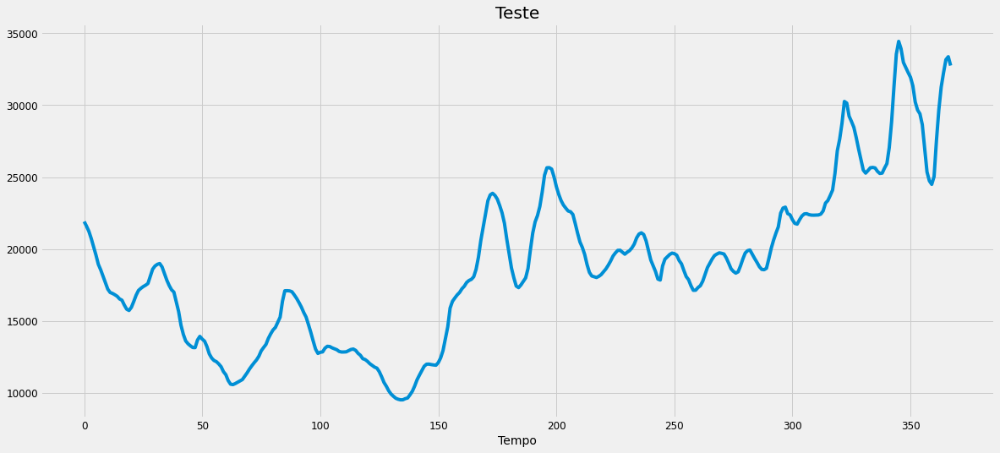

In [677]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [678]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [679]:
training_set_scaled[0:5]

array([[0.81139761],
       [0.79604057],
       [0.78219072],
       [0.76646707],
       [0.76280093]])

##### Criar a estrutura de dados

In [680]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [681]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.811398,0.796041,0.782191,0.766467,0.762801,0.760479,0.756813,0.753310,0.746629,0.747118
1,0.796041,0.782191,0.766467,0.762801,0.760479,0.756813,0.753310,0.746629,0.747118,0.745814
2,0.782191,0.766467,0.762801,0.760479,0.756813,0.753310,0.746629,0.747118,0.745814,0.742311
3,0.766467,0.762801,0.760479,0.756813,0.753310,0.746629,0.747118,0.745814,0.742311,0.737953
4,0.762801,0.760479,0.756813,0.753310,0.746629,0.747118,0.745814,0.742311,0.737953,0.728299


In [682]:
pd.DataFrame(y_train).head()

,0
0,0.745814
1,0.742311
2,0.737953
3,0.728299
4,0.719907


##### *Reshaping*

In [683]:
X_train.shape

(1449, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [684]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [685]:
X_train.shape

(1449, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [686]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_52 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_52 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_53 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_53 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_54 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_54 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_18 (Dense)             (None, 1)               

###### Treinamento

In [687]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1304 samples, validate on 145 samples
Epoch 1/1000
1304/1304 [==============================] - 2s 2ms/step - loss: 0.0207 - val_loss: 0.0088
Epoch 2/1000
1304/1304 [==============================] - 1s 786us/step - loss: 0.0046 - val_loss: 0.0061
Epoch 3/1000
1304/1304 [==============================] - 1s 783us/step - loss: 0.0040 - val_loss: 0.0099
Epoch 4/1000
1304/1304 [==============================] - 1s 788us/step - loss: 0.0035 - val_loss: 0.0065
Epoch 5/1000
1304/1304 [==============================] - 1s 784us/step - loss: 0.0036 - val_loss: 0.0055
Epoch 6/1000
1304/1304 [==============================] - 1s 787us/step - loss: 0.0040 - val_loss: 0.0120
Epoch 7/1000
1304/1304 [==============================] - 1s 786us/step - loss: 0.0032 - val_loss: 0.0069
Epoch 8/1000
1304/1304 [==============================] - 1s 786us/step - loss: 0.0031 - val_loss: 0.0053
Epoch 9/1000
1304/1304 [==============================] - 1s 798us/step - loss: 0.0028 - val_loss: 0.0085
E

Epoch 75/1000
1304/1304 [==============================] - 1s 818us/step - loss: 5.1343e-04 - val_loss: 0.0013
Epoch 76/1000
1304/1304 [==============================] - 1s 803us/step - loss: 4.5739e-04 - val_loss: 0.0018
Epoch 77/1000
1304/1304 [==============================] - 1s 785us/step - loss: 4.6336e-04 - val_loss: 1.9023e-04
Epoch 78/1000
1304/1304 [==============================] - 1s 772us/step - loss: 5.2149e-04 - val_loss: 3.8451e-04
Epoch 79/1000
1304/1304 [==============================] - 1s 771us/step - loss: 5.4338e-04 - val_loss: 7.6050e-04
Epoch 80/1000
1304/1304 [==============================] - 1s 769us/step - loss: 4.5260e-04 - val_loss: 4.1315e-04
Epoch 81/1000
1304/1304 [==============================] - 1s 768us/step - loss: 4.7711e-04 - val_loss: 5.4511e-04
Epoch 82/1000
1304/1304 [==============================] - 1s 770us/step - loss: 4.8619e-04 - val_loss: 5.6389e-04
Epoch 83/1000
1304/1304 [==============================] - 1s 770us/step - loss: 4.4716e

Epoch 146/1000
1304/1304 [==============================] - 1s 767us/step - loss: 3.5303e-04 - val_loss: 4.6639e-04
Epoch 147/1000
1304/1304 [==============================] - 1s 765us/step - loss: 3.4645e-04 - val_loss: 5.6522e-04
Epoch 148/1000
1304/1304 [==============================] - 1s 769us/step - loss: 3.7171e-04 - val_loss: 6.5569e-04
Epoch 149/1000
1304/1304 [==============================] - 1s 770us/step - loss: 3.6031e-04 - val_loss: 2.3917e-04
Epoch 150/1000
1304/1304 [==============================] - 1s 783us/step - loss: 3.7108e-04 - val_loss: 1.8915e-04
Epoch 151/1000
1304/1304 [==============================] - 1s 789us/step - loss: 3.2037e-04 - val_loss: 3.7629e-04
Epoch 152/1000
1304/1304 [==============================] - 1s 790us/step - loss: 3.4390e-04 - val_loss: 1.7377e-04
Epoch 153/1000
1304/1304 [==============================] - 1s 830us/step - loss: 3.4212e-04 - val_loss: 6.7404e-04
Epoch 154/1000
1304/1304 [==============================] - 1s 934us/ste

Epoch 217/1000
1304/1304 [==============================] - 1s 902us/step - loss: 2.2346e-04 - val_loss: 2.2499e-04
Epoch 218/1000
1304/1304 [==============================] - 1s 896us/step - loss: 2.5731e-04 - val_loss: 4.2676e-04
Epoch 219/1000
1304/1304 [==============================] - 1s 946us/step - loss: 2.6060e-04 - val_loss: 2.4617e-04
Epoch 220/1000
1304/1304 [==============================] - 1s 927us/step - loss: 2.3587e-04 - val_loss: 2.3072e-04
Epoch 221/1000
1304/1304 [==============================] - 1s 952us/step - loss: 2.4095e-04 - val_loss: 3.8864e-04
Epoch 222/1000
1304/1304 [==============================] - 1s 896us/step - loss: 2.3843e-04 - val_loss: 4.3862e-04
Epoch 223/1000
1304/1304 [==============================] - 1s 895us/step - loss: 2.4615e-04 - val_loss: 4.1411e-04
Epoch 224/1000
1304/1304 [==============================] - 1s 897us/step - loss: 2.5508e-04 - val_loss: 4.5413e-04
Epoch 225/1000
1304/1304 [==============================] - 1s 899us/ste

1304/1304 [==============================] - 1s 936us/step - loss: 2.4290e-04 - val_loss: 1.1885e-04
Epoch 288/1000
1304/1304 [==============================] - 1s 953us/step - loss: 2.2739e-04 - val_loss: 2.3175e-04
Epoch 289/1000
1304/1304 [==============================] - 1s 901us/step - loss: 2.1456e-04 - val_loss: 9.9644e-05
Epoch 290/1000
1304/1304 [==============================] - 1s 896us/step - loss: 2.4572e-04 - val_loss: 9.7942e-05
Epoch 291/1000
1304/1304 [==============================] - 1s 900us/step - loss: 2.3275e-04 - val_loss: 1.2738e-04
Epoch 292/1000
1304/1304 [==============================] - 1s 895us/step - loss: 2.4105e-04 - val_loss: 1.3220e-04
Epoch 293/1000
1304/1304 [==============================] - 1s 897us/step - loss: 2.2248e-04 - val_loss: 1.2267e-04
Epoch 294/1000
1304/1304 [==============================] - 1s 895us/step - loss: 2.2024e-04 - val_loss: 1.2165e-04
Epoch 295/1000
1304/1304 [==============================] - 1s 895us/step - loss: 2.301

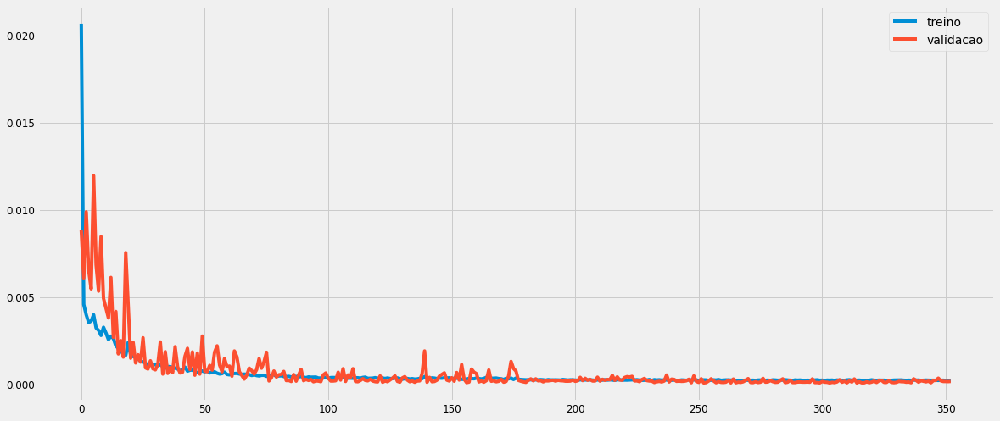

In [688]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [689]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [690]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.6742261 ],
       [0.6671531 ],
       [0.6523362 ],
       [0.63667405],
       [0.612711  ]], dtype=float32)

In [691]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[21795.576],
       [21621.941],
       [21258.201],
       [20873.71 ],
       [20285.441]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

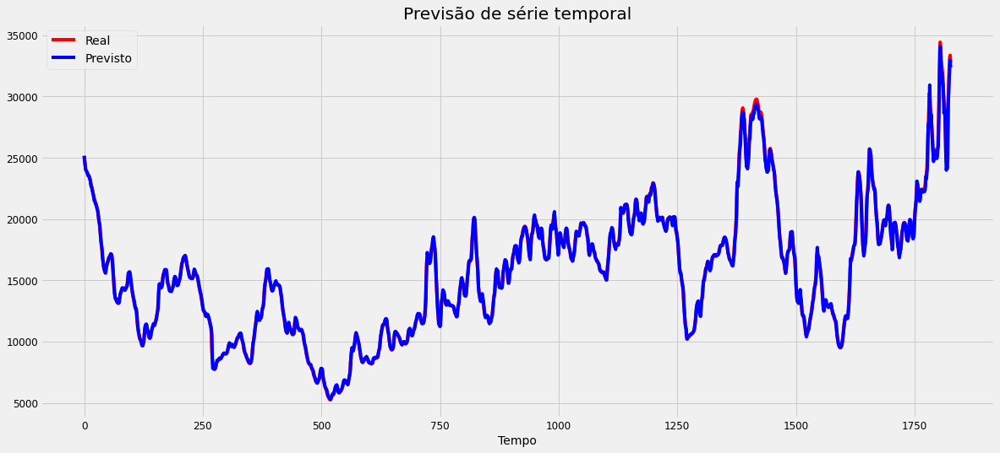

In [692]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

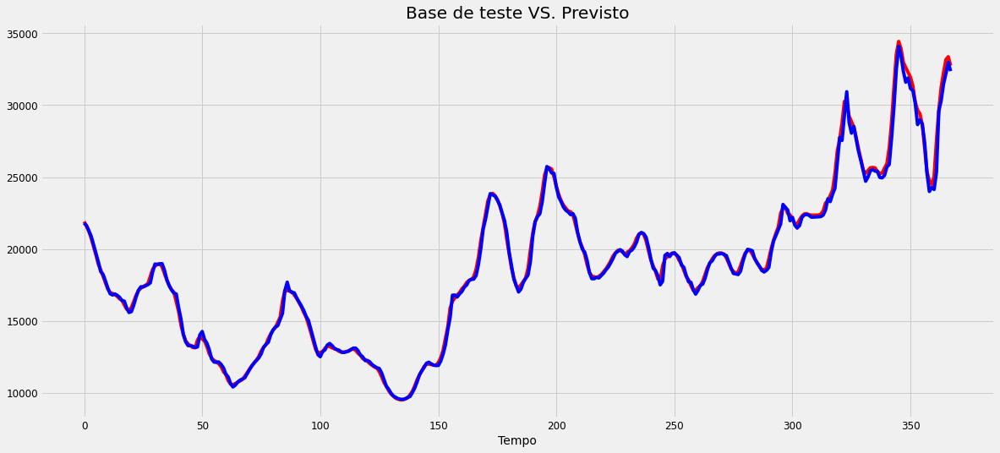

In [693]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [694]:
lstm_p2a82_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_p2a82_rmse)
lstm_p2a82_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_p2a82_mse)
lstm_p2a82_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_p2a82_mape, '%')
lstm_p2a82_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  332.6838859980453
MSE:  110678.56800276041
MAPE:  1.0350861972790475 %
R2:  0.9963705184521208


## P3A_82

### SARIMA

In [695]:
data = baltic.loc[baltic['Route'] == 'P3A_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P3A_82'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).P3A_82.mean()
data.head()

Date
2014-01-31    10008.727273
2014-02-28    10713.650000
2014-03-31    11239.047619
2014-04-30     8280.750000
2014-05-31     7598.250000
Freq: M, Name: P3A_82, dtype: float64

#### Divisão da base

In [696]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-01-31 00:00:00', freq='M')

In [697]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-10-31 00:00:00', freq='M')

In [698]:
y = data.copy()
y.tail()

Date
2020-12-31    11055.222222
2021-01-31    11310.500000
2021-02-28    14936.100000
2021-03-31    23197.434783
2021-04-30    20435.133333
Freq: M, Name: P3A_82, dtype: float64

#### Exibição da série

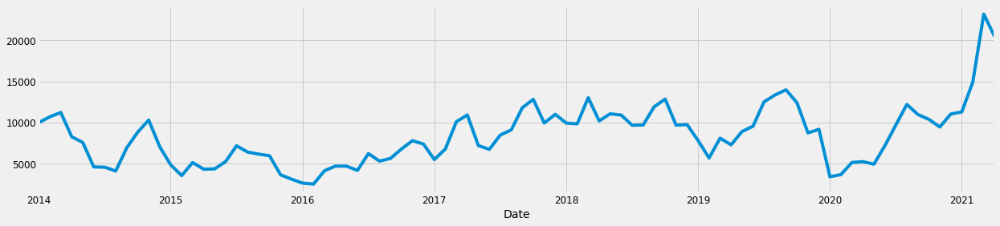

In [699]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

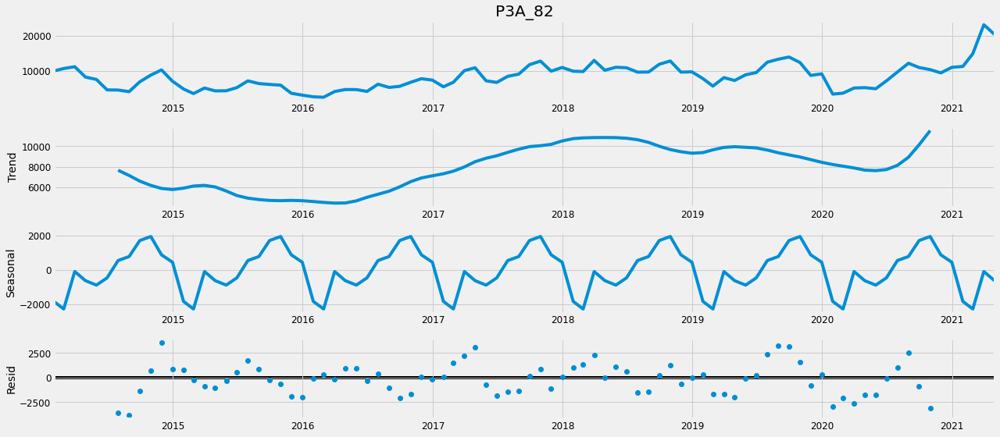

In [700]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [701]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [702]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1835.4872794557289
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1560.5550196537704
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1473.4898024939007
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1239.5061217039192
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1495.3307716751324
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1460.9183629341655
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1259.5541132468795
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1241.1173349694172
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1751.4867648951908
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1500.3192014002616
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1401.5086153606228
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1174.4747287177265
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1439.0703102875837
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1387.0708145449514
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1214.3580652755313
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1171.6074136131194
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1556.1468070998471
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1333.429814

#### Ajuste considerando o menor valor de AIC

In [703]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2491      1.649      0.151      0.880      -2.984       3.482
ma.L1         -0.1463      1.753     -0.083      0.933      -3.583       3.290
ar.S.L12      -0.0899      0.281     -0.320      0.749      -0.640       0.460
ma.S.L12      -0.5327      0.235     -2.271      0.023      -0.993      -0.073
sigma2      3.712e+06    7.6e+05      4.883      0.000    2.22e+06     5.2e+06


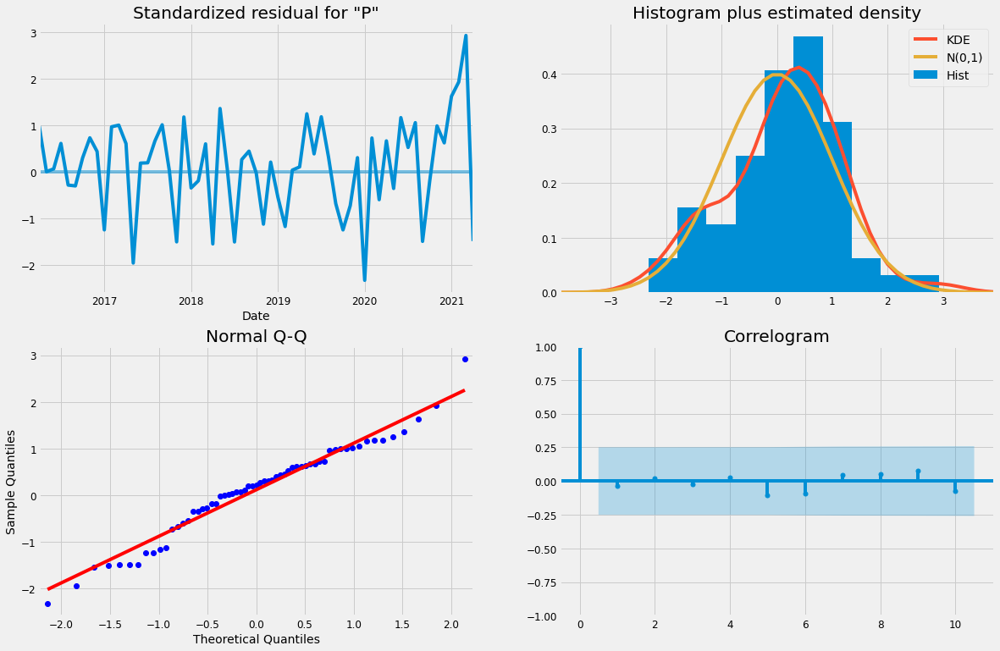

In [704]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

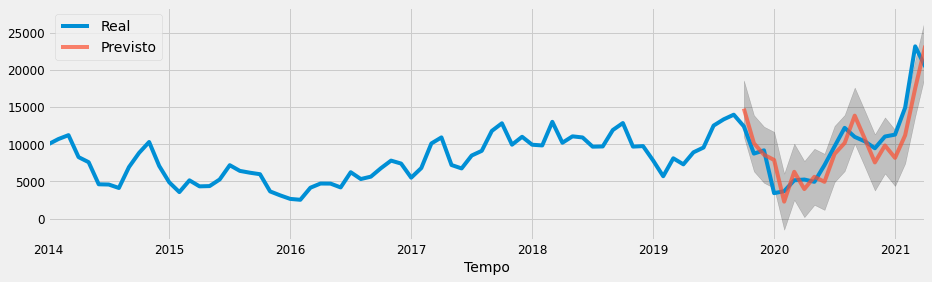

In [705]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [706]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_p3a82_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_p3a82_rmse)
sarima_p3a82_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_p3a82_mse)
sarima_p3a82_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_p3a82_mape, '%')
sarima_p3a82_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  2520.183708442035
MSE:  6351325.924296647
MAPE:  25.261836908399555 %
R2:  0.7517658077936038


### LSTM

#### Divisão da base

training_set

In [707]:
temp = baltic.loc[baltic['Route'] == 'P3A_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P3A_82'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,P3A_82
21522,2014-01-02,11713.0
21523,2014-01-03,11463.0
21524,2014-01-06,11303.0
21525,2014-01-07,11050.0
21526,2014-01-08,10857.0


In [708]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[11713.],
       [11463.],
       [11303.],
       [11050.],
       [10857.]])

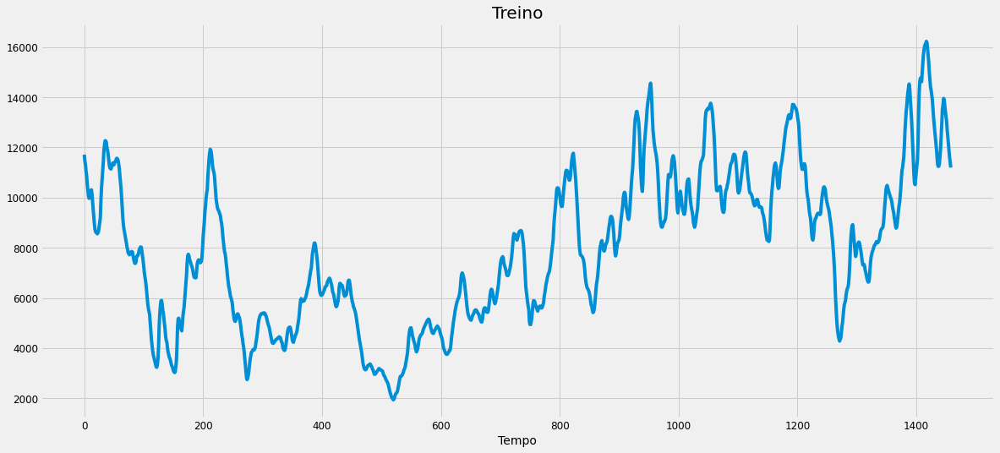

In [709]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [710]:
temp = baltic.loc[baltic['Route'] == 'P3A_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P3A_82'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,P3A_82
22981,2019-10-31,10908.0
22982,2019-11-01,10723.0
22983,2019-11-04,10481.0
22984,2019-11-05,10239.0
22985,2019-11-06,9925.0


In [711]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[10908.],
       [10723.],
       [10481.],
       [10239.],
       [ 9925.]])

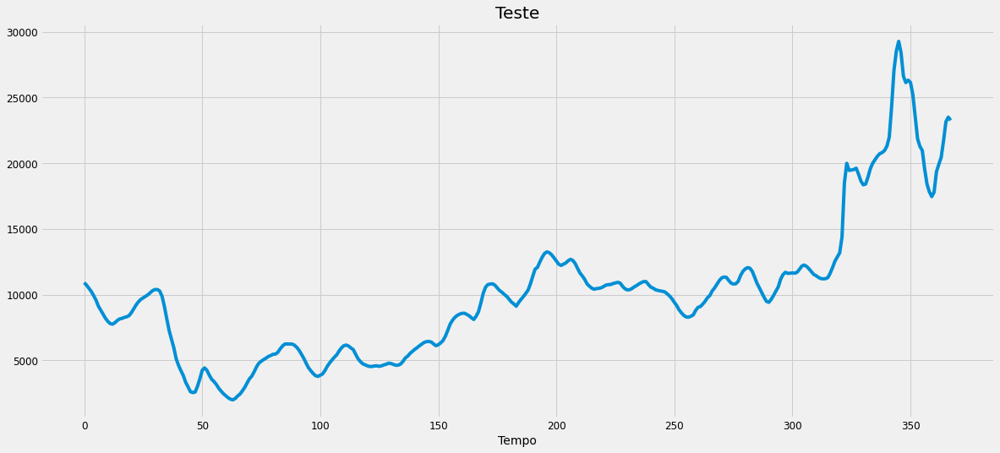

In [712]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [713]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [714]:
training_set_scaled[0:5]

array([[0.68404479],
       [0.66655003],
       [0.65535339],
       [0.63764871],
       [0.62414276]])

##### Criar a estrutura de dados

In [715]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [716]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.684045,0.666550,0.655353,0.637649,0.624143,0.602239,0.584745,0.568789,0.562141,0.563961
1,0.666550,0.655353,0.637649,0.624143,0.602239,0.584745,0.568789,0.562141,0.563961,0.572848
2,0.655353,0.637649,0.624143,0.602239,0.584745,0.568789,0.562141,0.563961,0.572848,0.582225
3,0.637649,0.624143,0.602239,0.584745,0.568789,0.562141,0.563961,0.572848,0.582225,0.586004
4,0.624143,0.602239,0.584745,0.568789,0.562141,0.563961,0.572848,0.582225,0.586004,0.574598


In [717]:
pd.DataFrame(y_train).head()

,0
0,0.572848
1,0.582225
2,0.586004
3,0.574598
4,0.551645


##### *Reshaping*

In [718]:
X_train.shape

(1449, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [719]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [720]:
X_train.shape

(1449, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [721]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_55 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_55 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_56 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_56 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_57 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_57 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_19 (Dense)             (None, 1)               

###### Treinamento

In [722]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1304 samples, validate on 145 samples
Epoch 1/1000
1304/1304 [==============================] - 2s 2ms/step - loss: 0.0295 - val_loss: 0.0129
Epoch 2/1000
1304/1304 [==============================] - 1s 761us/step - loss: 0.0064 - val_loss: 0.0101
Epoch 3/1000
1304/1304 [==============================] - 1s 750us/step - loss: 0.0060 - val_loss: 0.0102
Epoch 4/1000
1304/1304 [==============================] - 1s 758us/step - loss: 0.0060 - val_loss: 0.0083
Epoch 5/1000
1304/1304 [==============================] - 1s 732us/step - loss: 0.0053 - val_loss: 0.0096
Epoch 6/1000
1304/1304 [==============================] - 1s 728us/step - loss: 0.0050 - val_loss: 0.0062
Epoch 7/1000
1304/1304 [==============================] - 1s 725us/step - loss: 0.0050 - val_loss: 0.0053
Epoch 8/1000
1304/1304 [==============================] - 1s 726us/step - loss: 0.0045 - val_loss: 0.0062
Epoch 9/1000
1304/1304 [==============================] - 1s 727us/step - loss: 0.0037 - val_loss: 0.0056
E

Epoch 75/1000
1304/1304 [==============================] - 1s 725us/step - loss: 6.6217e-04 - val_loss: 3.6504e-04
Epoch 76/1000
1304/1304 [==============================] - 1s 735us/step - loss: 6.2852e-04 - val_loss: 5.6303e-04
Epoch 77/1000
1304/1304 [==============================] - 1s 738us/step - loss: 6.4504e-04 - val_loss: 2.5771e-04
Epoch 78/1000
1304/1304 [==============================] - 1s 728us/step - loss: 6.4509e-04 - val_loss: 2.7958e-04
Epoch 79/1000
1304/1304 [==============================] - 1s 725us/step - loss: 6.0934e-04 - val_loss: 2.5959e-04
Epoch 80/1000
1304/1304 [==============================] - 1s 735us/step - loss: 6.6083e-04 - val_loss: 3.6161e-04
Epoch 81/1000
1304/1304 [==============================] - 1s 738us/step - loss: 5.3860e-04 - val_loss: 2.9137e-04
Epoch 82/1000
1304/1304 [==============================] - 1s 747us/step - loss: 6.4163e-04 - val_loss: 7.0081e-04
Epoch 83/1000
1304/1304 [==============================] - 1s 738us/step - loss:

Epoch 146/1000
1304/1304 [==============================] - 1s 854us/step - loss: 4.5517e-04 - val_loss: 1.2354e-04
Epoch 147/1000
1304/1304 [==============================] - 1s 852us/step - loss: 4.7318e-04 - val_loss: 2.5742e-04
Epoch 148/1000
1304/1304 [==============================] - 1s 854us/step - loss: 5.0612e-04 - val_loss: 1.2738e-04
Epoch 149/1000
1304/1304 [==============================] - 1s 848us/step - loss: 4.9674e-04 - val_loss: 1.5648e-04
Epoch 150/1000
1304/1304 [==============================] - 1s 855us/step - loss: 4.3039e-04 - val_loss: 1.6424e-04
Epoch 151/1000
1304/1304 [==============================] - 1s 852us/step - loss: 4.3993e-04 - val_loss: 1.5189e-04
Epoch 152/1000
1304/1304 [==============================] - 1s 856us/step - loss: 4.6461e-04 - val_loss: 1.6145e-04
Epoch 153/1000
1304/1304 [==============================] - 1s 856us/step - loss: 5.1392e-04 - val_loss: 1.1908e-04
Epoch 154/1000
1304/1304 [==============================] - 1s 897us/ste

1304/1304 [==============================] - 1s 861us/step - loss: 3.1638e-04 - val_loss: 1.5255e-04
Epoch 217/1000
1304/1304 [==============================] - 1s 856us/step - loss: 3.1598e-04 - val_loss: 1.0297e-04
Epoch 218/1000
1304/1304 [==============================] - 1s 851us/step - loss: 3.8027e-04 - val_loss: 1.4954e-04
Epoch 219/1000
1304/1304 [==============================] - 1s 880us/step - loss: 3.2605e-04 - val_loss: 1.3943e-04
Epoch 220/1000
1304/1304 [==============================] - 1s 858us/step - loss: 3.0025e-04 - val_loss: 1.1893e-04
Epoch 221/1000
1304/1304 [==============================] - 1s 858us/step - loss: 3.3523e-04 - val_loss: 9.6158e-05
Epoch 222/1000
1304/1304 [==============================] - 1s 855us/step - loss: 3.3964e-04 - val_loss: 9.3949e-05
Epoch 223/1000
1304/1304 [==============================] - 1s 850us/step - loss: 3.5430e-04 - val_loss: 1.1452e-04
Epoch 224/1000
1304/1304 [==============================] - 1s 882us/step - loss: 3.178

Epoch 287/1000
1304/1304 [==============================] - 1s 844us/step - loss: 3.1819e-04 - val_loss: 9.1051e-05
Epoch 288/1000
1304/1304 [==============================] - 1s 855us/step - loss: 3.9731e-04 - val_loss: 2.1114e-04
Epoch 289/1000
1304/1304 [==============================] - 1s 853us/step - loss: 3.1774e-04 - val_loss: 3.2091e-04
Epoch 290/1000
1304/1304 [==============================] - 1s 853us/step - loss: 3.3249e-04 - val_loss: 1.2386e-04
Epoch 291/1000
1304/1304 [==============================] - 1s 848us/step - loss: 3.3783e-04 - val_loss: 1.6219e-04
Epoch 292/1000
1304/1304 [==============================] - 1s 853us/step - loss: 3.3358e-04 - val_loss: 8.2630e-05
Epoch 293/1000
1304/1304 [==============================] - 1s 861us/step - loss: 3.2071e-04 - val_loss: 1.1169e-04
Epoch 294/1000
1304/1304 [==============================] - 1s 865us/step - loss: 3.3306e-04 - val_loss: 1.2487e-04
Epoch 295/1000
1304/1304 [==============================] - 1s 908us/ste

1304/1304 [==============================] - 1s 851us/step - loss: 3.0783e-04 - val_loss: 9.2542e-05
Epoch 358/1000
1304/1304 [==============================] - 1s 855us/step - loss: 3.2254e-04 - val_loss: 1.0061e-04
Epoch 359/1000
1304/1304 [==============================] - 1s 849us/step - loss: 3.2515e-04 - val_loss: 1.0678e-04
Epoch 360/1000
1304/1304 [==============================] - 1s 848us/step - loss: 3.3169e-04 - val_loss: 9.7755e-05
Epoch 361/1000
1304/1304 [==============================] - 1s 850us/step - loss: 3.0029e-04 - val_loss: 1.0189e-04
Epoch 362/1000
1304/1304 [==============================] - 1s 848us/step - loss: 3.0247e-04 - val_loss: 1.3337e-04
Epoch 363/1000
1304/1304 [==============================] - 1s 863us/step - loss: 3.1407e-04 - val_loss: 1.0290e-04
Epoch 364/1000
1304/1304 [==============================] - 1s 887us/step - loss: 3.0205e-04 - val_loss: 1.2258e-04
Epoch 365/1000
1304/1304 [==============================] - 1s 1ms/step - loss: 3.1272e

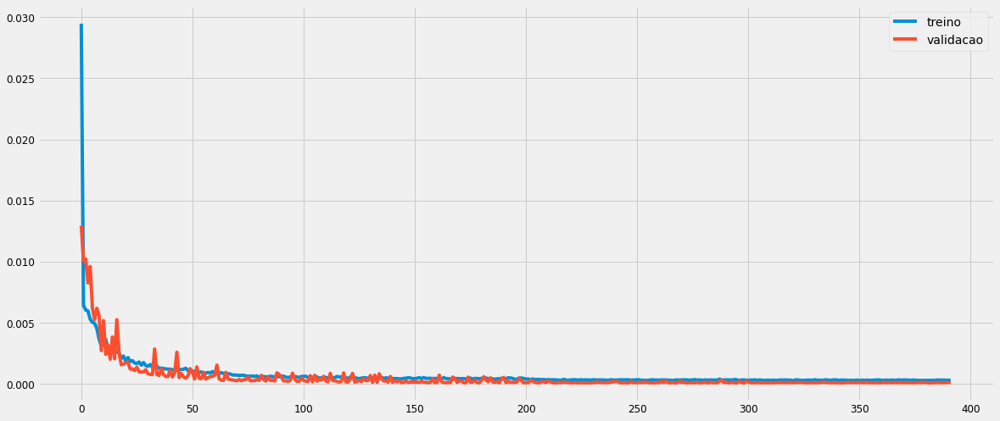

In [723]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [724]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [725]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.63408375],
       [0.61052066],
       [0.60434693],
       [0.58430696],
       [0.5673006 ]], dtype=float32)

In [726]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[10999.058],
       [10662.341],
       [10574.118],
       [10287.747],
       [10044.727]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

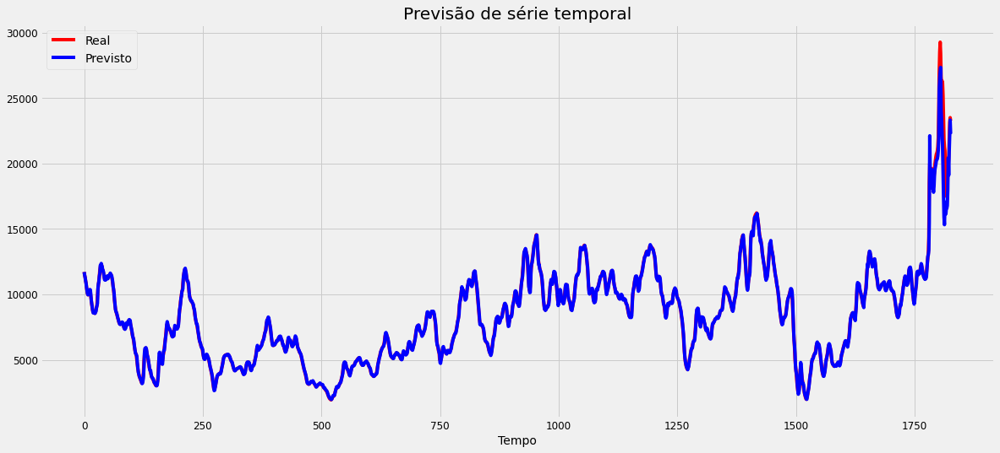

In [727]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

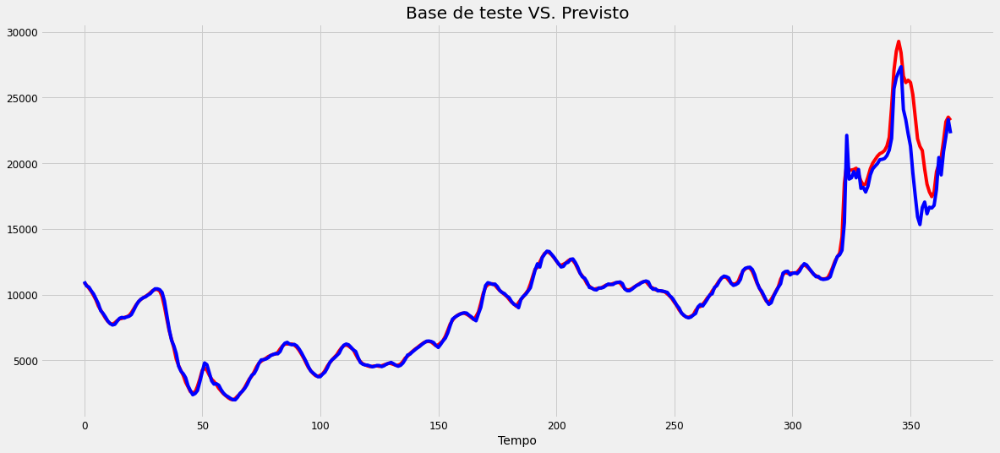

In [728]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [729]:
lstm_p3a82_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_p3a82_rmse)
lstm_p3a82_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_p3a82_mse)
lstm_p3a82_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_p3a82_mape, '%')
lstm_p3a82_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  873.4347484774669
MSE:  762888.2598478958
MAPE:  2.157015566782395 %
R2:  0.9734058558268257


## P4_82

### SARIMA

In [730]:
data = baltic.loc[baltic['Route'] == 'P4_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P4_82'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).P4_82.mean()
data.head()

Date
2014-01-31    1497.090909
2014-02-28    1523.700000
2014-03-31    1735.857143
2014-04-30    1452.650000
2014-05-31    1544.450000
Freq: M, Name: P4_82, dtype: float64

#### Divisão da base

In [731]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-01-31 00:00:00', freq='M')

In [732]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2018-10-31 00:00:00', freq='M')

In [733]:
y = data.copy()
y.tail()

Date
2019-08-31    5895.000000
2019-09-30    6240.952381
2019-10-31    5624.826087
2019-11-30    4135.333333
2019-12-31    3945.705882
Freq: M, Name: P4_82, dtype: float64

#### Exibição da série

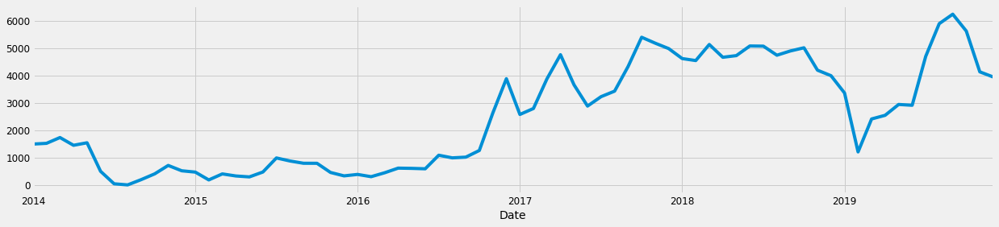

In [734]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

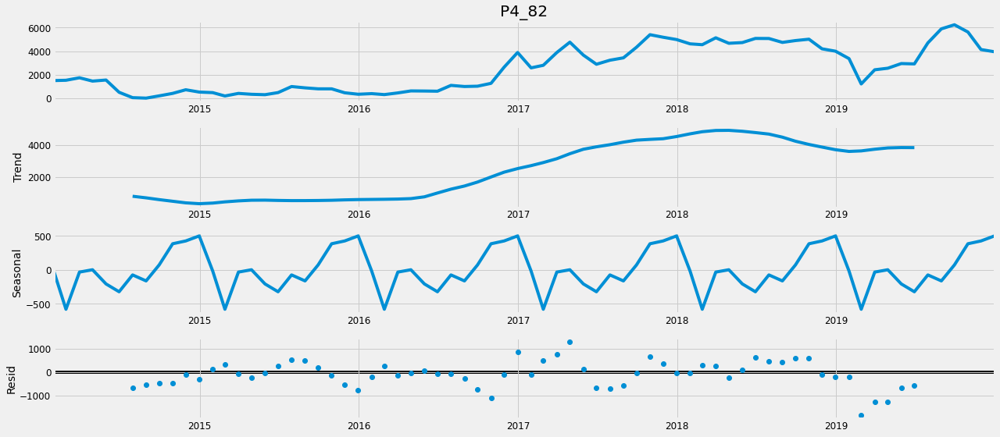

In [735]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [736]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [737]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1347.976001182819
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1081.783377382362
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1052.1946889328694
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:846.4198886808396
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1071.3217357805813
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1053.2175570587992
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:865.1573595913774
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:846.5561123032767
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1248.4477991149174
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1006.0327382825794
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:981.945060172728
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:788.2469928495999
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1017.0756034683986
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:983.9734691000235
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:821.5740530031367
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:788.8932380661886
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1107.1724981310326
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:926.5431965839297
ARIM

C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 0, 0)x(0, 0, 1, 12)12 - AIC:943.4255694779041
ARIMA(1, 0, 0)x(0, 1, 0, 12)12 - AIC:959.1753038294107
ARIMA(1, 0, 0)x(0, 1, 1, 12)12 - AIC:763.5380526796304
ARIMA(1, 0, 0)x(1, 0, 0, 12)12 - AIC:943.3985806972665
ARIMA(1, 0, 0)x(1, 0, 1, 12)12 - AIC:945.3634578601735
ARIMA(1, 0, 0)x(1, 1, 0, 12)12 - AIC:766.7896934181933
ARIMA(1, 0, 0)x(1, 1, 1, 12)12 - AIC:765.5178369103397
ARIMA(1, 0, 1)x(0, 0, 0, 12)12 - AIC:1108.2012281190607
ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:927.6917735847207
ARIMA(1, 0, 1)x(0, 1, 0, 12)12 - AIC:938.8420759517951
ARIMA(1, 0, 1)x(0, 1, 1, 12)12 - AIC:747.5806461202517
ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:942.5916079377638
ARIMA(1, 0, 1)x(1, 0, 1, 12)12 - AIC:929.6054739507769
ARIMA(1, 0, 1)x(1, 1, 0, 12)12 - AIC:765.8059218349016
ARIMA(1, 0, 1)x(1, 1, 1, 12)12 - AIC:749.3472204917172
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:1107.376499323705
ARIMA(1, 1, 0)x(0, 0, 1, 12)12 - AIC:927.0434557318656
ARIMA(1, 1, 0)x(0, 1, 0, 12)12 - AIC:944.9993093874233
ARIMA(1, 

#### Ajuste considerando o menor valor de AIC

In [738]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1131      0.643     -0.176      0.860      -1.374       1.147
ma.L1          0.3584      0.656      0.546      0.585      -0.928       1.645
ar.S.L12       0.0454      0.370      0.123      0.902      -0.679       0.770
ma.S.L12      -0.8372      0.824     -1.017      0.309      -2.451       0.777
sigma2      5.198e+05   2.74e+05      1.900      0.057   -1.65e+04    1.06e+06


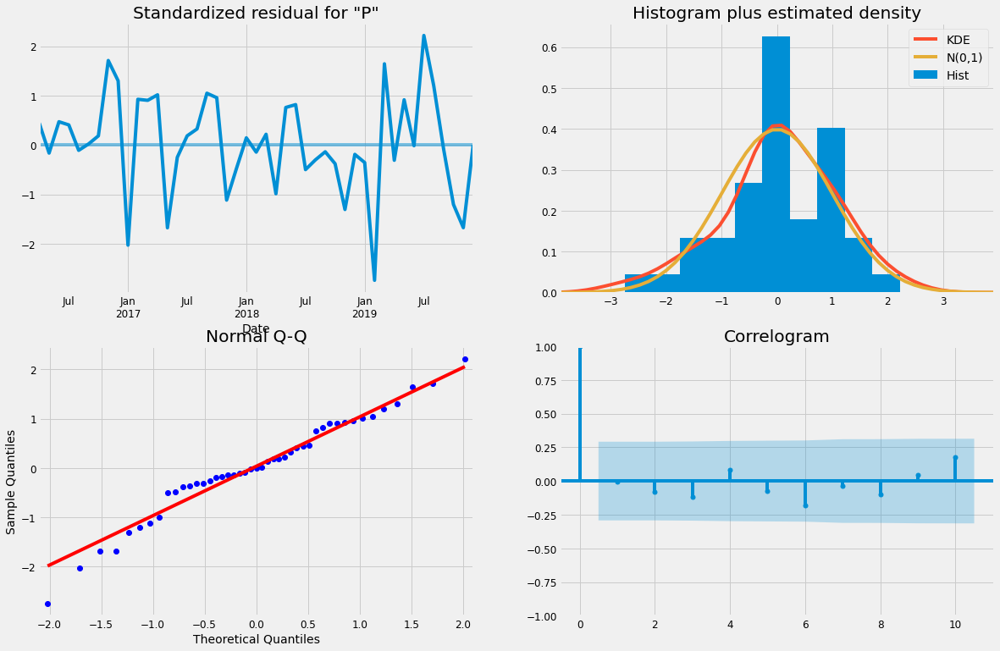

In [739]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

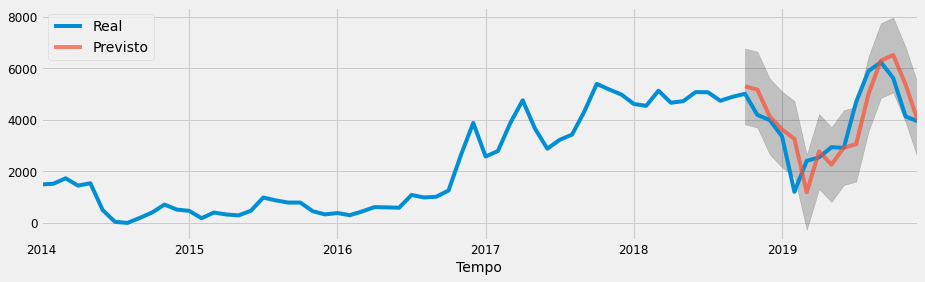

In [740]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [741]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_p482_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_p482_rmse)
sarima_p482_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_p482_mse)
sarima_p482_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_p482_mape, '%')
sarima_p482_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  937.8276483362658
MSE:  879520.6979839307
MAPE:  26.020880557186537 %
R2:  0.5269319607762935


### LSTM

#### Divisão da base

training_set

In [742]:
temp = baltic.loc[baltic['Route'] == 'P4_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P4_82'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,P4_82
23349,2014-01-02,2035.0
23350,2014-01-03,1942.0
23351,2014-01-06,1923.0
23352,2014-01-07,1875.0
23353,2014-01-08,1754.0


In [743]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[2035.],
       [1942.],
       [1923.],
       [1875.],
       [1754.]])

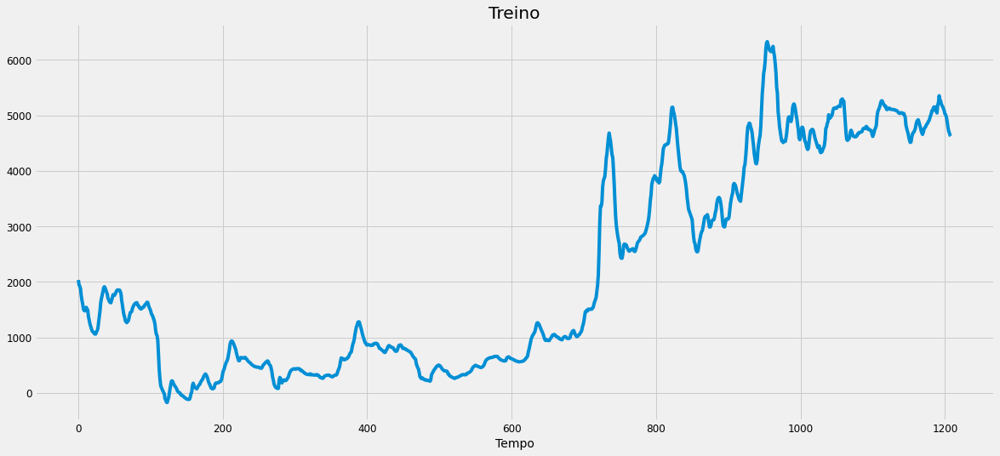

In [744]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [745]:
temp = baltic.loc[baltic['Route'] == 'P4_82'].copy().drop(columns=['Route']).rename(columns = {'USD': 'P4_82'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,P4_82
24558,2018-10-31,4632.0
24559,2018-11-01,4608.0
24560,2018-11-02,4602.0
24561,2018-11-05,4590.0
24562,2018-11-06,4568.0


In [746]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[4632.],
       [4608.],
       [4602.],
       [4590.],
       [4568.]])

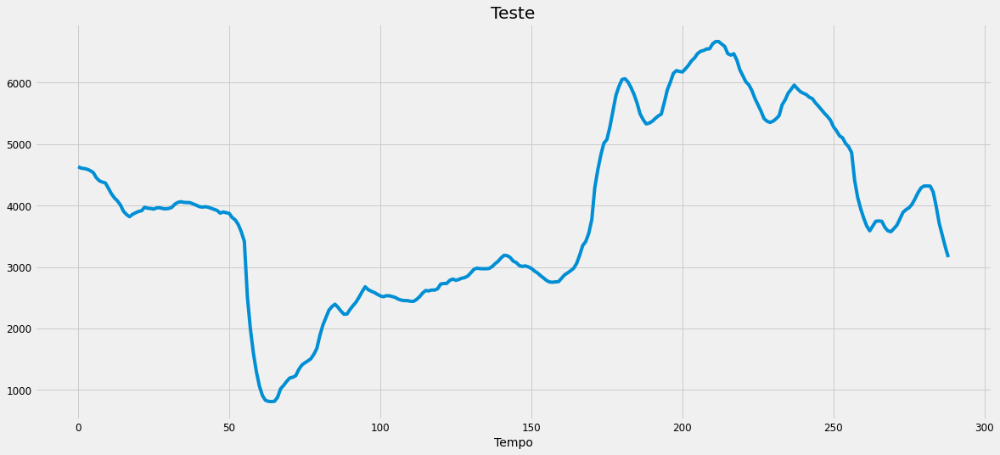

In [747]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [748]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [749]:
training_set_scaled[0:5]

array([[0.33948623],
       [0.32518074],
       [0.32225811],
       [0.31487463],
       [0.29626211]])

##### Criar a estrutura de dados

In [750]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [751]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.339486,0.325181,0.322258,0.314875,0.296262,0.282572,0.273035,0.258422,0.254884,0.253807
1,0.325181,0.322258,0.314875,0.296262,0.282572,0.273035,0.258422,0.254884,0.253807,0.258114
2,0.322258,0.314875,0.296262,0.282572,0.273035,0.258422,0.254884,0.253807,0.258114,0.263652
3,0.314875,0.296262,0.282572,0.273035,0.258422,0.254884,0.253807,0.258114,0.263652,0.258883
4,0.296262,0.282572,0.273035,0.258422,0.254884,0.253807,0.258114,0.263652,0.258883,0.256114


In [752]:
pd.DataFrame(y_train).head()

,0
0,0.258114
1,0.263652
2,0.258883
3,0.256114
4,0.237348


##### *Reshaping*

In [753]:
X_train.shape

(1199, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [754]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [755]:
X_train.shape

(1199, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [756]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_58 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_58 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_59 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_59 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_60 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_60 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_20 (Dense)             (None, 1)               

###### Treinamento

In [757]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1079 samples, validate on 120 samples
Epoch 1/1000
1079/1079 [==============================] - 2s 2ms/step - loss: 0.0366 - val_loss: 0.0061
Epoch 2/1000
1079/1079 [==============================] - 1s 784us/step - loss: 0.0052 - val_loss: 0.0067
Epoch 3/1000
1079/1079 [==============================] - 1s 820us/step - loss: 0.0042 - val_loss: 0.0012
Epoch 4/1000
1079/1079 [==============================] - 1s 749us/step - loss: 0.0035 - val_loss: 0.0013
Epoch 5/1000
1079/1079 [==============================] - 1s 766us/step - loss: 0.0035 - val_loss: 0.0027
Epoch 6/1000
1079/1079 [==============================] - 1s 753us/step - loss: 0.0041 - val_loss: 0.0043
Epoch 7/1000
1079/1079 [==============================] - 1s 757us/step - loss: 0.0035 - val_loss: 0.0016
Epoch 8/1000
1079/1079 [==============================] - 1s 760us/step - loss: 0.0035 - val_loss: 0.0033
Epoch 9/1000
1079/1079 [==============================] - 1s 765us/step - loss: 0.0035 - val_loss: 0.0018
E

1079/1079 [==============================] - 1s 855us/step - loss: 8.9392e-04 - val_loss: 3.0175e-04
Epoch 76/1000
1079/1079 [==============================] - 1s 847us/step - loss: 9.9867e-04 - val_loss: 6.8996e-04
Epoch 77/1000
1079/1079 [==============================] - 1s 849us/step - loss: 9.1512e-04 - val_loss: 1.3456e-04
Epoch 78/1000
1079/1079 [==============================] - 1s 849us/step - loss: 0.0010 - val_loss: 1.9926e-04
Epoch 79/1000
1079/1079 [==============================] - 1s 833us/step - loss: 9.3246e-04 - val_loss: 1.2395e-04
Epoch 80/1000
1079/1079 [==============================] - 1s 834us/step - loss: 8.8443e-04 - val_loss: 8.5842e-04
Epoch 81/1000
1079/1079 [==============================] - 1s 841us/step - loss: 7.7839e-04 - val_loss: 1.7648e-04
Epoch 82/1000
1079/1079 [==============================] - 1s 851us/step - loss: 8.7860e-04 - val_loss: 1.2065e-04
Epoch 83/1000
1079/1079 [==============================] - 1s 828us/step - loss: 9.3159e-04 - val_

1079/1079 [==============================] - 1s 859us/step - loss: 7.3519e-04 - val_loss: 5.6442e-05
Epoch 147/1000
1079/1079 [==============================] - 1s 884us/step - loss: 6.9609e-04 - val_loss: 6.7276e-05
Epoch 148/1000
1079/1079 [==============================] - 1s 916us/step - loss: 7.0193e-04 - val_loss: 2.3444e-04
Epoch 149/1000
1079/1079 [==============================] - 1s 880us/step - loss: 6.5461e-04 - val_loss: 2.4262e-04
Epoch 150/1000
1079/1079 [==============================] - 1s 886us/step - loss: 6.3567e-04 - val_loss: 6.2601e-05
Epoch 151/1000
1079/1079 [==============================] - 1s 897us/step - loss: 7.5311e-04 - val_loss: 5.6694e-05
Epoch 152/1000
1079/1079 [==============================] - 1s 887us/step - loss: 5.8371e-04 - val_loss: 5.5829e-05
Epoch 153/1000
1079/1079 [==============================] - 1s 884us/step - loss: 6.5688e-04 - val_loss: 5.7692e-05
Epoch 154/1000
1079/1079 [==============================] - 1s 871us/step - loss: 6.876

Epoch 217/1000
1079/1079 [==============================] - 1s 876us/step - loss: 5.1038e-04 - val_loss: 6.2214e-05
Epoch 218/1000
1079/1079 [==============================] - 1s 865us/step - loss: 6.0731e-04 - val_loss: 6.6663e-05
Epoch 219/1000
1079/1079 [==============================] - 1s 869us/step - loss: 6.0875e-04 - val_loss: 9.4117e-05
Epoch 220/1000
1079/1079 [==============================] - 1s 913us/step - loss: 5.8285e-04 - val_loss: 1.0259e-04
Epoch 221/1000
1079/1079 [==============================] - 1s 906us/step - loss: 6.3560e-04 - val_loss: 5.1171e-05
Epoch 222/1000
1079/1079 [==============================] - 1s 991us/step - loss: 5.8432e-04 - val_loss: 1.4552e-04
Epoch 223/1000
1079/1079 [==============================] - 1s 970us/step - loss: 5.6599e-04 - val_loss: 5.4965e-05
Epoch 224/1000
1079/1079 [==============================] - 1s 911us/step - loss: 6.3461e-04 - val_loss: 1.0259e-04
Epoch 225/1000
1079/1079 [==============================] - 1s 881us/ste

1079/1079 [==============================] - 1s 845us/step - loss: 5.2719e-04 - val_loss: 8.0283e-05
Epoch 288/1000
1079/1079 [==============================] - 1s 849us/step - loss: 5.8228e-04 - val_loss: 5.7010e-05
Epoch 289/1000
1079/1079 [==============================] - 1s 910us/step - loss: 5.3349e-04 - val_loss: 5.5343e-05
Epoch 290/1000
1079/1079 [==============================] - 1s 876us/step - loss: 5.9679e-04 - val_loss: 4.8627e-05
Epoch 291/1000
1079/1079 [==============================] - 1s 911us/step - loss: 5.1920e-04 - val_loss: 5.4326e-05
Epoch 292/1000
1079/1079 [==============================] - 1s 843us/step - loss: 5.1116e-04 - val_loss: 6.6562e-05
Epoch 293/1000
1079/1079 [==============================] - 1s 846us/step - loss: 6.5459e-04 - val_loss: 5.1536e-05
Epoch 294/1000
1079/1079 [==============================] - 1s 851us/step - loss: 5.3894e-04 - val_loss: 6.5028e-05
Epoch 295/1000
1079/1079 [==============================] - 1s 855us/step - loss: 5.596

Epoch 358/1000
1079/1079 [==============================] - 1s 905us/step - loss: 5.3113e-04 - val_loss: 5.9704e-05
Epoch 359/1000
1079/1079 [==============================] - 1s 837us/step - loss: 5.7005e-04 - val_loss: 6.0472e-05
Epoch 360/1000
1079/1079 [==============================] - 1s 852us/step - loss: 4.9924e-04 - val_loss: 6.2147e-05
Epoch 361/1000
1079/1079 [==============================] - 1s 842us/step - loss: 5.0200e-04 - val_loss: 6.3656e-05
Epoch 362/1000
1079/1079 [==============================] - 1s 842us/step - loss: 5.7268e-04 - val_loss: 6.4097e-05
Epoch 363/1000
1079/1079 [==============================] - 1s 846us/step - loss: 5.6265e-04 - val_loss: 6.5541e-05
Epoch 364/1000
1079/1079 [==============================] - 1s 846us/step - loss: 6.0403e-04 - val_loss: 6.4404e-05
Epoch 365/1000
1079/1079 [==============================] - 1s 857us/step - loss: 5.3875e-04 - val_loss: 6.4807e-05
Epoch 366/1000
1079/1079 [==============================] - 1s 879us/ste

1079/1079 [==============================] - 1s 889us/step - loss: 5.3350e-04 - val_loss: 6.0223e-05
Epoch 429/1000
1079/1079 [==============================] - 1s 919us/step - loss: 5.8903e-04 - val_loss: 5.9136e-05
Epoch 430/1000
1079/1079 [==============================] - 1s 893us/step - loss: 5.3055e-04 - val_loss: 5.8798e-05
Epoch 431/1000
1079/1079 [==============================] - 1s 873us/step - loss: 5.8906e-04 - val_loss: 5.9255e-05
Epoch 432/1000
1079/1079 [==============================] - 1s 917us/step - loss: 5.1616e-04 - val_loss: 5.9803e-05
Epoch 433/1000
1079/1079 [==============================] - 1s 914us/step - loss: 5.6761e-04 - val_loss: 5.9040e-05
Epoch 434/1000
1079/1079 [==============================] - 1s 885us/step - loss: 6.1802e-04 - val_loss: 5.6443e-05
Epoch 435/1000
1079/1079 [==============================] - 1s 923us/step - loss: 5.1672e-04 - val_loss: 5.5501e-05
Epoch 436/1000
1079/1079 [==============================] - 1s 901us/step - loss: 5.339

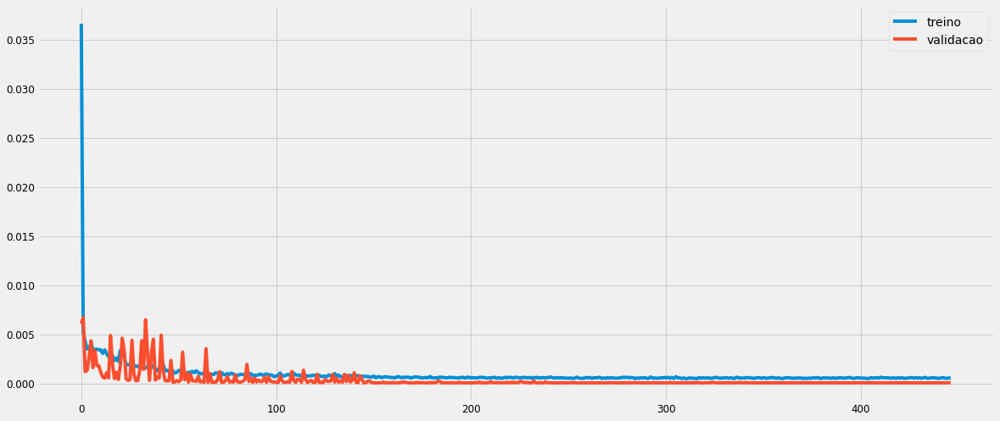

In [758]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [759]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [760]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.7314652 ],
       [0.7334189 ],
       [0.7326784 ],
       [0.73129   ],
       [0.72954094]], dtype=float32)

In [761]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[4583.2554],
       [4595.956 ],
       [4591.142 ],
       [4582.116 ],
       [4570.7456]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

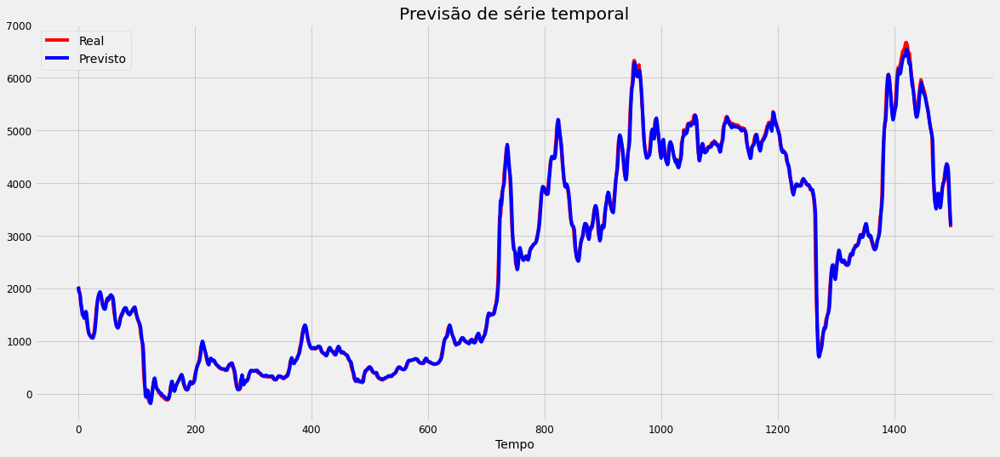

In [762]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

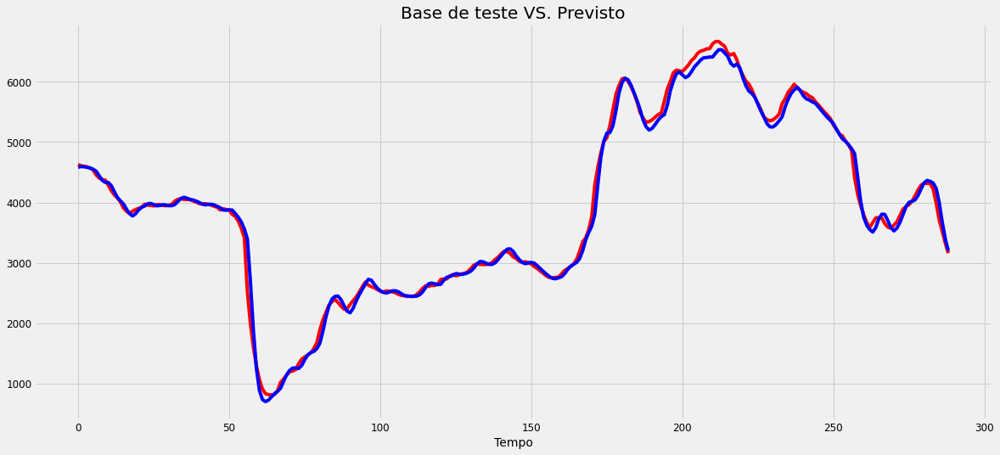

In [763]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [764]:
lstm_p482_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_p482_rmse)
lstm_p482_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_p482_mse)
lstm_p482_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_p482_mape, '%')
lstm_p482_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  115.93633538129707
MSE:  13441.233861644594
MAPE:  2.195364845378387 %
R2:  0.9938419927841948


## C2

### SARIMA

In [765]:
data = baltic.loc[baltic['Route'] == 'C2'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C2'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).C2.mean()
data.head()

Date
2014-01-31    11529.090909
2014-02-28     8076.350000
2014-03-31    12289.761905
2014-04-30     8886.450000
2014-05-31     7994.300000
Freq: M, Name: C2, dtype: float64

#### Divisão da base

In [766]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-01-31 00:00:00', freq='M')

In [767]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-10-31 00:00:00', freq='M')

In [768]:
y = data.copy()
y.tail()

Date
2020-12-31     6664.277778
2021-01-31     9626.550000
2021-02-28     7830.350000
2021-03-31     9431.217391
2021-04-30    11974.733333
Freq: M, Name: C2, dtype: float64

#### Exibição da série

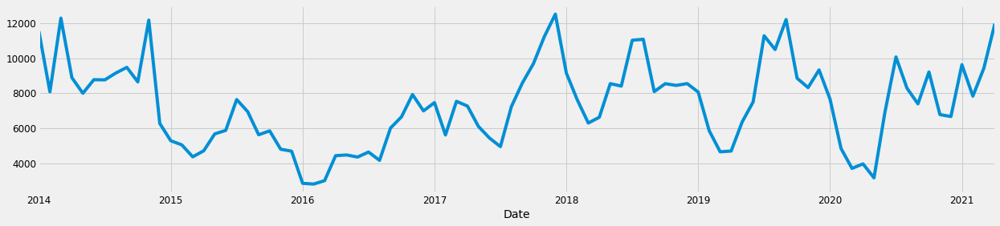

In [769]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

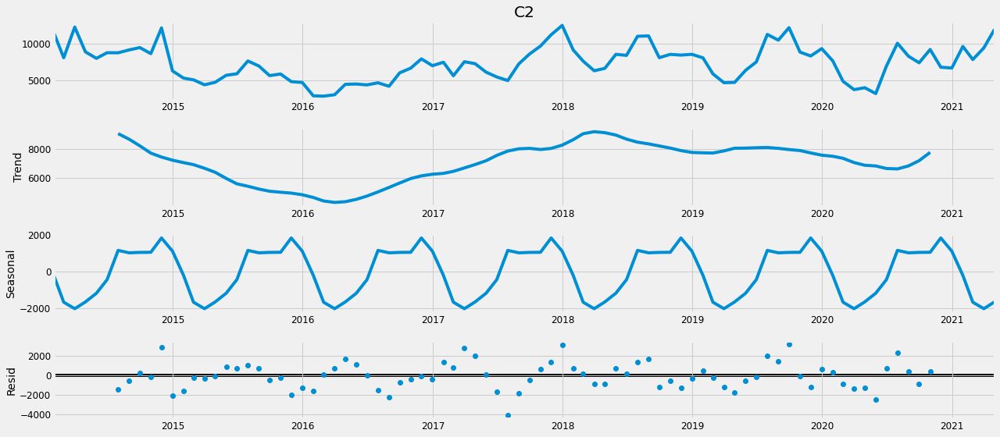

In [770]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [771]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [772]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1805.7735156652539
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1489.7913449050257
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1414.604806547068
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1171.0086882855271
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1433.1767272922255
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1389.1555244996255
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1197.7521560990717
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1172.3393476342799
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1725.878763734176
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1412.5536134915492
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1371.867578727471
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1124.3820420209868
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1407.625064519721
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1348.0587962753677
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1173.6266812536687
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1126.3820348704144
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1532.4302767661188
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1305.3619689689

#### Ajuste considerando o menor valor de AIC

In [773]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5428      0.649      0.837      0.403      -0.729       1.814
ma.L1         -0.6709      0.566     -1.186      0.236      -1.780       0.438
ar.S.L12      -0.0674      0.228     -0.296      0.767      -0.514       0.379
ma.S.L12      -0.6000      0.200     -3.003      0.003      -0.992      -0.208
sigma2       3.09e+06   6.99e+05      4.423      0.000    1.72e+06    4.46e+06


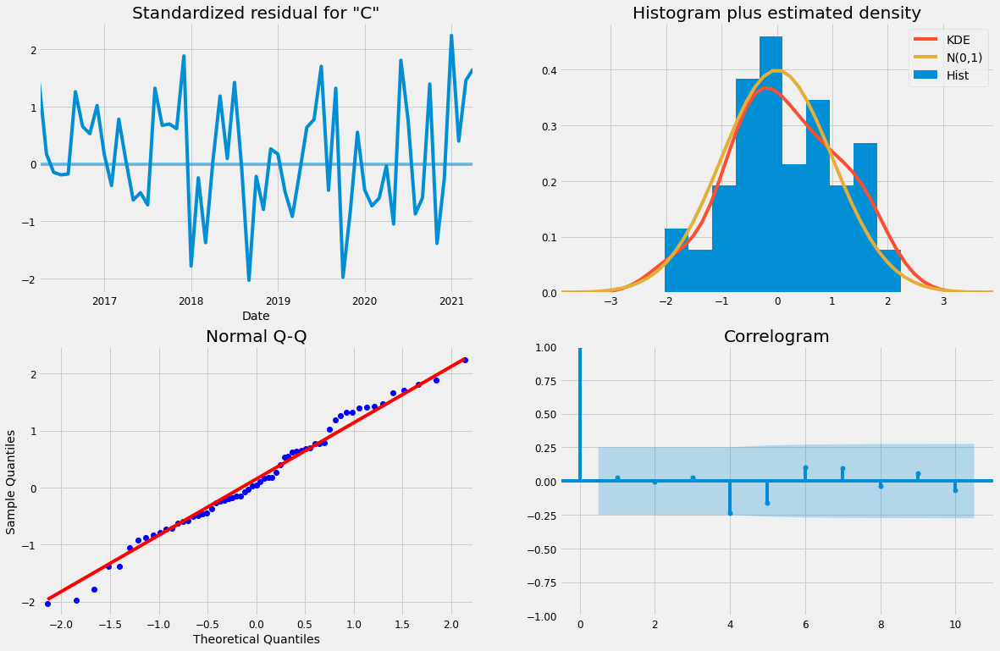

In [774]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

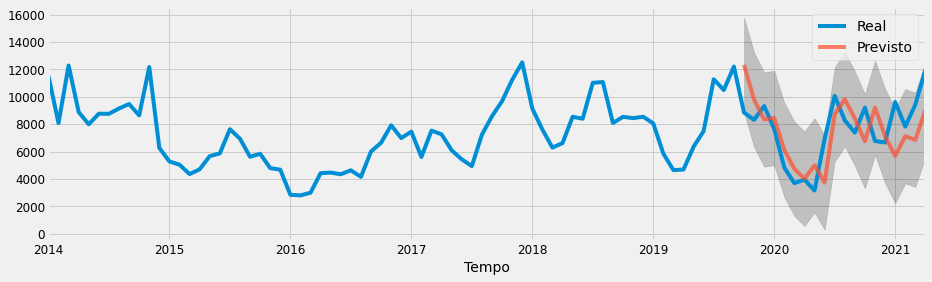

In [775]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [776]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_c2_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_c2_rmse)
sarima_c2_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_c2_mse)
sarima_c2_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_c2_mape, '%')
sarima_c2_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  2062.8209444293925
MSE:  4255230.248776571
MAPE:  24.007309515682092 %
R2:  0.18161870399703162


### LSTM

#### Divisão da base

training_set

In [777]:
temp = baltic.loc[baltic['Route'] == 'C2'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C2'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,C2
8956,2014-01-02,17933.0
8957,2014-01-03,17489.0
8958,2014-01-06,16867.0
8959,2014-01-07,15944.0
8960,2014-01-08,15256.0


In [778]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[17933.],
       [17489.],
       [16867.],
       [15944.],
       [15256.]])

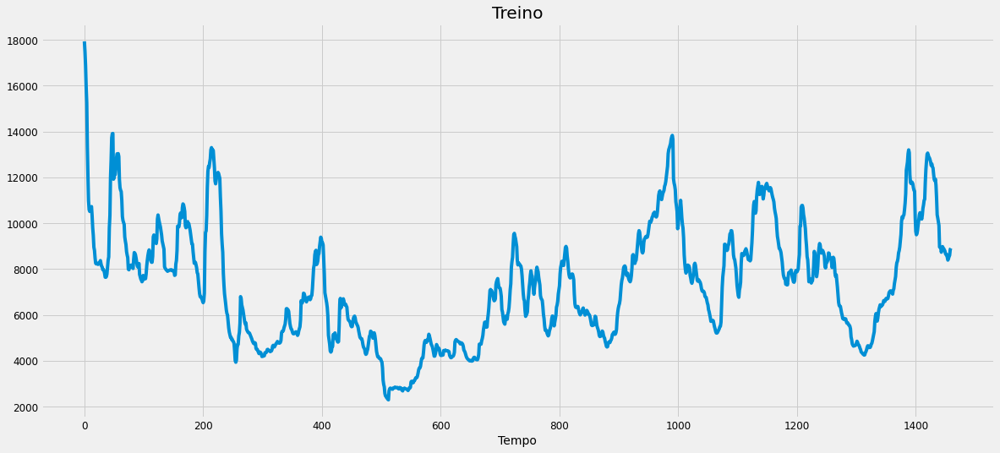

In [779]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [780]:
temp = baltic.loc[baltic['Route'] == 'C2'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C2'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,C2
10416,2019-10-31,8606.0
10417,2019-11-01,8506.0
10418,2019-11-04,8478.0
10419,2019-11-05,8406.0
10420,2019-11-06,8111.0


In [781]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[8606.],
       [8506.],
       [8478.],
       [8406.],
       [8111.]])

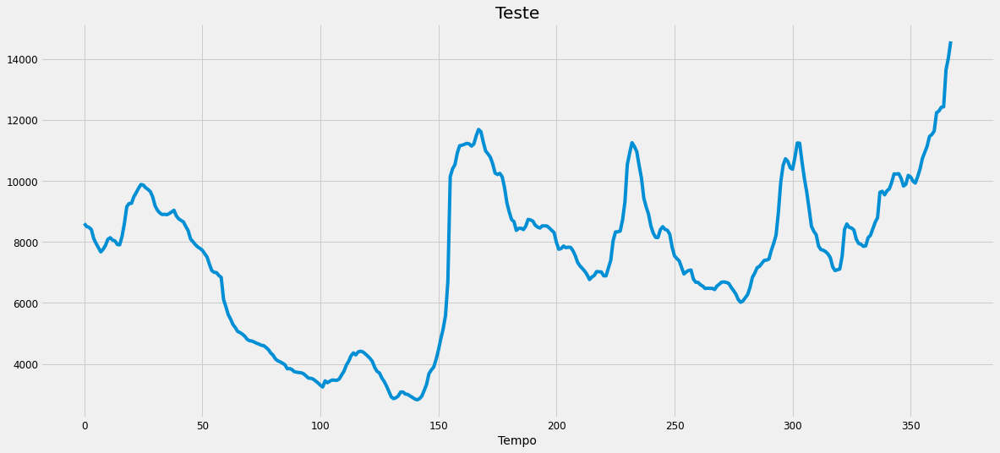

In [782]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [783]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [784]:
training_set_scaled[0:5]

array([[1.        ],
       [0.97159854],
       [0.93181091],
       [0.87276914],
       [0.82875968]])

##### Criar a estrutura de dados

In [785]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [786]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.971599,0.931811,0.872769,0.828760,0.706454,0.624064,0.555108,0.530544,0.525619
1,0.971599,0.931811,0.872769,0.828760,0.706454,0.624064,0.555108,0.530544,0.525619,0.531632
2,0.931811,0.872769,0.828760,0.706454,0.624064,0.555108,0.530544,0.525619,0.531632,0.537325
3,0.872769,0.828760,0.706454,0.624064,0.555108,0.530544,0.525619,0.531632,0.537325,0.539116
4,0.828760,0.706454,0.624064,0.555108,0.530544,0.525619,0.531632,0.537325,0.539116,0.513849


In [787]:
pd.DataFrame(y_train).head()

,0
0,0.531632
1,0.537325
2,0.539116
3,0.513849
4,0.480458


##### *Reshaping*

In [788]:
X_train.shape

(1450, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [789]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [790]:
X_train.shape

(1450, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [791]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_61 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_61 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_62 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_62 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_63 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_63 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_21 (Dense)             (None, 1)               

###### Treinamento

In [792]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1305 samples, validate on 145 samples
Epoch 1/1000
1305/1305 [==============================] - 2s 2ms/step - loss: 0.0200 - val_loss: 0.0056
Epoch 2/1000
1305/1305 [==============================] - 1s 738us/step - loss: 0.0054 - val_loss: 0.0081
Epoch 3/1000
1305/1305 [==============================] - 1s 750us/step - loss: 0.0051 - val_loss: 0.0036
Epoch 4/1000
1305/1305 [==============================] - 1s 745us/step - loss: 0.0049 - val_loss: 0.0033
Epoch 5/1000
1305/1305 [==============================] - 1s 751us/step - loss: 0.0042 - val_loss: 0.0048
Epoch 6/1000
1305/1305 [==============================] - 1s 751us/step - loss: 0.0038 - val_loss: 0.0026
Epoch 7/1000
1305/1305 [==============================] - 1s 792us/step - loss: 0.0034 - val_loss: 0.0023
Epoch 8/1000
1305/1305 [==============================] - 1s 776us/step - loss: 0.0035 - val_loss: 0.0021
Epoch 9/1000
1305/1305 [==============================] - 1s 784us/step - loss: 0.0028 - val_loss: 0.0015
E

Epoch 74/1000
1305/1305 [==============================] - 1s 848us/step - loss: 5.3870e-04 - val_loss: 2.3419e-04
Epoch 75/1000
1305/1305 [==============================] - 1s 884us/step - loss: 5.0704e-04 - val_loss: 2.3287e-04
Epoch 76/1000
1305/1305 [==============================] - 1s 874us/step - loss: 5.9980e-04 - val_loss: 2.3721e-04
Epoch 77/1000
1305/1305 [==============================] - 1s 896us/step - loss: 5.1897e-04 - val_loss: 2.4610e-04
Epoch 78/1000
1305/1305 [==============================] - 1s 828us/step - loss: 5.2097e-04 - val_loss: 2.0656e-04
Epoch 79/1000
1305/1305 [==============================] - 1s 840us/step - loss: 5.8850e-04 - val_loss: 2.2048e-04
Epoch 80/1000
1305/1305 [==============================] - 1s 850us/step - loss: 6.0547e-04 - val_loss: 2.2825e-04
Epoch 81/1000
1305/1305 [==============================] - 1s 852us/step - loss: 5.4648e-04 - val_loss: 5.1956e-04
Epoch 82/1000
1305/1305 [==============================] - 1s 835us/step - loss:

Epoch 145/1000
1305/1305 [==============================] - 1s 861us/step - loss: 4.1270e-04 - val_loss: 1.9776e-04
Epoch 146/1000
1305/1305 [==============================] - 1s 838us/step - loss: 4.2180e-04 - val_loss: 2.0120e-04
Epoch 147/1000
1305/1305 [==============================] - 1s 903us/step - loss: 4.2066e-04 - val_loss: 2.8642e-04
Epoch 148/1000
1305/1305 [==============================] - 1s 875us/step - loss: 4.4072e-04 - val_loss: 1.8955e-04
Epoch 149/1000
1305/1305 [==============================] - 1s 897us/step - loss: 4.6104e-04 - val_loss: 1.9360e-04
Epoch 150/1000
1305/1305 [==============================] - 1s 846us/step - loss: 4.4848e-04 - val_loss: 2.8841e-04
Epoch 151/1000
1305/1305 [==============================] - 1s 849us/step - loss: 4.3776e-04 - val_loss: 2.2017e-04
Epoch 152/1000
1305/1305 [==============================] - 1s 847us/step - loss: 4.0867e-04 - val_loss: 2.7778e-04
Epoch 153/1000
1305/1305 [==============================] - 1s 839us/ste

1305/1305 [==============================] - 1s 841us/step - loss: 3.3849e-04 - val_loss: 1.8360e-04
Epoch 216/1000
1305/1305 [==============================] - 1s 845us/step - loss: 3.5072e-04 - val_loss: 1.9477e-04
Epoch 217/1000
1305/1305 [==============================] - 1s 835us/step - loss: 3.3820e-04 - val_loss: 2.1437e-04
Epoch 218/1000
1305/1305 [==============================] - 1s 890us/step - loss: 3.8062e-04 - val_loss: 2.1988e-04
Epoch 219/1000
1305/1305 [==============================] - 1s 877us/step - loss: 3.5659e-04 - val_loss: 2.2886e-04
Epoch 220/1000
1305/1305 [==============================] - 1s 893us/step - loss: 3.6846e-04 - val_loss: 1.9508e-04
Epoch 221/1000
1305/1305 [==============================] - 1s 839us/step - loss: 3.3652e-04 - val_loss: 1.9714e-04
Epoch 222/1000
1305/1305 [==============================] - 1s 841us/step - loss: 3.5992e-04 - val_loss: 1.8368e-04
Epoch 223/1000
1305/1305 [==============================] - 1s 832us/step - loss: 3.707

Epoch 286/1000
1305/1305 [==============================] - 1s 848us/step - loss: 3.4549e-04 - val_loss: 1.9632e-04
Epoch 287/1000
1305/1305 [==============================] - 1s 827us/step - loss: 3.6268e-04 - val_loss: 1.9020e-04
Epoch 288/1000
1305/1305 [==============================] - 1s 840us/step - loss: 3.4512e-04 - val_loss: 2.0795e-04
Epoch 289/1000
1305/1305 [==============================] - 1s 886us/step - loss: 3.6024e-04 - val_loss: 1.9385e-04
Epoch 290/1000
1305/1305 [==============================] - 1s 872us/step - loss: 3.3444e-04 - val_loss: 1.9509e-04
Epoch 291/1000
1305/1305 [==============================] - 1s 884us/step - loss: 3.6377e-04 - val_loss: 1.9031e-04
Epoch 292/1000
1305/1305 [==============================] - 1s 925us/step - loss: 3.3324e-04 - val_loss: 1.9003e-04
Epoch 293/1000
1305/1305 [==============================] - 1s 875us/step - loss: 3.5895e-04 - val_loss: 1.9167e-04
Epoch 294/1000
1305/1305 [==============================] - 1s 888us/ste

1305/1305 [==============================] - 1s 840us/step - loss: 3.0434e-04 - val_loss: 1.9660e-04
Epoch 357/1000
1305/1305 [==============================] - 1s 877us/step - loss: 3.5587e-04 - val_loss: 2.0129e-04


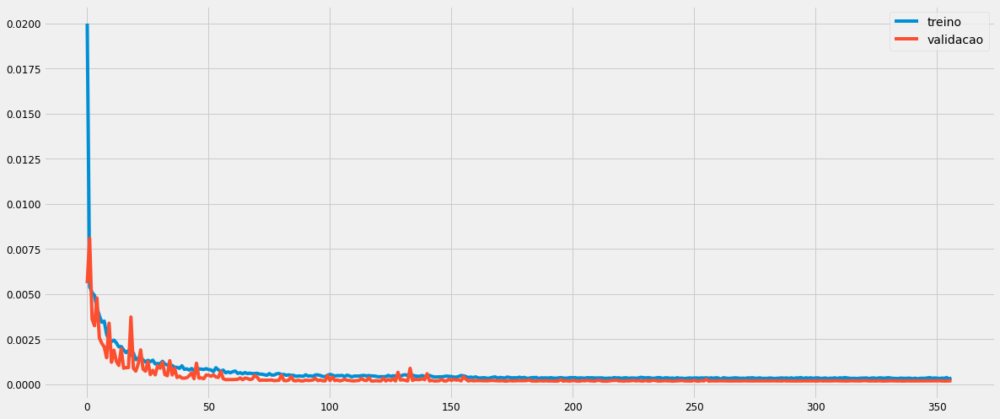

In [793]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [794]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [795]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.42403868],
       [0.3939771 ],
       [0.3915527 ],
       [0.39306498],
       [0.38665882]], dtype=float32)

In [796]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[8928.997],
       [8459.044],
       [8421.143],
       [8444.784],
       [8344.638]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

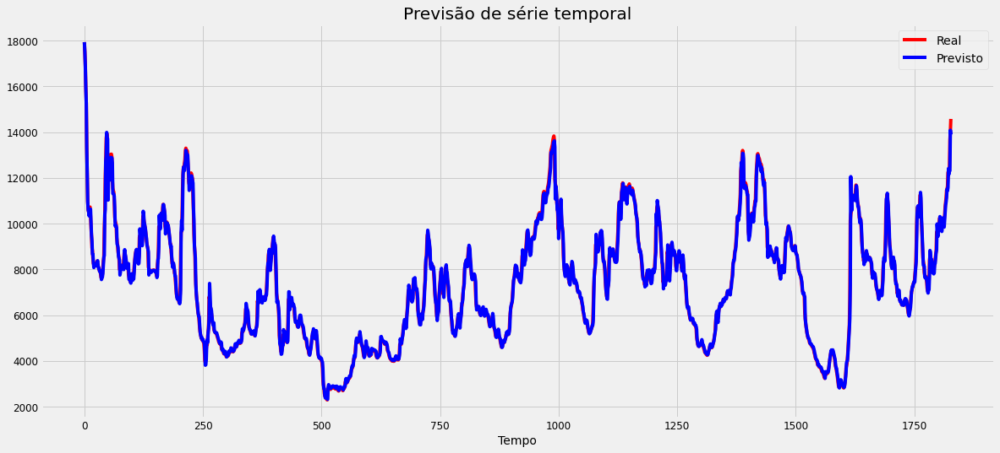

In [797]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

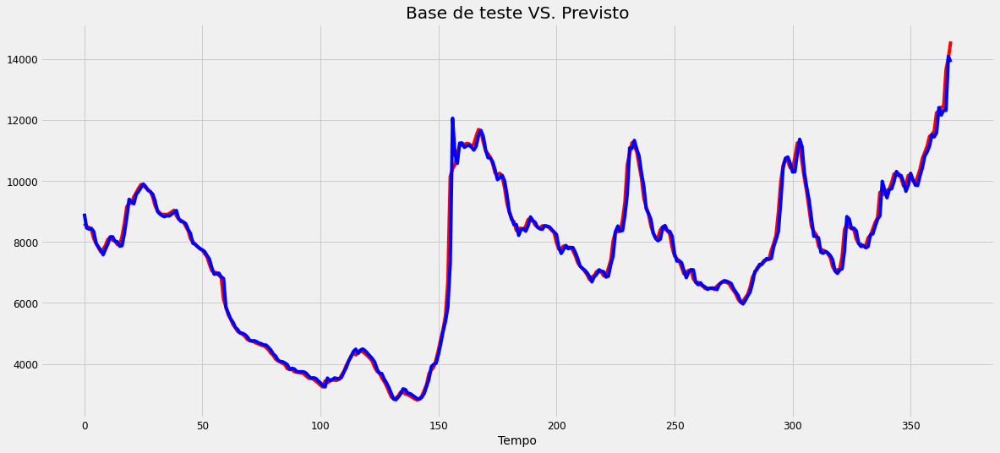

In [798]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [799]:
lstm_c2_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_c2_rmse)
lstm_c2_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_c2_mse)
lstm_c2_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_c2_mape, '%')
lstm_c2_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  259.2802001860951
MSE:  67226.22220854154
MAPE:  1.7682883866336585 %
R2:  0.9893117591998353


## C3

### SARIMA

In [800]:
data = baltic.loc[baltic['Route'] == 'C3'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C3'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).C3.mean()
data.head()

Date
2014-01-31    21451.409091
2014-02-28    19606.150000
2014-03-31    25850.714286
2014-04-30    19885.250000
2014-05-31    19469.800000
Freq: M, Name: C3, dtype: float64

#### Divisão da base

In [801]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-01-31 00:00:00', freq='M')

In [802]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-10-31 00:00:00', freq='M')

In [803]:
y = data.copy()
y.tail()

Date
2020-12-31    13926.944444
2021-01-31    18285.500000
2021-02-28    16309.450000
2021-03-31    19294.608696
2021-04-30    24278.866667
Freq: M, Name: C3, dtype: float64

#### Exibição da série

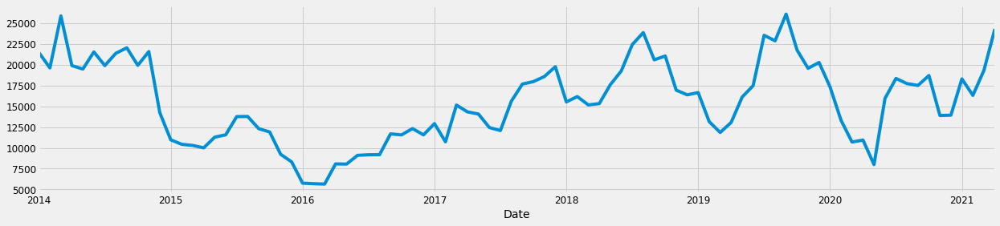

In [804]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

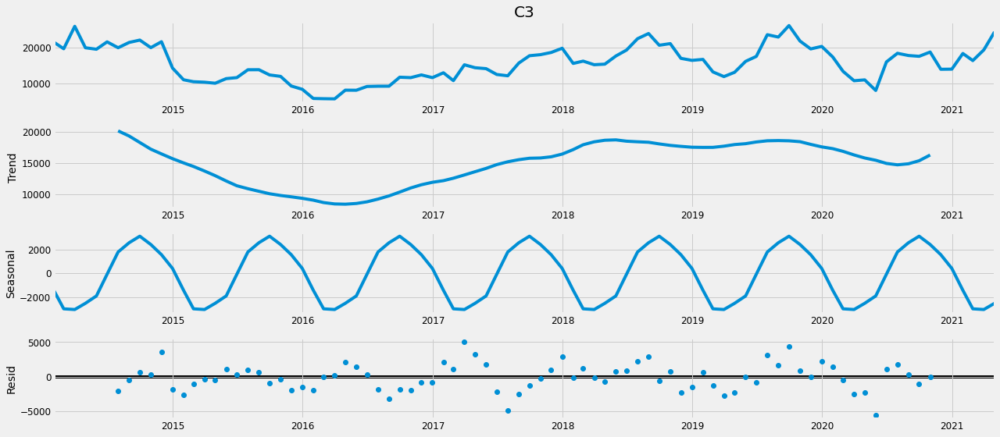

In [805]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [806]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [807]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1935.4941212246101
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1631.3512465811725
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1517.0627516833265
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1252.4121835701683
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1534.5575771157728
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1480.2452229386809
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1274.2981245041005
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1252.294045349877
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1850.668203667067
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1586.7771421066548
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1463.036646059636
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1200.9891002979937
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1622.1260020142124
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1579.8444266099582
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1256.7751691715093
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1215.6077521224593
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1600.993015924858
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1368.3524453155

#### Ajuste considerando o menor valor de AIC

In [808]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5885      1.123     -0.524      0.600      -2.789       1.612
ma.L1          0.4773      1.269      0.376      0.707      -2.009       2.964
ar.S.L12      -0.2307      0.300     -0.769      0.442      -0.818       0.357
ma.S.L12      -0.4974      0.197     -2.531      0.011      -0.883      -0.112
sigma2      9.547e+06   2.65e+06      3.604      0.000    4.35e+06    1.47e+07


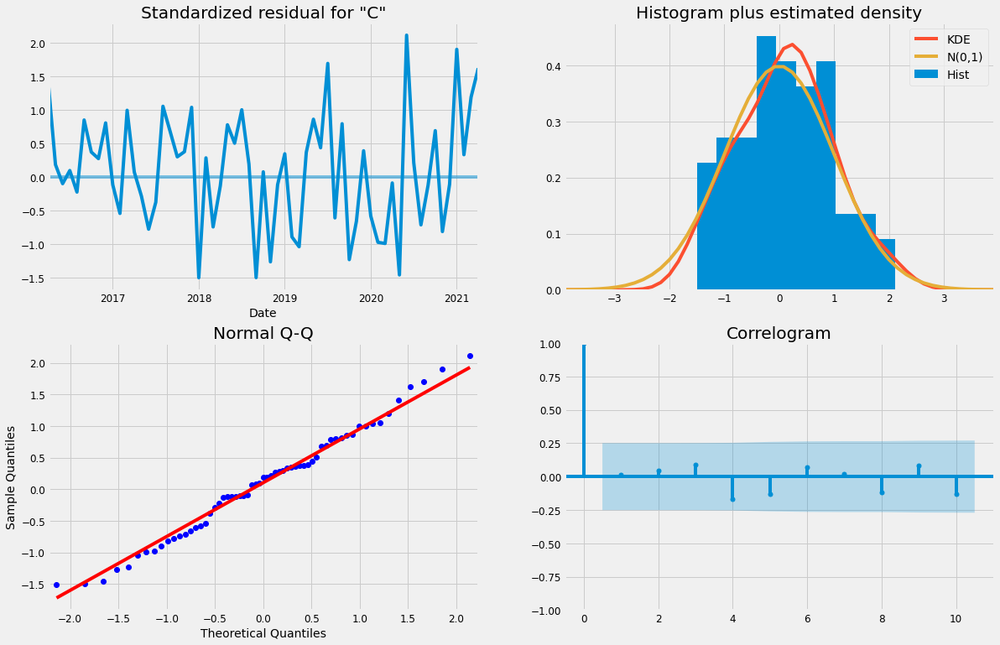

In [809]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

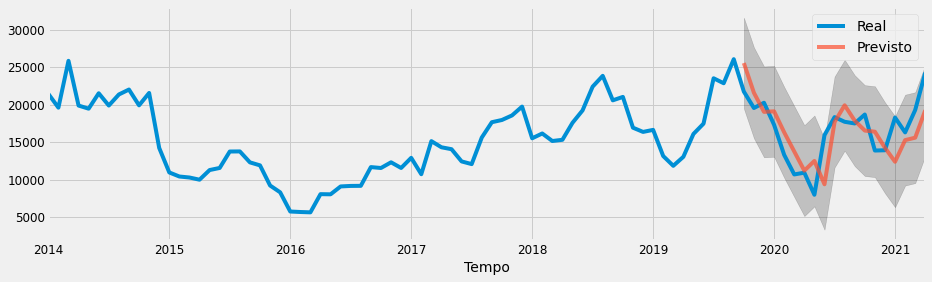

In [810]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [811]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_c3_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_c3_rmse)
sarima_c3_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_c3_mse)
sarima_c3_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_c3_mape, '%')
sarima_c3_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  3211.961452082453
MSE:  10316696.36966362
MAPE:  17.042559254511865 %
R2:  0.334329007568985


### LSTM

#### Divisão da base

training_set

In [812]:
temp = baltic.loc[baltic['Route'] == 'C3'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C3'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,C3
10784,2014-01-02,28886.0
10785,2014-01-03,27773.0
10786,2014-01-06,25350.0
10787,2014-01-07,22436.0
10788,2014-01-08,21691.0


In [813]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[28886.],
       [27773.],
       [25350.],
       [22436.],
       [21691.]])

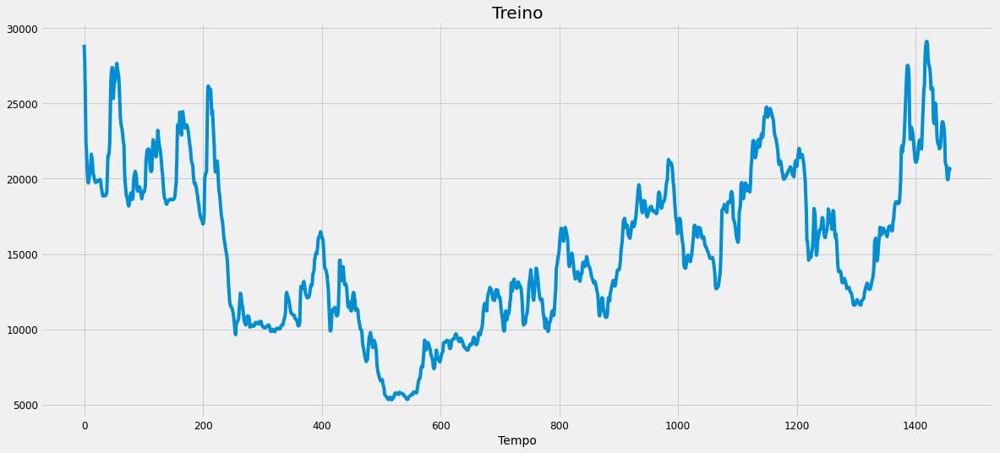

In [814]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [815]:
temp = baltic.loc[baltic['Route'] == 'C3'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C3'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,C3
12244,2019-10-31,20590.0
12245,2019-11-01,20420.0
12246,2019-11-04,20290.0
12247,2019-11-05,20040.0
12248,2019-11-06,18680.0


In [816]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[20590.],
       [20420.],
       [20290.],
       [20040.],
       [18680.]])

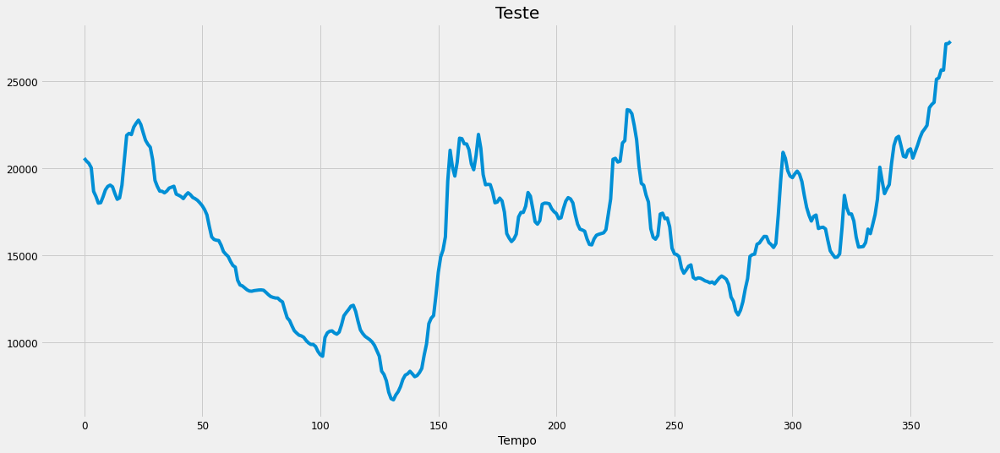

In [817]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [818]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [819]:
training_set_scaled[0:5]

array([[0.9905823 ],
       [0.9437881 ],
       [0.84191717],
       [0.71940299],
       [0.68808072]])

##### Criar a estrutura de dados

In [820]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [821]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.990582,0.943788,0.841917,0.719403,0.688081,0.645449,0.614673,0.604961,0.616229,0.624049
1,0.943788,0.841917,0.719403,0.688081,0.645449,0.614673,0.604961,0.616229,0.624049,0.634938
2,0.841917,0.719403,0.688081,0.645449,0.614673,0.604961,0.616229,0.624049,0.634938,0.657137
3,0.719403,0.688081,0.645449,0.614673,0.604961,0.616229,0.624049,0.634938,0.657137,0.685222
4,0.688081,0.645449,0.614673,0.604961,0.616229,0.624049,0.634938,0.657137,0.685222,0.676603


In [822]:
pd.DataFrame(y_train).head()

,0
0,0.634938
1,0.657137
2,0.685222
3,0.676603
4,0.661131


##### *Reshaping*

In [823]:
X_train.shape

(1450, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [824]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [825]:
X_train.shape

(1450, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [826]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_64 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_64 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_65 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_65 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_66 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_66 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_22 (Dense)             (None, 1)               

###### Treinamento

In [827]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1305 samples, validate on 145 samples
Epoch 1/1000
1305/1305 [==============================] - 2s 2ms/step - loss: 0.0280 - val_loss: 0.0085
Epoch 2/1000
1305/1305 [==============================] - 1s 899us/step - loss: 0.0054 - val_loss: 0.0077
Epoch 3/1000
1305/1305 [==============================] - 1s 919us/step - loss: 0.0057 - val_loss: 0.0068
Epoch 4/1000
1305/1305 [==============================] - 1s 919us/step - loss: 0.0050 - val_loss: 0.0096
Epoch 5/1000
1305/1305 [==============================] - 1s 956us/step - loss: 0.0052 - val_loss: 0.0079
Epoch 6/1000
1305/1305 [==============================] - 1s 985us/step - loss: 0.0053 - val_loss: 0.0076
Epoch 7/1000
1305/1305 [==============================] - 1s 963us/step - loss: 0.0046 - val_loss: 0.0068
Epoch 8/1000
1305/1305 [==============================] - 1s 910us/step - loss: 0.0047 - val_loss: 0.0055
Epoch 9/1000
1305/1305 [==============================] - 1s 909us/step - loss: 0.0046 - val_loss: 0.0047
E

1305/1305 [==============================] - 1s 1ms/step - loss: 9.2587e-04 - val_loss: 6.8836e-04
Epoch 77/1000
1305/1305 [==============================] - 1s 894us/step - loss: 9.7842e-04 - val_loss: 6.8333e-04
Epoch 78/1000
1305/1305 [==============================] - 1s 879us/step - loss: 8.8712e-04 - val_loss: 7.0690e-04
Epoch 79/1000
1305/1305 [==============================] - 1s 886us/step - loss: 9.8015e-04 - val_loss: 0.0014
Epoch 80/1000
1305/1305 [==============================] - 1s 885us/step - loss: 9.4665e-04 - val_loss: 7.2359e-04
Epoch 81/1000
1305/1305 [==============================] - 1s 876us/step - loss: 9.4958e-04 - val_loss: 8.6113e-04
Epoch 82/1000
1305/1305 [==============================] - 1s 878us/step - loss: 8.3397e-04 - val_loss: 6.3315e-04
Epoch 83/1000
1305/1305 [==============================] - 1s 889us/step - loss: 8.6515e-04 - val_loss: 5.3314e-04
Epoch 84/1000
1305/1305 [==============================] - 1s 920us/step - loss: 8.6656e-04 - val_lo

1305/1305 [==============================] - 1s 888us/step - loss: 6.7024e-04 - val_loss: 5.2240e-04
Epoch 148/1000
1305/1305 [==============================] - 1s 920us/step - loss: 6.4904e-04 - val_loss: 8.6292e-04
Epoch 149/1000
1305/1305 [==============================] - 1s 877us/step - loss: 6.4194e-04 - val_loss: 4.7102e-04
Epoch 150/1000
1305/1305 [==============================] - 1s 897us/step - loss: 6.5868e-04 - val_loss: 4.9820e-04
Epoch 151/1000
1305/1305 [==============================] - 1s 882us/step - loss: 6.0337e-04 - val_loss: 5.5266e-04
Epoch 152/1000
1305/1305 [==============================] - 1s 944us/step - loss: 6.4197e-04 - val_loss: 5.2104e-04
Epoch 153/1000
1305/1305 [==============================] - 1s 980us/step - loss: 7.3733e-04 - val_loss: 0.0016
Epoch 154/1000
1305/1305 [==============================] - 1s 958us/step - loss: 6.5293e-04 - val_loss: 5.1737e-04
Epoch 155/1000
1305/1305 [==============================] - 1s 907us/step - loss: 6.4989e-0

Epoch 218/1000
1305/1305 [==============================] - 1s 937us/step - loss: 5.1493e-04 - val_loss: 5.0655e-04
Epoch 219/1000
1305/1305 [==============================] - 1s 970us/step - loss: 5.7922e-04 - val_loss: 4.7761e-04
Epoch 220/1000
1305/1305 [==============================] - 1s 967us/step - loss: 4.9204e-04 - val_loss: 4.8210e-04
Epoch 221/1000
1305/1305 [==============================] - 1s 922us/step - loss: 4.8987e-04 - val_loss: 6.2142e-04
Epoch 222/1000
1305/1305 [==============================] - 1s 923us/step - loss: 5.2258e-04 - val_loss: 5.0841e-04
Epoch 223/1000
1305/1305 [==============================] - 1s 912us/step - loss: 5.2785e-04 - val_loss: 4.8962e-04
Epoch 224/1000
1305/1305 [==============================] - 1s 910us/step - loss: 5.2004e-04 - val_loss: 4.7502e-04
Epoch 225/1000
1305/1305 [==============================] - 1s 885us/step - loss: 5.0808e-04 - val_loss: 5.0206e-04
Epoch 226/1000
1305/1305 [==============================] - 1s 878us/ste

1305/1305 [==============================] - 1s 935us/step - loss: 5.4803e-04 - val_loss: 4.9143e-04
Epoch 289/1000
1305/1305 [==============================] - 1s 887us/step - loss: 4.9938e-04 - val_loss: 4.8077e-04
Epoch 290/1000
1305/1305 [==============================] - 1s 882us/step - loss: 4.5043e-04 - val_loss: 4.9164e-04
Epoch 291/1000
1305/1305 [==============================] - 1s 890us/step - loss: 4.9871e-04 - val_loss: 5.0910e-04
Epoch 292/1000
1305/1305 [==============================] - 1s 874us/step - loss: 4.5101e-04 - val_loss: 4.9030e-04
Epoch 293/1000
1305/1305 [==============================] - 1s 882us/step - loss: 5.3487e-04 - val_loss: 5.0724e-04
Epoch 294/1000
1305/1305 [==============================] - 1s 901us/step - loss: 4.7375e-04 - val_loss: 5.0312e-04
Epoch 295/1000
1305/1305 [==============================] - 1s 873us/step - loss: 4.9715e-04 - val_loss: 5.0313e-04
Epoch 296/1000
1305/1305 [==============================] - 1s 885us/step - loss: 5.026

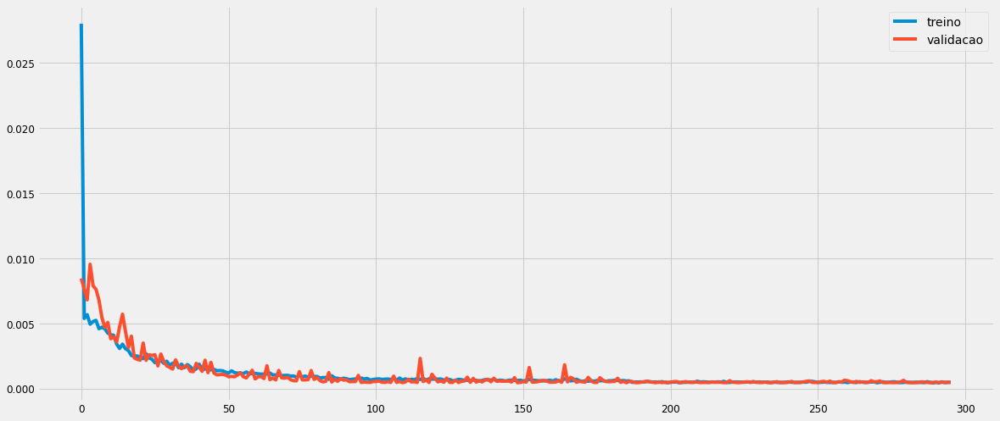

In [828]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [829]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [830]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.64757675],
       [0.6357213 ],
       [0.62997794],
       [0.62510073],
       [0.61114234]], dtype=float32)

In [831]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[20727.613],
       [20445.63 ],
       [20309.025],
       [20193.021],
       [19861.02 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

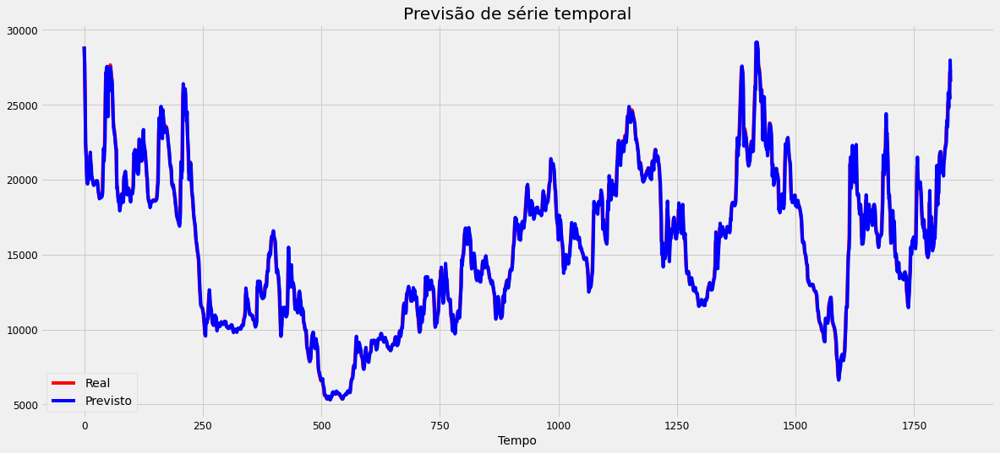

In [832]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

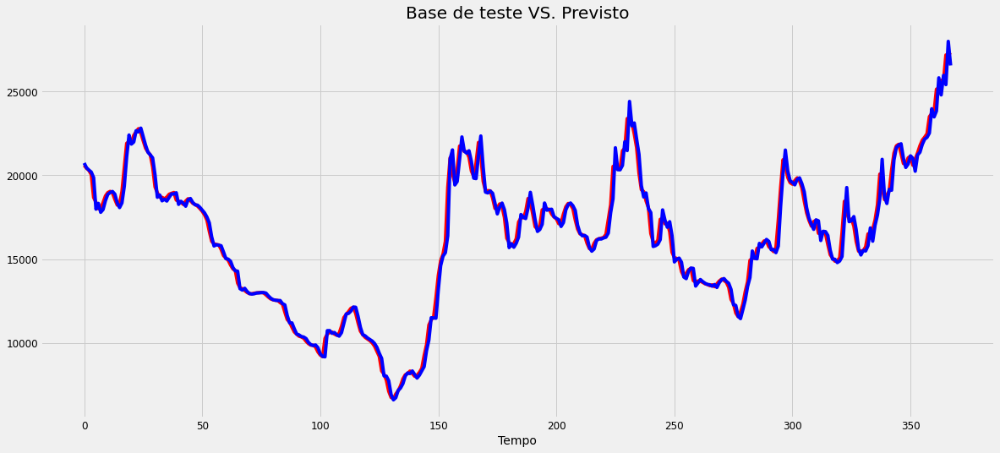

In [833]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [834]:
lstm_c3_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_c3_rmse)
lstm_c3_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_c3_mse)
lstm_c3_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_c3_mape, '%')
lstm_c3_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  504.2846237808258
MSE:  254302.98178176905
MAPE:  1.9761627841377978 %
R2:  0.9851983255212088


## C5

### SARIMA

In [835]:
data = baltic.loc[baltic['Route'] == 'C5'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C5'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).C5.mean()
data.head()

Date
2014-01-31     8097.181818
2014-02-28     8118.200000
2014-03-31    10467.333333
2014-04-30     8304.200000
2014-05-31     7651.900000
Freq: M, Name: C5, dtype: float64

#### Divisão da base

In [836]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-01-31 00:00:00', freq='M')

In [837]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-10-31 00:00:00', freq='M')

In [838]:
y = data.copy()
y.tail()

Date
2020-12-31     7157.833333
2021-01-31     8343.300000
2021-02-28     6497.900000
2021-03-31     8953.826087
2021-04-30    11016.466667
Freq: M, Name: C5, dtype: float64

#### Exibição da série

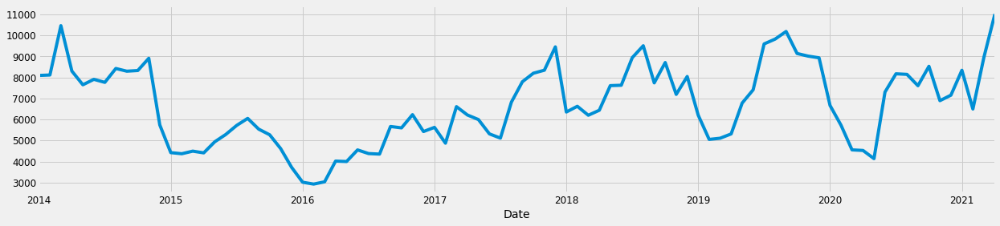

In [839]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

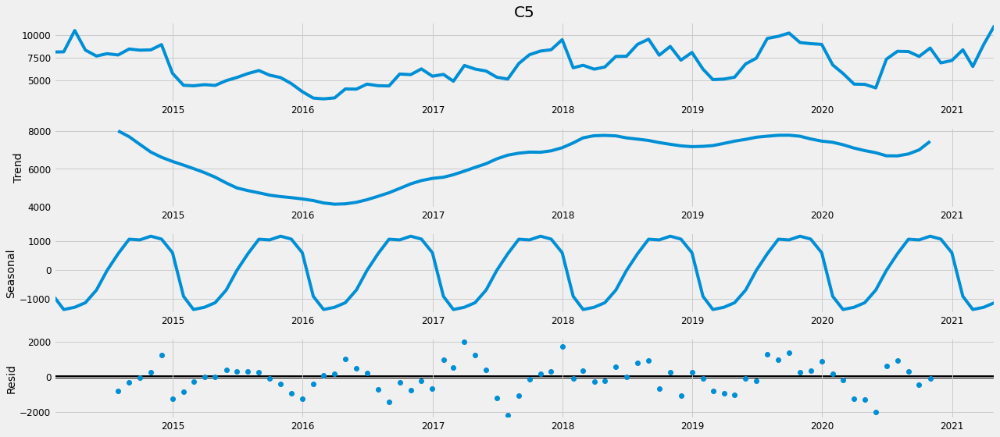

In [840]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [841]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [842]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1787.670443377659
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1470.7959796671705
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1369.699103777573
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1133.973041926229
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1388.7816308634178
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1333.6675769965577
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1153.4582848915131
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1131.67742225698
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1707.0510950600674
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1388.7686922320397
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1319.5472989392424
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1090.3114124148356
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1356.8475193105119
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1287.8269699117423
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1130.9327227060394
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1092.2335392468299
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1456.169755692157
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1247.539363182281

#### Ajuste considerando o menor valor de AIC

In [843]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4820      0.476     -1.014      0.311      -1.414       0.450
ma.L1          0.2503      0.562      0.445      0.656      -0.852       1.352
ar.S.L12       0.0130      0.378      0.035      0.972      -0.727       0.753
ma.S.L12      -0.6279      0.294     -2.134      0.033      -1.205      -0.051
sigma2       1.42e+06   2.93e+05      4.840      0.000    8.45e+05    1.99e+06


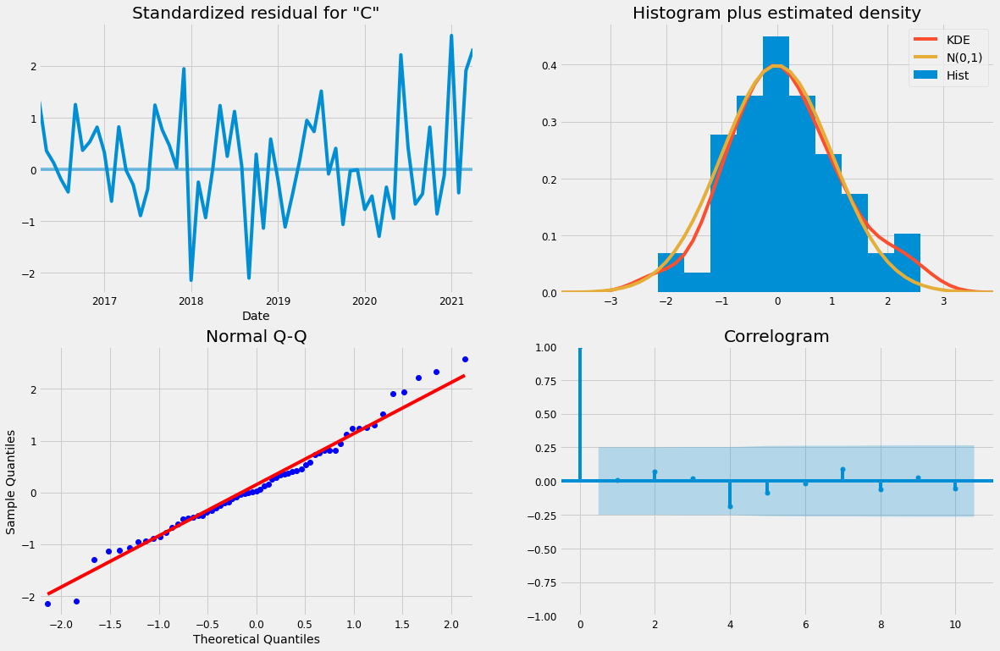

In [844]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

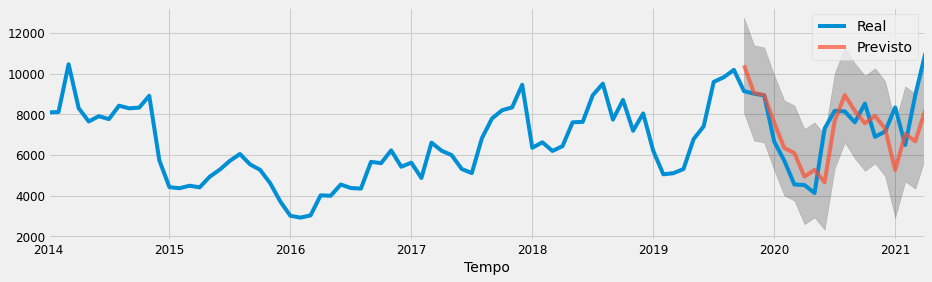

In [845]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [846]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_c5_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_c5_rmse)
sarima_c5_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_c5_mse)
sarima_c5_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_c5_mape, '%')
sarima_c5_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  1444.2813786626587
MSE:  2085948.70075171
MAPE:  15.453573223828462 %
R2:  0.3207844859414012


### LSTM

#### Divisão da base

training_set

In [847]:
temp = baltic.loc[baltic['Route'] == 'C5'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C5'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,C5
12612,2014-01-02,11700.0
12613,2014-01-03,11036.0
12614,2014-01-06,10486.0
12615,2014-01-07,9614.0
12616,2014-01-08,8441.0


In [848]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[11700.],
       [11036.],
       [10486.],
       [ 9614.],
       [ 8441.]])

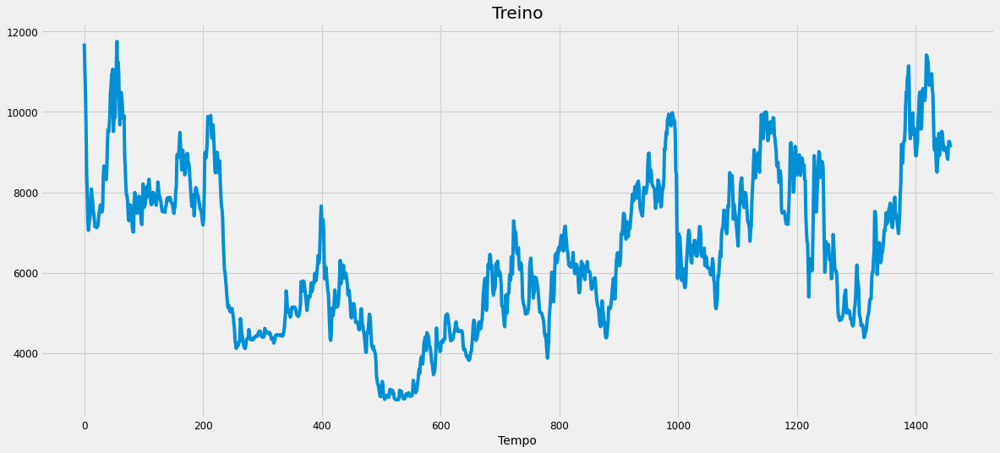

In [849]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [850]:
temp = baltic.loc[baltic['Route'] == 'C5'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C5'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,C5
14072,2019-10-31,8927.0
14073,2019-11-01,9032.0
14074,2019-11-04,9214.0
14075,2019-11-05,9523.0
14076,2019-11-06,8955.0


In [851]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[8927.],
       [9032.],
       [9214.],
       [9523.],
       [8955.]])

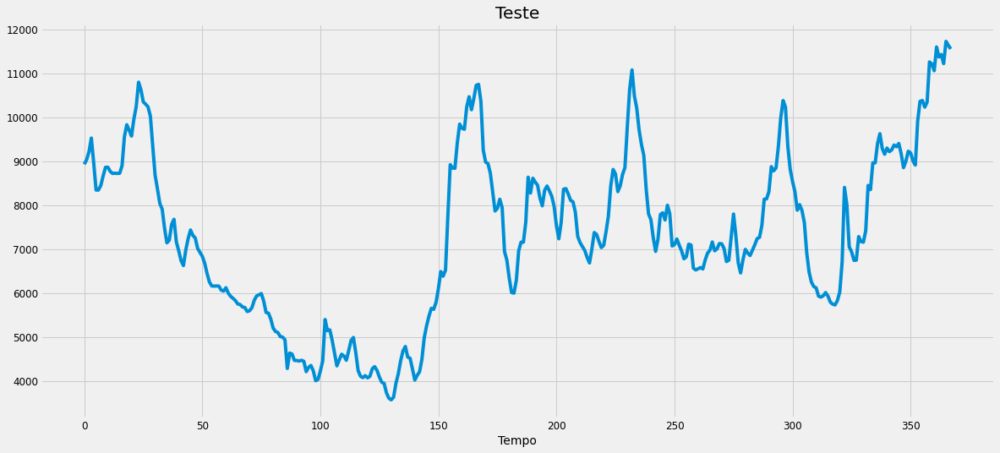

In [852]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [853]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [854]:
training_set_scaled[0:5]

array([[0.99382855],
       [0.91932226],
       [0.85760772],
       [0.75976212],
       [0.62814183]])

##### Criar a estrutura de dados

In [855]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [856]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.993829,0.919322,0.857608,0.759762,0.628142,0.581239,0.496073,0.472621,0.489452,0.502132
1,0.919322,0.857608,0.759762,0.628142,0.581239,0.496073,0.472621,0.489452,0.502132,0.514924
2,0.857608,0.759762,0.628142,0.581239,0.496073,0.472621,0.489452,0.502132,0.514924,0.560256
3,0.759762,0.628142,0.581239,0.496073,0.472621,0.489452,0.502132,0.514924,0.560256,0.588308
4,0.628142,0.581239,0.496073,0.472621,0.489452,0.502132,0.514924,0.560256,0.588308,0.568447


In [857]:
pd.DataFrame(y_train).head()

,0
0,0.514924
1,0.560256
2,0.588308
3,0.568447
4,0.556777


##### *Reshaping*

In [858]:
X_train.shape

(1450, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [859]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [860]:
X_train.shape

(1450, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [861]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_67 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_67 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_68 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_68 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_69 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_69 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_23 (Dense)             (None, 1)               

###### Treinamento

In [862]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1305 samples, validate on 145 samples
Epoch 1/1000
1305/1305 [==============================] - 2s 2ms/step - loss: 0.0290 - val_loss: 0.0107
Epoch 2/1000
1305/1305 [==============================] - 1s 854us/step - loss: 0.0070 - val_loss: 0.0126
Epoch 3/1000
1305/1305 [==============================] - 1s 810us/step - loss: 0.0070 - val_loss: 0.0087
Epoch 4/1000
1305/1305 [==============================] - 1s 903us/step - loss: 0.0076 - val_loss: 0.0066
Epoch 5/1000
1305/1305 [==============================] - 1s 861us/step - loss: 0.0066 - val_loss: 0.0066
Epoch 6/1000
1305/1305 [==============================] - 1s 869us/step - loss: 0.0066 - val_loss: 0.0058
Epoch 7/1000
1305/1305 [==============================] - 1s 795us/step - loss: 0.0061 - val_loss: 0.0118
Epoch 8/1000
1305/1305 [==============================] - 1s 793us/step - loss: 0.0059 - val_loss: 0.0059
Epoch 9/1000
1305/1305 [==============================] - 1s 793us/step - loss: 0.0058 - val_loss: 0.0065
E

1305/1305 [==============================] - 1s 871us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 78/1000
1305/1305 [==============================] - 1s 870us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 79/1000
1305/1305 [==============================] - 1s 888us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 80/1000
1305/1305 [==============================] - 1s 893us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 81/1000
1305/1305 [==============================] - 1s 876us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 82/1000
1305/1305 [==============================] - 1s 868us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 83/1000
1305/1305 [==============================] - 1s 874us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 84/1000
1305/1305 [==============================] - 1s 890us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 85/1000
1305/1305 [==============================] - 1s 941us/step - loss: 0.0013 - val_loss: 9.9768e-04
Epoch 86/1000
1305/1305 [======================

1305/1305 [==============================] - 1s 885us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 153/1000
1305/1305 [==============================] - 1s 873us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 154/1000
1305/1305 [==============================] - 1s 946us/step - loss: 9.9371e-04 - val_loss: 0.0011
Epoch 155/1000
1305/1305 [==============================] - 1s 935us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 156/1000
1305/1305 [==============================] - 1s 876us/step - loss: 0.0012 - val_loss: 0.0027
Epoch 157/1000
1305/1305 [==============================] - 1s 879us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 158/1000
1305/1305 [==============================] - 1s 874us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 159/1000
1305/1305 [==============================] - 1s 867us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 160/1000
1305/1305 [==============================] - 1s 881us/step - loss: 0.0011 - val_loss: 0.0010
Epoch 161/1000
1305/1305 [=============

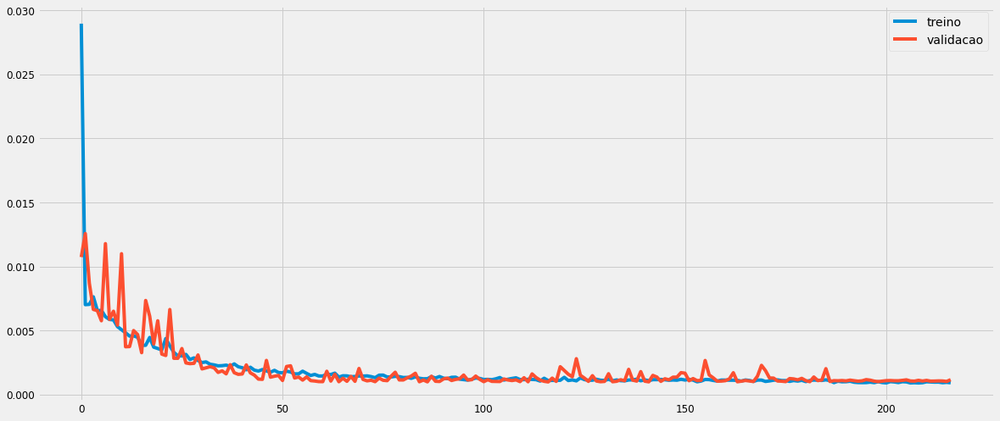

In [863]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [864]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [865]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.692901 ],
       [0.6661177],
       [0.6906664],
       [0.709429 ],
       [0.744488 ]], dtype=float32)

In [866]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[9018.134],
       [8779.441],
       [8998.219],
       [9165.432],
       [9477.877]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

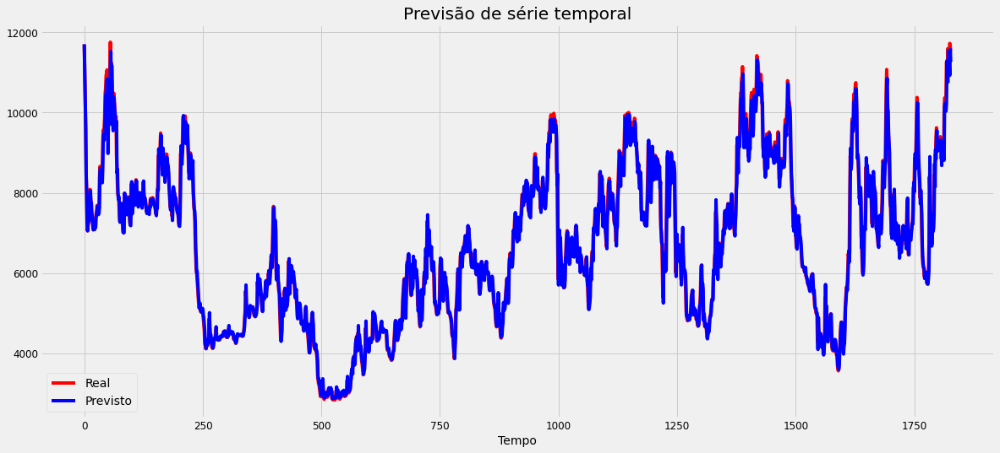

In [867]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

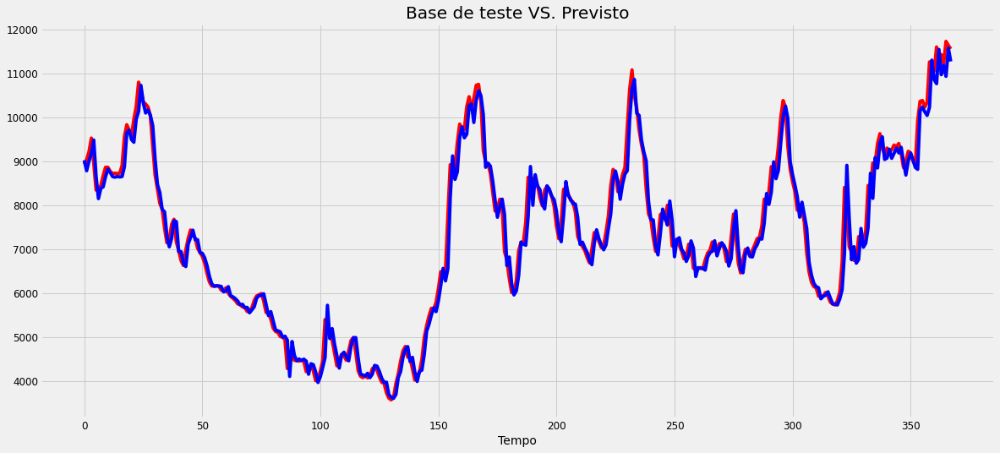

In [868]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [869]:
lstm_C5_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_C5_rmse)
lstm_C5_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_C5_mse)
lstm_C5_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_C5_mape, '%')
lstm_C5_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  316.06020052684505
MSE:  99894.0503570695
MAPE:  3.0106371391530615 %
R2:  0.9728292569681511


## C7

### SARIMA

In [870]:
data = baltic.loc[baltic['Route'] == 'C7'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C7'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).C7.mean()
data.head()

Date
2014-01-31    12537.318182
2014-02-28     8837.000000
2014-03-31    12617.523810
2014-04-30     9116.200000
2014-05-31     9221.850000
Freq: M, Name: C7, dtype: float64

#### Divisão da base

In [871]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-01-31 00:00:00', freq='M')

In [872]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-10-31 00:00:00', freq='M')

In [873]:
y = data.copy()
y.tail()

Date
2020-12-31     8819.166667
2021-01-31    12362.750000
2021-02-28     9830.250000
2021-03-31    10030.000000
2021-04-30    11765.200000
Freq: M, Name: C7, dtype: float64

#### Exibição da série

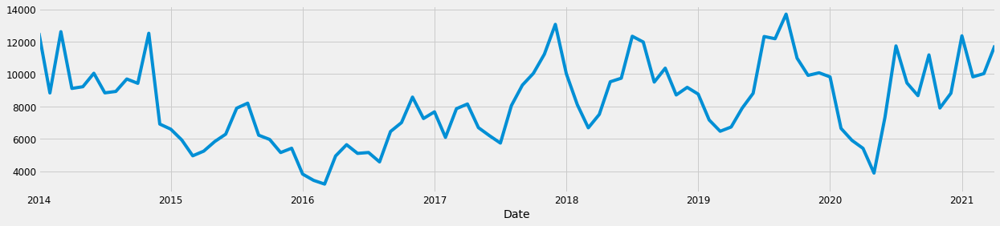

In [874]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

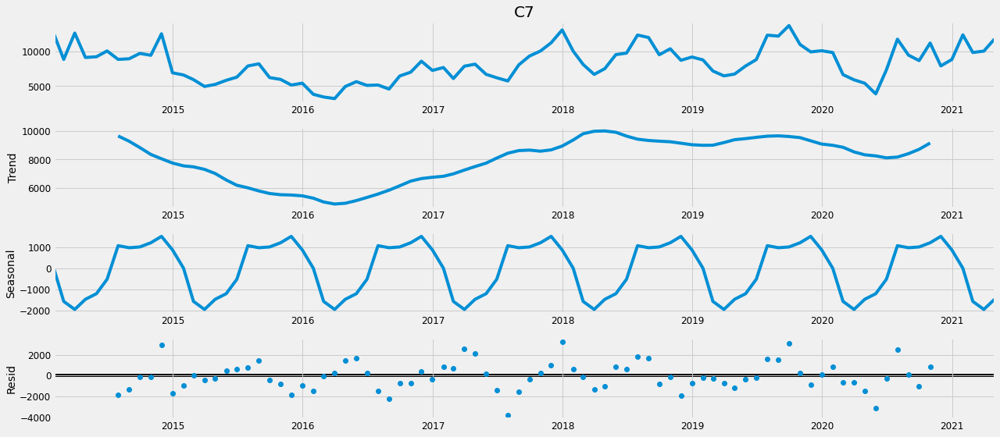

In [875]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [876]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [877]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1824.6888162776459
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1538.1865426112058
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1412.4095238300717
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1170.8897820639963
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1433.1785662999805
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1385.1239348162946
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1194.9815053064933
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1172.21275121651
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1743.8040566692157
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1422.7184644470738
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1369.2837708992392
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1123.7184835414703
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1408.4250181928687
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1346.0768773224406
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1170.5419085956703
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1125.710585568963
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1532.849709907969
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1309.4873974772

#### Ajuste considerando o menor valor de AIC

In [878]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6165      0.359      1.718      0.086      -0.087       1.320
ma.L1         -0.7896      0.282     -2.795      0.005      -1.343      -0.236
ar.S.L12      -0.2774      0.239     -1.160      0.246      -0.746       0.191
ma.S.L12      -0.3556      0.223     -1.596      0.111      -0.792       0.081
sigma2      2.995e+06    6.3e+05      4.751      0.000    1.76e+06    4.23e+06


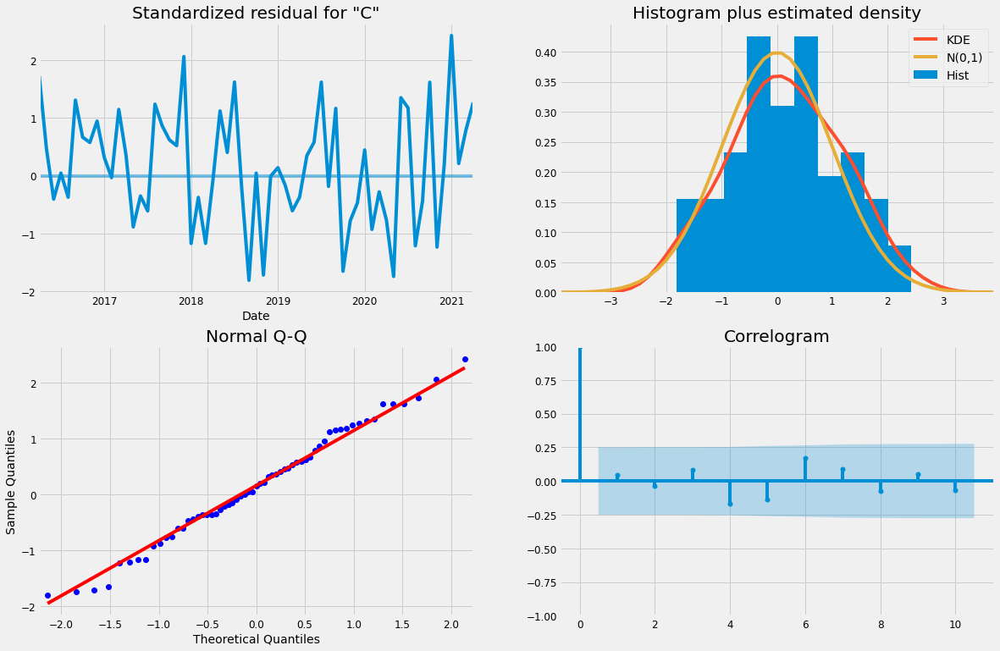

In [879]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

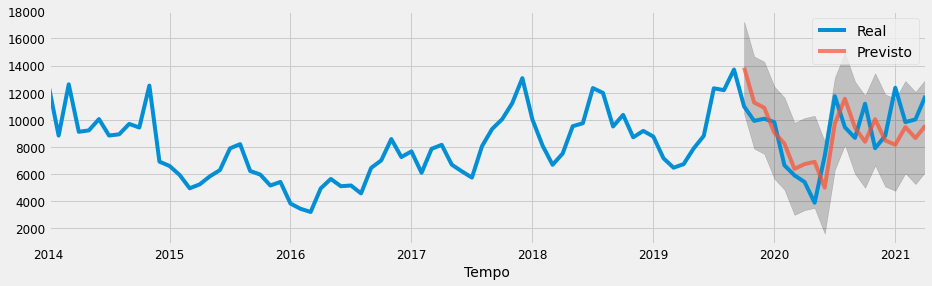

In [880]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [881]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_c7_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_c7_rmse)
sarima_c7_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_c7_mse)
sarima_c7_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_c7_mape, '%')
sarima_c7_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  2004.974381820489
MSE:  4019922.271756452
MAPE:  20.810314089319334 %
R2:  0.2199840884505605


### LSTM

#### Divisão da base

training_set

In [882]:
temp = baltic.loc[baltic['Route'] == 'C7'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C7'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,C7
14440,2014-01-02,18885.0
14441,2014-01-03,18395.0
14442,2014-01-06,17935.0
14443,2014-01-07,17806.0
14444,2014-01-08,17905.0


In [883]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[18885.],
       [18395.],
       [17935.],
       [17806.],
       [17905.]])

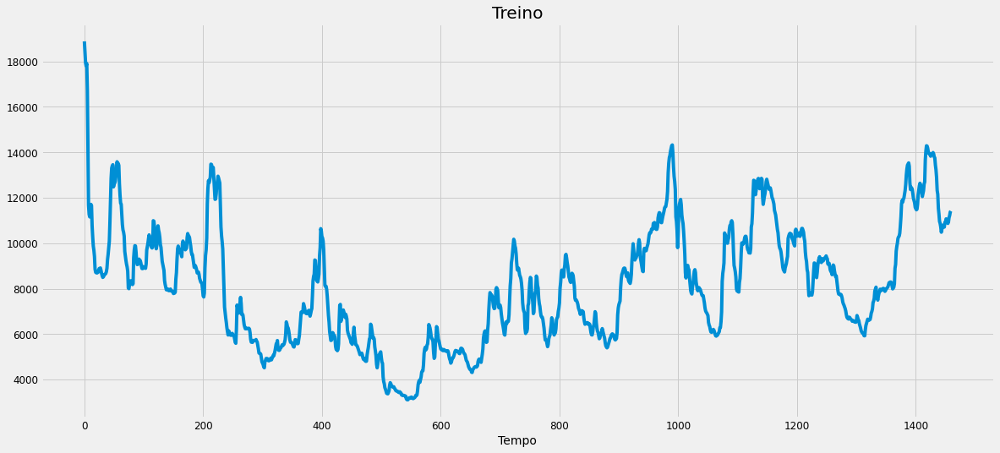

In [884]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [885]:
temp = baltic.loc[baltic['Route'] == 'C7'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C7'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,C7
15900,2019-10-31,11265.0
15901,2019-11-01,11195.0
15902,2019-11-04,11090.0
15903,2019-11-05,10890.0
15904,2019-11-06,10455.0


In [886]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[11265.],
       [11195.],
       [11090.],
       [10890.],
       [10455.]])

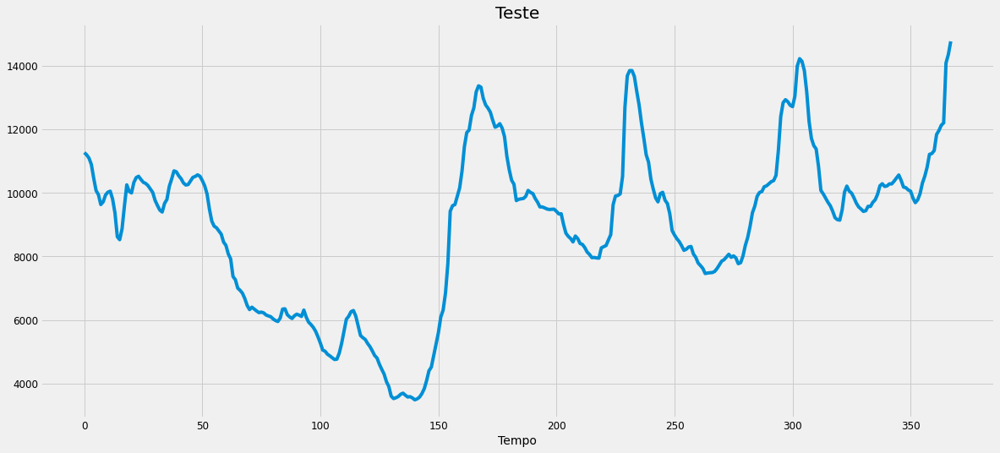

In [887]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [888]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [889]:
training_set_scaled[0:5]

array([[1.        ],
       [0.96894804],
       [0.93979721],
       [0.93162231],
       [0.93789607]])

##### Criar a estrutura de dados

In [890]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [891]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.968948,0.939797,0.931622,0.937896,0.863435,0.710710,0.543093,0.517427,0.510456
1,0.968948,0.939797,0.931622,0.937896,0.863435,0.710710,0.543093,0.517427,0.510456,0.524081
2,0.939797,0.931622,0.937896,0.863435,0.710710,0.543093,0.517427,0.510456,0.524081,0.545311
3,0.931622,0.937896,0.863435,0.710710,0.543093,0.517427,0.510456,0.524081,0.545311,0.542142
4,0.937896,0.863435,0.710710,0.543093,0.517427,0.510456,0.524081,0.545311,0.542142,0.485741


In [892]:
pd.DataFrame(y_train).head()

,0
0,0.524081
1,0.545311
2,0.542142
3,0.485741
4,0.454689


##### *Reshaping*

In [893]:
X_train.shape

(1450, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [894]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [895]:
X_train.shape

(1450, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [896]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_70 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_70 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_71 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_71 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_72 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_72 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_24 (Dense)             (None, 1)               

###### Treinamento

In [897]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1305 samples, validate on 145 samples
Epoch 1/1000
1305/1305 [==============================] - 2s 2ms/step - loss: 0.0179 - val_loss: 0.0054
Epoch 2/1000
1305/1305 [==============================] - 1s 844us/step - loss: 0.0049 - val_loss: 0.0041
Epoch 3/1000
1305/1305 [==============================] - 1s 838us/step - loss: 0.0045 - val_loss: 0.0032
Epoch 4/1000
1305/1305 [==============================] - 1s 826us/step - loss: 0.0044 - val_loss: 0.0032
Epoch 5/1000
1305/1305 [==============================] - 1s 1ms/step - loss: 0.0042 - val_loss: 0.0035
Epoch 6/1000
1305/1305 [==============================] - 1s 895us/step - loss: 0.0036 - val_loss: 0.0040
Epoch 7/1000
1305/1305 [==============================] - 1s 923us/step - loss: 0.0035 - val_loss: 0.0054
Epoch 8/1000
1305/1305 [==============================] - 1s 919us/step - loss: 0.0029 - val_loss: 0.0013
Epoch 9/1000
1305/1305 [==============================] - 1s 915us/step - loss: 0.0030 - val_loss: 0.0037
Epo

Epoch 74/1000
1305/1305 [==============================] - 1s 875us/step - loss: 5.3152e-04 - val_loss: 1.4483e-04
Epoch 75/1000
1305/1305 [==============================] - 1s 857us/step - loss: 5.6640e-04 - val_loss: 1.4008e-04
Epoch 76/1000
1305/1305 [==============================] - 1s 863us/step - loss: 4.7664e-04 - val_loss: 1.3107e-04
Epoch 77/1000
1305/1305 [==============================] - 1s 857us/step - loss: 5.9883e-04 - val_loss: 1.6671e-04
Epoch 78/1000
1305/1305 [==============================] - 1s 882us/step - loss: 4.9980e-04 - val_loss: 1.1741e-04
Epoch 79/1000
1305/1305 [==============================] - 1s 858us/step - loss: 5.3050e-04 - val_loss: 2.1174e-04
Epoch 80/1000
1305/1305 [==============================] - 1s 880us/step - loss: 5.2620e-04 - val_loss: 5.0856e-04
Epoch 81/1000
1305/1305 [==============================] - 1s 876us/step - loss: 5.4264e-04 - val_loss: 1.4865e-04
Epoch 82/1000
1305/1305 [==============================] - 1s 886us/step - loss:

Epoch 145/1000
1305/1305 [==============================] - 1s 869us/step - loss: 3.8952e-04 - val_loss: 1.5082e-04
Epoch 146/1000
1305/1305 [==============================] - 1s 876us/step - loss: 3.6650e-04 - val_loss: 1.3837e-04
Epoch 147/1000
1305/1305 [==============================] - 1s 857us/step - loss: 3.7621e-04 - val_loss: 1.2253e-04
Epoch 148/1000
1305/1305 [==============================] - 1s 867us/step - loss: 3.8677e-04 - val_loss: 1.5687e-04
Epoch 149/1000
1305/1305 [==============================] - 1s 880us/step - loss: 3.8262e-04 - val_loss: 1.4719e-04
Epoch 150/1000
1305/1305 [==============================] - 1s 890us/step - loss: 3.8792e-04 - val_loss: 1.7955e-04
Epoch 151/1000
1305/1305 [==============================] - 1s 877us/step - loss: 3.6537e-04 - val_loss: 2.1992e-04
Epoch 152/1000
1305/1305 [==============================] - 1s 866us/step - loss: 3.9246e-04 - val_loss: 1.4279e-04
Epoch 153/1000
1305/1305 [==============================] - 1s 910us/ste

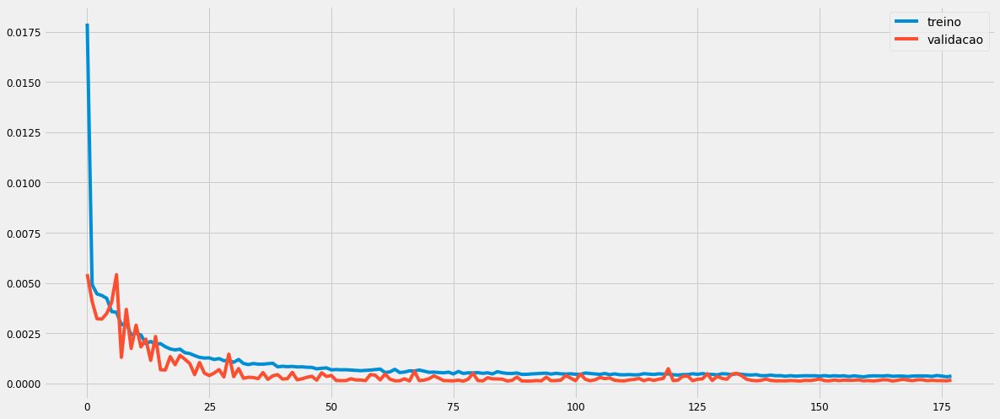

In [898]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [899]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [900]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.5206981 ],
       [0.5051929 ],
       [0.5048979 ],
       [0.49621952],
       [0.48090044]], dtype=float32)

In [901]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[11321.615],
       [11076.943],
       [11072.288],
       [10935.344],
       [10693.609]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

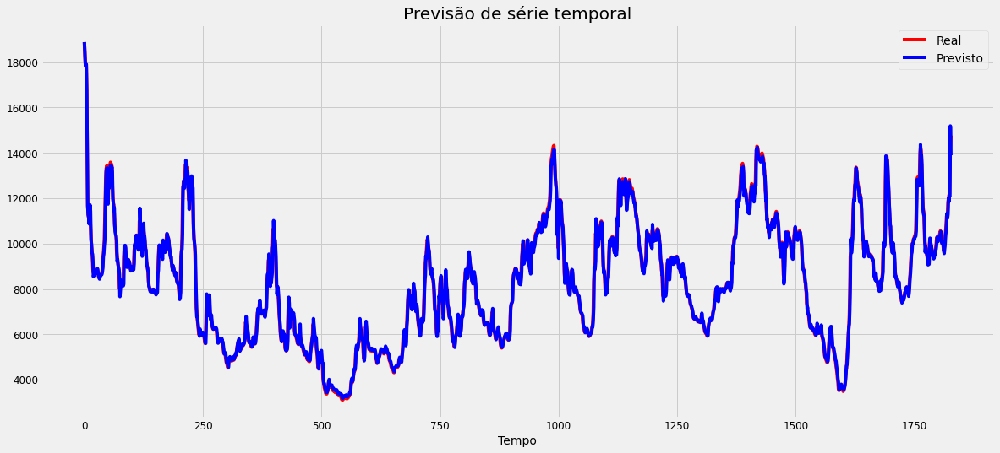

In [902]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

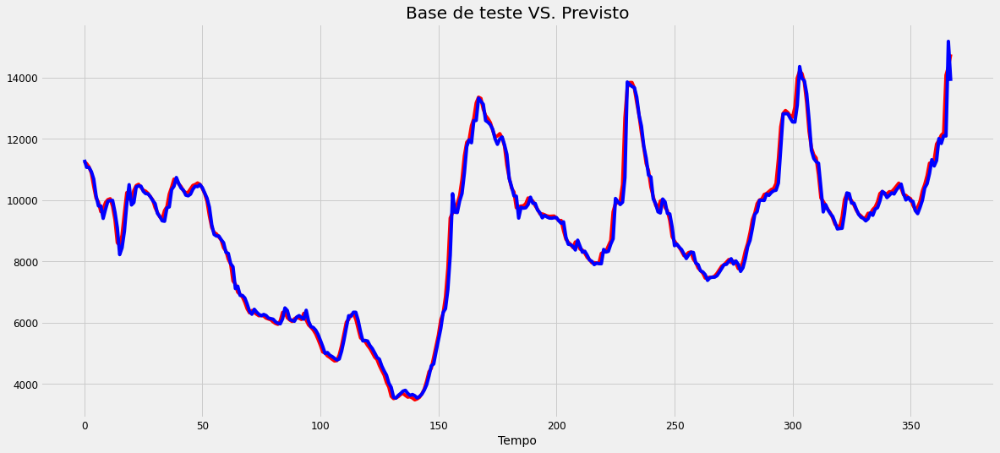

In [903]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [904]:
lstm_c7_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_c7_rmse)
lstm_c7_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_c7_mse)
lstm_c7_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_c7_mape, '%')
lstm_c7_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  261.5928964888719
MSE:  68430.84349343764
MAPE:  1.762635187788304 %
R2:  0.9891187976950515


## C8_14

### SARIMA

In [905]:
data = baltic.loc[baltic['Route'] == 'C8_14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C8_14'}) 
data = data.groupby([pd.Grouper(key='Date', freq='M')]).C8_14.mean()
data.head()

Date
2014-02-28     9955.000000
2014-03-31    22973.857143
2014-04-30     8994.850000
2014-05-31    11114.550000
2014-06-30    12926.523810
Freq: M, Name: C8_14, dtype: float64

#### Divisão da base

In [906]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-02-28 00:00:00', freq='M')

In [907]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-11-30 00:00:00', freq='M')

In [908]:
y = data.copy()
y.tail()

Date
2020-12-31    14951.666667
2021-01-31    28124.750000
2021-02-28    16820.750000
2021-03-31    16330.869565
2021-04-30    24158.600000
Freq: M, Name: C8_14, dtype: float64

#### Exibição da série

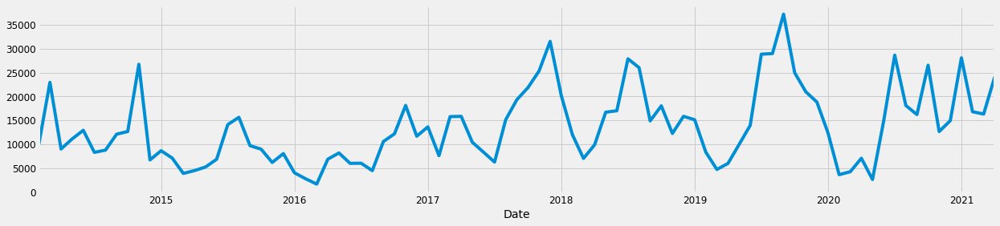

In [909]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

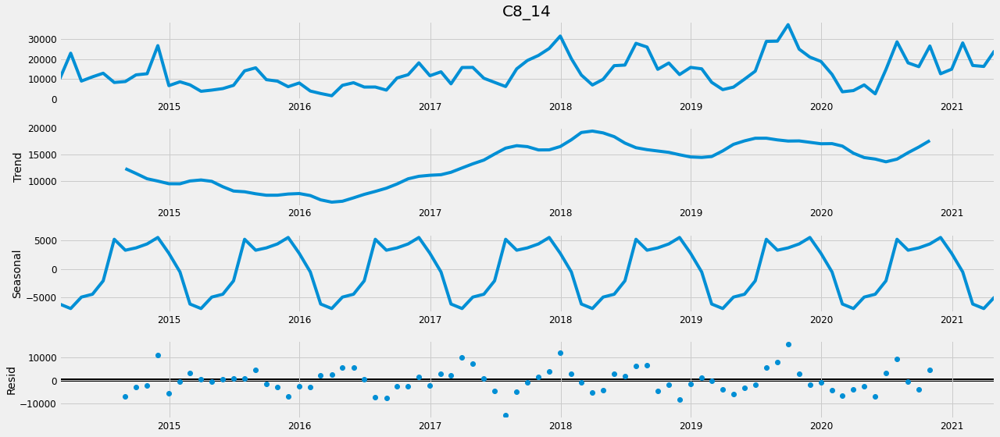

In [910]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [911]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [912]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1908.7103961284004
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1624.0476164744864
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1562.4782381432187
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1302.784920096932


C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1581.9106243226547
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1544.675576906776
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1323.9604506668938
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1303.2367814103354
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1818.3505655188494
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1570.0562692929466
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1522.5413185683392
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1262.0089451312865
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1562.1581854820356
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1559.3854793591559
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1303.4266119555173
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1261.7959518606674
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1741.474770083592
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1492.7506534595843
ARIMA(0, 1, 0)x(0, 1, 0, 12)12 - AIC:1534.043201231332
ARIMA(0, 1, 0)x(0, 1, 1, 12)12 - AIC:1263.6063713668195
ARIMA(0, 1, 0)x(1, 0, 0, 12)12 - AIC:1510.2484870312514
ARIMA(0, 1, 0)x(1, 0, 1, 12)12 - AIC:1494.452478637

#### Ajuste considerando o menor valor de AIC

In [913]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6205      0.297      2.093      0.036       0.039       1.202
ma.L1         -0.9724      0.227     -4.283      0.000      -1.417      -0.527
ar.S.L12      -0.3523      0.418     -0.842      0.400      -1.172       0.468
ma.S.L12      -0.4139      0.444     -0.931      0.352      -1.285       0.457
sigma2      7.066e+07    2.1e-09   3.37e+16      0.000    7.07e+07    7.07e+07


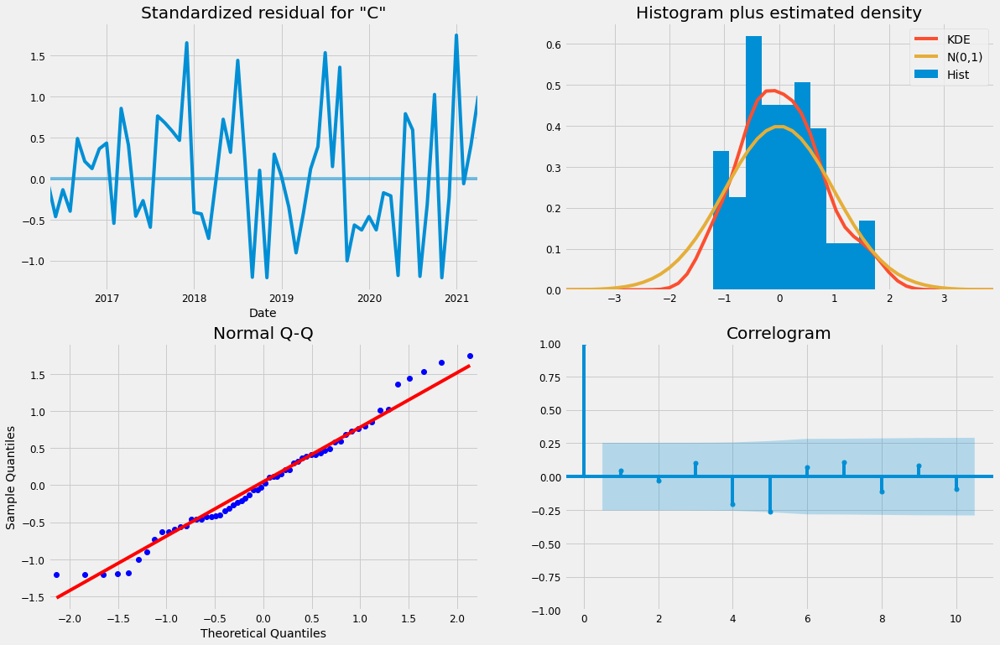

In [914]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

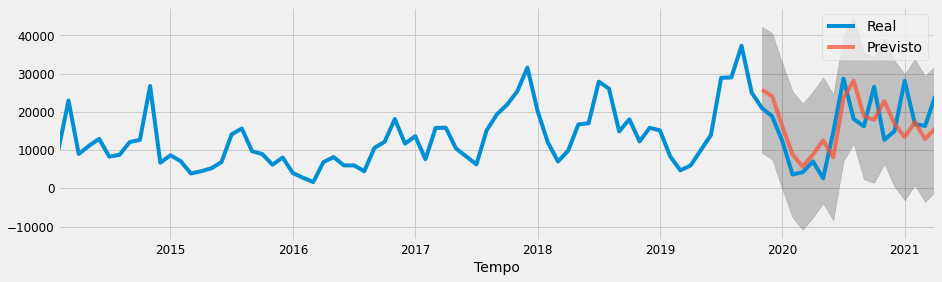

In [915]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [916]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_c814_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_c814_rmse)
sarima_c814_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_c814_mse)
sarima_c814_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_c814_mape, '%')
sarima_c814_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  6903.378436810858
MSE:  47656633.84182513
MAPE:  57.83295953592148 %
R2:  0.22251831957325707


### LSTM

#### Divisão da base

training_set

In [917]:
temp = baltic.loc[baltic['Route'] == 'C8_14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C8_14'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,C8_14
0,2014-02-24,7825.0
1,2014-02-25,8900.0
2,2014-02-26,10225.0
3,2014-02-27,11000.0
4,2014-02-28,11825.0


In [918]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[ 7825.],
       [ 8900.],
       [10225.],
       [11000.],
       [11825.]])

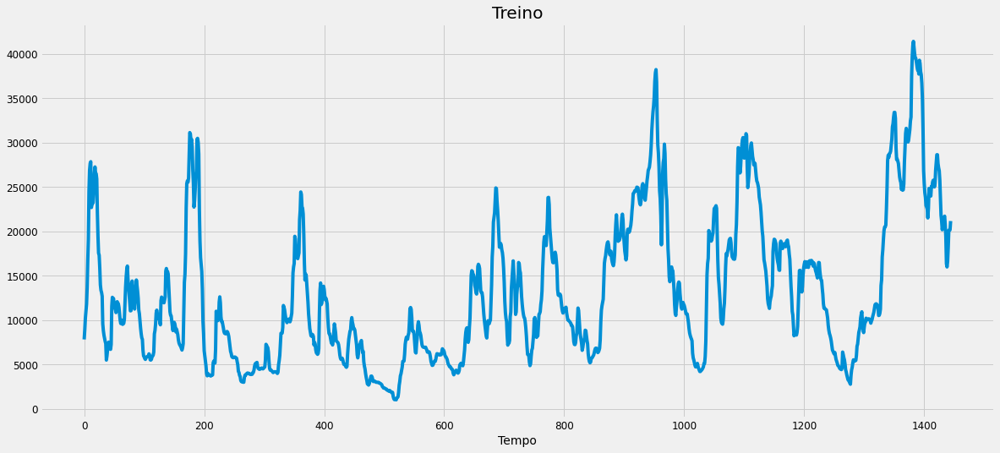

In [919]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [920]:
temp = baltic.loc[baltic['Route'] == 'C8_14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C8_14'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,C8_14
1445,2019-12-02,21445.0
1446,2019-12-03,21575.0
1447,2019-12-04,21100.0
1448,2019-12-05,20825.0
1449,2019-12-06,20600.0


In [921]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[21445.],
       [21575.],
       [21100.],
       [20825.],
       [20600.]])

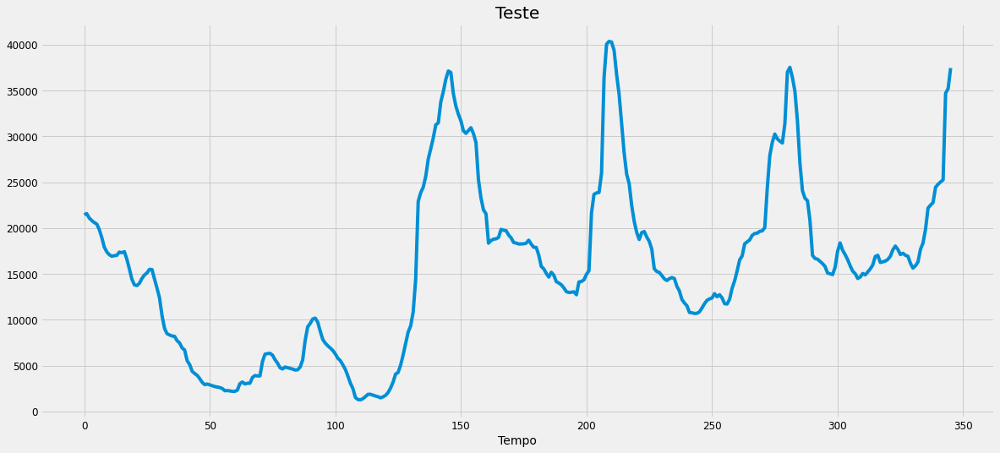

In [922]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [923]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [924]:
training_set_scaled[0:5]

array([[0.16848095],
       [0.19507669],
       [0.2278575 ],
       [0.24703117],
       [0.26744186]])

##### Criar a estrutura de dados

In [925]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [926]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.168481,0.195077,0.227857,0.247031,0.267442,0.313211,0.389287,0.447427,0.581024,0.640401
1,0.195077,0.227857,0.247031,0.267442,0.313211,0.389287,0.447427,0.581024,0.640401,0.659574
2,0.227857,0.247031,0.267442,0.313211,0.389287,0.447427,0.581024,0.640401,0.659574,0.664275
3,0.247031,0.267442,0.313211,0.389287,0.447427,0.581024,0.640401,0.659574,0.664275,0.536492
4,0.267442,0.313211,0.389287,0.447427,0.581024,0.640401,0.659574,0.664275,0.536492,0.546388


In [927]:
pd.DataFrame(y_train).head()

,0
0,0.659574
1,0.664275
2,0.536492
3,0.546388
4,0.547625


##### *Reshaping*

In [928]:
X_train.shape

(1435, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [929]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [930]:
X_train.shape

(1435, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [931]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_73 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_73 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_74 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_74 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_75 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_75 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_25 (Dense)             (None, 1)               

###### Treinamento

In [932]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1291 samples, validate on 144 samples
Epoch 1/1000
1291/1291 [==============================] - 2s 2ms/step - loss: 0.0202 - val_loss: 0.0181
Epoch 2/1000
1291/1291 [==============================] - 1s 962us/step - loss: 0.0093 - val_loss: 0.0110
Epoch 3/1000
1291/1291 [==============================] - 1s 1ms/step - loss: 0.0082 - val_loss: 0.0150
Epoch 4/1000
1291/1291 [==============================] - 1s 993us/step - loss: 0.0069 - val_loss: 0.0120
Epoch 5/1000
1291/1291 [==============================] - 1s 1ms/step - loss: 0.0060 - val_loss: 0.0067
Epoch 6/1000
1291/1291 [==============================] - 1s 970us/step - loss: 0.0049 - val_loss: 0.0055
Epoch 7/1000
1291/1291 [==============================] - 1s 955us/step - loss: 0.0048 - val_loss: 0.0039
Epoch 8/1000
1291/1291 [==============================] - 1s 962us/step - loss: 0.0042 - val_loss: 0.0095
Epoch 9/1000
1291/1291 [==============================] - 1s 945us/step - loss: 0.0042 - val_loss: 0.0034
Epoch

1291/1291 [==============================] - 1s 975us/step - loss: 8.3170e-04 - val_loss: 7.2705e-04
Epoch 76/1000
1291/1291 [==============================] - 1s 902us/step - loss: 8.7068e-04 - val_loss: 0.0010
Epoch 77/1000
1291/1291 [==============================] - 1s 899us/step - loss: 9.0028e-04 - val_loss: 0.0012
Epoch 78/1000
1291/1291 [==============================] - 1s 967us/step - loss: 8.6572e-04 - val_loss: 8.9568e-04
Epoch 79/1000
1291/1291 [==============================] - 1s 1ms/step - loss: 8.8135e-04 - val_loss: 9.2774e-04
Epoch 80/1000
1291/1291 [==============================] - 1s 946us/step - loss: 8.0661e-04 - val_loss: 6.0785e-04
Epoch 81/1000
1291/1291 [==============================] - 1s 901us/step - loss: 9.5760e-04 - val_loss: 0.0011
Epoch 82/1000
1291/1291 [==============================] - 1s 955us/step - loss: 8.3297e-04 - val_loss: 0.0012
Epoch 83/1000
1291/1291 [==============================] - 1s 958us/step - loss: 8.8850e-04 - val_loss: 0.0015
E

1291/1291 [==============================] - 1s 978us/step - loss: 7.9474e-04 - val_loss: 7.2789e-04
Epoch 148/1000
1291/1291 [==============================] - 1s 982us/step - loss: 7.6331e-04 - val_loss: 0.0010
Epoch 149/1000
1291/1291 [==============================] - 1s 906us/step - loss: 7.8922e-04 - val_loss: 7.4406e-04
Epoch 150/1000
1291/1291 [==============================] - 1s 968us/step - loss: 7.1678e-04 - val_loss: 0.0011
Epoch 151/1000
1291/1291 [==============================] - 1s 944us/step - loss: 6.9889e-04 - val_loss: 0.0012
Epoch 152/1000
1291/1291 [==============================] - 1s 1ms/step - loss: 6.9478e-04 - val_loss: 0.0011
Epoch 153/1000
1291/1291 [==============================] - 1s 1ms/step - loss: 7.2748e-04 - val_loss: 8.1462e-04
Epoch 154/1000
1291/1291 [==============================] - 1s 993us/step - loss: 7.1046e-04 - val_loss: 8.6298e-04
Epoch 155/1000
1291/1291 [==============================] - 1s 940us/step - loss: 6.6785e-04 - val_loss: 7.

1291/1291 [==============================] - 1s 953us/step - loss: 6.5453e-04 - val_loss: 9.1344e-04


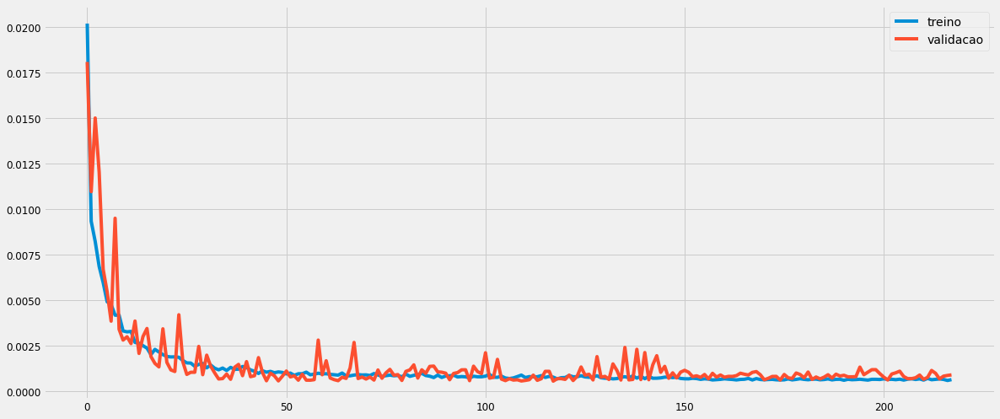

In [933]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [934]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [935]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.50643075],
       [0.5013641 ],
       [0.50661254],
       [0.48469162],
       [0.48390883]], dtype=float32)

In [936]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[21484.93 ],
       [21280.137],
       [21492.277],
       [20606.234],
       [20574.594]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

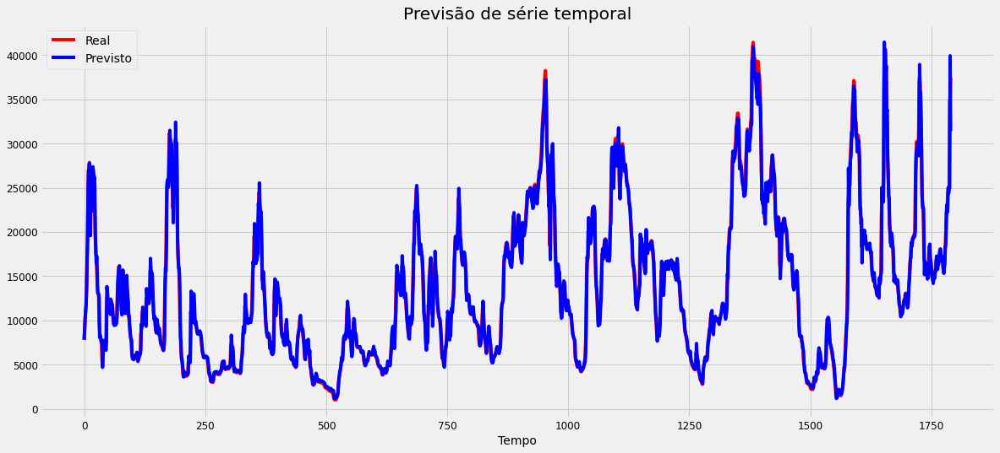

In [937]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

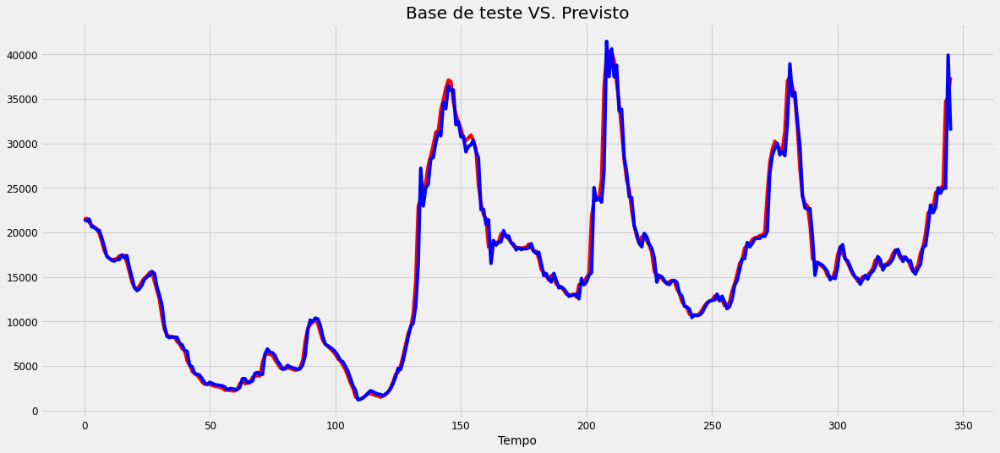

In [938]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [939]:
lstm_c814_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_c814_rmse)
lstm_c814_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_c814_mse)
lstm_c814_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_c814_mape, '%')
lstm_c814_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  1292.9167596275138
MSE:  1671633.74732571
MAPE:  4.701555674813287 %
R2:  0.9805594834955242


## C9_14

### SARIMA

In [940]:
data = baltic.loc[baltic['Route'] == 'C9_14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C9_14'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).C9_14.mean()
data.head()

Date
2014-02-28    31301.000000
2014-03-31    42914.190476
2014-04-30    28377.100000
2014-05-31    26227.250000
2014-06-30    31622.761905
Freq: M, Name: C9_14, dtype: float64

#### Divisão da base

In [941]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-02-28 00:00:00', freq='M')

In [942]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-11-30 00:00:00', freq='M')

In [943]:
y = data.copy()
y.tail()

Date
2020-12-31    26470.555556
2021-01-31    40286.150000
2021-02-28    29021.500000
2021-03-31    31282.956522
2021-04-30    46513.600000
Freq: M, Name: C9_14, dtype: float64

#### Exibição da série

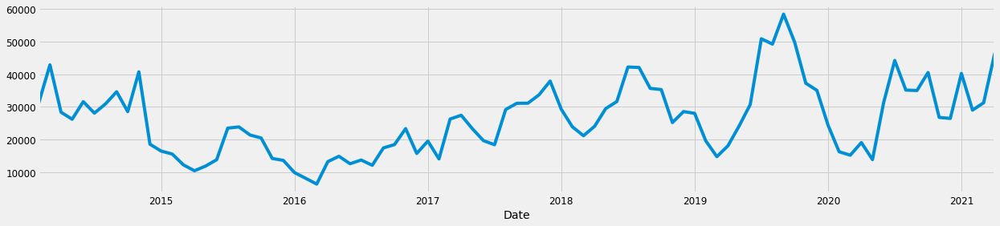

In [944]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

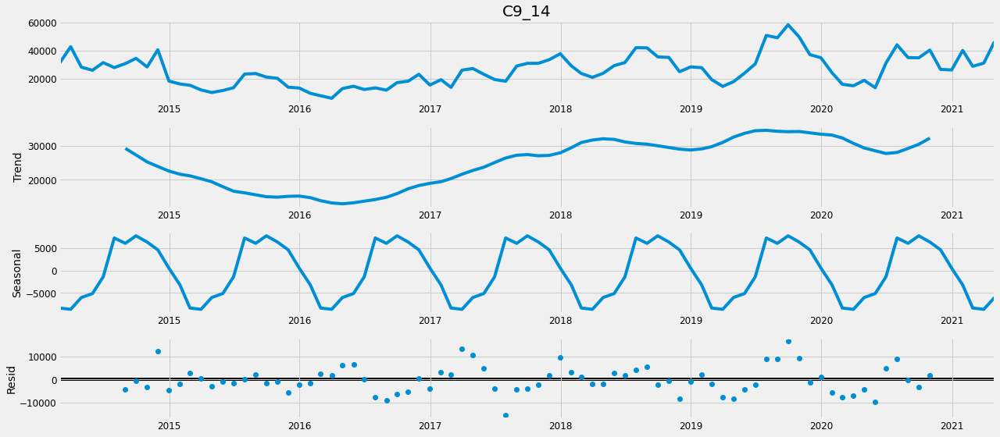

In [945]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [946]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [947]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:2009.496747739674
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1701.001378659558
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1602.192383752984
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1332.7324483236077
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1623.979555932013
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1577.5588262622298
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1355.5721924736135
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1334.253241016363
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1929.8918241882755
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1647.6208203667504
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1545.9642951206429
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1285.7328557447668
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1685.642464087889
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1640.1660687337558
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1329.1779875685872
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1287.1962638648583
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1756.4575342195044
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1503.936684531946

#### Ajuste considerando o menor valor de AIC

In [948]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7692      0.255      3.011      0.003       0.269       1.270
ma.L1         -0.9672      0.192     -5.029      0.000      -1.344      -0.590
ar.S.L12      -0.2352      0.450     -0.523      0.601      -1.116       0.646
ma.S.L12      -0.3413      0.484     -0.705      0.481      -1.290       0.607
sigma2      6.964e+07   1.02e-09   6.82e+16      0.000    6.96e+07    6.96e+07


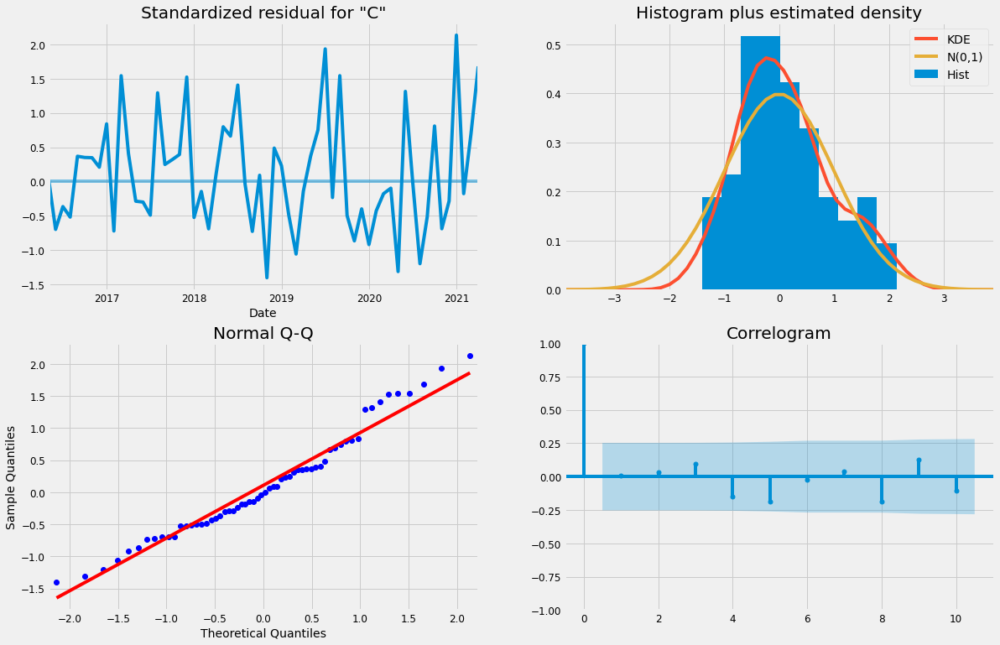

In [949]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

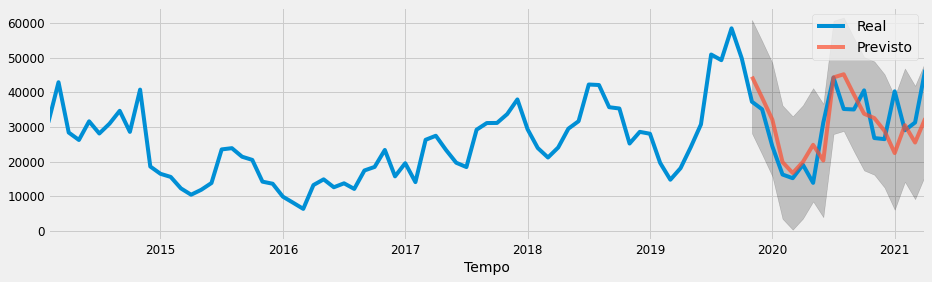

In [950]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [951]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_c914_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_c914_rmse)
sarima_c914_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_c914_mse)
sarima_c914_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_c914_mape, '%')
sarima_c914_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  7939.806860232667
MSE:  63040532.97779771
MAPE:  22.078241774422512 %
R2:  0.319932168877041


### LSTM

#### Divisão da base

training_set

In [952]:
temp = baltic.loc[baltic['Route'] == 'C9_14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C9_14'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,C9_14
1791,2014-02-24,27605.0
1792,2014-02-25,29925.0
1793,2014-02-26,32025.0
1794,2014-02-27,33350.0
1795,2014-02-28,33600.0


In [953]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[27605.],
       [29925.],
       [32025.],
       [33350.],
       [33600.]])

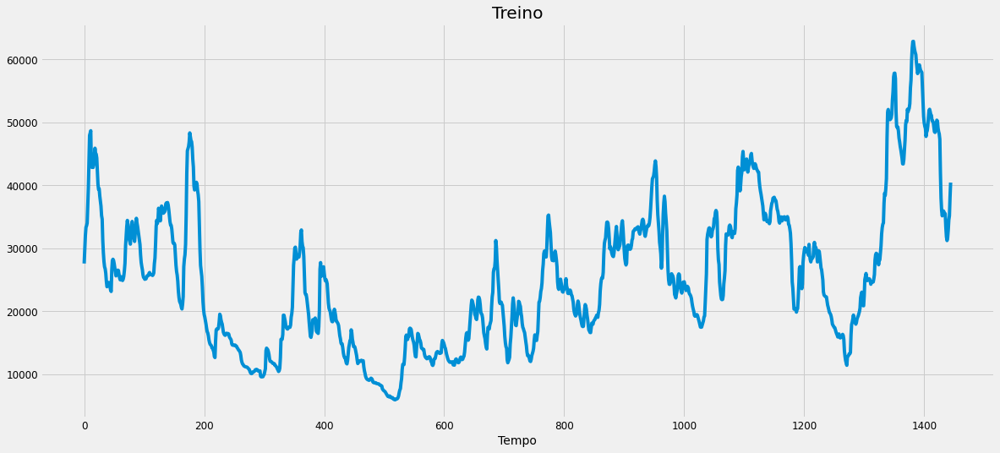

In [954]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [955]:
temp = baltic.loc[baltic['Route'] == 'C9_14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C9_14'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,C9_14
3236,2019-12-02,40925.0
3237,2019-12-03,41205.0
3238,2019-12-04,40875.0
3239,2019-12-05,39490.0
3240,2019-12-06,38615.0


In [956]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[40925.],
       [41205.],
       [40875.],
       [39490.],
       [38615.]])

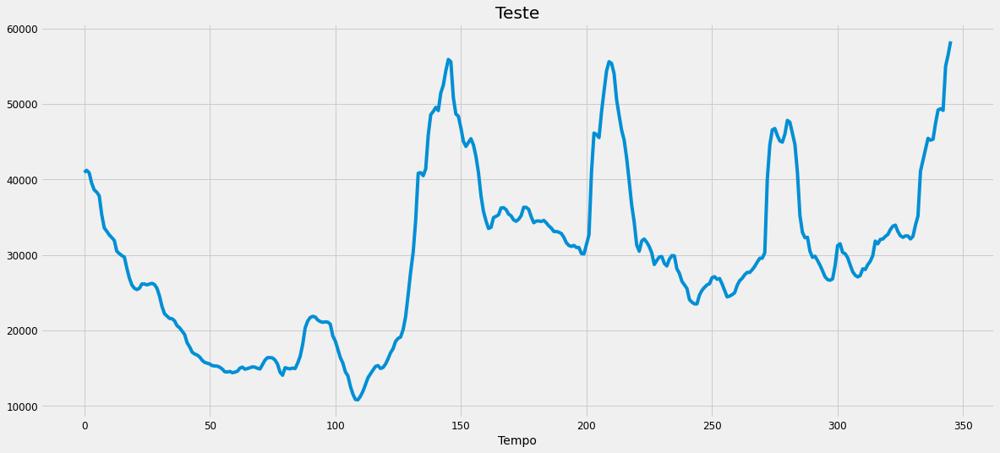

In [957]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [958]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [959]:
training_set_scaled[0:5]

array([[0.38031709],
       [0.42109611],
       [0.45800816],
       [0.4812979 ],
       [0.48569219]])

##### Criar a estrutura de dados

In [960]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [961]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.380317,0.421096,0.458008,0.481298,0.485692,0.493162,0.545455,0.592913,0.668495,0.737485
1,0.421096,0.458008,0.481298,0.485692,0.493162,0.545455,0.592913,0.668495,0.737485,0.744516
2,0.458008,0.481298,0.485692,0.493162,0.545455,0.592913,0.668495,0.737485,0.744516,0.750668
3,0.481298,0.485692,0.493162,0.545455,0.592913,0.668495,0.737485,0.744516,0.750668,0.650039
4,0.485692,0.493162,0.545455,0.592913,0.668495,0.737485,0.744516,0.750668,0.650039,0.648281


In [962]:
pd.DataFrame(y_train).head()

,0
0,0.744516
1,0.750668
2,0.650039
3,0.648281
4,0.650918


##### *Reshaping*

In [963]:
X_train.shape

(1435, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [964]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [965]:
X_train.shape

(1435, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [966]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_76 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_76 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_77 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_77 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_78 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_78 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_26 (Dense)             (None, 1)               

###### Treinamento

In [967]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1291 samples, validate on 144 samples
Epoch 1/1000
1291/1291 [==============================] - 2s 2ms/step - loss: 0.0218 - val_loss: 0.0161
Epoch 2/1000
1291/1291 [==============================] - 1s 793us/step - loss: 0.0060 - val_loss: 0.0122
Epoch 3/1000
1291/1291 [==============================] - 1s 791us/step - loss: 0.0057 - val_loss: 0.0120
Epoch 4/1000
1291/1291 [==============================] - 1s 852us/step - loss: 0.0053 - val_loss: 0.0182
Epoch 5/1000
1291/1291 [==============================] - 1s 823us/step - loss: 0.0049 - val_loss: 0.0102
Epoch 6/1000
1291/1291 [==============================] - 1s 940us/step - loss: 0.0042 - val_loss: 0.0086
Epoch 7/1000
1291/1291 [==============================] - 1s 1ms/step - loss: 0.0044 - val_loss: 0.0067
Epoch 8/1000
1291/1291 [==============================] - 1s 1ms/step - loss: 0.0032 - val_loss: 0.0049
Epoch 9/1000
1291/1291 [==============================] - 1s 979us/step - loss: 0.0033 - val_loss: 0.0040
Epoch

1291/1291 [==============================] - 1s 916us/step - loss: 5.8525e-04 - val_loss: 0.0010
Epoch 76/1000
1291/1291 [==============================] - 1s 900us/step - loss: 6.4094e-04 - val_loss: 0.0015
Epoch 77/1000
1291/1291 [==============================] - 1s 901us/step - loss: 6.2376e-04 - val_loss: 5.1025e-04
Epoch 78/1000
1291/1291 [==============================] - 1s 891us/step - loss: 6.2573e-04 - val_loss: 4.6324e-04
Epoch 79/1000
1291/1291 [==============================] - 1s 901us/step - loss: 6.1832e-04 - val_loss: 5.1887e-04
Epoch 80/1000
1291/1291 [==============================] - 1s 943us/step - loss: 5.9075e-04 - val_loss: 4.1825e-04
Epoch 81/1000
1291/1291 [==============================] - 1s 915us/step - loss: 5.8344e-04 - val_loss: 8.6109e-04
Epoch 82/1000
1291/1291 [==============================] - 1s 988us/step - loss: 5.4876e-04 - val_loss: 7.1733e-04
Epoch 83/1000
1291/1291 [==============================] - 1s 959us/step - loss: 5.7968e-04 - val_loss

Epoch 147/1000
1291/1291 [==============================] - 1s 951us/step - loss: 5.3727e-04 - val_loss: 5.9685e-04
Epoch 148/1000
1291/1291 [==============================] - 1s 968us/step - loss: 4.6462e-04 - val_loss: 7.3982e-04
Epoch 149/1000
1291/1291 [==============================] - 1s 900us/step - loss: 4.4728e-04 - val_loss: 9.0201e-04
Epoch 150/1000
1291/1291 [==============================] - 1s 905us/step - loss: 5.7336e-04 - val_loss: 5.5485e-04
Epoch 151/1000
1291/1291 [==============================] - 1s 975us/step - loss: 5.0617e-04 - val_loss: 6.6633e-04
Epoch 152/1000
1291/1291 [==============================] - 1s 921us/step - loss: 4.9458e-04 - val_loss: 8.5745e-04
Epoch 153/1000
1291/1291 [==============================] - 1s 915us/step - loss: 5.0902e-04 - val_loss: 5.5029e-04
Epoch 154/1000
1291/1291 [==============================] - 1s 929us/step - loss: 5.2527e-04 - val_loss: 7.8317e-04
Epoch 155/1000
1291/1291 [==============================] - 1s 913us/ste

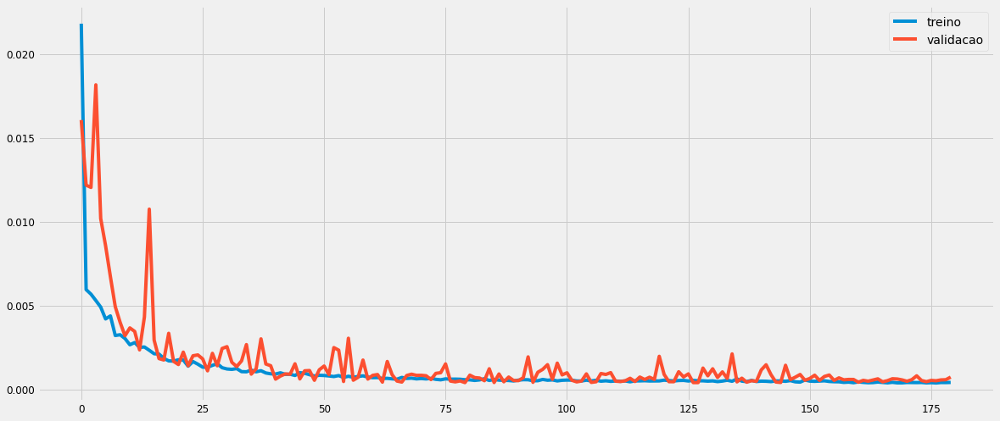

In [968]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [969]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [970]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.61098754],
       [0.60544944],
       [0.61261714],
       [0.5989058 ],
       [0.5673909 ]], dtype=float32)

In [971]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[40728.305],
       [40413.23 ],
       [40821.016],
       [40040.95 ],
       [38248.004]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

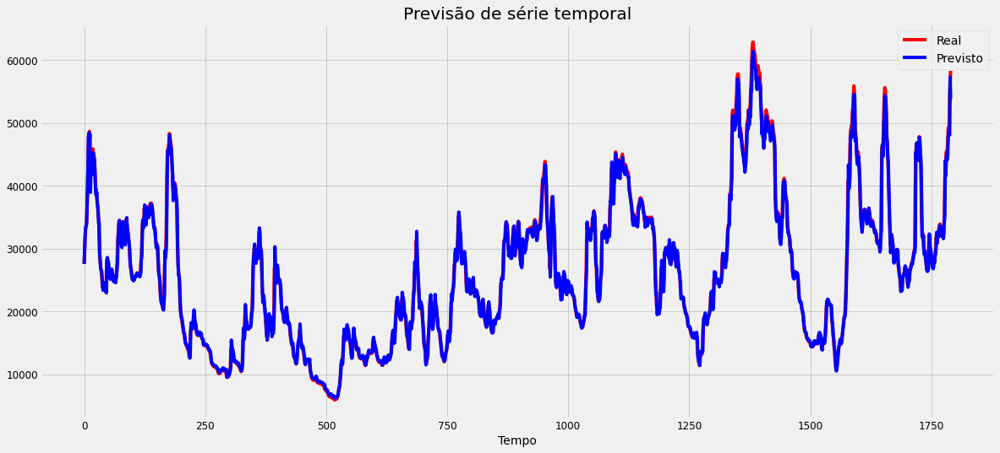

In [972]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

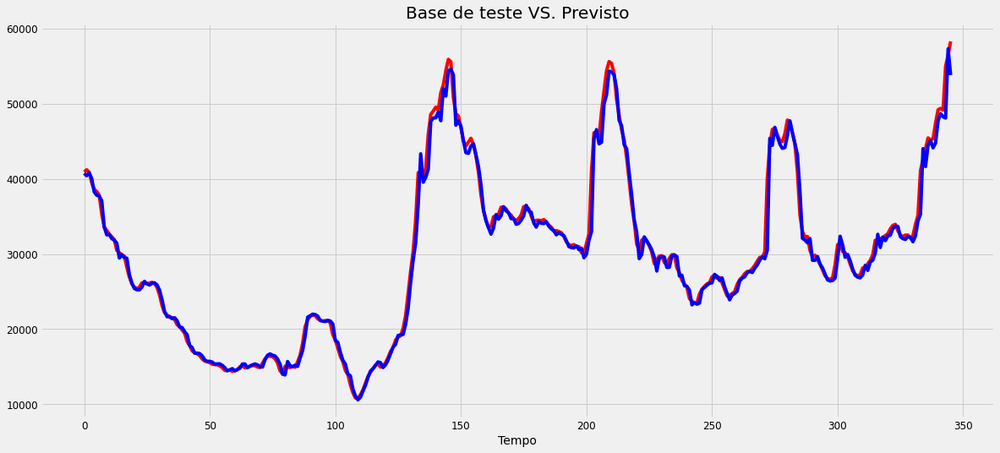

In [973]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [974]:
lstm_c914_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_c914_rmse)
lstm_c914_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_c914_mse)
lstm_c914_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_c914_mape, '%')
lstm_c914_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  1271.4877197994604
MSE:  1616681.0216008308
MAPE:  2.2048382881072874 %
R2:  0.986741490959741


## C10_14

### SARIMA

In [975]:
data = baltic.loc[baltic['Route'] == 'C10_14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C10_14'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).C10_14.mean()
data.head()

Date
2014-02-28    16785.600000
2014-03-31    23615.809524
2014-04-30    14729.400000
2014-05-31    11498.850000
2014-06-30    12520.761905
Freq: M, Name: C10_14, dtype: float64

#### Divisão da base

In [976]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-02-28 00:00:00', freq='M')

In [977]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-11-30 00:00:00', freq='M')

In [978]:
y = data.copy()
y.tail()

Date
2020-12-31    14599.222222
2021-01-31    19218.950000
2021-02-28     9305.600000
2021-03-31    19748.913043
2021-04-30    29744.733333
Freq: M, Name: C10_14, dtype: float64

#### Exibição da série

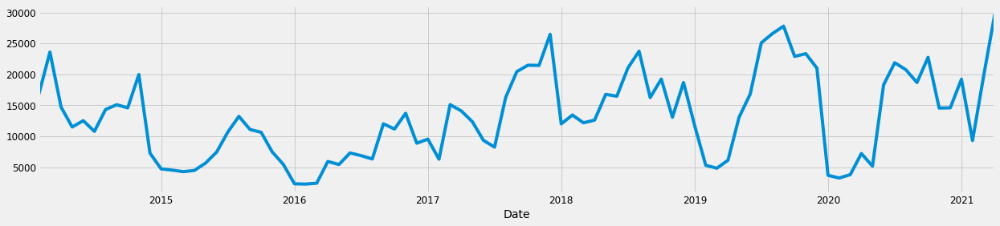

In [979]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

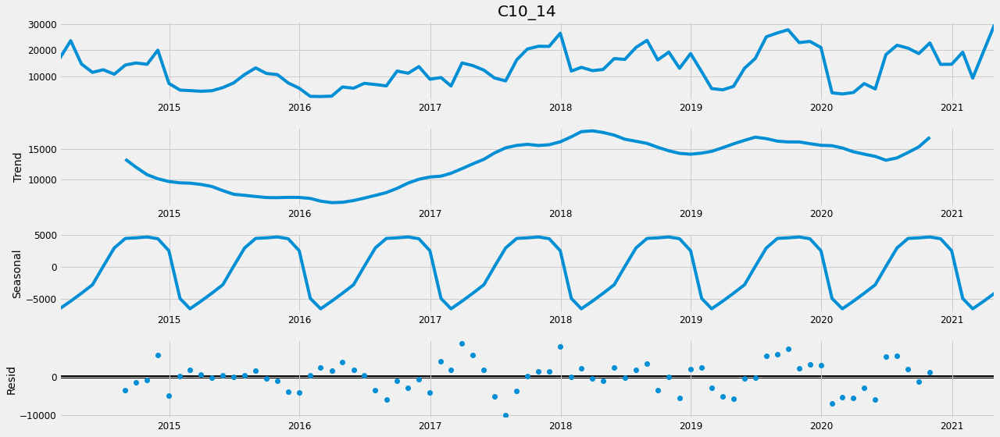

In [980]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [981]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [982]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1898.509876107607
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1610.7807309785187
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1534.138009788548
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1281.1799654849144
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1556.3517219633172
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1519.6160603098192
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1304.3634895398648
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1283.3495051280072
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1822.5158213189795
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1558.6667881111296
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1490.9384990831963
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1244.7145724361615
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1535.557937184142
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1476.4433878759428
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1286.8367031376674
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1245.6513173596036
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1694.6691892746078
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1459.733060754

#### Ajuste considerando o menor valor de AIC

In [983]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2149      0.690     -0.312      0.755      -1.566       1.137
ma.L1         -0.0429      0.753     -0.057      0.955      -1.518       1.432
ar.S.L12      -0.2695      0.352     -0.766      0.444      -0.960       0.421
ma.S.L12      -0.4531      0.271     -1.674      0.094      -0.984       0.077
sigma2      3.592e+07   1.39e-08   2.58e+15      0.000    3.59e+07    3.59e+07


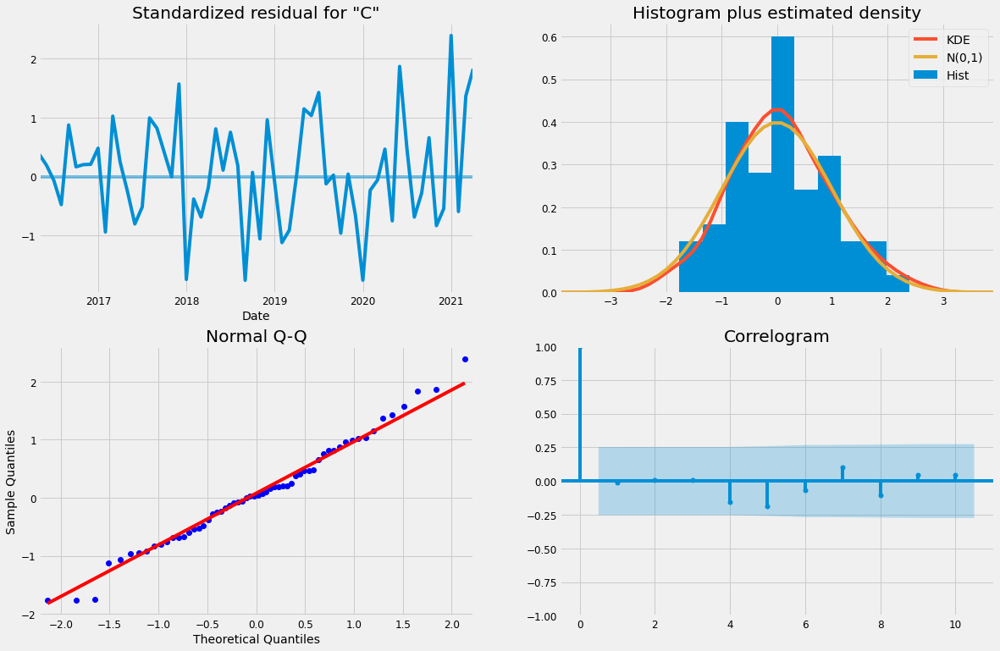

In [984]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

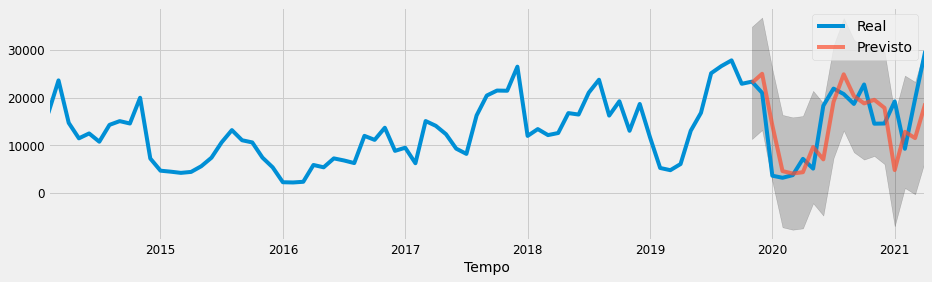

In [985]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [986]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_c1014_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_c1014_rmse)
sarima_c1014_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_c1014_mse)
sarima_c1014_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_c1014_mape, '%')
sarima_c1014_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  6532.437382532594
MSE:  42672738.15670928
MAPE:  47.34991930736077 %
R2:  0.3068646504581951


### LSTM

#### Divisão da base

training_set

In [987]:
temp = baltic.loc[baltic['Route'] == 'C10_14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C10_14'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,C10_14
3582,2014-02-24,14550.0
3583,2014-02-25,15255.0
3584,2014-02-26,16882.0
3585,2014-02-27,18500.0
3586,2014-02-28,18741.0


In [988]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[14550.],
       [15255.],
       [16882.],
       [18500.],
       [18741.]])

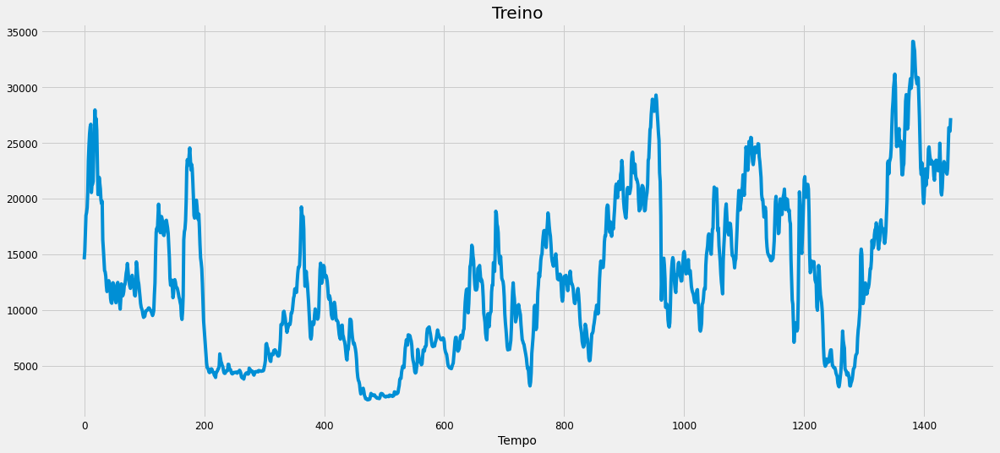

In [989]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [990]:
temp = baltic.loc[baltic['Route'] == 'C10_14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C10_14'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,C10_14
5027,2019-12-02,28417.0
5028,2019-12-03,30292.0
5029,2019-12-04,29775.0
5030,2019-12-05,28725.0
5031,2019-12-06,27896.0


In [991]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[28417.],
       [30292.],
       [29775.],
       [28725.],
       [27896.]])

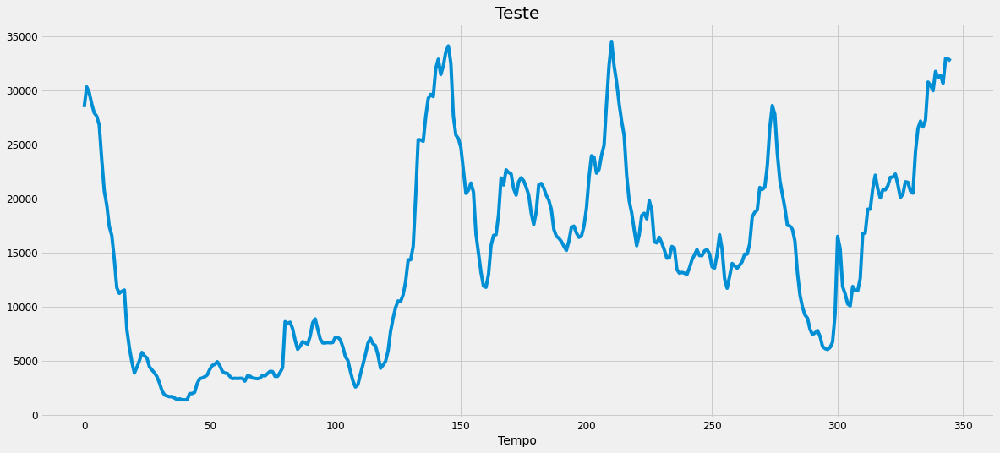

In [992]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [993]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [994]:
training_set_scaled[0:5]

array([[0.39190996],
       [0.41382956],
       [0.46441563],
       [0.51472189],
       [0.52221497]])

##### Criar a estrutura de dados

In [995]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [996]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.391910,0.413830,0.464416,0.514722,0.522215,0.536331,0.580450,0.667351,0.709045,0.742126
1,0.413830,0.464416,0.514722,0.522215,0.536331,0.580450,0.667351,0.709045,0.742126,0.761465
2,0.464416,0.514722,0.522215,0.536331,0.580450,0.667351,0.709045,0.742126,0.761465,0.768678
3,0.514722,0.522215,0.536331,0.580450,0.667351,0.709045,0.742126,0.761465,0.768678,0.578304
4,0.522215,0.536331,0.580450,0.667351,0.709045,0.742126,0.761465,0.768678,0.578304,0.600379


In [997]:
pd.DataFrame(y_train).head()

,0
0,0.761465
1,0.768678
2,0.578304
3,0.600379
4,0.601623


##### *Reshaping*

In [998]:
X_train.shape

(1435, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [999]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [1000]:
X_train.shape

(1435, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [1001]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_79 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_79 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_80 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_80 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_81 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_81 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_27 (Dense)             (None, 1)               

###### Treinamento

In [1002]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1291 samples, validate on 144 samples
Epoch 1/1000
1291/1291 [==============================] - 2s 2ms/step - loss: 0.0243 - val_loss: 0.0094
Epoch 2/1000
1291/1291 [==============================] - 1s 877us/step - loss: 0.0083 - val_loss: 0.0147
Epoch 3/1000
1291/1291 [==============================] - 1s 875us/step - loss: 0.0076 - val_loss: 0.0080
Epoch 4/1000
1291/1291 [==============================] - 1s 895us/step - loss: 0.0068 - val_loss: 0.0102
Epoch 5/1000
1291/1291 [==============================] - 1s 937us/step - loss: 0.0061 - val_loss: 0.0065
Epoch 6/1000
1291/1291 [==============================] - 1s 854us/step - loss: 0.0061 - val_loss: 0.0144
Epoch 7/1000
1291/1291 [==============================] - 1s 881us/step - loss: 0.0051 - val_loss: 0.0053
Epoch 8/1000
1291/1291 [==============================] - 1s 907us/step - loss: 0.0048 - val_loss: 0.0042
Epoch 9/1000
1291/1291 [==============================] - 1s 957us/step - loss: 0.0043 - val_loss: 0.0083
E

1291/1291 [==============================] - 1s 941us/step - loss: 0.0012 - val_loss: 8.4939e-04
Epoch 78/1000
1291/1291 [==============================] - 1s 941us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 79/1000
1291/1291 [==============================] - 1s 945us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 80/1000
1291/1291 [==============================] - 1s 954us/step - loss: 0.0011 - val_loss: 8.7650e-04
Epoch 81/1000
1291/1291 [==============================] - 1s 946us/step - loss: 0.0011 - val_loss: 9.7716e-04
Epoch 82/1000
1291/1291 [==============================] - 1s 1ms/step - loss: 0.0012 - val_loss: 0.0016
Epoch 83/1000
1291/1291 [==============================] - 1s 992us/step - loss: 0.0011 - val_loss: 8.3307e-04
Epoch 84/1000
1291/1291 [==============================] - 1s 960us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 85/1000
1291/1291 [==============================] - 1s 961us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 86/1000
1291/1291 [============

1291/1291 [==============================] - 1s 937us/step - loss: 9.2816e-04 - val_loss: 0.0025
Epoch 151/1000
1291/1291 [==============================] - 1s 935us/step - loss: 0.0010 - val_loss: 8.3516e-04
Epoch 152/1000
1291/1291 [==============================] - 1s 938us/step - loss: 9.0474e-04 - val_loss: 9.8953e-04
Epoch 153/1000
1291/1291 [==============================] - 1s 938us/step - loss: 9.1747e-04 - val_loss: 8.4268e-04
Epoch 154/1000
1291/1291 [==============================] - 1s 938us/step - loss: 9.3945e-04 - val_loss: 8.1719e-04
Epoch 155/1000
1291/1291 [==============================] - 1s 936us/step - loss: 8.8629e-04 - val_loss: 0.0012


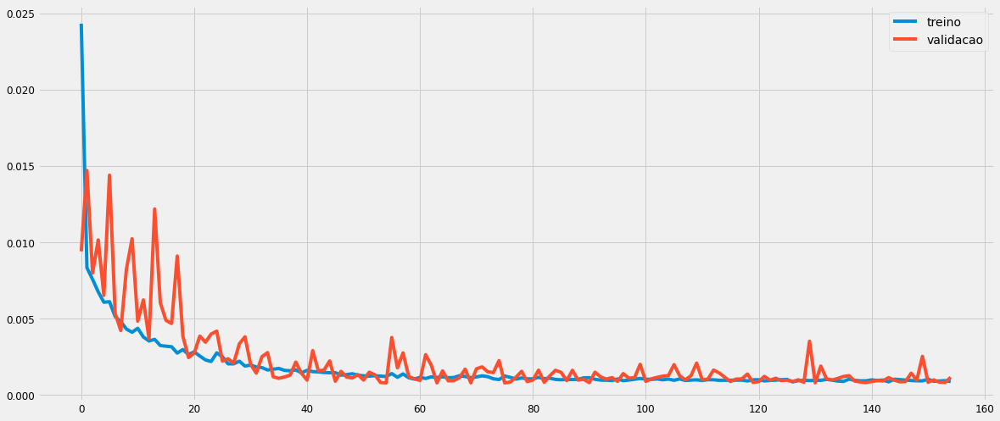

In [1003]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [1004]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [1005]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.7796208 ],
       [0.8031548 ],
       [0.8681189 ],
       [0.8142772 ],
       [0.79925764]], dtype=float32)

In [1006]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[27019.943],
       [27776.87 ],
       [29866.307],
       [28134.596],
       [27651.523]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

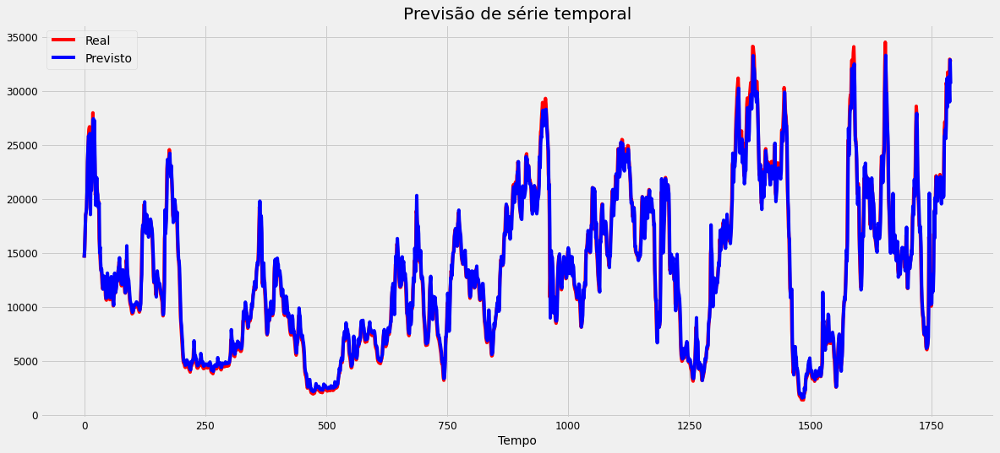

In [1007]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

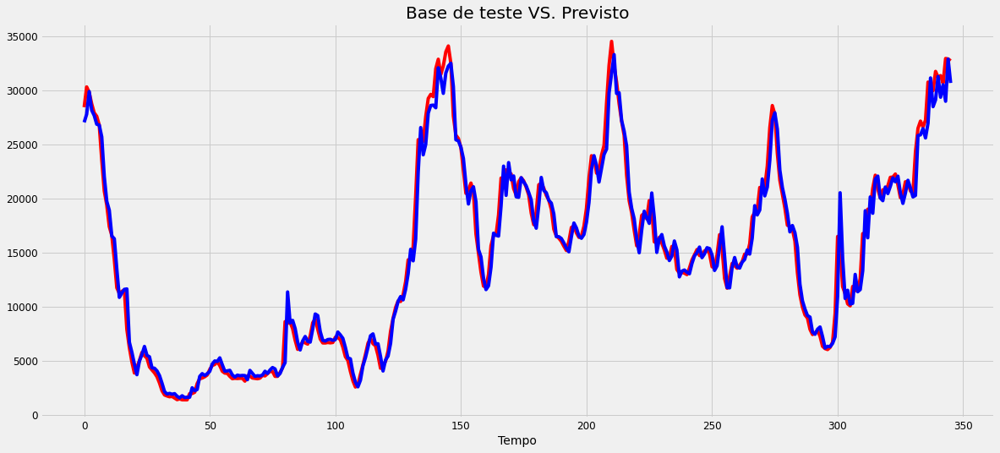

In [1008]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [1009]:
lstm_c1014_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_c1014_rmse)
lstm_c1014_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_c1014_mse)
lstm_c1014_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_c1014_mape, '%')
lstm_c1014_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  1259.1334141178297
MSE:  1585416.9545480222
MAPE:  7.251056725809847 %
R2:  0.9793973133384691


## C14

### SARIMA

In [1010]:
data = baltic.loc[baltic['Route'] == 'C14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C14'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).C14.mean()
data.head()

Date
2014-02-28    13656.200000
2014-03-31    23421.523810
2014-04-30    13160.250000
2014-05-31    11709.700000
2014-06-30    13757.380952
Freq: M, Name: C14, dtype: float64

#### Divisão da base

In [1011]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-02-28 00:00:00', freq='M')

In [1012]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-11-30 00:00:00', freq='M')

In [1013]:
y = data.copy()
y.tail()

Date
2020-12-31    13164.444444
2021-01-31    21677.650000
2021-02-28    12733.400000
2021-03-31    16986.956522
2021-04-30    26943.200000
Freq: M, Name: C14, dtype: float64

#### Exibição da série

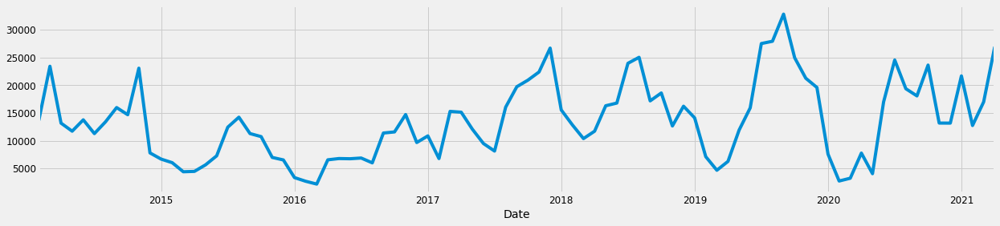

In [1014]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

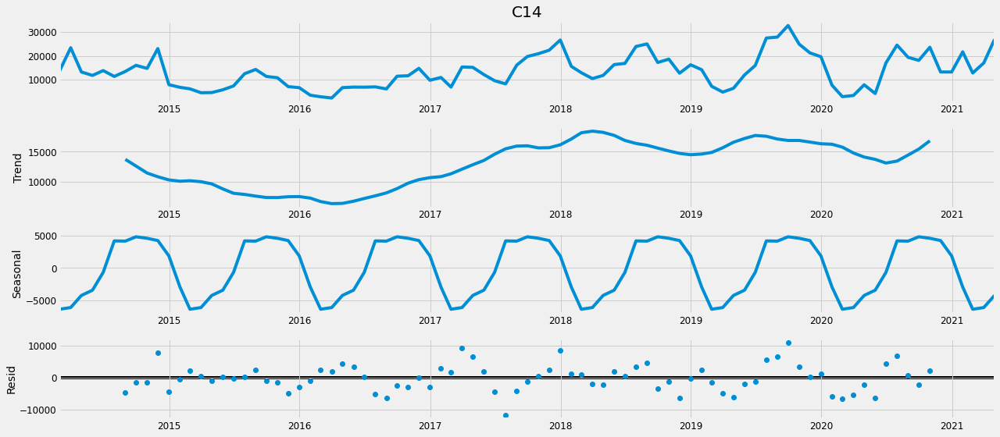

In [1015]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [1016]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [1017]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1902.3428376459276
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1586.0615291743704
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1539.9644362508923
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1284.8289898029618
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1560.1227808935023
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1524.0821874653984
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1307.4440454267735
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1286.2225088218229
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1825.4635044476652
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1560.8916042108644
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1494.3042908502234
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1243.1273020859126
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1595.8034227128164
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1475.2604842404476
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1284.7740741097407
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1243.4306928565936
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1699.2230113027588
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1459.349903

C:\Users\jorge\.conda\envs\tensorflow\lib\site-packages\statsmodels\base\model.py:568: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 0, 0)x(0, 0, 1, 12)12 - AIC:1477.5523589182621
ARIMA(1, 0, 0)x(0, 1, 0, 12)12 - AIC:1505.9986407923777
ARIMA(1, 0, 0)x(0, 1, 1, 12)12 - AIC:1248.319551826012
ARIMA(1, 0, 0)x(1, 0, 0, 12)12 - AIC:1477.4251232255115
ARIMA(1, 0, 0)x(1, 0, 1, 12)12 - AIC:1479.0920845186
ARIMA(1, 0, 0)x(1, 1, 0, 12)12 - AIC:1249.6069805015884
ARIMA(1, 0, 0)x(1, 1, 1, 12)12 - AIC:1248.9511209345465
ARIMA(1, 0, 1)x(0, 0, 0, 12)12 - AIC:1700.626188921823
ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:1460.1625942111136
ARIMA(1, 0, 1)x(0, 1, 0, 12)12 - AIC:1482.4030479360729
ARIMA(1, 0, 1)x(0, 1, 1, 12)12 - AIC:1230.0415943590406
ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:1479.1166677144665
ARIMA(1, 0, 1)x(1, 0, 1, 12)12 - AIC:1461.3238422652312
ARIMA(1, 0, 1)x(1, 1, 0, 12)12 - AIC:1250.9477612874075
ARIMA(1, 0, 1)x(1, 1, 1, 12)12 - AIC:1230.3559491213305
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:1700.463110629484
ARIMA(1, 1, 0)x(0, 0, 1, 12)12 - AIC:1459.0860045652478
ARIMA(1, 1, 0)x(0, 1, 0, 12)12 - AIC:1489.571143435853

#### Ajuste considerando o menor valor de AIC

In [1018]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6964      0.239      2.913      0.004       0.228       1.165
ma.L1         -0.9579      0.166     -5.767      0.000      -1.283      -0.632
ar.S.L12      -0.3277      0.397     -0.826      0.409      -1.105       0.450
ma.S.L12      -0.4419      0.397     -1.113      0.266      -1.220       0.336
sigma2      4.089e+07   8.34e-10    4.9e+16      0.000    4.09e+07    4.09e+07


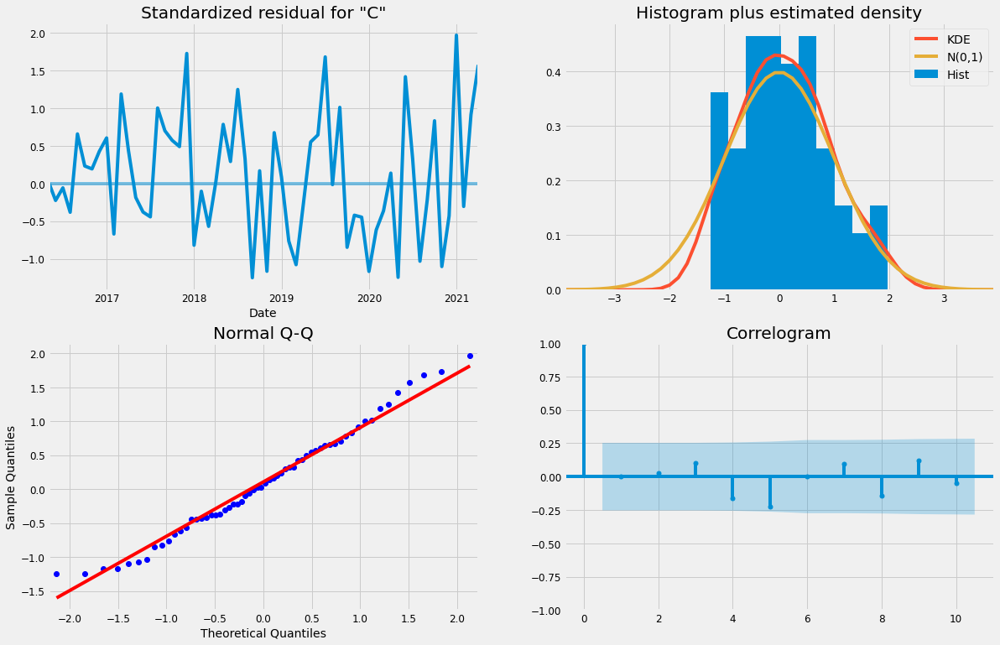

In [1019]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

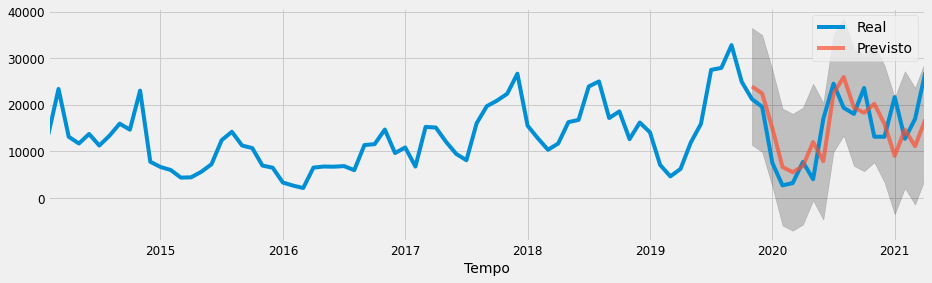

In [1020]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [1021]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_c14_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_c14_rmse)
sarima_c14_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_c14_mse)
sarima_c14_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_c14_mape, '%')
sarima_c14_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  6117.20844539111
MSE:  37420239.16436432
MAPE:  49.88174478731397 %
R2:  0.31131201073838377


### LSTM

#### Divisão da base

training_set

In [1022]:
temp = baltic.loc[baltic['Route'] == 'C14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C14'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,C14
5373,2014-02-24,11593.0
5374,2014-02-25,12482.0
5375,2014-02-26,13821.0
5376,2014-02-27,14969.0
5377,2014-02-28,15416.0


In [1023]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[11593.],
       [12482.],
       [13821.],
       [14969.],
       [15416.]])

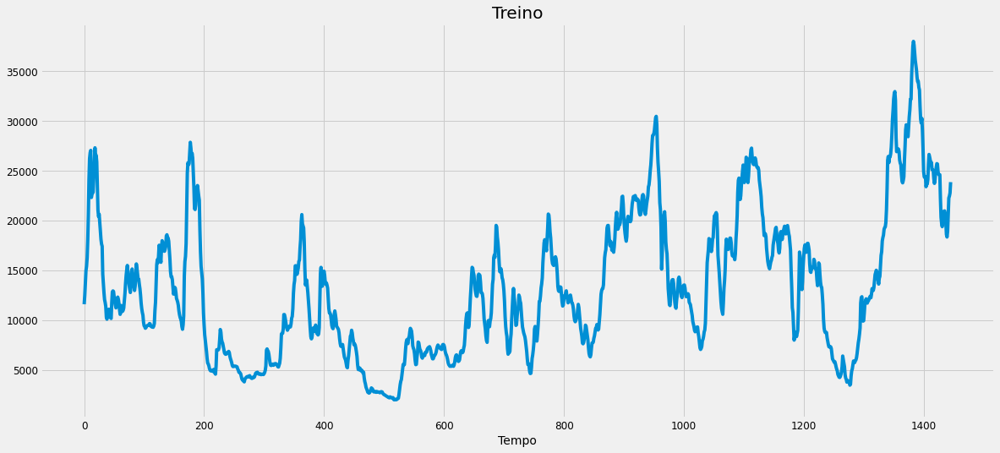

In [1024]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [1025]:
temp = baltic.loc[baltic['Route'] == 'C14'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C14'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,C14
6819,2019-12-02,24493.0
6820,2019-12-03,25202.0
6821,2019-12-04,24916.0
6822,2019-12-05,24229.0
6823,2019-12-06,23704.0


In [1026]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[24493.],
       [25202.],
       [24916.],
       [24229.],
       [23704.]])

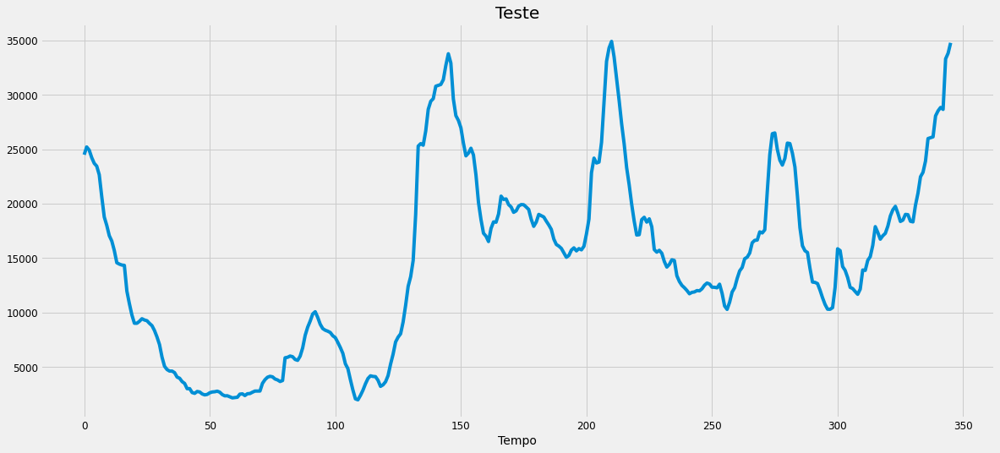

In [1027]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [1028]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [1029]:
training_set_scaled[0:5]

array([[0.26668887],
       [0.29136481],
       [0.32853138],
       [0.36039637],
       [0.37280373]])

##### Criar a estrutura de dados

In [1030]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [1031]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.266689,0.291365,0.328531,0.360396,0.372804,0.396730,0.447359,0.516862,0.614095,0.672967
1,0.291365,0.328531,0.360396,0.372804,0.396730,0.447359,0.516862,0.614095,0.672967,0.689511
2,0.328531,0.360396,0.372804,0.396730,0.447359,0.516862,0.614095,0.672967,0.689511,0.695839
3,0.360396,0.372804,0.396730,0.447359,0.516862,0.614095,0.672967,0.689511,0.695839,0.564493
4,0.372804,0.396730,0.447359,0.516862,0.614095,0.672967,0.689511,0.695839,0.564493,0.574042


In [1032]:
pd.DataFrame(y_train).head()

,0
0,0.689511
1,0.695839
2,0.564493
3,0.574042
4,0.576512


##### *Reshaping*

In [1033]:
X_train.shape

(1436, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [1034]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [1035]:
X_train.shape

(1436, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [1036]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_82 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_82 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_83 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_83 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_84 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_84 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_28 (Dense)             (None, 1)               

###### Treinamento

In [1037]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1292 samples, validate on 144 samples
Epoch 1/1000
1292/1292 [==============================] - 2s 2ms/step - loss: 0.0180 - val_loss: 0.0083
Epoch 2/1000
1292/1292 [==============================] - 1s 797us/step - loss: 0.0063 - val_loss: 0.0124
Epoch 3/1000
1292/1292 [==============================] - 1s 799us/step - loss: 0.0060 - val_loss: 0.0074
Epoch 4/1000
1292/1292 [==============================] - 1s 809us/step - loss: 0.0053 - val_loss: 0.0105
Epoch 5/1000
1292/1292 [==============================] - 1s 796us/step - loss: 0.0046 - val_loss: 0.0072
Epoch 6/1000
1292/1292 [==============================] - 1s 811us/step - loss: 0.0040 - val_loss: 0.0078
Epoch 7/1000
1292/1292 [==============================] - 1s 862us/step - loss: 0.0036 - val_loss: 0.0029
Epoch 8/1000
1292/1292 [==============================] - 1s 832us/step - loss: 0.0031 - val_loss: 0.0071
Epoch 9/1000
1292/1292 [==============================] - 1s 845us/step - loss: 0.0031 - val_loss: 0.0028
E

Epoch 75/1000
1292/1292 [==============================] - 1s 936us/step - loss: 7.4503e-04 - val_loss: 0.0013
Epoch 76/1000
1292/1292 [==============================] - 1s 948us/step - loss: 7.3089e-04 - val_loss: 0.0013
Epoch 77/1000
1292/1292 [==============================] - 1s 958us/step - loss: 6.4167e-04 - val_loss: 5.9153e-04
Epoch 78/1000
1292/1292 [==============================] - 1s 900us/step - loss: 7.5823e-04 - val_loss: 0.0011
Epoch 79/1000
1292/1292 [==============================] - 1s 901us/step - loss: 6.2706e-04 - val_loss: 6.8190e-04
Epoch 80/1000
1292/1292 [==============================] - 1s 891us/step - loss: 6.7621e-04 - val_loss: 0.0010
Epoch 81/1000
1292/1292 [==============================] - 1s 900us/step - loss: 6.0192e-04 - val_loss: 5.9062e-04
Epoch 82/1000
1292/1292 [==============================] - 1s 894us/step - loss: 6.0524e-04 - val_loss: 5.1937e-04
Epoch 83/1000
1292/1292 [==============================] - 1s 909us/step - loss: 6.5964e-04 - va

Epoch 147/1000
1292/1292 [==============================] - 1s 898us/step - loss: 6.0799e-04 - val_loss: 9.3613e-04
Epoch 148/1000
1292/1292 [==============================] - 1s 901us/step - loss: 5.3694e-04 - val_loss: 0.0039
Epoch 149/1000
1292/1292 [==============================] - 1s 904us/step - loss: 6.1529e-04 - val_loss: 4.8900e-04
Epoch 150/1000
1292/1292 [==============================] - 1s 902us/step - loss: 5.4938e-04 - val_loss: 7.4781e-04
Epoch 151/1000
1292/1292 [==============================] - 1s 909us/step - loss: 5.6032e-04 - val_loss: 4.4846e-04
Epoch 152/1000
1292/1292 [==============================] - 1s 892us/step - loss: 5.3917e-04 - val_loss: 0.0011
Epoch 153/1000
1292/1292 [==============================] - 1s 893us/step - loss: 5.6502e-04 - val_loss: 0.0016
Epoch 154/1000
1292/1292 [==============================] - 1s 896us/step - loss: 5.0373e-04 - val_loss: 5.4914e-04
Epoch 155/1000
1292/1292 [==============================] - 1s 895us/step - loss: 6.

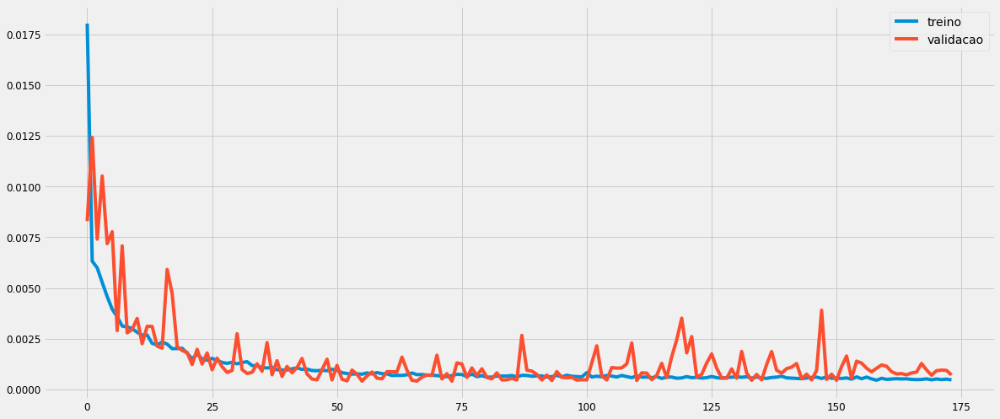

In [1038]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [1039]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [1040]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.6218941 ],
       [0.62748694],
       [0.6544421 ],
       [0.6250222 ],
       [0.6116868 ]], dtype=float32)

In [1041]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[24389.98 ],
       [24591.473],
       [25562.586],
       [24502.674],
       [24022.242]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

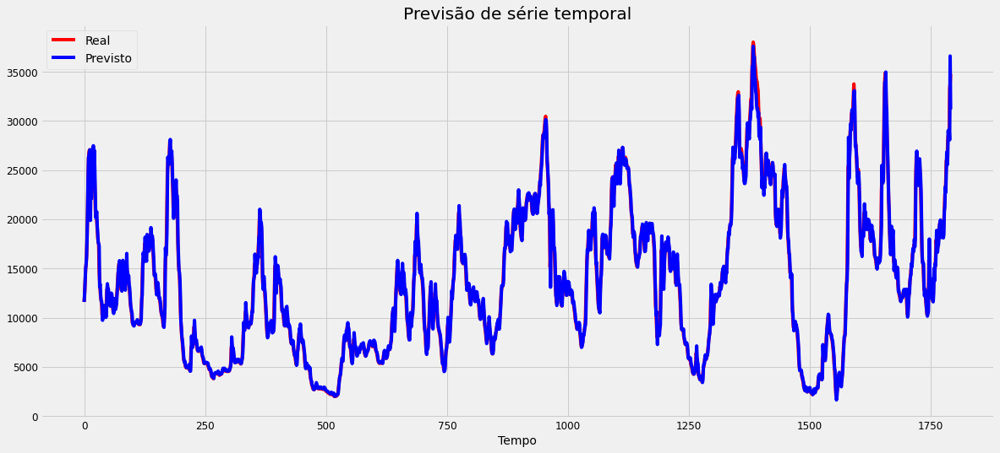

In [1042]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

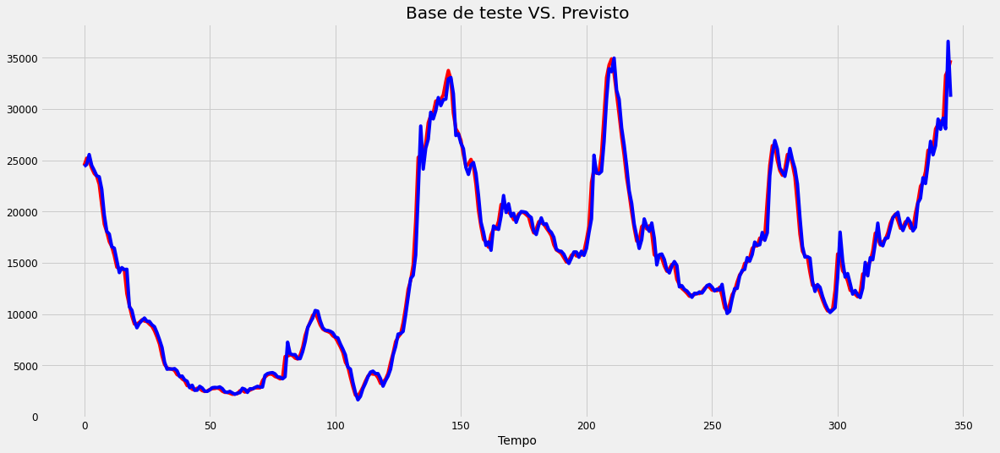

In [1043]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [1044]:
lstm_c14_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_c14_rmse)
lstm_c14_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_c14_mse)
lstm_c14_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_c14_mape, '%')
lstm_c14_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  865.5342851926354
MSE:  749149.5988439263
MAPE:  4.289945681949668 %
R2:  0.989272686137047


## C16

### SARIMA

In [1045]:
data = baltic.loc[baltic['Route'] == 'C16'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C16'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).C16.mean()
data.head()

Date
2014-02-28   -1807.000000
2014-03-31    5533.666667
2014-04-30    1374.050000
2014-05-31   -1385.500000
2014-06-30    -147.047619
Freq: M, Name: C16, dtype: float64

#### Divisão da base

In [1046]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-02-28 00:00:00', freq='M')

In [1047]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-11-30 00:00:00', freq='M')

In [1048]:
y = data.copy()
y.tail()

Date
2020-12-31     -135.666667
2021-01-31     5519.750000
2021-02-28     -752.900000
2021-03-31     2373.478261
2021-04-30    11190.400000
Freq: M, Name: C16, dtype: float64

#### Exibição da série

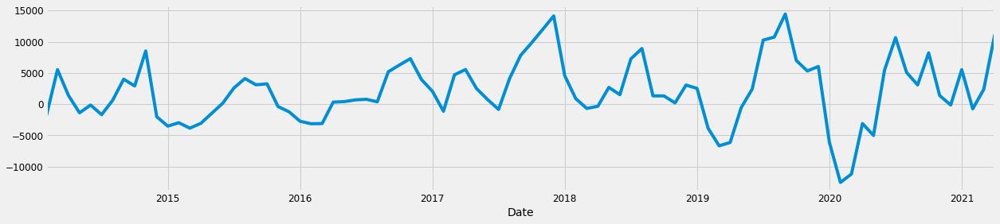

In [1049]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

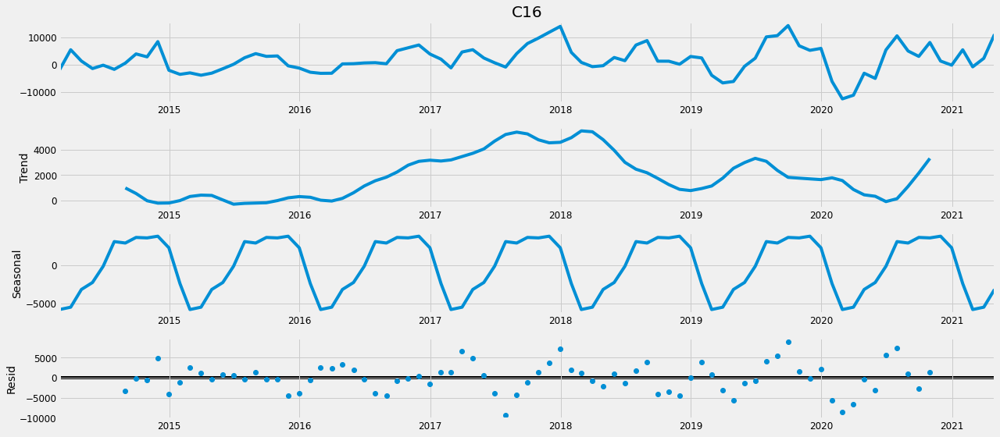

In [1050]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [1051]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [1052]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1726.492322645202
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1486.2326928542286
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1498.353859476747
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1250.1628551394674
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1498.599230683418
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1480.2916183683799
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1274.1055147525146
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1249.077050640025
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1662.2987297633954
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1430.4082722333126
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1454.8426750202382
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1204.3075738818686
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1468.2047845192692
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1430.0900426399885
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1249.7725819002908
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:1206.0090796610496
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1661.4565118682222
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1428.9805016253

#### Ajuste considerando o menor valor de AIC

In [1053]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6327      0.218      2.904      0.004       0.206       1.060
ma.L1         -0.9667      0.178     -5.430      0.000      -1.316      -0.618
ar.S.L12      -0.0140      0.338     -0.041      0.967      -0.677       0.649
ma.S.L12      -0.8311      0.297     -2.800      0.005      -1.413      -0.249
sigma2      2.735e+07   2.39e-09   1.14e+16      0.000    2.74e+07    2.74e+07


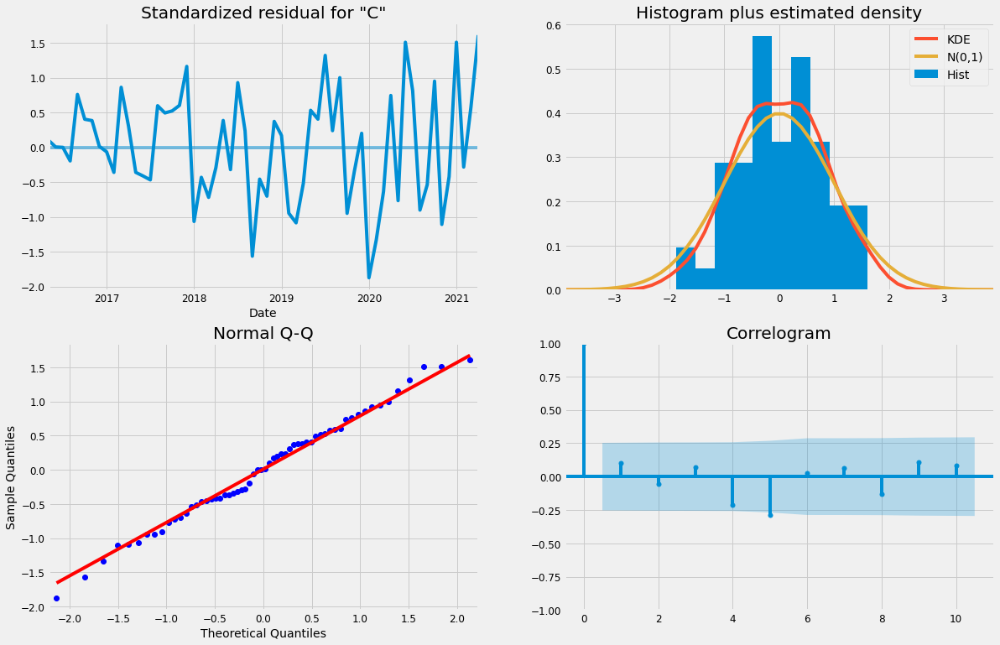

In [1054]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

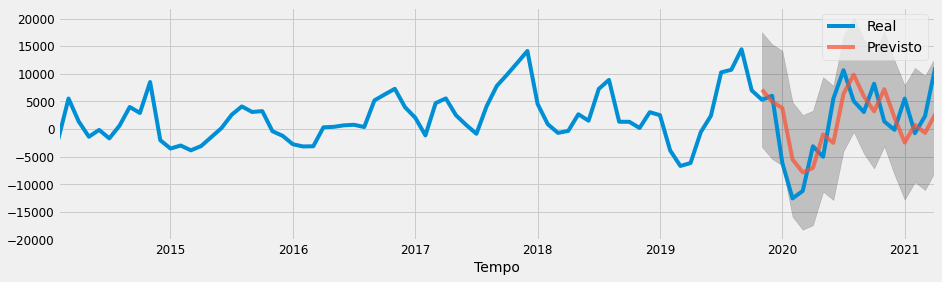

In [1055]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [1056]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_c16_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_c16_rmse)
sarima_c16_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_c16_mse)
sarima_c16_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_c16_mape, '%')
sarima_c16_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  5369.586711850872
MSE:  28832461.45608546
MAPE:  197.2941516027453 %
R2:  0.3463692784157174


### LSTM

#### Divisão da base

training_set

In [1057]:
temp = baltic.loc[baltic['Route'] == 'C16'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C16'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,C16
7165,2014-02-24,-3436.0
7166,2014-02-25,-2986.0
7167,2014-02-26,-2159.0
7168,2014-02-27,-568.0
7169,2014-02-28,114.0


In [1058]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[-3436.],
       [-2986.],
       [-2159.],
       [ -568.],
       [  114.]])

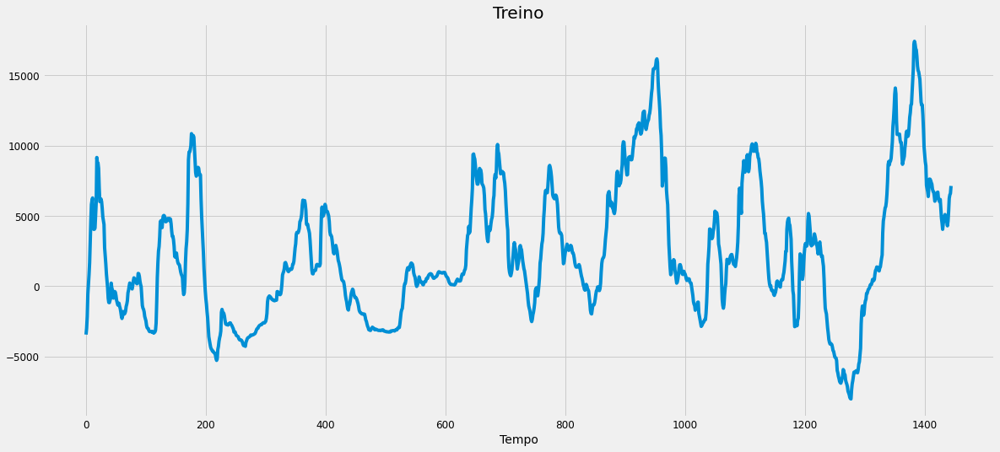

In [1059]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [1060]:
temp = baltic.loc[baltic['Route'] == 'C16'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C16'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,C16
8610,2019-12-02,7615.0
8611,2019-12-03,8140.0
8612,2019-12-04,8890.0
8613,2019-12-05,8990.0
8614,2019-12-06,8915.0


In [1061]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[7615.],
       [8140.],
       [8890.],
       [8990.],
       [8915.]])

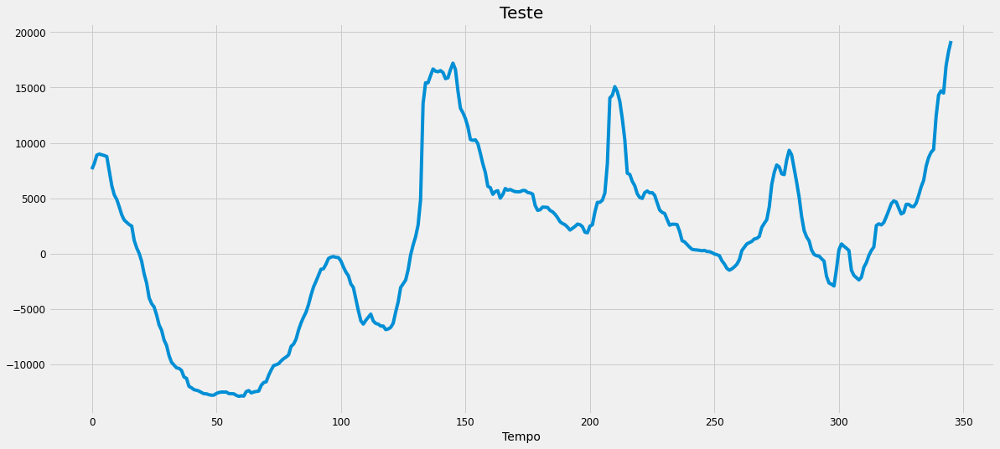

In [1062]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [1063]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [1064]:
training_set_scaled[0:5]

array([[0.17999214],
       [0.19768082],
       [0.23018868],
       [0.29272799],
       [0.31953616]])

##### Criar a estrutura de dados

In [1065]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [1066]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.179992,0.197681,0.230189,0.292728,0.319536,0.347209,0.380621,0.438168,0.497484,0.543750
1,0.197681,0.230189,0.292728,0.319536,0.347209,0.380621,0.438168,0.497484,0.543750,0.555031
2,0.230189,0.292728,0.319536,0.347209,0.380621,0.438168,0.497484,0.543750,0.555031,0.561989
3,0.292728,0.319536,0.347209,0.380621,0.438168,0.497484,0.543750,0.555031,0.561989,0.475865
4,0.319536,0.347209,0.380621,0.438168,0.497484,0.543750,0.555031,0.561989,0.475865,0.474057


In [1067]:
pd.DataFrame(y_train).head()

,0
0,0.555031
1,0.561989
2,0.475865
3,0.474057
4,0.474607


##### *Reshaping*

In [1068]:
X_train.shape

(1435, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [1069]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [1070]:
X_train.shape

(1435, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [1071]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_85 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_85 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_86 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_86 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_87 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_87 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_29 (Dense)             (None, 1)               

###### Treinamento

In [1072]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1291 samples, validate on 144 samples
Epoch 1/1000
1291/1291 [==============================] - 2s 2ms/step - loss: 0.0254 - val_loss: 0.0097
Epoch 2/1000
1291/1291 [==============================] - 1s 777us/step - loss: 0.0075 - val_loss: 0.0065
Epoch 3/1000
1291/1291 [==============================] - 1s 790us/step - loss: 0.0070 - val_loss: 0.0063
Epoch 4/1000
1291/1291 [==============================] - 1s 792us/step - loss: 0.0065 - val_loss: 0.0057
Epoch 5/1000
1291/1291 [==============================] - 1s 786us/step - loss: 0.0067 - val_loss: 0.0075
Epoch 6/1000
1291/1291 [==============================] - 1s 780us/step - loss: 0.0054 - val_loss: 0.0047
Epoch 7/1000
1291/1291 [==============================] - 1s 773us/step - loss: 0.0047 - val_loss: 0.0043
Epoch 8/1000
1291/1291 [==============================] - 1s 802us/step - loss: 0.0046 - val_loss: 0.0025
Epoch 9/1000
1291/1291 [==============================] - 1s 781us/step - loss: 0.0040 - val_loss: 0.0093
E

1291/1291 [==============================] - 1s 866us/step - loss: 7.8938e-04 - val_loss: 3.4916e-04
Epoch 76/1000
1291/1291 [==============================] - 1s 867us/step - loss: 6.9792e-04 - val_loss: 3.5053e-04
Epoch 77/1000
1291/1291 [==============================] - 1s 867us/step - loss: 8.3655e-04 - val_loss: 3.8038e-04
Epoch 78/1000
1291/1291 [==============================] - 1s 866us/step - loss: 7.6644e-04 - val_loss: 5.2337e-04
Epoch 79/1000
1291/1291 [==============================] - 1s 880us/step - loss: 7.6736e-04 - val_loss: 4.4681e-04
Epoch 80/1000
1291/1291 [==============================] - 1s 877us/step - loss: 7.1662e-04 - val_loss: 7.4740e-04
Epoch 81/1000
1291/1291 [==============================] - 1s 879us/step - loss: 7.0276e-04 - val_loss: 3.7613e-04
Epoch 82/1000
1291/1291 [==============================] - 1s 936us/step - loss: 7.2441e-04 - val_loss: 3.3316e-04
Epoch 83/1000
1291/1291 [==============================] - 1s 925us/step - loss: 6.9500e-04 - 

1291/1291 [==============================] - 1s 920us/step - loss: 5.2107e-04 - val_loss: 3.0839e-04
Epoch 147/1000
1291/1291 [==============================] - 1s 900us/step - loss: 5.1401e-04 - val_loss: 3.4101e-04
Epoch 148/1000
1291/1291 [==============================] - 1s 861us/step - loss: 4.7771e-04 - val_loss: 4.8998e-04
Epoch 149/1000
1291/1291 [==============================] - 1s 892us/step - loss: 5.1374e-04 - val_loss: 3.6141e-04
Epoch 150/1000
1291/1291 [==============================] - 1s 866us/step - loss: 5.4418e-04 - val_loss: 3.7126e-04
Epoch 151/1000
1291/1291 [==============================] - 1s 919us/step - loss: 5.3207e-04 - val_loss: 7.3819e-04
Epoch 152/1000
1291/1291 [==============================] - 1s 908us/step - loss: 6.3544e-04 - val_loss: 3.5863e-04
Epoch 153/1000
1291/1291 [==============================] - 1s 911us/step - loss: 6.6234e-04 - val_loss: 2.8460e-04
Epoch 154/1000
1291/1291 [==============================] - 1s 871us/step - loss: 5.113

Epoch 217/1000
1291/1291 [==============================] - 1s 928us/step - loss: 4.2330e-04 - val_loss: 2.7875e-04
Epoch 218/1000
1291/1291 [==============================] - 1s 942us/step - loss: 4.2664e-04 - val_loss: 2.7700e-04
Epoch 219/1000
1291/1291 [==============================] - 1s 961us/step - loss: 4.4564e-04 - val_loss: 3.3307e-04
Epoch 220/1000
1291/1291 [==============================] - 1s 981us/step - loss: 4.4167e-04 - val_loss: 3.0721e-04
Epoch 221/1000
1291/1291 [==============================] - 1s 960us/step - loss: 4.6989e-04 - val_loss: 2.9318e-04
Epoch 222/1000
1291/1291 [==============================] - 1s 946us/step - loss: 4.4357e-04 - val_loss: 2.8087e-04
Epoch 223/1000
1291/1291 [==============================] - 1s 916us/step - loss: 4.7626e-04 - val_loss: 2.8884e-04
Epoch 224/1000
1291/1291 [==============================] - 1s 917us/step - loss: 3.8537e-04 - val_loss: 3.4683e-04
Epoch 225/1000
1291/1291 [==============================] - 1s 912us/ste

1291/1291 [==============================] - 1s 967us/step - loss: 4.3024e-04 - val_loss: 2.8038e-04
Epoch 288/1000
1291/1291 [==============================] - 1s 921us/step - loss: 4.2681e-04 - val_loss: 2.9619e-04
Epoch 289/1000
1291/1291 [==============================] - 1s 922us/step - loss: 4.5388e-04 - val_loss: 2.8260e-04
Epoch 290/1000
1291/1291 [==============================] - 1s 928us/step - loss: 4.1290e-04 - val_loss: 2.8292e-04
Epoch 291/1000
1291/1291 [==============================] - 1s 980us/step - loss: 4.1607e-04 - val_loss: 2.8660e-04
Epoch 292/1000
1291/1291 [==============================] - 1s 982us/step - loss: 4.0889e-04 - val_loss: 2.9506e-04
Epoch 293/1000
1291/1291 [==============================] - 1s 940us/step - loss: 4.2514e-04 - val_loss: 3.0338e-04
Epoch 294/1000
1291/1291 [==============================] - 1s 928us/step - loss: 4.3835e-04 - val_loss: 2.8721e-04
Epoch 295/1000
1291/1291 [==============================] - 1s 931us/step - loss: 4.048

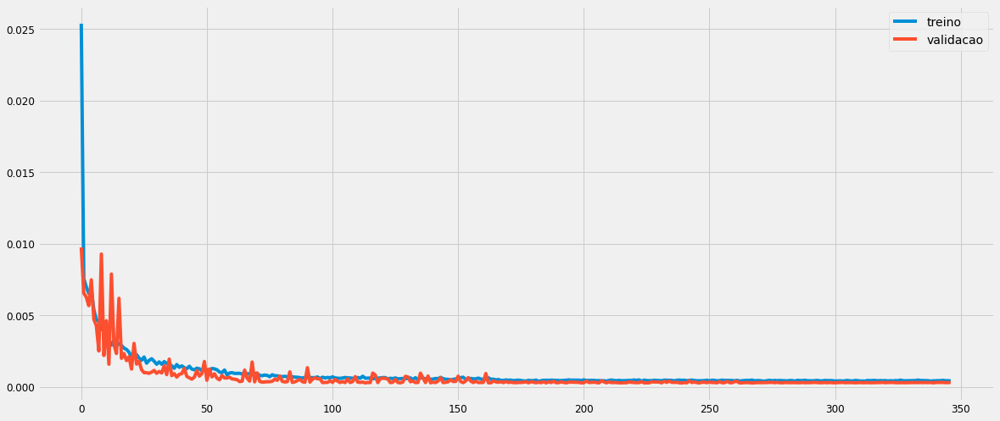

In [1073]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [1074]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [1075]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.6046629],
       [0.6195974],
       [0.6413944],
       [0.674405 ],
       [0.6628169]], dtype=float32)

In [1076]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[7367.6235],
       [7747.557 ],
       [8302.072 ],
       [9141.862 ],
       [8847.062 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

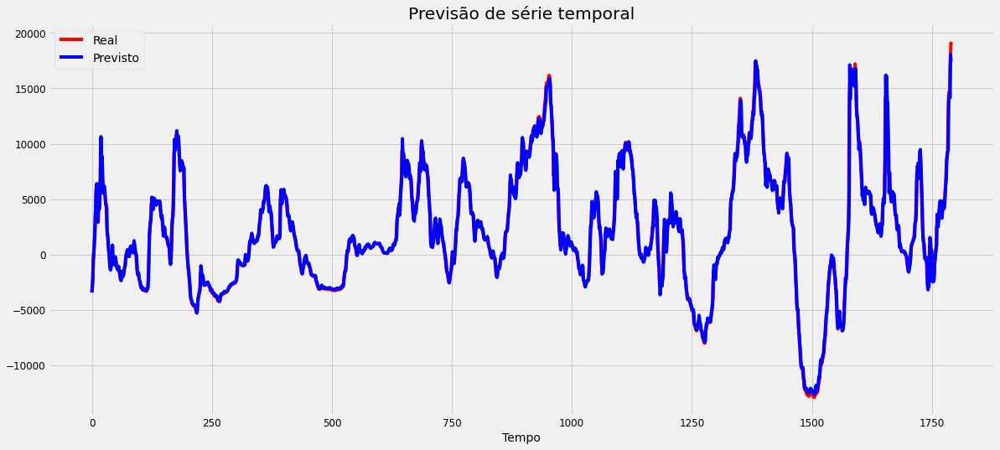

In [1077]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

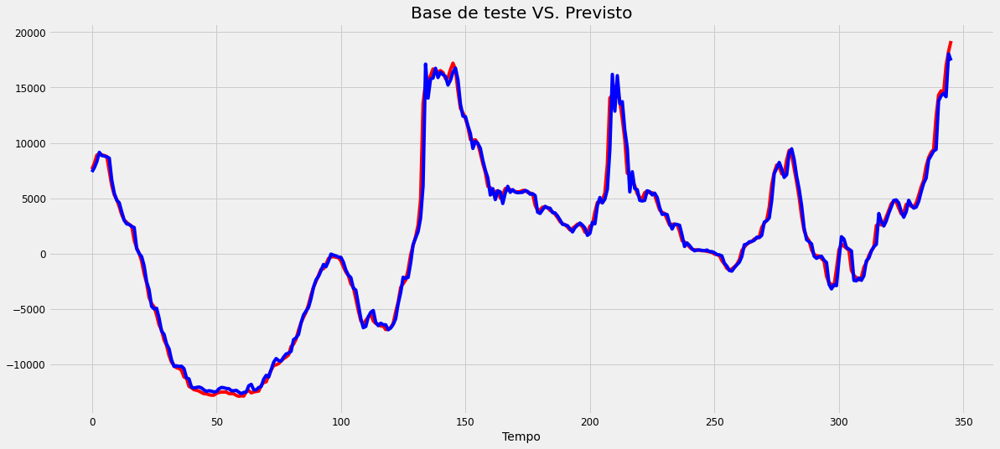

In [1078]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [1079]:
lstm_c16_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_c16_rmse)
lstm_c16_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_c16_mse)
lstm_c16_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_c16_mape, '%')
lstm_c16_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  748.1828377672069
MSE:  559777.5587293906
MAPE:  17.504854945227034 %
R2:  0.9901625394827414


## C17

### SARIMA

In [1080]:
data = baltic.loc[baltic['Route'] == 'C17'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C17'})
data = data.groupby([pd.Grouper(key='Date', freq='M')]).C17.mean()
data.head()

Date
2014-11-30    13715.000000
2014-12-31     9216.000000
2015-01-31     7546.952381
2015-02-28     7272.100000
2015-03-31     7394.545455
Freq: M, Name: C17, dtype: float64

#### Divisão da base

In [1081]:
# Início da série
straining = data.index[0]
straining

Timestamp('2014-11-30 00:00:00', freq='M')

In [1082]:
# 80% da série
etraining = data.index[int(len(data) - (round((len(data) * .2),0))) - 1]
etraining

Timestamp('2019-12-31 00:00:00', freq='M')

In [1083]:
y = data.copy()
y.tail()

Date
2020-12-31    10571.333333
2021-01-31    13869.550000
2021-02-28    11786.900000
2021-03-31    14907.173913
2021-04-30    18673.000000
Freq: M, Name: C17, dtype: float64

#### Exibição da série

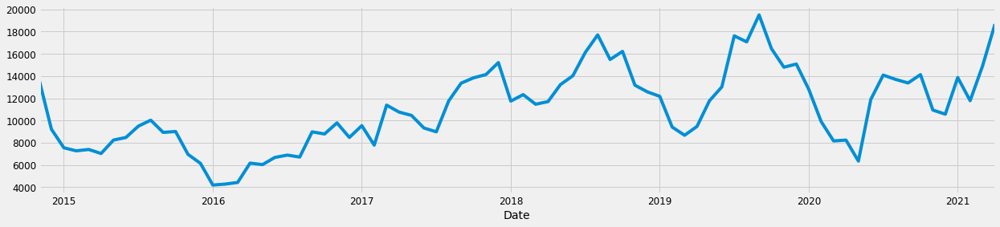

In [1084]:
y.plot(figsize=(19, 4))
plt.show()

#### Decomposição da série

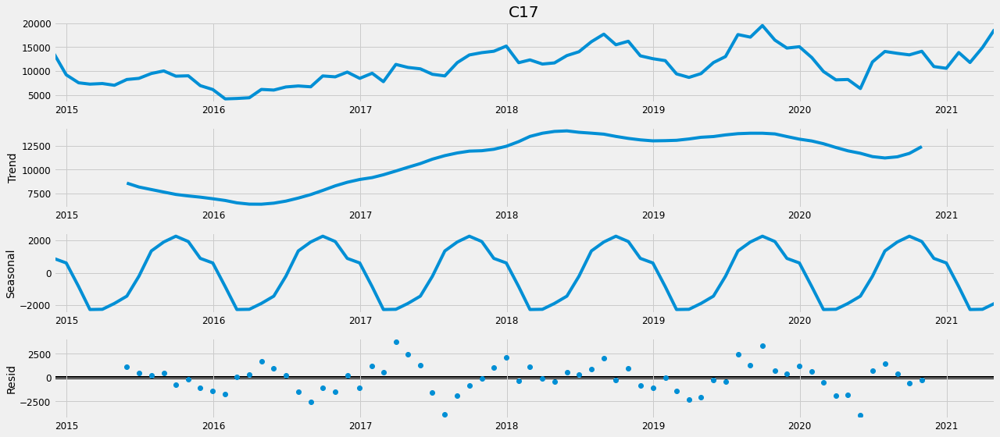

In [1085]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

#### Parâmetros

In [1086]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Exemplos de parâmetros com base no AIC (Akaike information criterion) para SARIMA. Quanto menor o valor, melhor...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [1087]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param,param_seasonal,results.aic))
        except: 
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1661.3734910406295
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:1380.8846302944007
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:1252.4527947769252
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1029.6160711856617
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:1276.0034917809471
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:1250.1463473009262
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:1048.3083025782034
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1031.4787824546554
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:1589.6496049287866
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:1333.6300416277275
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:1212.4368884731507
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:990.2831380970174
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1257.4186403961826
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1204.8904450590483
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:1024.656366683228
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:990.0053173693647
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:1360.3516173072874
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:1155.478739915

#### Ajuste considerando o menor valor de AIC

In [1088]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4752      0.880     -0.540      0.589      -2.201       1.250
ma.L1          0.3310      0.970      0.341      0.733      -1.571       2.233
ar.S.L12      -0.3295      0.346     -0.953      0.341      -1.007       0.348
ma.S.L12      -0.3659      0.293     -1.249      0.212      -0.940       0.208
sigma2      4.437e+06   1.02e+06      4.345      0.000    2.44e+06    6.44e+06


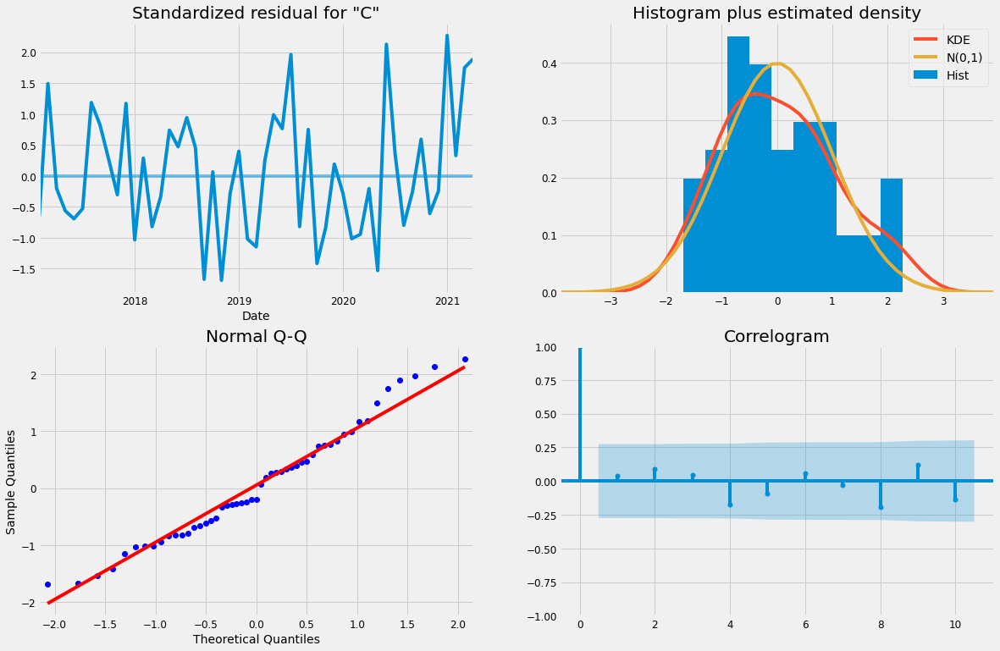

In [1089]:
results.plot_diagnostics(figsize=(18, 12))
plt.show()

#### Previsão

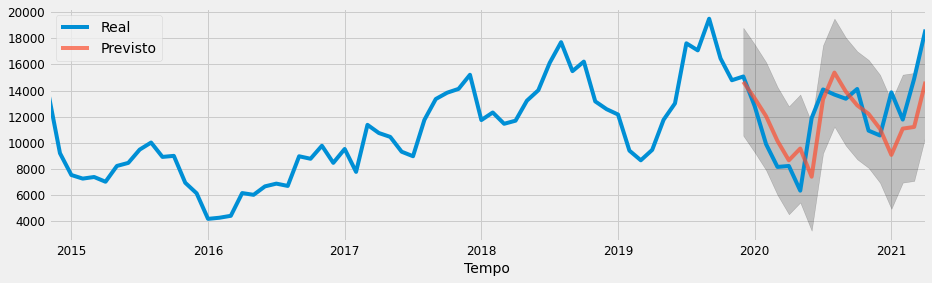

In [1090]:
pred = results.get_prediction(start=pd.to_datetime(etraining), dynamic=False)
pred_ci = pred.conf_int()
ax = y['2006':].plot(label='Real')
pred.predicted_mean.plot(ax=ax, label='Previsto', alpha=.7, figsize=(14, 4))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Tempo')
ax.set_ylabel('')
plt.legend()
plt.show()

#### Métricas de avaliação

In [1091]:
y_forecasted = pred.predicted_mean
y_truth = y[etraining:]
sarima_c17_rmse = math.sqrt(mean_squared_error(y_truth, y_forecasted))
print('RMSE: ', sarima_c17_rmse)
sarima_c17_mse = mean_squared_error(y_truth, y_forecasted)
print('MSE: ',sarima_c17_mse)
sarima_c17_mape = np.mean(np.abs((y_truth - y_forecasted) / y_truth)) * 100
print('MAPE: ',sarima_c17_mape, '%')
sarima_c17_r2score = r2_score(y_truth, y_forecasted)
print('R2: ', r2_score(y_truth, y_forecasted))

RMSE:  2421.8605966576083
MSE:  5865408.749642746
MAPE:  16.499972667023282 %
R2:  0.3240653679536102


### LSTM

#### Divisão da base

training_set

In [1092]:
temp = baltic.loc[baltic['Route'] == 'C17'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C17'})
dataset_train = temp.loc[temp.Date < etraining].copy()
dataset_train.head()

,Date,C17
16268,2014-11-25,14120.0
16269,2014-11-26,13925.0
16270,2014-11-27,13565.0
16271,2014-11-28,13250.0
16272,2014-12-01,13085.0


In [1093]:
training_set = dataset_train.iloc[:, 1:2].values #só coluna da série em si
training_set[0:5]

array([[14120.],
       [13925.],
       [13565.],
       [13250.],
       [13085.]])

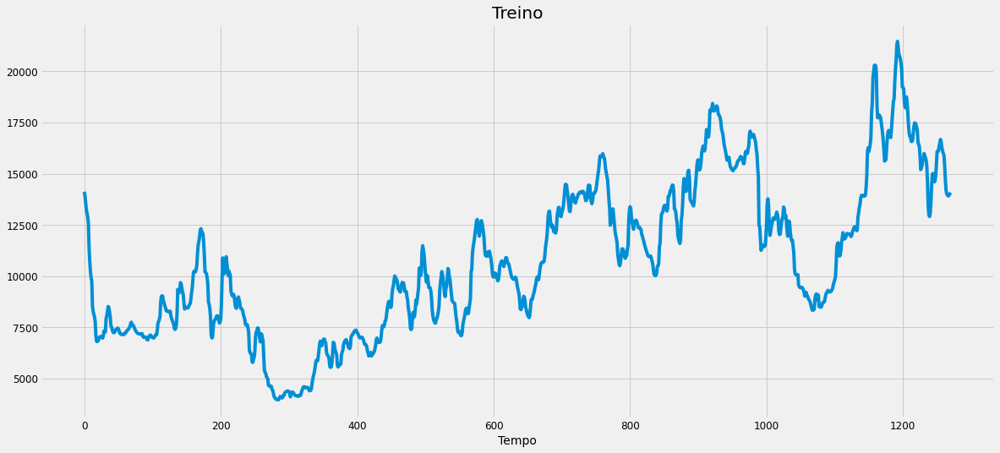

In [1094]:
plt.plot(training_set)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Treino")
plt.show()

test_baltic

In [1095]:
temp = baltic.loc[baltic['Route'] == 'C17'].copy().drop(columns=['Route']).rename(columns = {'USD': 'C17'})
dataset_test = temp.loc[temp.Date >= etraining].copy()
dataset_test.head()

,Date,C17
17539,2020-01-02,13850.0
17540,2020-01-03,13795.0
17541,2020-01-06,13710.0
17542,2020-01-07,13590.0
17543,2020-01-08,13680.0


In [1096]:
test_baltic = dataset_test.iloc[:, 1:2].values #só coluna da série em si
test_baltic[0:5]

array([[13850.],
       [13795.],
       [13710.],
       [13590.],
       [13680.]])

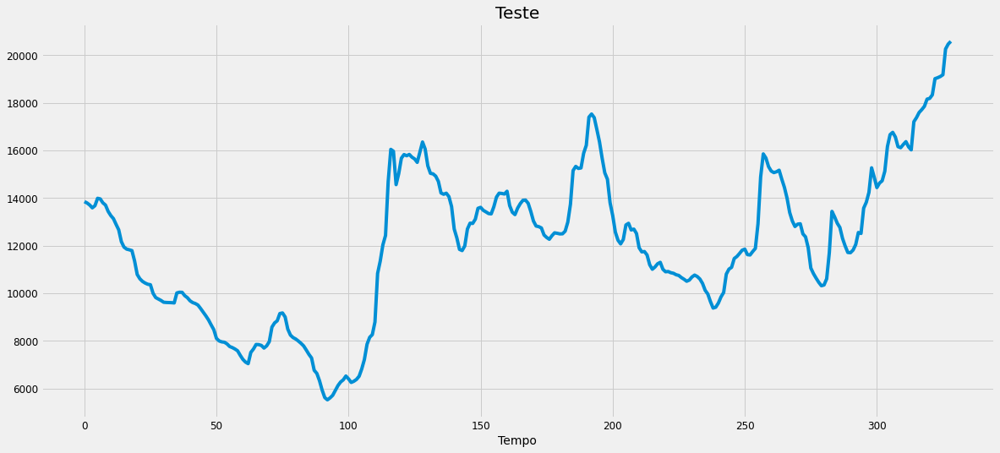

In [1097]:
plt.plot(test_baltic)
plt.xlabel("Tempo")
plt.ylabel("")
plt.title("Teste")
plt.show()

#### Treino

##### Normalização

In [1098]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

In [1099]:
training_set_scaled[0:5]

array([[0.58056953],
       [0.56941903],
       [0.54883349],
       [0.53082113],
       [0.52138609]])

##### Criar a estrutura de dados

In [1100]:
window = 10
look_back = 9
trainSize = len(training_set_scaled)
X_train = []
y_train = []
for i in range(window, trainSize):
    # X_train.append(training_set_scaled[i-window:i, 0])
    X_train.append(np.hstack((training_set_scaled[i-window,0], training_set_scaled[i-look_back:i,0])))
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)

In [1101]:
pd.DataFrame(X_train).head()

,0,1,2,3,4,5,6,7,8,9
0,0.580570,0.569419,0.548833,0.530821,0.521386,0.511379,0.492223,0.426178,0.386608,0.358417
1,0.569419,0.548833,0.530821,0.521386,0.511379,0.492223,0.426178,0.386608,0.358417,0.340977
2,0.548833,0.530821,0.521386,0.511379,0.492223,0.426178,0.386608,0.358417,0.340977,0.330684
3,0.530821,0.521386,0.511379,0.492223,0.426178,0.386608,0.358417,0.340977,0.330684,0.262065
4,0.521386,0.511379,0.492223,0.426178,0.386608,0.358417,0.340977,0.330684,0.262065,0.246340


In [1102]:
pd.DataFrame(y_train).head()

,0
0,0.340977
1,0.330684
2,0.262065
3,0.246340
4,0.238907


##### *Reshaping*

In [1103]:
X_train.shape

(1261, 10)

Shape de input da lstm = (batch_size, timesteps, features)

In [1104]:
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

In [1105]:
X_train.shape

(1261, 10, 1)

##### Construção da RNN

###### Construção da Rede completa

In [1106]:
# Inicializar a RNN
regressor = Sequential()

# Adicionar a primeira camada LSTM e Dropout 
regressor.add(LSTM(units = 100, return_sequences = True, input_shape = (X_train.shape[1], X_train.shape[2])))
regressor.add(Dropout(0.2))
 
# Adicionar a segunda camada LSTM e Dropout
regressor.add(LSTM(units = 80, return_sequences = True))
regressor.add(Dropout(0.2))
 
# Adicionar a terceira camada LSTM e Dropout
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))
 
# camada de saída
regressor.add(Dense(units = 1))
 
# Compilar a rede
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# Visualizar a rede
regressor.summary()

Model: "sequential_30"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_88 (LSTM)               (None, 10, 100)           40800     
_________________________________________________________________
dropout_88 (Dropout)         (None, 10, 100)           0         
_________________________________________________________________
lstm_89 (LSTM)               (None, 10, 80)            57920     
_________________________________________________________________
dropout_89 (Dropout)         (None, 10, 80)            0         
_________________________________________________________________
lstm_90 (LSTM)               (None, 50)                26200     
_________________________________________________________________
dropout_90 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_30 (Dense)             (None, 1)               

###### Treinamento

In [1107]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
es = EarlyStopping(patience=100)
rlr = ReduceLROnPlateau(patience=100)
mc = ModelCheckpoint(filepath='best.h5', save_best_only=True) # se quiser manter um tracking da época e do erro: 'best_{epoch:03d}-{val_loss:.4f}.h5'

history = regressor.fit(X_train, y_train, epochs = 1000, batch_size = 32, validation_split=0.1, callbacks=[es, mc, rlr])

Train on 1134 samples, validate on 127 samples
Epoch 1/1000
1134/1134 [==============================] - 2s 2ms/step - loss: 0.0246 - val_loss: 0.0145
Epoch 2/1000
1134/1134 [==============================] - 1s 822us/step - loss: 0.0052 - val_loss: 0.0115
Epoch 3/1000
1134/1134 [==============================] - 1s 828us/step - loss: 0.0048 - val_loss: 0.0084
Epoch 4/1000
1134/1134 [==============================] - 1s 882us/step - loss: 0.0046 - val_loss: 0.0084
Epoch 5/1000
1134/1134 [==============================] - 1s 857us/step - loss: 0.0039 - val_loss: 0.0072
Epoch 6/1000
1134/1134 [==============================] - 1s 878us/step - loss: 0.0041 - val_loss: 0.0068
Epoch 7/1000
1134/1134 [==============================] - 1s 843us/step - loss: 0.0038 - val_loss: 0.0085
Epoch 8/1000
1134/1134 [==============================] - 1s 828us/step - loss: 0.0036 - val_loss: 0.0067
Epoch 9/1000
1134/1134 [==============================] - 1s 826us/step - loss: 0.0036 - val_loss: 0.0085
E

1134/1134 [==============================] - 1s 1ms/step - loss: 7.6536e-04 - val_loss: 5.6946e-04
Epoch 77/1000
1134/1134 [==============================] - 1s 1ms/step - loss: 7.3965e-04 - val_loss: 8.4671e-04
Epoch 78/1000
1134/1134 [==============================] - 1s 1ms/step - loss: 7.8293e-04 - val_loss: 7.2943e-04
Epoch 79/1000
1134/1134 [==============================] - 1s 967us/step - loss: 7.0045e-04 - val_loss: 5.8459e-04
Epoch 80/1000
1134/1134 [==============================] - 1s 961us/step - loss: 7.8362e-04 - val_loss: 5.5956e-04
Epoch 81/1000
1134/1134 [==============================] - 1s 964us/step - loss: 7.3010e-04 - val_loss: 8.8238e-04
Epoch 82/1000
1134/1134 [==============================] - 1s 956us/step - loss: 7.7829e-04 - val_loss: 6.2488e-04
Epoch 83/1000
1134/1134 [==============================] - 1s 963us/step - loss: 7.4968e-04 - val_loss: 6.9622e-04
Epoch 84/1000
1134/1134 [==============================] - 1s 961us/step - loss: 7.0608e-04 - val_lo

1134/1134 [==============================] - 1s 893us/step - loss: 5.5012e-04 - val_loss: 4.4449e-04
Epoch 148/1000
1134/1134 [==============================] - 1s 969us/step - loss: 5.4495e-04 - val_loss: 4.4297e-04
Epoch 149/1000
1134/1134 [==============================] - 1s 941us/step - loss: 5.3499e-04 - val_loss: 7.6432e-04
Epoch 150/1000
1134/1134 [==============================] - 1s 969us/step - loss: 5.6175e-04 - val_loss: 4.1484e-04
Epoch 151/1000
1134/1134 [==============================] - 1s 910us/step - loss: 5.4224e-04 - val_loss: 0.0011
Epoch 152/1000
1134/1134 [==============================] - 1s 919us/step - loss: 5.9848e-04 - val_loss: 4.3498e-04
Epoch 153/1000
1134/1134 [==============================] - 1s 904us/step - loss: 5.6739e-04 - val_loss: 9.1684e-04
Epoch 154/1000
1134/1134 [==============================] - 1s 898us/step - loss: 5.4418e-04 - val_loss: 5.3168e-04
Epoch 155/1000
1134/1134 [==============================] - 1s 918us/step - loss: 5.5991e-0

Epoch 218/1000
1134/1134 [==============================] - 1s 960us/step - loss: 4.2633e-04 - val_loss: 4.1035e-04
Epoch 219/1000
1134/1134 [==============================] - 1s 981us/step - loss: 4.0959e-04 - val_loss: 4.2306e-04
Epoch 220/1000
1134/1134 [==============================] - 1s 918us/step - loss: 4.4303e-04 - val_loss: 4.5677e-04
Epoch 221/1000
1134/1134 [==============================] - 1s 944us/step - loss: 4.2019e-04 - val_loss: 4.1231e-04
Epoch 222/1000
1134/1134 [==============================] - 1s 926us/step - loss: 4.2885e-04 - val_loss: 4.3176e-04
Epoch 223/1000
1134/1134 [==============================] - 1s 971us/step - loss: 4.2181e-04 - val_loss: 4.9182e-04
Epoch 224/1000
1134/1134 [==============================] - 1s 961us/step - loss: 4.2198e-04 - val_loss: 5.3246e-04
Epoch 225/1000
1134/1134 [==============================] - 1s 996us/step - loss: 4.6915e-04 - val_loss: 4.6672e-04
Epoch 226/1000
1134/1134 [==============================] - 1s 908us/ste

1134/1134 [==============================] - 1s 979us/step - loss: 4.0947e-04 - val_loss: 4.0915e-04
Epoch 289/1000
1134/1134 [==============================] - 1s 940us/step - loss: 3.7625e-04 - val_loss: 5.1642e-04
Epoch 290/1000
1134/1134 [==============================] - 1s 923us/step - loss: 4.1389e-04 - val_loss: 4.2838e-04
Epoch 291/1000
1134/1134 [==============================] - 1s 934us/step - loss: 4.1713e-04 - val_loss: 5.4327e-04
Epoch 292/1000
1134/1134 [==============================] - 1s 899us/step - loss: 4.5045e-04 - val_loss: 5.9555e-04
Epoch 293/1000
1134/1134 [==============================] - 1s 916us/step - loss: 3.7576e-04 - val_loss: 4.5405e-04
Epoch 294/1000
1134/1134 [==============================] - 1s 909us/step - loss: 4.2597e-04 - val_loss: 5.3758e-04
Epoch 295/1000
1134/1134 [==============================] - 1s 906us/step - loss: 3.9071e-04 - val_loss: 3.9688e-04
Epoch 296/1000
1134/1134 [==============================] - 1s 903us/step - loss: 4.282

Epoch 359/1000
1134/1134 [==============================] - 1s 967us/step - loss: 3.7036e-04 - val_loss: 4.5122e-04
Epoch 360/1000
1134/1134 [==============================] - 1s 966us/step - loss: 3.9904e-04 - val_loss: 4.3412e-04
Epoch 361/1000
1134/1134 [==============================] - 1s 932us/step - loss: 4.3733e-04 - val_loss: 4.3183e-04
Epoch 362/1000
1134/1134 [==============================] - 1s 967us/step - loss: 3.8101e-04 - val_loss: 4.5572e-04
Epoch 363/1000
1134/1134 [==============================] - 1s 967us/step - loss: 4.0181e-04 - val_loss: 4.4219e-04
Epoch 364/1000
1134/1134 [==============================] - 1s 972us/step - loss: 4.0432e-04 - val_loss: 4.4588e-04
Epoch 365/1000
1134/1134 [==============================] - 1s 956us/step - loss: 4.0086e-04 - val_loss: 4.1516e-04
Epoch 366/1000
1134/1134 [==============================] - 1s 962us/step - loss: 4.4280e-04 - val_loss: 4.4639e-04
Epoch 367/1000
1134/1134 [==============================] - 1s 960us/ste

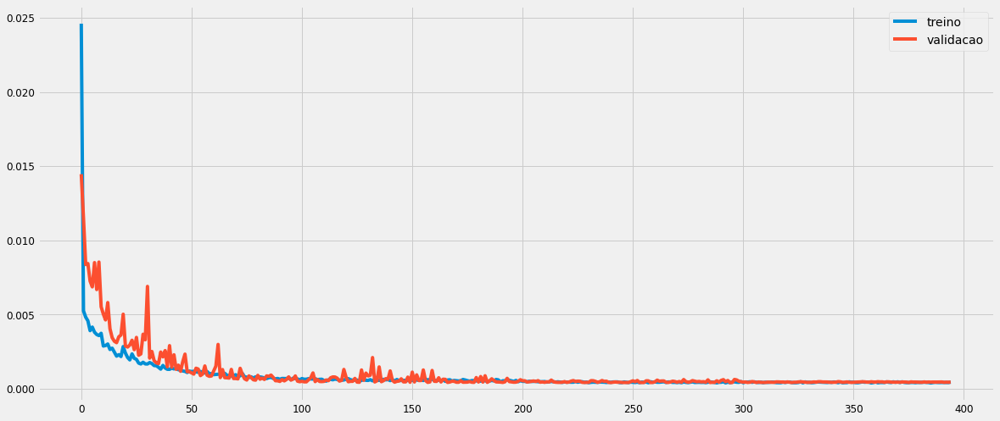

In [1108]:
plt.plot(history.history['loss'], label='treino')
plt.plot(history.history['val_loss'], label='validacao')
plt.legend();

#### Teste

##### Construir a estrutura

In [1109]:
dataset_total = pd.concat((dataset_train.iloc[:,1], dataset_test.iloc[:,1]), axis = 0)
testLength = len(dataset_test)
inputs = dataset_total[len(dataset_total) - testLength - window:].values
inputs = inputs.reshape(inputs.shape[0],1)

inputs = sc.transform(inputs)
X_test = []
for i in range(window, inputs.shape[0]): 
    # X_test.append(inputs[i-window:i, 0])
    X_test.append(np.hstack((inputs[i-window,0], inputs[i-look_back:i,0])))
    
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

##### Fazer as previsões

In [1110]:
predicted_baltic = regressor.predict(X_test)
predicted_baltic[0:5]

array([[0.5759207 ],
       [0.5571521 ],
       [0.5590917 ],
       [0.55409354],
       [0.5451916 ]], dtype=float32)

In [1111]:
predicted_baltic = sc.inverse_transform(predicted_baltic)
predicted_baltic[0:5]

array([[14038.701 ],
       [13710.476 ],
       [13744.3955],
       [13656.988 ],
       [13501.311 ]], dtype=float32)

##### Visualizar os resultados da previsão e realizado

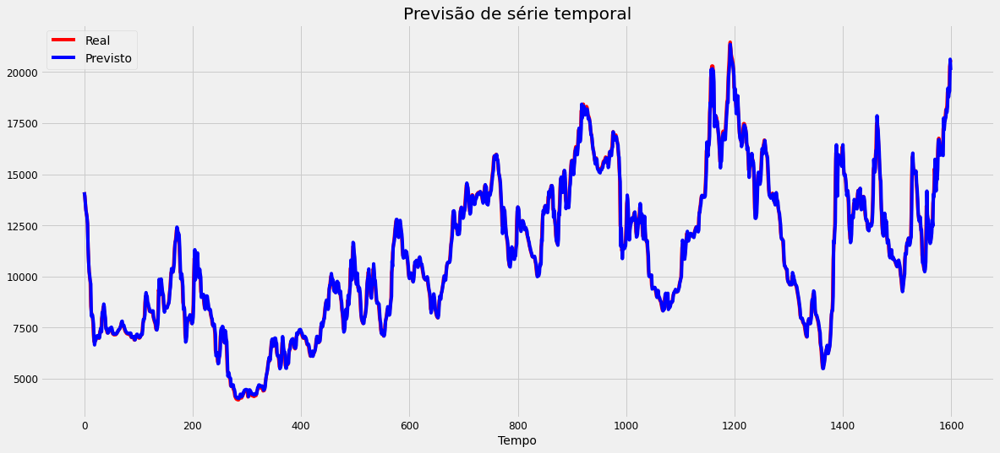

In [1112]:
allTargetData = np.vstack((training_set, test_baltic))
training_predicted_baltic = regressor.predict(X_train)
training_predicted_baltic = sc.inverse_transform(training_predicted_baltic)
allForecastedData = np.vstack((training_set[0:window], training_predicted_baltic, predicted_baltic))
plt.plot(allTargetData, color = 'red', label = 'Real')
plt.plot(allForecastedData, color = 'blue', label = 'Previsto')
plt.title('Previsão de série temporal')
plt.xlabel('Tempo')
plt.ylabel('')
plt.legend()
plt.show()

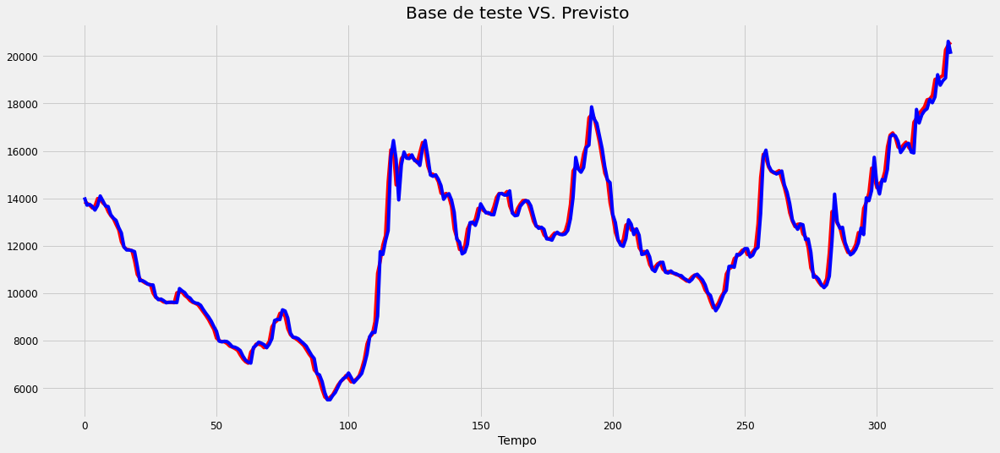

In [1113]:
plt.plot(test_baltic, color = 'red', label = 'Real')
plt.plot(predicted_baltic, color = 'blue', label = 'Previsto')
plt.title('Base de teste VS. Previsto')
plt.xlabel('Tempo')
plt.show()

##### Métricas de avaliação

In [1114]:
lstm_c17_rmse = math.sqrt(mean_squared_error(test_baltic, predicted_baltic))
print('RMSE: ', lstm_c17_rmse)
lstm_c17_mse = mean_squared_error(test_baltic, predicted_baltic)
print('MSE: ',lstm_c17_mse)
lstm_c17_mape = np.mean(np.abs((test_baltic - predicted_baltic) / test_baltic)) * 100
print('MAPE: ',lstm_c17_mape, '%')
lstm_c17_r2score = r2_score(test_baltic, predicted_baltic)
print('R2: ', r2_score(test_baltic, predicted_baltic))

RMSE:  359.29423624287483
MSE:  129092.34819735074
MAPE:  1.7866455670462527 %
R2:  0.9869945207017882


# Comparação entre as séries

In [1118]:
# Concatenar métricas de avaliação
rmodelos = pd.DataFrame(columns=('SERIE', 'SARIMA_RMSE', 'SARIMA_MSE', 'SARIMA_MAPE', 'SARIMA_R2SCORE','LSTM_RMSE', 'LSTM_MSE', 'LSTM_MAPE', 'LSTM_R2SCORE'))
rmodelos = rmodelos.append({"SERIE": "HS1", "SARIMA_RMSE": sarima_hs1_rmse, "SARIMA_MSE": sarima_hs1_mse, "SARIMA_MAPE": sarima_hs1_mape, "SARIMA_R2SCORE": sarima_hs1_r2score, "LSTM_RMSE": lstm_hs1_rmse, "LSTM_MSE": lstm_hs1_mse, "LSTM_MAPE": lstm_hs1_mape, "LSTM_R2SCORE": lstm_hs1_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "HS2", "SARIMA_RMSE": sarima_hs2_rmse, "SARIMA_MSE": sarima_hs2_mse, "SARIMA_MAPE": sarima_hs2_mape, "SARIMA_R2SCORE": sarima_hs2_r2score, "LSTM_RMSE": lstm_hs2_rmse, "LSTM_MSE": lstm_hs2_mse, "LSTM_MAPE": lstm_hs2_mape, "LSTM_R2SCORE": lstm_hs2_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "HS3", "SARIMA_RMSE": sarima_hs3_rmse, "SARIMA_MSE": sarima_hs3_mse, "SARIMA_MAPE": sarima_hs3_mape, "SARIMA_R2SCORE": sarima_hs3_r2score, "LSTM_RMSE": lstm_hs3_rmse, "LSTM_MSE": lstm_hs3_mse, "LSTM_MAPE": lstm_hs3_mape, "LSTM_R2SCORE": lstm_hs3_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "HS4", "SARIMA_RMSE": sarima_hs4_rmse, "SARIMA_MSE": sarima_hs4_mse, "SARIMA_MAPE": sarima_hs4_mape, "SARIMA_R2SCORE": sarima_hs4_r2score, "LSTM_RMSE": lstm_hs4_rmse, "LSTM_MSE": lstm_hs4_mse, "LSTM_MAPE": lstm_hs4_mape, "LSTM_R2SCORE": lstm_hs4_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "HS5", "SARIMA_RMSE": sarima_hs5_rmse, "SARIMA_MSE": sarima_hs5_mse, "SARIMA_MAPE": sarima_hs5_mape, "SARIMA_R2SCORE": sarima_hs5_r2score, "LSTM_RMSE": lstm_hs5_rmse, "LSTM_MSE": lstm_hs5_mse, "LSTM_MAPE": lstm_hs5_mape, "LSTM_R2SCORE": lstm_hs5_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "HS6", "SARIMA_RMSE": sarima_hs6_rmse, "SARIMA_MSE": sarima_hs6_mse, "SARIMA_MAPE": sarima_hs6_mape, "SARIMA_R2SCORE": sarima_hs6_r2score, "LSTM_RMSE": lstm_hs6_rmse, "LSTM_MSE": lstm_hs6_mse, "LSTM_MAPE": lstm_hs6_mape, "LSTM_R2SCORE": lstm_hs6_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "HS7", "SARIMA_RMSE": sarima_hs7_rmse, "SARIMA_MSE": sarima_hs7_mse, "SARIMA_MAPE": sarima_hs7_mape, "SARIMA_R2SCORE": sarima_hs7_r2score, "LSTM_RMSE": lstm_hs7_rmse, "LSTM_MSE": lstm_hs7_mse, "LSTM_MAPE": lstm_hs7_mape, "LSTM_R2SCORE": lstm_hs7_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "S1B", "SARIMA_RMSE": sarima_s1b_rmse, "SARIMA_MSE": sarima_s1b_mse, "SARIMA_MAPE": sarima_s1b_mape, "SARIMA_R2SCORE": sarima_s1b_r2score, "LSTM_RMSE": lstm_s1b_rmse, "LSTM_MSE": lstm_s1b_mse, "LSTM_MAPE": lstm_s1b_mape, "LSTM_R2SCORE": lstm_s1b_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "S1C", "SARIMA_RMSE": sarima_s1c_rmse, "SARIMA_MSE": sarima_s1c_mse, "SARIMA_MAPE": sarima_s1c_mape, "SARIMA_R2SCORE": sarima_s1c_r2score, "LSTM_RMSE": lstm_s1c_rmse, "LSTM_MSE": lstm_s1c_mse, "LSTM_MAPE": lstm_s1c_mape, "LSTM_R2SCORE": lstm_s1c_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "S2", "SARIMA_RMSE": sarima_s2_rmse, "SARIMA_MSE": sarima_s2_mse, "SARIMA_MAPE": sarima_s2_mape, "SARIMA_R2SCORE": sarima_s2_r2score, "LSTM_RMSE": lstm_s2_rmse, "LSTM_MSE": lstm_s2_mse, "LSTM_MAPE": lstm_s2_mape, "LSTM_R2SCORE": lstm_s2_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "S3", "SARIMA_RMSE": sarima_s3_rmse, "SARIMA_MSE": sarima_s3_mse, "SARIMA_MAPE": sarima_s3_mape, "SARIMA_R2SCORE": sarima_s3_r2score, "LSTM_RMSE": lstm_s3_rmse, "LSTM_MSE": lstm_s3_mse, "LSTM_MAPE": lstm_s3_mape, "LSTM_R2SCORE": lstm_s3_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "S4A", "SARIMA_RMSE": sarima_s4a_rmse, "SARIMA_MSE": sarima_s4a_mse, "SARIMA_MAPE": sarima_s4a_mape, "SARIMA_R2SCORE": sarima_s4a_r2score, "LSTM_RMSE": lstm_s4a_rmse, "LSTM_MSE": lstm_s4a_mse, "LSTM_MAPE": lstm_s4a_mape, "LSTM_R2SCORE": lstm_s4a_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "S4B", "SARIMA_RMSE": sarima_s4b_rmse, "SARIMA_MSE": sarima_s4b_mse, "SARIMA_MAPE": sarima_s4b_mape, "SARIMA_R2SCORE": sarima_s4b_r2score, "LSTM_RMSE": lstm_s4b_rmse, "LSTM_MSE": lstm_s4b_mse, "LSTM_MAPE": lstm_s4b_mape, "LSTM_R2SCORE": lstm_s4b_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "S5", "SARIMA_RMSE": sarima_s5_rmse, "SARIMA_MSE": sarima_s5_mse, "SARIMA_MAPE": sarima_s5_mape, "SARIMA_R2SCORE": sarima_s5_r2score, "LSTM_RMSE": lstm_s5_rmse, "LSTM_MSE": lstm_s5_mse, "LSTM_MAPE": lstm_s5_mape, "LSTM_R2SCORE": lstm_s5_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "S8", "SARIMA_RMSE": sarima_s8_rmse, "SARIMA_MSE": sarima_s8_mse, "SARIMA_MAPE": sarima_s8_mape, "SARIMA_R2SCORE": sarima_s8_r2score, "LSTM_RMSE": lstm_s8_rmse, "LSTM_MSE": lstm_s8_mse, "LSTM_MAPE": lstm_s8_mape, "LSTM_R2SCORE": lstm_s8_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "S9", "SARIMA_RMSE": sarima_s9_rmse, "SARIMA_MSE": sarima_s9_mse, "SARIMA_MAPE": sarima_s9_mape, "SARIMA_R2SCORE": sarima_s9_r2score, "LSTM_RMSE": lstm_s9_rmse, "LSTM_MSE": lstm_s9_mse, "LSTM_MAPE": lstm_s9_mape, "LSTM_R2SCORE": lstm_s9_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "S10", "SARIMA_RMSE": sarima_s10_rmse, "SARIMA_MSE": sarima_s10_mse, "SARIMA_MAPE": sarima_s10_mape, "SARIMA_R2SCORE": sarima_s10_r2score, "LSTM_RMSE": lstm_s10_rmse, "LSTM_MSE": lstm_s10_mse, "LSTM_MAPE": lstm_s10_mape, "LSTM_R2SCORE": lstm_s10_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "P1A_82", "SARIMA_RMSE": sarima_p1a82_rmse, "SARIMA_MSE": sarima_p1a82_mse, "SARIMA_MAPE": sarima_p1a82_mape, "SARIMA_R2SCORE": sarima_p1a82_r2score, "LSTM_RMSE": lstm_p1a82_rmse, "LSTM_MSE": lstm_p1a82_mse, "LSTM_MAPE": lstm_p1a82_mape, "LSTM_R2SCORE": lstm_p1a82_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "P2_A82", "SARIMA_RMSE": sarima_p2a82_rmse, "SARIMA_MSE": sarima_p2a82_mse, "SARIMA_MAPE": sarima_p2a82_mape, "SARIMA_R2SCORE": sarima_p2a82_r2score, "LSTM_RMSE": lstm_p2a82_rmse, "LSTM_MSE": lstm_p2a82_mse, "LSTM_MAPE": lstm_p2a82_mape, "LSTM_R2SCORE": lstm_p2a82_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "P3_A82", "SARIMA_RMSE": sarima_p3a82_rmse, "SARIMA_MSE": sarima_p3a82_mse, "SARIMA_MAPE": sarima_p3a82_mape, "SARIMA_R2SCORE": sarima_p3a82_r2score, "LSTM_RMSE": lstm_p3a82_rmse, "LSTM_MSE": lstm_p3a82_mse, "LSTM_MAPE": lstm_p3a82_mape, "LSTM_R2SCORE": lstm_p3a82_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "P4_82", "SARIMA_RMSE": sarima_p482_rmse, "SARIMA_MSE": sarima_p482_mse, "SARIMA_MAPE": sarima_p482_mape, "SARIMA_R2SCORE": sarima_p482_r2score, "LSTM_RMSE": lstm_p482_rmse, "LSTM_MSE": lstm_p482_mse, "LSTM_MAPE": lstm_p482_mape, "LSTM_R2SCORE": lstm_p482_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "C2", "SARIMA_RMSE": sarima_c2_rmse, "SARIMA_MSE": sarima_c2_mse, "SARIMA_MAPE": sarima_c2_mape, "SARIMA_R2SCORE": sarima_c2_r2score, "LSTM_RMSE": lstm_c2_rmse, "LSTM_MSE": lstm_c2_mse, "LSTM_MAPE": lstm_c2_mape, "LSTM_R2SCORE": lstm_c2_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "C3", "SARIMA_RMSE": sarima_c3_rmse, "SARIMA_MSE": sarima_c3_mse, "SARIMA_MAPE": sarima_c3_mape, "SARIMA_R2SCORE": sarima_c3_r2score, "LSTM_RMSE": lstm_c3_rmse, "LSTM_MSE": lstm_c3_mse, "LSTM_MAPE": lstm_c3_mape, "LSTM_R2SCORE": lstm_c3_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "C5", "SARIMA_RMSE": sarima_c5_rmse, "SARIMA_MSE": sarima_c5_mse, "SARIMA_MAPE": sarima_c5_mape, "SARIMA_R2SCORE": sarima_c5_r2score, "LSTM_RMSE": lstm_C5_rmse, "LSTM_MSE": lstm_C5_mse, "LSTM_MAPE": lstm_C5_mape, "LSTM_R2SCORE": lstm_C5_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "C7", "SARIMA_RMSE": sarima_c7_rmse, "SARIMA_MSE": sarima_c7_mse, "SARIMA_MAPE": sarima_c7_mape, "SARIMA_R2SCORE": sarima_c7_r2score, "LSTM_RMSE": lstm_c7_rmse, "LSTM_MSE": lstm_c7_mse, "LSTM_MAPE": lstm_c7_mape, "LSTM_R2SCORE": lstm_c7_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "C8_14", "SARIMA_RMSE": sarima_c814_rmse, "SARIMA_MSE": sarima_c814_mse, "SARIMA_MAPE": sarima_c814_mape, "SARIMA_R2SCORE": sarima_c814_r2score, "LSTM_RMSE": lstm_c814_rmse, "LSTM_MSE": lstm_c814_mse, "LSTM_MAPE": lstm_c814_mape, "LSTM_R2SCORE": lstm_c814_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "C9_14", "SARIMA_RMSE": sarima_c914_rmse, "SARIMA_MSE": sarima_c914_mse, "SARIMA_MAPE": sarima_c914_mape, "SARIMA_R2SCORE": sarima_c914_r2score, "LSTM_RMSE": lstm_c914_rmse, "LSTM_MSE": lstm_c914_mse, "LSTM_MAPE": lstm_c914_mape, "LSTM_R2SCORE": lstm_c914_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "C10_14", "SARIMA_RMSE": sarima_c1014_rmse, "SARIMA_MSE": sarima_c1014_mse, "SARIMA_MAPE": sarima_c1014_mape, "SARIMA_R2SCORE": sarima_c1014_r2score, "LSTM_RMSE": lstm_c1014_rmse, "LSTM_MSE": lstm_c1014_mse, "LSTM_MAPE": lstm_c1014_mape, "LSTM_R2SCORE": lstm_c1014_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "C14", "SARIMA_RMSE": sarima_c14_rmse, "SARIMA_MSE": sarima_c14_mse, "SARIMA_MAPE": sarima_c14_mape, "SARIMA_R2SCORE": sarima_c14_r2score, "LSTM_RMSE": lstm_c14_rmse, "LSTM_MSE": lstm_c14_mse, "LSTM_MAPE": lstm_c14_mape, "LSTM_R2SCORE": lstm_c14_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "C16", "SARIMA_RMSE": sarima_c16_rmse, "SARIMA_MSE": sarima_c16_mse, "SARIMA_MAPE": sarima_c16_mape, "SARIMA_R2SCORE": sarima_c16_r2score, "LSTM_RMSE": lstm_c16_rmse, "LSTM_MSE": lstm_c16_mse, "LSTM_MAPE": lstm_c16_mape, "LSTM_R2SCORE": lstm_c16_r2score}, ignore_index=True)
rmodelos = rmodelos.append({"SERIE": "C17", "SARIMA_RMSE": sarima_c17_rmse, "SARIMA_MSE": sarima_c17_mse, "SARIMA_MAPE": sarima_c17_mape, "SARIMA_R2SCORE": sarima_c17_r2score, "LSTM_RMSE": lstm_c17_rmse, "LSTM_MSE": lstm_c17_mse, "LSTM_MAPE": lstm_c17_mape, "LSTM_R2SCORE": lstm_c17_r2score}, ignore_index=True)


In [1123]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Table(
    header=dict(values=['SERIE', 'SARIMA_RMSE', 'LSTM_RMSE', 'SARIMA_MSE', 'LSTM_MSE', 'SARIMA_MAPE', 'LSTM_MAPE', 'SARIMA_R2SCORE', 'LSTM_R2SCORE'],
                fill_color='paleturquoise',
                align='left'),
    cells=dict(values=[rmodelos.SERIE, rmodelos.SARIMA_RMSE, rmodelos.LSTM_RMSE, rmodelos.SARIMA_MSE, rmodelos.LSTM_MSE, rmodelos.SARIMA_MAPE, rmodelos.LSTM_MAPE, rmodelos.SARIMA_R2SCORE, rmodelos.LSTM_R2SCORE],
               fill_color='lavender',
               align='left'))
])

fig.show()

In [1135]:
# Exportar resultados
from pandas import ExcelWriter
rmodelos.to_excel('rmodelos.xlsx', index=False)